# Transfomer(年齢予測)

## import ライブラリー

In [1]:
"""%%bash
python3 -m pip install --user torch
python3 -m pip install --user scikit-learn"""

'%%bash\npython3 -m pip install --user torch\npython3 -m pip install --user scikit-learn'

In [2]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = 'all'

import numpy as np
import pandas as pd
import random
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import KFold

from scipy.stats import pearsonr
from scipy.stats import norm

import torch
import torch.nn as nn

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
torch.cuda.device_count()
#torch.set_default_tensor_type('torch.cuda.FloatTensor')

4

In [3]:
device

device(type='cuda')

## Data定義

In [4]:
%%time
#6分ぐらいかかる
df_aal = pd.read_csv('../02_data_analysis/roi_timeseries/timeseries_aal.csv')
df_ho = pd.read_csv('../02_data_analysis/roi_timeseries/timeseries_ho.csv')

#df_dynamic_aal = pd.read_csv('../02_data_analysis/dynamic_FC/dynamic_aal.csv')
#df_dynamic_ho = pd.read_csv('../02_data_analysis/dynamic_FC/dynamic_ho.csv')

df_subjects_info = pd.read_csv('../02_data_analysis/subjects_info/subjects_info.csv')

CPU times: user 3.2 s, sys: 189 ms, total: 3.39 s
Wall time: 3.39 s


In [5]:
def make_info_data(df = df_subjects_info,col = ['Age','Sex','やる気スコア(Apathy scale)']):
    subID = np.array(df.subID)
    subjects_info_list = []
    for ID in subID:
        data = np.array(df[df.subID == ID][col])[0]
        if 'Sex' in col:
            idx_sex = col.index('Sex')
            if data[idx_sex] == '男':
                data[idx_sex] = 0
            else:
                data[idx_sex] = 1
        
        subjects_info_list.append(data)
    subjects_info = np.array(subjects_info_list)
    
    if 'Age' in col:
        idx_age = col.index('Age')
    for i in range(len(col)):
        if i == idx_age:
            subjects_info[:,i] = (subjects_info[:,i] - \
                                  np.mean(subjects_info[:,i]))/np.std(subjects_info[:,i])
    return subjects_info.astype(np.float)

def make_data(df, subID = df_subjects_info.subID ,remove_list = ['time','subID']):
    data_list = []
    df_cols = list(df.columns)
    for r in remove_list:
        try:
            df_cols.remove(r)
        except:
            pass
    for ID in df_subjects_info.subID:
        data = df[df.subID == ID][df_cols]
        data = np.array(data)
        data_list.append(data)
    data = np.array(data_list)
    return data

In [6]:
%%time
data_label = make_info_data()
data_aal = make_data(df_aal)
data_ho = make_data(df_ho)

age_mean = df_subjects_info.Age.mean()
age_std = df_subjects_info.Age.std()

CPU times: user 10.1 s, sys: 34 ms, total: 10.1 s
Wall time: 10.1 s


In [7]:
data_label.shape
data_aal.shape
data_ho.shape

(615, 3)

(615, 140, 116)

(615, 140, 110)

In [8]:
#30秒ぐらいかかる
#data_dynamic_aal = make_data(df_dynamic_aal)
#data_dynamic_ho = make_data(df_dynamic_ho)

#data_dynamic_aal.shape
#data_dynamic_ho.shape

## Model作成

In [9]:
import math
class PositionalEncoding(nn.Module):

    def __init__(self, d_model: int, dropout: float = 0.1, max_len: int = 5000):
        super(PositionalEncoding, self).__init__()
        
        self.dropout = nn.Dropout(p=dropout)
        # Not a parameter
        self.register_buffer('pe', self._pe_table(d_model, max_len))

    def _pe_table(self, d_model: int, max_len: int) -> torch.Tensor:
        pos = torch.arange(0, max_len).unsqueeze(1)
        pe_denominator = torch.exp(
            torch.arange(0, d_model, 2) * math.log(10000) / d_model
        )

        pe = torch.zeros(max_len, d_model)
        pe[:, 0::2] = torch.sin(pos / pe_denominator)  # 偶数項にはsin
        pe[:, 1::2] = torch.cos(pos / pe_denominator)  # 奇数項にはcos

        pe = pe.unsqueeze(0)  # バッチに対応するため
        return pe

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        return self.dropout(x + self.pe[:, :x.size(1)].clone().detach())

In [10]:
class Model(nn.Module):    
    def __init__(self,
                 input_dim,
                 d_model,
                 hidden_dim,
                 time_len,
                 nhead,
                 output_dim,
                 hidden_dim_transformer,
                 pos_drop,
                 trans_drop,
                 fc_drop
                ):
        super(Model, self).__init__()
        self.fc0  = nn.Linear(input_dim,d_model)
        self.pos  = PositionalEncoding(d_model = d_model,dropout=pos_drop)
        self.transformer_encoder_layer = nn.TransformerEncoderLayer(d_model,
                                                                    nhead,
                                                                    dropout=trans_drop,
                                                                    dim_feedforward=hidden_dim,
                                                                    batch_first=True)
        self.transformer_encoder       = nn.TransformerEncoder(self.transformer_encoder_layer,
                                                               num_layers=hidden_dim_transformer)
        self.fc_age1  = nn.Linear(d_model,1)
        self.fc_sex1  = nn.Linear(d_model,1)
        self.fc_age2  = nn.Linear(time_len,1)
        self.fc_sex2  = nn.Linear(time_len,1)
        self.drop  = nn.Dropout(fc_drop)
        self.time_len = time_len
        self.sigmoid = nn.Sigmoid()
        
    def forward(self,x):
        x = self.fc0(x)
        x = self.pos(x)
        x = self.transformer_encoder(x)
        age = self.fc_age1(x)
        sex = self.fc_sex1(x)
        
        age = self.drop(age)
        sex = self.drop(sex)
        
        age = torch.reshape(age, (-1, self.time_len))
        sex = torch.reshape(sex, (-1, self.time_len))
        
        age = self.fc_age2(age)
        sex = self.fc_sex2(sex)
        sex = self.sigmoid(sex)
        return age,sex

In [11]:
class MyDataset(torch.utils.data.Dataset):
    def __init__(self, data, label=None):
        self.data = data
        self.label = label
        self.test = label is None
        self.length = data.shape[0]
    def __len__(self):
        return self.length
    def __getitem__(self,idx):
        if self.test:
            data = torch.tensor(self.data[idx])
            return data
        else:
            data = torch.tensor(self.data[idx])
            label = torch.tensor(self.label[idx])
            return data, label

In [12]:
def compute_loss_age(y, t):
    criterion = nn.MSELoss()
    return criterion(y, t)

def compute_loss_sex(y, t):
    criterion = nn.BCELoss()
    return criterion(y, t)

def train_step(x,t,model,optimizer):
    model.train()
    preds_age,preds_sex = model(x)
    
    age = t[:,0:1].detach().clone()
    sex = t[:,1:].detach().clone()
    
    sex_0 = sex == 0
    sex_1 = sex == 1
    
    sex[sex_0] = 0.3
    sex[sex_1] = 0.7
    
    loss_age = compute_loss_age(preds_age, age)
    loss_sex = compute_loss_sex(preds_sex, sex)
    loss = (4/5) * loss_age + (1/5) * loss_sex

    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    return loss, preds_age, preds_sex

def val_step(x,t,model):
    model.eval()
    preds_age,preds_sex = model(x)
    age = t[:,0:1].detach().clone()
    sex = t[:,1:].detach().clone()
    
    #sex_0 = sex == 0
    #sex_1 = sex == 1
    
    #sex[sex_0] = 0.3
    #sex[sex_1] = 0.7
    
    loss_age = compute_loss_age(preds_age, age)
    loss_sex = compute_loss_sex(preds_sex, sex)
    loss = (4/5) * loss_age + (1/5) * loss_sex
    
    return loss, preds_age, preds_sex

def test_step(x,model):
    model.eval()
    preds_age,preds_sex = model(x)
    return preds_age, preds_sex

def seed_worker(seed=0):
    np.random.seed(seed)
    random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)

In [13]:
class EarlyStopping:
    '''
    早期終了 (early stopping)
    '''
    def __init__(self, patience=0, verbose=0, mode='loss'):
        self._step = 0
        self.patience = patience
        self.verbose = verbose
        
        self.mode = mode
        
        if self.mode == 'loss':
            self._loss = float('inf')
        elif self.mode == 'score':
            self._score = 0.
        else:
            raise Exception('error')

    def __call__(self, value):
        if self.mode == 'loss':
            if self._loss < value:
                self._step += 1
                if self._step > self.patience:
                    if self.verbose:
                        print('early stopping')
                    return True
            else:
                self._step = 0
                self._loss = value

            return False
        
        elif self.mode == 'score':
            if self._score > value:
                self._step += 1
                if self._step > self.patience:
                    if self.verbose:
                        print('early stopping')
                    return True
            else:
                self._step = 0
                self._score = value

            return False

In [20]:
def train_model(data,
                label,
                train_idx,
                test_idx,
                n_splits,
                epochs     = 750,
                d_model    = 128,
                hidden_dim = 512,
                nhead      = 32,
                hidden_dim_transformer = 2,
                pos_drop    = 0.1,
                trans_drop = 0.1,
                fc_drop = 0.1,
                title = ''
                ):
    
    epochs = epochs
    seed_worker()
    label = label[:,0:2]

    train_all = data[train_idx]
    test  = data[test_idx]
    
    train_label_all = label[train_idx]
    test_label  = label[test_idx]
    
    input_dim  = data.shape[2]
    time_len   = data.shape[1]
    output_dim = data_label.shape[1]
    d_model    = d_model
    hidden_dim = hidden_dim
    nhead      = nhead
    hidden_dim_transformer = hidden_dim_transformer
    pos_drop    = pos_drop
    trans_drop = trans_drop
    fc_drop = fc_drop
    
    test_dataset = MyDataset(test)
    test_dataloader = torch.utils.data.DataLoader(test_dataset,batch_size=32)
    
    kf = KFold(n_splits=n_splits,shuffle=False)
    test_pred_all = []
    test_pred_all_corrected = []
    
    model_path = '../02_data_analysis/model/model_.pth'
    if torch.cuda.device_count() > 1:
        batch_size = 32 * torch.cuda.device_count()
    else:
        batch_size = 32

    for n_fold, (train_index, val_index) in enumerate(kf.split(train_all)):
        save_epochs = 0
        
        train_loss_plot = []
        val_loss_plot = []
        
        train, train_label = train_all[train_index], train_label_all[train_index]
        val,   val_label   = train_all[val_index],   train_label_all[val_index]
        
        train_dataset    = MyDataset(train,train_label)
        train_dataloader = torch.utils.data.DataLoader(train_dataset,batch_size=batch_size,shuffle=True)

        val_dataset      = MyDataset(val,val_label)
        val_dataloader   = torch.utils.data.DataLoader(val_dataset,batch_size=batch_size)
        
        model = Model(input_dim = input_dim,
                      d_model  = d_model,
                      hidden_dim = hidden_dim,
                      time_len = time_len,
                      nhead = nhead,
                      output_dim = output_dim,
                      hidden_dim_transformer = hidden_dim_transformer,
                      pos_drop = pos_drop,
                      trans_drop = trans_drop,
                      fc_drop = fc_drop
                     )
        
        if torch.cuda.device_count() > 1:
            print("Let's use", torch.cuda.device_count(), "GPUs!")
            # dim = 0 [30, xxx] -> [10, ...], [10, ...], [10, ...] on 3 GPUs
            model = nn.DataParallel(model)

        model.to(device)
        
        optimizer = torch.optim.AdamW(model.parameters(),lr=1e-4)
        
        es = EarlyStopping(patience=200, verbose=1, mode='loss')
        best_val_loss = 1e5
        
        for epoch in range(epochs):
            train_loss = 0.
            val_loss = 0.

            for (x, t) in train_dataloader:
                x, t = x.to(device), t.to(device)
                x = x.float()
                t = t.float()
                loss, preds_age, preds_sex = train_step(x,t,model,optimizer)
                train_loss += loss.item()
            train_loss /= len(train_dataloader)
            
            for (x, t) in val_dataloader:
                x, t = x.to(device), t.to(device)
                x = x.float()
                t = t.float()
                loss, preds_age, preds_sex = val_step(x,t,model)
                val_loss += loss.item()
            val_loss /= len(val_dataloader)
            
            if (epoch+1) % 100 == 0:
                print(f'Kfold: {n_fold+1} ::: epoch: {epoch+1}, loss: {train_loss}, val loss: {val_loss}')
                
            #early stopping
            if epoch <=200:
                pass
            elif es(val_loss):
                break

            # modelの保存
            if epoch <=200:
                pass
            elif val_loss < best_val_loss:
                save_epochs = epoch+1
                best_val_loss = val_loss
                torch.save(model.state_dict(), model_path)
        
            train_loss_plot.append(train_loss)
            val_loss_plot.append(val_loss)
        
        model.load_state_dict(torch.load(model_path))
        print(f'save_epochs:{save_epochs}')
        print(f'best val loss:{best_val_loss}')
        
        train_loss_plot = np.array(train_loss_plot)
        val_loss_plot   = np.array(val_loss_plot)
        x               = np.linspace(0, len(train_loss_plot), len(train_loss_plot))
        
        plt.figure(figsize=(6, 4), dpi=80)
        plt.plot(x, train_loss_plot, label="train loss")
        plt.plot(x, val_loss_plot, label="val loss")
        plt.title('Loss Curves' + ' ' + title, fontsize=14)   # 図のタイトル
        plt.xlabel('Epochs',fontsize=14) # x軸のラベル
        plt.ylabel('MSELoss',fontsize=14) # y軸のラベル
        plt.legend(fontsize=10.5)
        plt.grid()
        plt.show()

        train_pred_age = []
        train_pred_sex = []
        train_label = []
        
        for (x, t) in train_dataloader:
            x, t = x.to(device), t.to(device)
            x = x.float()
            t = t.float()
            loss, preds_age, preds_sex= val_step(x,t,model)
            train_pred_age.append(preds_age)
            train_pred_sex.append(preds_sex)
            train_label.append(t)
        
        val_pred_age = []
        val_pred_sex = []
        for (x, t) in val_dataloader:
            x, t = x.to(device), t.to(device)
            x = x.float()
            t = t.float()
            loss, preds_age, preds_sex= val_step(x,t,model)
            val_pred_age.append(preds_age)
            val_pred_sex.append(preds_sex)
        
        train_pred_age = torch.cat(train_pred_age)
        train_pred_age = train_pred_age.to('cpu').detach().numpy().copy()
        train_pred_sex = torch.cat(train_pred_sex)
        train_pred_sex = train_pred_sex.to('cpu').detach().numpy().copy()
        
        train_label = torch.cat(train_label)
        train_label = train_label.to('cpu').detach().numpy().copy()
        
        val_pred_age = torch.cat(val_pred_age)
        val_pred_age = val_pred_age.to('cpu').detach().numpy().copy()
        val_pred_sex = torch.cat(val_pred_sex)
        val_pred_sex = val_pred_sex.to('cpu').detach().numpy().copy()
        
        new_line = '\n'
        
        corr,p = pearsonr(train_label[:,0],np.array(train_pred_age[:,0]))
        
        plt.figure(figsize=(6, 6), dpi=80)
        plt.scatter((train_label[:,0]*age_std)+age_mean,(np.array(train_pred_age[:,0])*age_std)+age_mean,
                   label = f'corrcoef : {corr:.3f}{new_line}p value : {p}')
        plt.title(title + ' ' + 'scatter train', fontsize=14)   # 図のタイトル
        plt.xlabel('chronological age', fontsize=14) # x軸のラベル
        plt.ylabel('predicted age', fontsize=14) # y軸のラベル
        plt.legend(fontsize=10.5)
        plt.grid()
        plt.show()
        print('r^2 train data: ', r2_score(train_label[:,0],np.array(train_pred_age[:,0])))
        
        corr,p = pearsonr(val_label[:,0],np.array(val_pred_age[:,0]))
        
        plt.figure(figsize=(6, 6), dpi=80)
        plt.scatter((val_label[:,0]*age_std)+age_mean,(np.array(val_pred_age[:,0])*age_std)+age_mean,
                   label = f'corrcoef : {corr:.3f}{new_line}p value : {p}')
        plt.title(title + ' ' + 'scatter val', fontsize=14)   # 図のタイトル
        plt.xlabel('chronological age', fontsize=14) # x軸のラベル
        plt.ylabel('predicted age', fontsize=14) # y軸のラベル
        plt.legend(fontsize=10.5)
        plt.grid()
        plt.show()
        print('r^2 val data: ', r2_score(val_label[:,0],np.array(val_pred_age[:,0])))
        
        acc = 0
        for i,c in enumerate(train_label[:,1]):
            if c == 1:
                if train_pred_sex[:,0][i] >= 0.5:
                    acc += 1
            else:
                if train_pred_sex[:,0][i] < 0.5:
                    acc += 1
        q = 1/2
        n = len(train_label[:,1])
        z = (acc - n*q)/np.sqrt(n*q*(1-q))
        p = norm.sf(z)
        acc = acc/len(train_label[:,1])
        
        plt.figure(figsize=(6, 6), dpi=80)
        plt.scatter(train_label[:,1],train_pred_sex[:,0],
                   label = f'train accuracy : {acc:.3f}{new_line}p value : {p}')
        plt.title(title + ' ' + 'sex train', fontsize=14)   # 図のタイトル
        plt.xlabel('chronological sex', fontsize=14) # x軸のラベル
        plt.ylabel('predicted probability', fontsize=14) # y軸のラベル
        plt.legend(fontsize=10.5)
        plt.grid()
        plt.show()
        
        acc = 0
        for i,c in enumerate(val_label[:,1]):
            if c == 1:
                if val_pred_sex[:,0][i] >= 0.5:
                    acc += 1
            else:
                if val_pred_sex[:,0][i] < 0.5:
                    acc += 1
        q = 1/2
        n = len(val_label[:,1])
        z = (acc - n*q)/np.sqrt(n*q*(1-q))
        p = norm.sf(z)
        acc = acc/len(val_label[:,1])
                    
        plt.figure(figsize=(6, 6), dpi=80)
        plt.scatter(val_label[:,1],val_pred_sex[:,0],
                   label = f'val accuracy : {acc:.3f}{new_line}p value : {p}')
        plt.title(title + ' ' + 'sex val', fontsize=14)   # 図のタイトル
        plt.xlabel('chronological sex', fontsize=14) # x軸のラベル
        plt.ylabel('predicted probability', fontsize=14) # y軸のラベル
        plt.legend(fontsize=10.5)
        plt.grid()
        plt.show()
        
        lr = LinearRegression()
        lr.fit(val_label[:,0:1]*age_std+age_mean,val_pred_age[:,0]*age_std+age_mean)
        corr,p = pearsonr(val_label[:,0],np.array(val_pred_age[:,0]))
        plt.figure(figsize=(6, 6), dpi=80)
        plt.scatter(val_label[:,0]*age_std+age_mean,val_pred_age[:,0]*age_std+age_mean,
                   label = f'corrcoef : {corr:.3f}{new_line}p value : {p}')#散布図をプロット
        plt.plot(val_label[:,0]*age_std + age_mean,
                 lr.predict(val_label[:,0:1]*age_std+age_mean), color = 'red',#回帰直線をプロット
                label = f'y = {lr.coef_[0]:.3f}x + {lr.intercept_:.3f}')#回帰直線をプロット
        
        plt.title(title + ' ' + 'val', fontsize=14)   # 図のタイトル
        plt.xlabel('chronological age', fontsize=14) # x軸のラベル
        plt.ylabel('predicted age', fontsize=14) # y軸のラベル
        plt.legend(fontsize=10.5)
        plt.grid()  # グリッド線を表示
        plt.show()  # 図の表示
        print('切片:', lr.intercept_)
        print('傾き:', lr.coef_[0])
                
        test_pred_age = []
        test_pred_sex = []
        
        for x in test_dataloader:
            x = x.to(device)
            x = x.float()
            preds_age, preds_sex = test_step(x,model)
            test_pred_age.append(preds_age)
            test_pred_sex.append(preds_sex)
        test_pred_age = torch.cat(test_pred_age)
        test_pred_sex = torch.cat(test_pred_sex)
        test_pred_age = test_pred_age.to('cpu').detach().numpy().copy()
        test_pred_sex = test_pred_sex.to('cpu').detach().numpy().copy()
        test_pred_corrected = (test_pred_age - lr.intercept_/ lr.coef_[0])
        test_pred     = np.concatenate([test_pred_age, test_pred_sex],1)
        test_pred_corrected  = np.concatenate([test_pred_age_corrected, test_pred_sex],1)
        if lr.coef_[0] > 0.25:
            test_pred_all.append(test_pred)
            test_pred_all_corrected.append(test_pred_corrected)

    return np.array(test_pred_all),np.array(test_pred_all_corrected),test_label

In [23]:
n_splits = 5

## 学習(AAL)

### ROI 1

In [22]:
%%time
fold = KFold(n_splits=n_splits,shuffle=False)

test_pred_aal_1  = []
test_pred_aal_corrected_1  = []
test_label_aal_1 = []
test_idx_aal_1   = []

for fold_idx, (train_idx, test_idx) in enumerate(fold.split(data_aal)):
    print(f'Nested Kfold ::: {fold_idx+1}')
    test_pred,test_pred_corrected,test_label= train_model(data_aal,
                                                           data_label,
                                                           train_idx  = train_idx,
                                                           test_idx   = test_idx,
                                                           epochs     = 1000,
                                                           d_model    = 256,
                                                           n_splits   = n_splits,
                                                           hidden_dim = 1024,
                                                           nhead      = 32,
                                                           hidden_dim_transformer = 2,
                                                           pos_drop    = 0.1,
                                                           trans_drop = 0.2,
                                                           fc_drop = 0.1,
                                                           title = 'ROI aal multi model1'
                                                          )
    
    test_pred_aal_1.append(test_pred)
    test_pred_aal_corrected_1.append(test_pred_corrected)
    test_label_aal_1.append(test_label)
    test_idx_aal_1.append(test_idx)

Nested Kfold ::: 1
Let's use 4 GPUs!
Kfold: 1 ::: epoch: 100, loss: 0.15955860339678252, val loss: 0.7747080624103546
Kfold: 1 ::: epoch: 200, loss: 0.14299809474211472, val loss: 0.6897797882556915
Kfold: 1 ::: epoch: 300, loss: 0.1352525307581975, val loss: 0.6733725816011429
Kfold: 1 ::: epoch: 400, loss: 0.13458820833609655, val loss: 0.656708762049675
Kfold: 1 ::: epoch: 500, loss: 0.1294166915691816, val loss: 0.6545006632804871
Kfold: 1 ::: epoch: 600, loss: 0.1316539438871237, val loss: 0.6423628479242325
Kfold: 1 ::: epoch: 700, loss: 0.1305667941386883, val loss: 0.6278651654720306
Kfold: 1 ::: epoch: 800, loss: 0.12732443328087145, val loss: 0.6217934340238571
Kfold: 1 ::: epoch: 900, loss: 0.1270998750741665, val loss: 0.6236336380243301
Kfold: 1 ::: epoch: 1000, loss: 0.1262700345653754, val loss: 0.6101855263113976


RuntimeError: Error(s) in loading state_dict for DataParallel:
	Missing key(s) in state_dict: "module.fc_age1.weight", "module.fc_age1.bias", "module.fc_sex1.weight", "module.fc_sex1.bias", "module.fc_age2.weight", "module.fc_age2.bias", "module.fc_sex2.weight", "module.fc_sex2.bias". 
	Unexpected key(s) in state_dict: "module.fc1.weight", "module.fc1.bias", "module.fc2.weight", "module.fc2.bias". 

### ROI 2

In [ ]:
%%time
fold = KFold(n_splits=n_splits,shuffle=False)

test_pred_aal_2  = []
test_pred_aal_corrected_2  = []
test_label_aal_2 = []
test_idx_aal_2   = []

for fold_idx, (train_idx, test_idx) in enumerate(fold.split(data_aal)):
    print(f'Nested Kfold ::: {fold_idx+1}')
    test_pred,test_pred_corrected,test_label= train_model(data_aal,
                                                           data_label,
                                                           train_idx  = train_idx,
                                                           test_idx   = test_idx,
                                                           epochs     = 1000,
                                                           d_model    = 128,
                                                           n_splits   = n_splits,
                                                           hidden_dim = 128,
                                                           nhead      = 32,
                                                           hidden_dim_transformer = 2,
                                                           pos_drop    = 0.1,
                                                           trans_drop = 0.1,
                                                           fc_drop = 0.1,
                                                           title = 'ROI aal multi model2'
                                                          )
    
    test_pred_aal_2.append(test_pred)
    test_pred_aal_corrected_2.append(test_pred_corrected)
    test_label_aal_2.append(test_label)
    test_idx_aal_2.append(test_idx)

Nested Kfold ::: 1
Let's use 4 GPUs!
Kfold: 1 ::: epoch: 100, loss: 0.18068959162785456, val loss: 0.7319071590900421
Kfold: 1 ::: epoch: 200, loss: 0.1595739871263504, val loss: 0.69385626912117
Kfold: 1 ::: epoch: 300, loss: 0.14453507845218366, val loss: 0.677470475435257
Kfold: 1 ::: epoch: 400, loss: 0.13827620446681976, val loss: 0.6594466120004654
Kfold: 1 ::: epoch: 500, loss: 0.1346400873019145, val loss: 0.6579101234674454
Kfold: 1 ::: epoch: 600, loss: 0.13399114173192245, val loss: 0.6448364108800888
Kfold: 1 ::: epoch: 700, loss: 0.13211650573290312, val loss: 0.6408956870436668
Kfold: 1 ::: epoch: 800, loss: 0.13078589737415314, val loss: 0.6299738734960556
Kfold: 1 ::: epoch: 900, loss: 0.13088712669335878, val loss: 0.6295195072889328


### データ保存

In [18]:
test_pred_aal_1 = np.array(test_pred_aal_1, dtype=object)
test_pred_aal_corrected_1 = np.array(test_pred_aal_corrected_1, dtype=object)

test_pred_aal_2 = np.array(test_pred_aal_2, dtype=object)
test_pred_aal_corrected_2 = np.array(test_pred_aal_corrected_2, dtype=object)

In [19]:
np.savez('../02_data_analysis/temp/multi_smooth_aal_1',
         test_pred_aal_1,
         test_pred_aal_corrected_1,
         test_label_aal_1,
         test_idx_aal_1)
np.savez('../02_data_analysis/temp/multi_smooth_aal_2',
         test_pred_aal_2,
         test_pred_aal_corrected_2,
         test_label_aal_2,
         test_idx_aal_2)

### Data定義(dynamic FC)

In [20]:
%%time
df_dynamic_aal = pd.read_csv('../02_data_analysis/dynamic_FC/dynamic_aal.csv')
data_dynamic_aal = make_data(df_dynamic_aal)
print(data_dynamic_aal.shape)

(615, 123, 6670)
CPU times: user 3min 2s, sys: 5.2 s, total: 3min 8s
Wall time: 3min 8s


### Dynamic FC 1

Nested Kfold ::: 1
Kfold: 1 ::: epoch: 100, loss: 0.15687971046337715, val loss: 0.5858692228794098
Kfold: 1 ::: epoch: 200, loss: 0.14089285524991843, val loss: 0.5640936642885208
Kfold: 1 ::: epoch: 300, loss: 0.13576312019274786, val loss: 0.5633447244763374
Kfold: 1 ::: epoch: 400, loss: 0.13122011377261236, val loss: 0.5657802149653435
Kfold: 1 ::: epoch: 500, loss: 0.13011634349822998, val loss: 0.5570147186517715
Kfold: 1 ::: epoch: 600, loss: 0.12903200319180122, val loss: 0.5597613900899887
early stopping
save_epochs:436
best val loss:0.5395421162247658


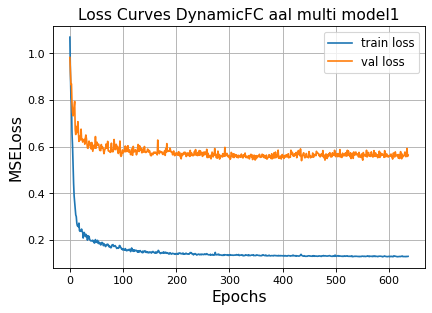

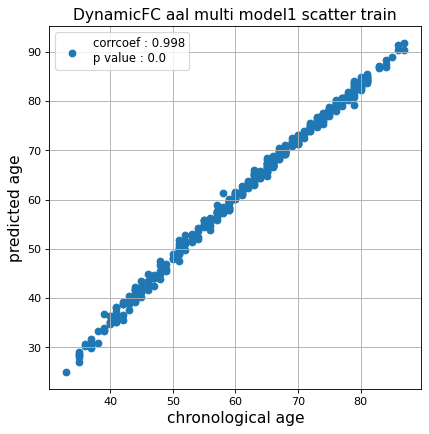

r^2 train data:  0.9510940181439147


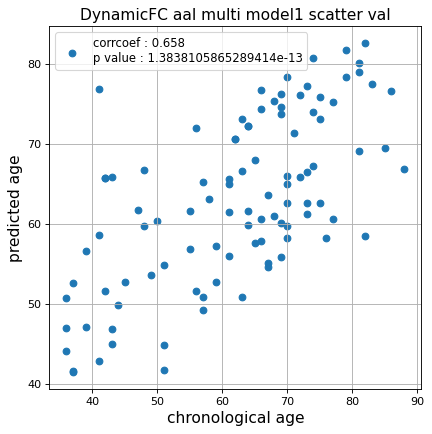

r^2 val data:  0.4153895781657453


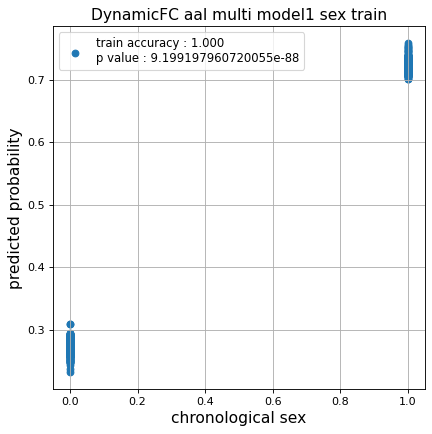

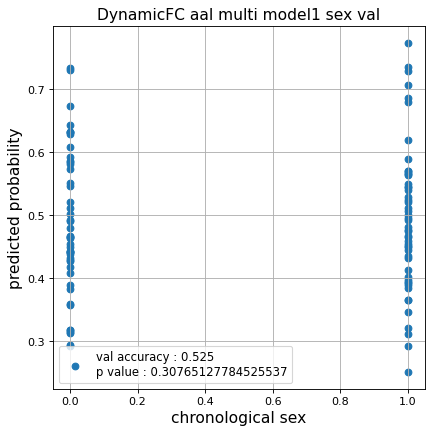

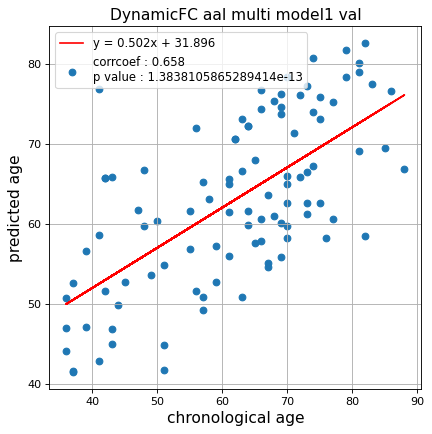

切片: 31.895950919523134
傾き: 0.5022307654180945
Kfold: 2 ::: epoch: 100, loss: 0.1625911364188561, val loss: 0.9622781723737717
Kfold: 2 ::: epoch: 200, loss: 0.13958615064620972, val loss: 0.8680337220430374
Kfold: 2 ::: epoch: 300, loss: 0.13518811762332916, val loss: 0.8438355773687363
Kfold: 2 ::: epoch: 400, loss: 0.13233612936276656, val loss: 0.7984982877969742
Kfold: 2 ::: epoch: 500, loss: 0.13079759363944715, val loss: 0.7898744195699692
Kfold: 2 ::: epoch: 600, loss: 0.13152663524334246, val loss: 0.7555630058050156
Kfold: 2 ::: epoch: 700, loss: 0.12979396031453058, val loss: 0.7537883520126343
save_epochs:698
best val loss:0.7002543956041336


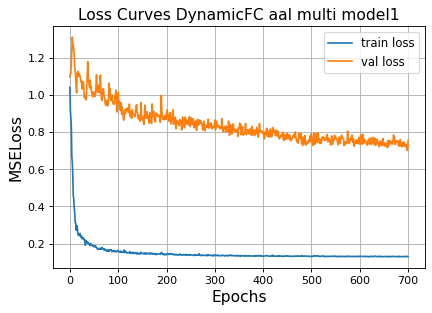

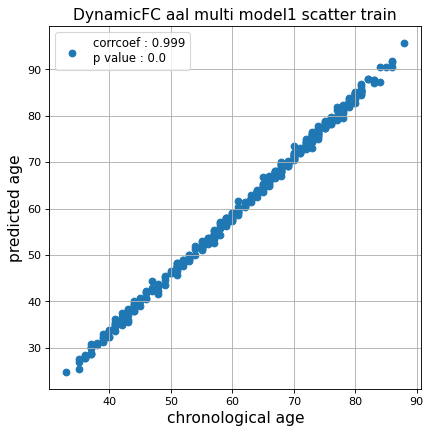

r^2 train data:  0.9224777774911269


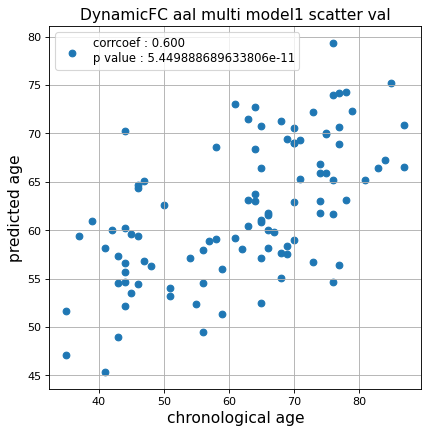

r^2 val data:  0.35405094971827034


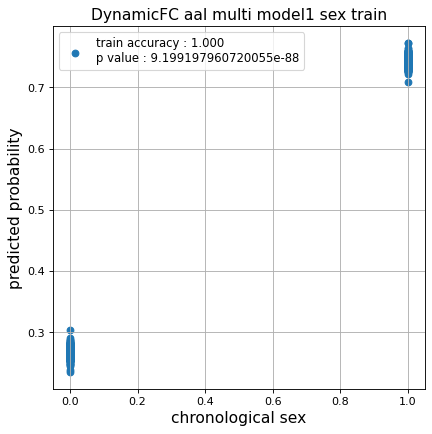

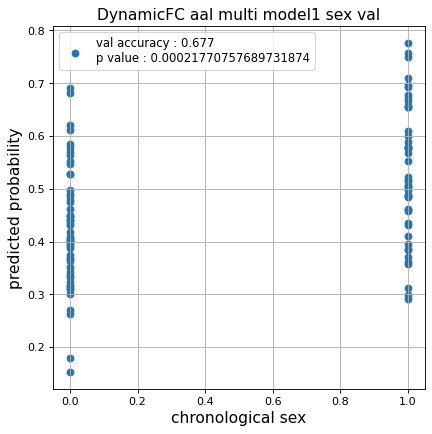

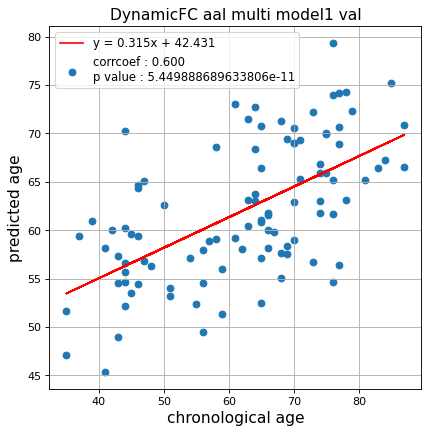

切片: 42.43061049179978
傾き: 0.31528081581232065
Kfold: 3 ::: epoch: 100, loss: 0.15160211806113905, val loss: 0.502176072448492
Kfold: 3 ::: epoch: 200, loss: 0.1397739453957631, val loss: 0.5041525885462761
Kfold: 3 ::: epoch: 300, loss: 0.13513379715956175, val loss: 0.4853147752583027
Kfold: 3 ::: epoch: 400, loss: 0.13272170951733223, val loss: 0.5272079035639763
early stopping
save_epochs:276
best val loss:0.45762611366808414


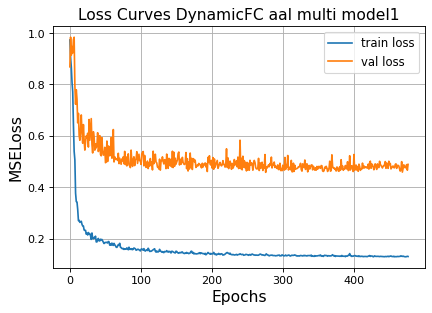

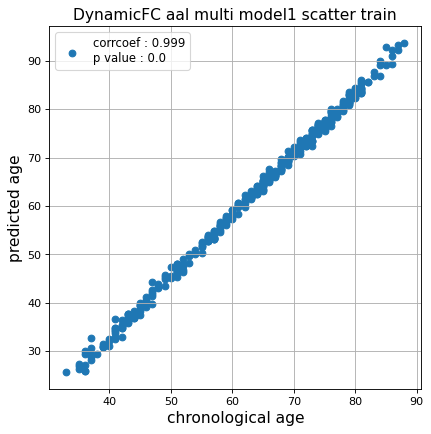

r^2 train data:  0.919342248448868


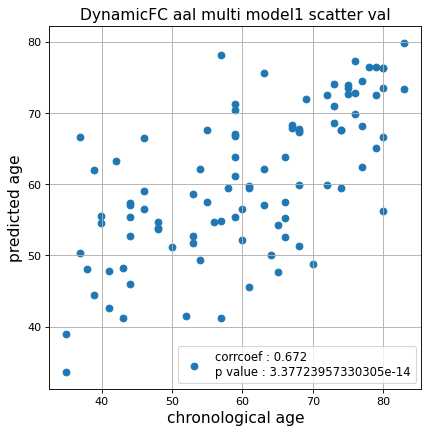

r^2 val data:  0.4426776247749239


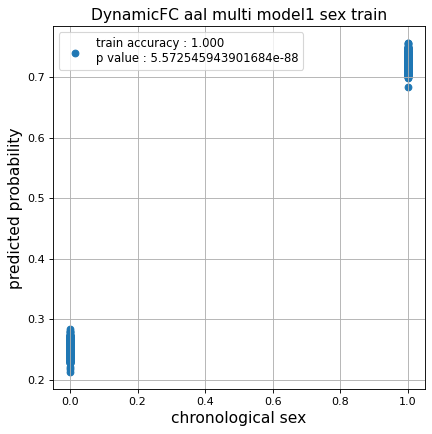

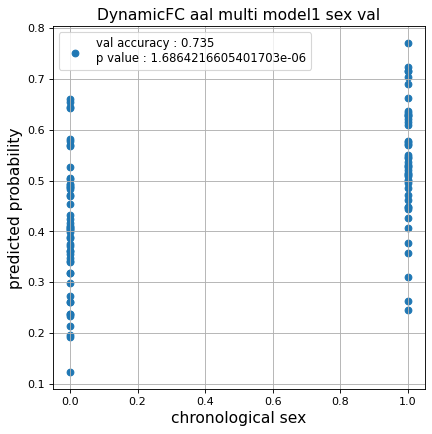

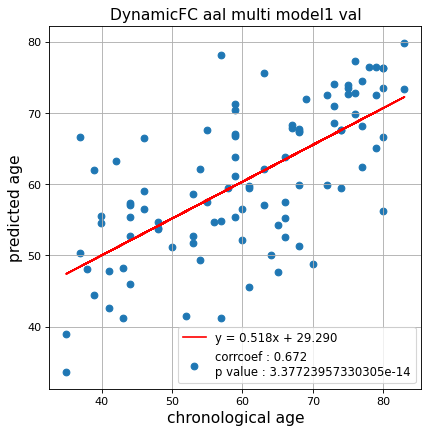

切片: 29.28971240817139
傾き: 0.5179862267600351
Kfold: 4 ::: epoch: 100, loss: 0.16335129279356736, val loss: 1.2090483754873276
Kfold: 4 ::: epoch: 200, loss: 0.1424575402186467, val loss: 1.1944658607244492
Kfold: 4 ::: epoch: 300, loss: 0.13759411183687356, val loss: 1.2193292379379272
Kfold: 4 ::: epoch: 400, loss: 0.13455744087696075, val loss: 1.2366006523370743
early stopping
save_epochs:206
best val loss:1.1471307575702667


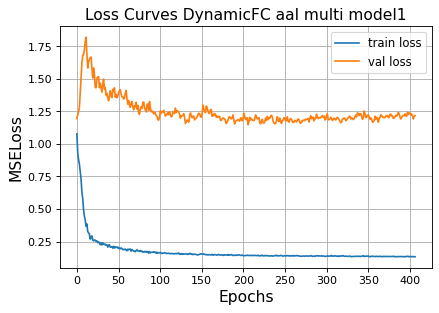

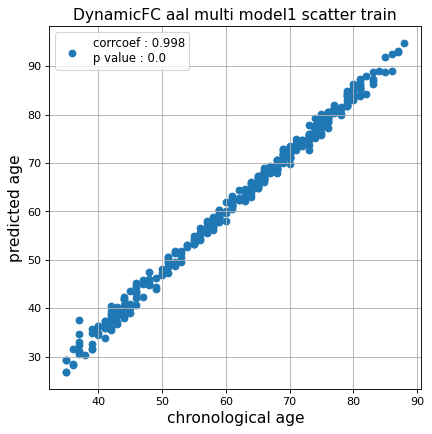

r^2 train data:  0.9415303413872622


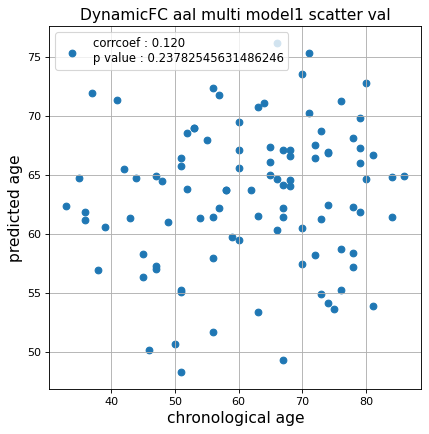

r^2 val data:  -0.09932475331109702


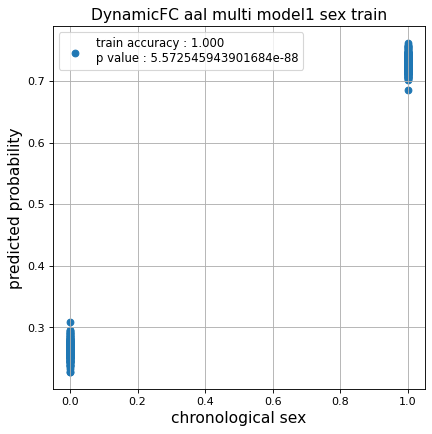

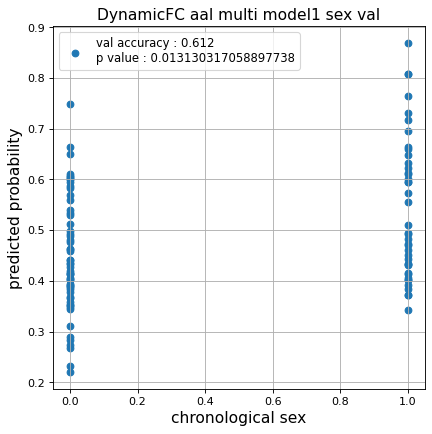

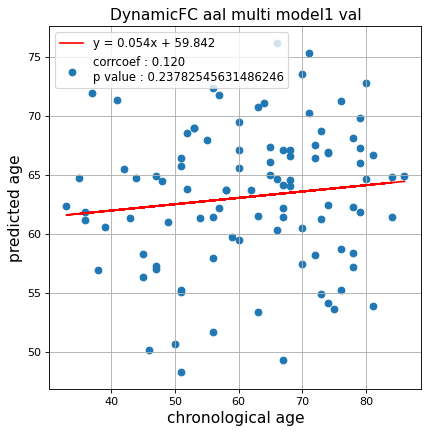

切片: 59.84167526464481
傾き: 0.053763233904976976
Kfold: 5 ::: epoch: 100, loss: 0.15498800919606134, val loss: 0.5465974882245064
Kfold: 5 ::: epoch: 200, loss: 0.14193033713560838, val loss: 0.5310318246483803
Kfold: 5 ::: epoch: 300, loss: 0.1352455627459746, val loss: 0.5293164029717445
Kfold: 5 ::: epoch: 400, loss: 0.13138990562695724, val loss: 0.532711535692215
early stopping
save_epochs:280
best val loss:0.5120131336152554


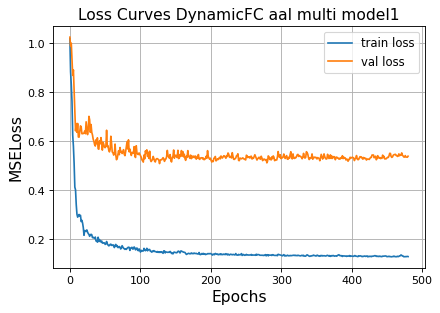

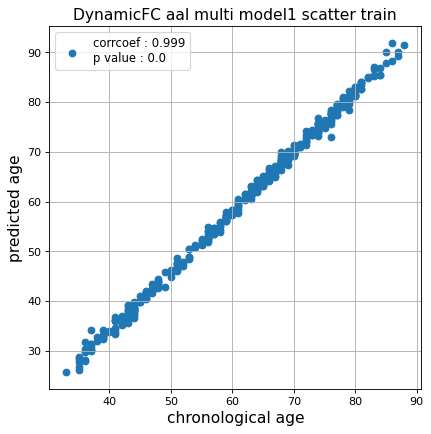

r^2 train data:  0.9399375915066244


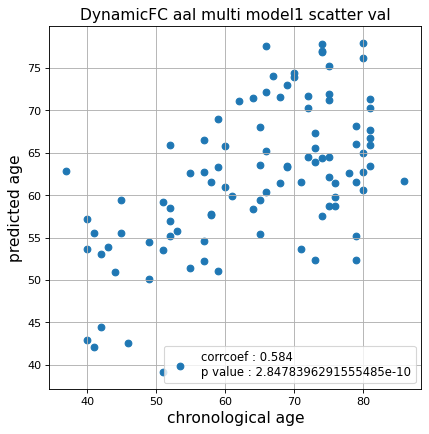

r^2 val data:  0.29294178686925443


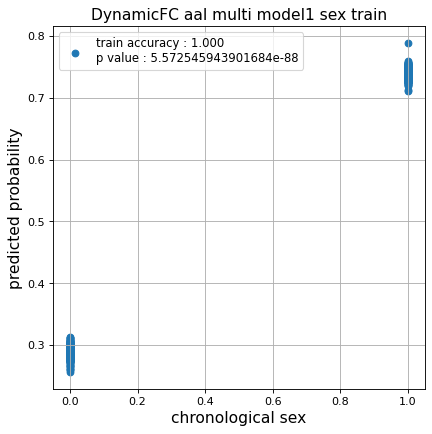

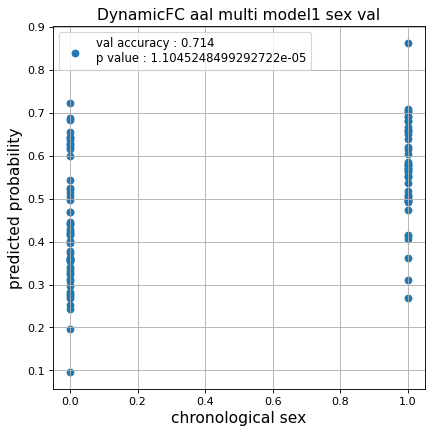

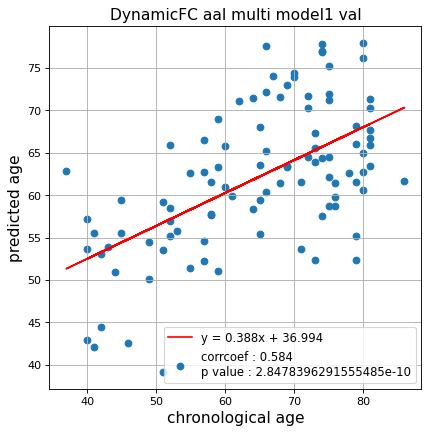

切片: 36.99370270728765
傾き: 0.3877894997381423
Nested Kfold ::: 2
Kfold: 1 ::: epoch: 100, loss: 0.15755815574756035, val loss: 0.6669426560401917
Kfold: 1 ::: epoch: 200, loss: 0.14098848975621736, val loss: 0.6528092473745346
Kfold: 1 ::: epoch: 300, loss: 0.1376543537928508, val loss: 0.6954623013734818
Kfold: 1 ::: epoch: 400, loss: 0.13155634701251984, val loss: 0.7050143629312515
early stopping
save_epochs:210
best val loss:0.6449371576309204


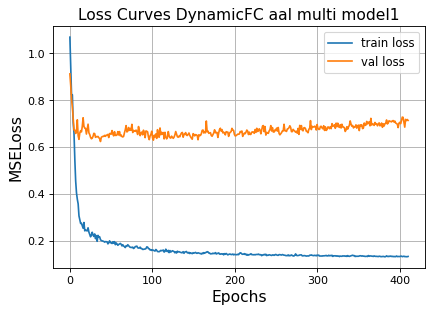

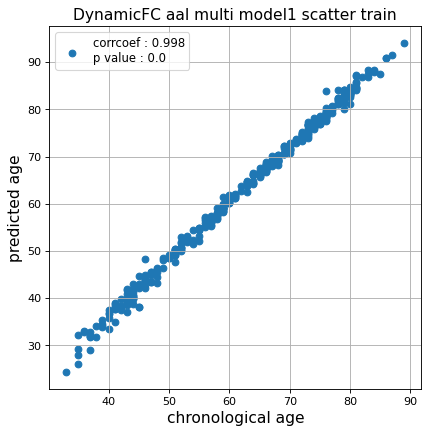

r^2 train data:  0.9528805519732807


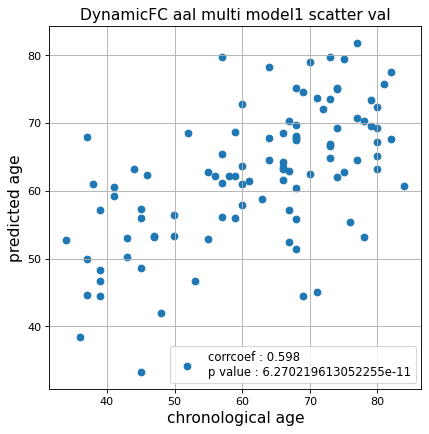

r^2 val data:  0.3405260329858577


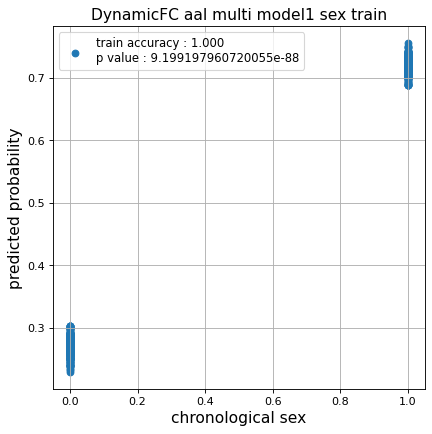

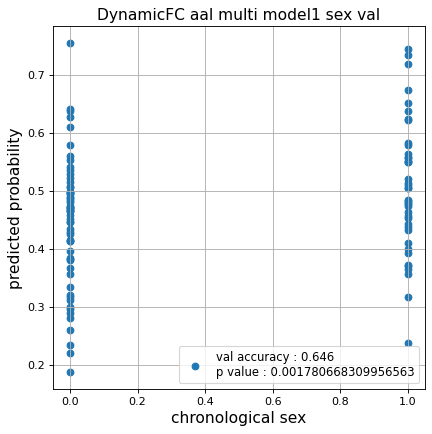

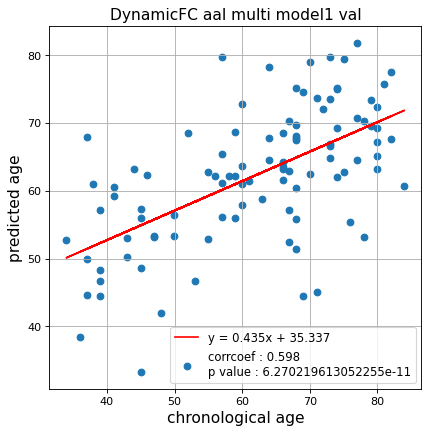

切片: 35.337291539153874
傾き: 0.4350803509950481
Kfold: 2 ::: epoch: 100, loss: 0.15665613687955415, val loss: 0.6335842162370682
Kfold: 2 ::: epoch: 200, loss: 0.1388519681417025, val loss: 0.6385880932211876
Kfold: 2 ::: epoch: 300, loss: 0.1310794296172949, val loss: 0.642486535012722
Kfold: 2 ::: epoch: 400, loss: 0.13020021869586065, val loss: 0.6524215564131737
Kfold: 2 ::: epoch: 500, loss: 0.12853528559207916, val loss: 0.6422576978802681
early stopping
save_epochs:347
best val loss:0.6245530545711517


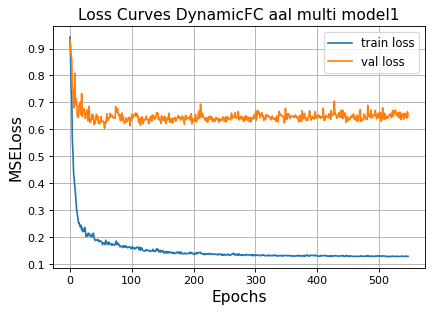

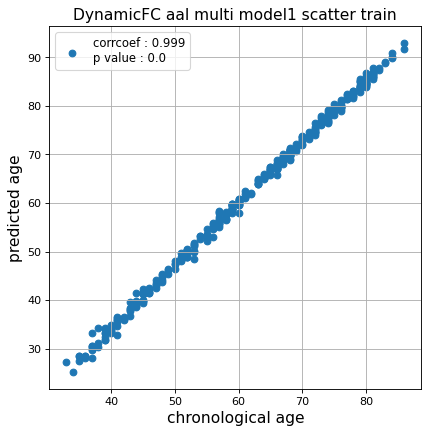

r^2 train data:  0.9193998889333738


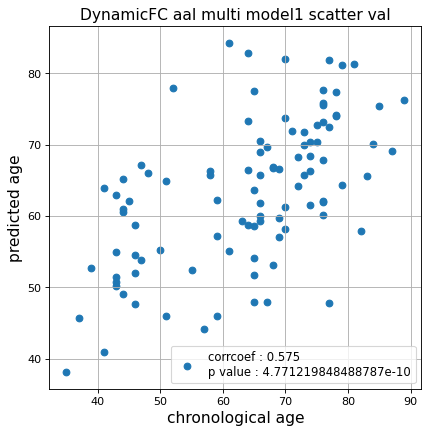

r^2 val data:  0.2924135632609096


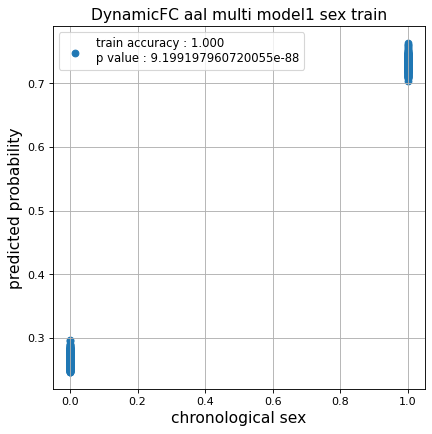

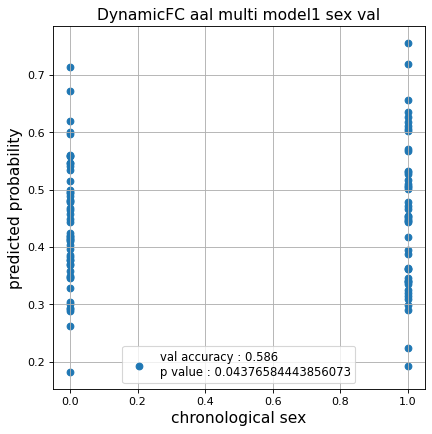

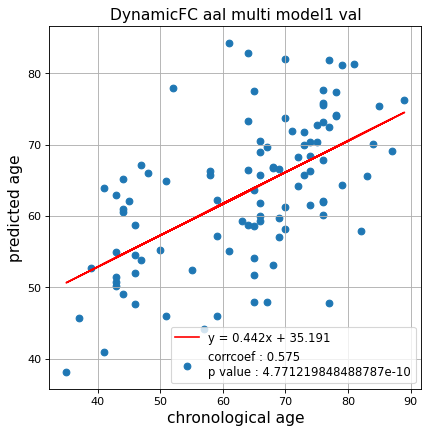

切片: 35.190649874229976
傾き: 0.4420312727402857
Kfold: 3 ::: epoch: 100, loss: 0.1555962975208576, val loss: 0.8115061074495316
Kfold: 3 ::: epoch: 200, loss: 0.14033483083431536, val loss: 0.7385925799608231
Kfold: 3 ::: epoch: 300, loss: 0.135605867092426, val loss: 0.6709025278687477
Kfold: 3 ::: epoch: 400, loss: 0.136799781368329, val loss: 0.5964619442820549
Kfold: 3 ::: epoch: 500, loss: 0.13031934316341692, val loss: 0.578440934419632
Kfold: 3 ::: epoch: 600, loss: 0.12905853757491478, val loss: 0.5549909174442291
Kfold: 3 ::: epoch: 700, loss: 0.12863126397132874, val loss: 0.5415666848421097
save_epochs:695
best val loss:0.5332031548023224


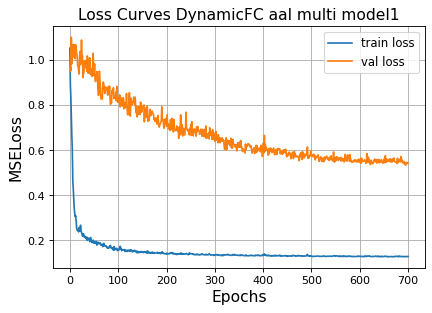

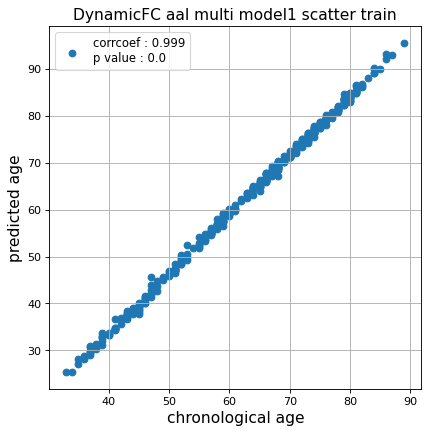

r^2 train data:  0.9270105786142954


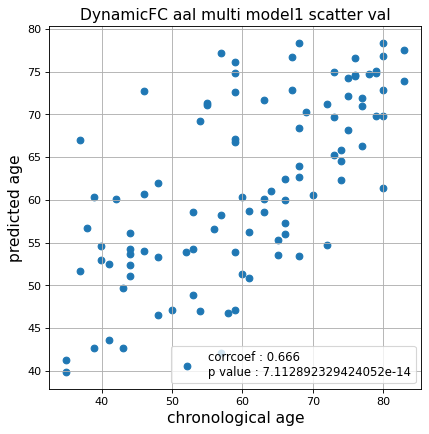

r^2 val data:  0.42631782286172837


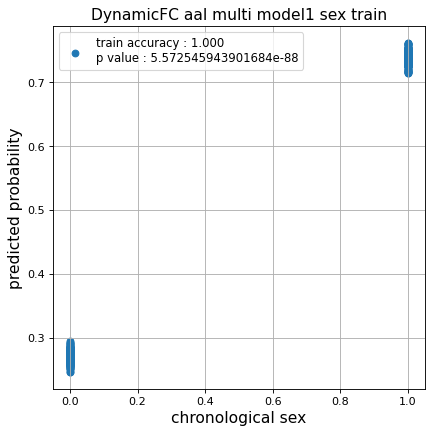

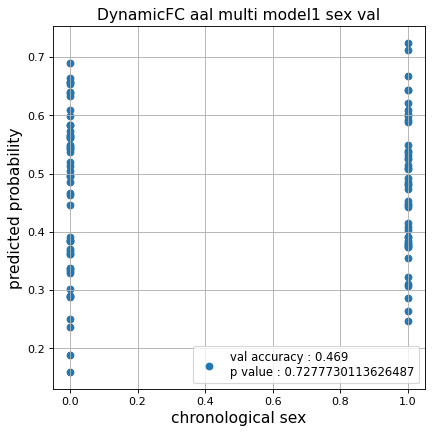

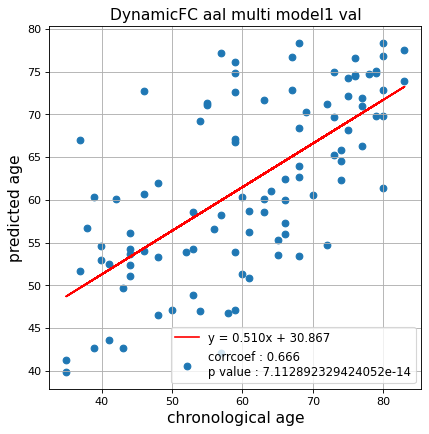

切片: 30.8674349046452
傾き: 0.5102264204857277
Kfold: 4 ::: epoch: 100, loss: 0.15078831177491409, val loss: 0.958692342042923
Kfold: 4 ::: epoch: 200, loss: 0.13670673164037558, val loss: 0.9098199754953384
Kfold: 4 ::: epoch: 300, loss: 0.13517354658016792, val loss: 0.902518168091774
Kfold: 4 ::: epoch: 400, loss: 0.13090307208207938, val loss: 0.9035350680351257
early stopping
save_epochs:248
best val loss:0.868704617023468


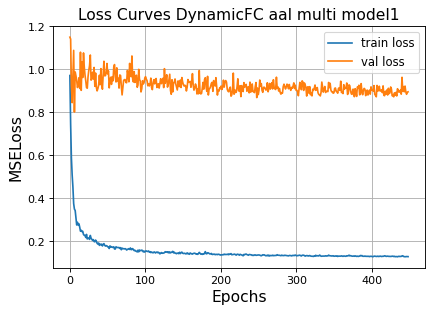

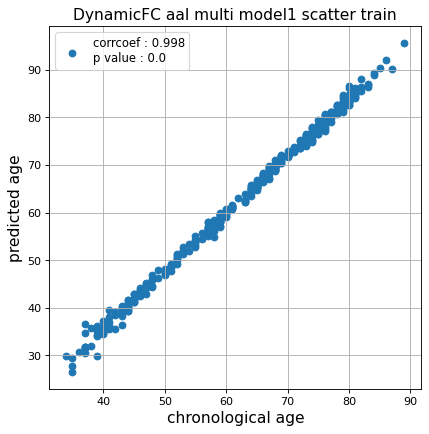

r^2 train data:  0.9515705956426077


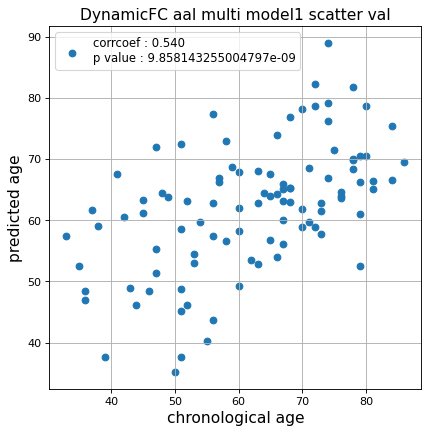

r^2 val data:  0.2364819061200406


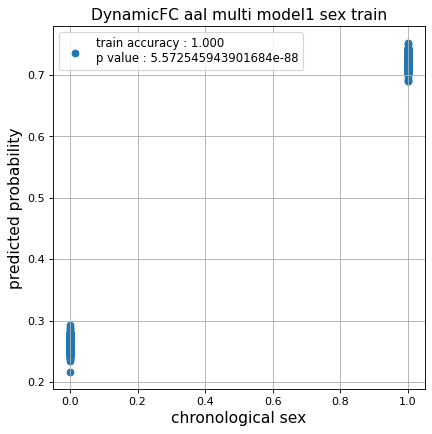

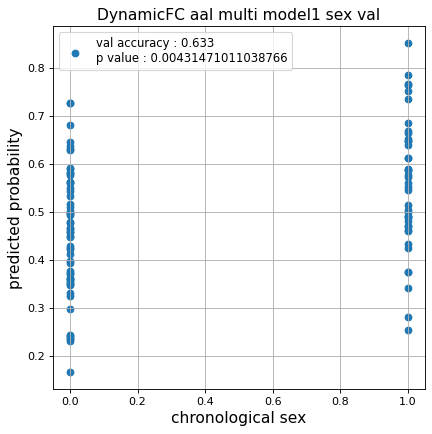

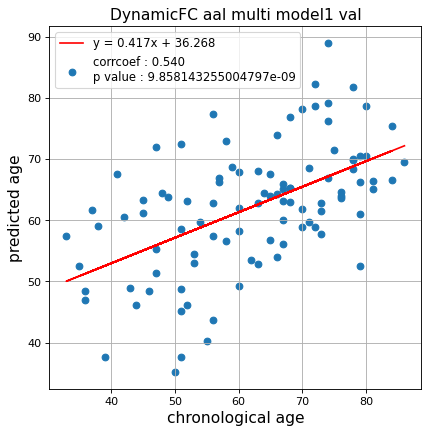

切片: 36.268424374694874
傾き: 0.41724426357678435
Kfold: 5 ::: epoch: 100, loss: 0.17961314205939954, val loss: 1.2278837263584137
Kfold: 5 ::: epoch: 200, loss: 0.14871373428748205, val loss: 1.0627690628170967
Kfold: 5 ::: epoch: 300, loss: 0.13588878168509558, val loss: 0.9622763097286224
Kfold: 5 ::: epoch: 400, loss: 0.13291532603593972, val loss: 0.8206503987312317
Kfold: 5 ::: epoch: 500, loss: 0.1305592919771488, val loss: 0.7419996187090874
Kfold: 5 ::: epoch: 600, loss: 0.12881617133434003, val loss: 0.708805575966835
Kfold: 5 ::: epoch: 700, loss: 0.12947970514114088, val loss: 0.7051495835185051
save_epochs:645
best val loss:0.6788439750671387


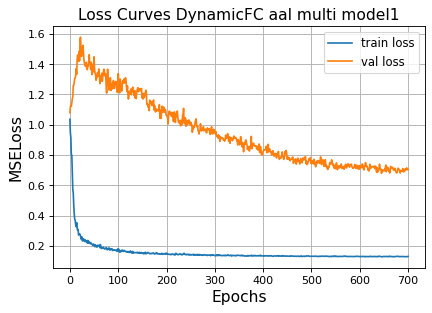

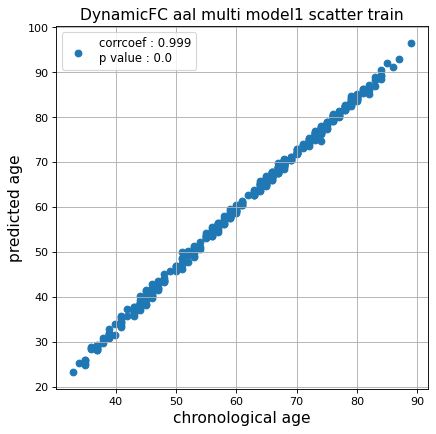

r^2 train data:  0.9141254318012849


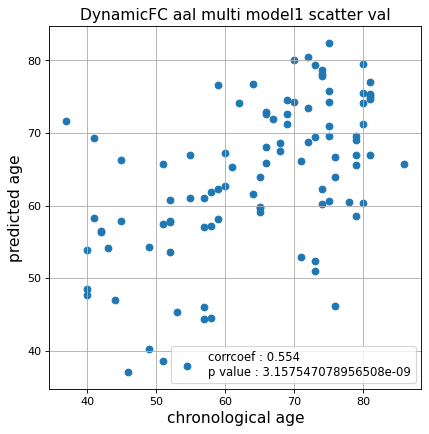

r^2 val data:  0.23806041549776114


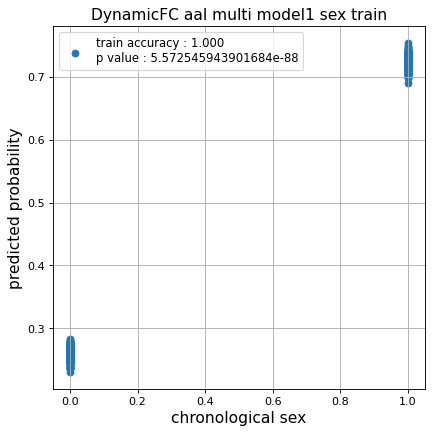

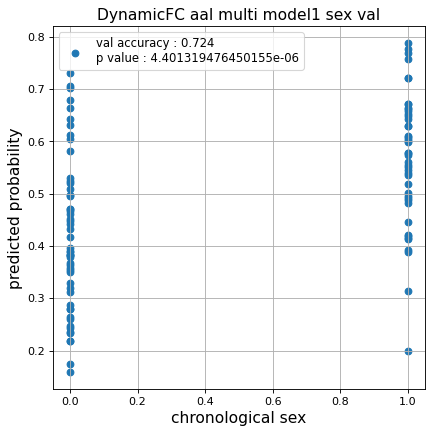

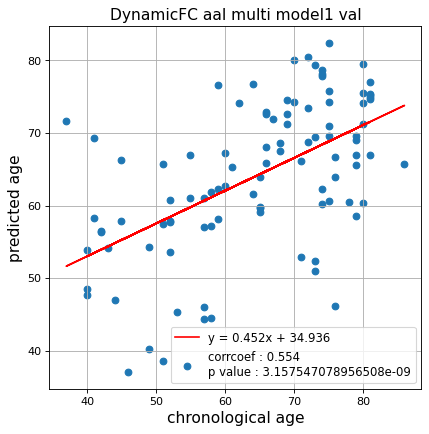

切片: 34.93564525129953
傾き: 0.4517285991269324
Nested Kfold ::: 3
Kfold: 1 ::: epoch: 100, loss: 0.15486624378424424, val loss: 0.6405289769172668
Kfold: 1 ::: epoch: 200, loss: 0.14372332050250128, val loss: 0.6679678708314896
Kfold: 1 ::: epoch: 300, loss: 0.1371897619504195, val loss: 0.7038296908140182
Kfold: 1 ::: epoch: 400, loss: 0.13413005838027367, val loss: 0.7172594964504242
early stopping
save_epochs:255
best val loss:0.6520746648311615


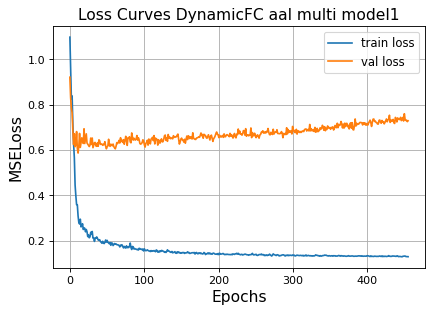

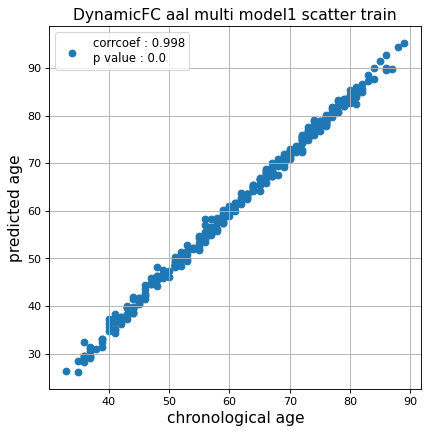

r^2 train data:  0.9430995386456354


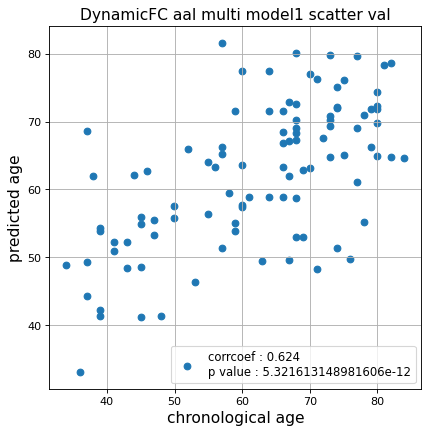

r^2 val data:  0.36777938805942345


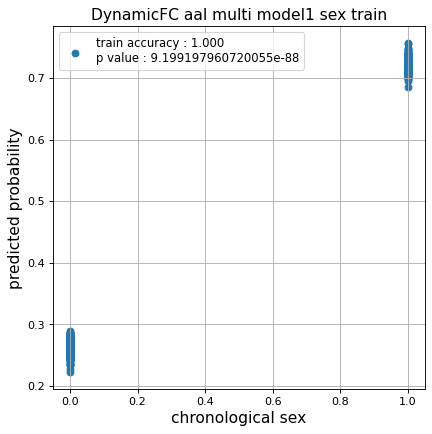

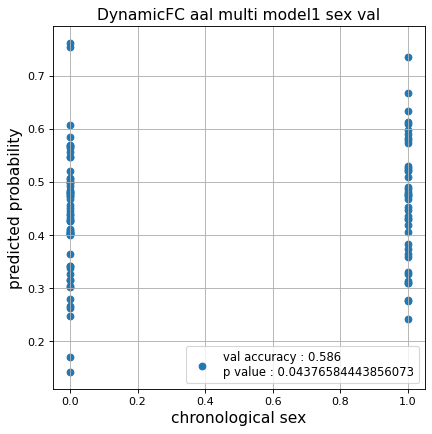

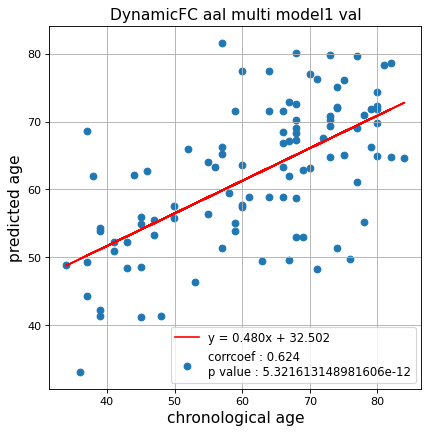

切片: 32.50248100072348
傾き: 0.4795407742985977
Kfold: 2 ::: epoch: 100, loss: 0.16850927701363197, val loss: 0.7880476266145706
Kfold: 2 ::: epoch: 200, loss: 0.14248109207703516, val loss: 0.7254863455891609
Kfold: 2 ::: epoch: 300, loss: 0.13652273897941297, val loss: 0.6891458630561829
Kfold: 2 ::: epoch: 400, loss: 0.13230224870718443, val loss: 0.6921331956982613
Kfold: 2 ::: epoch: 500, loss: 0.13226249699409193, val loss: 0.6784120798110962
Kfold: 2 ::: epoch: 600, loss: 0.13243343509160554, val loss: 0.6673036217689514
Kfold: 2 ::: epoch: 700, loss: 0.12778831674502447, val loss: 0.6489297151565552
save_epochs:680
best val loss:0.6335914433002472


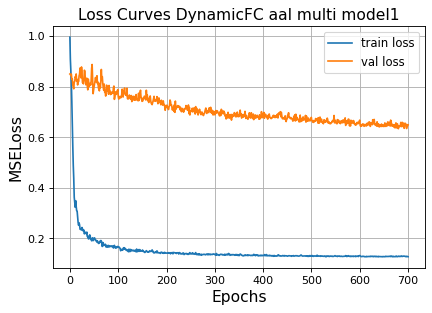

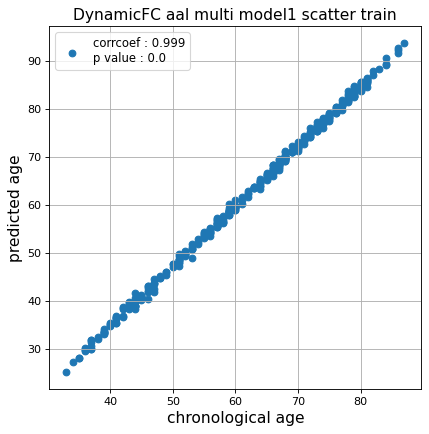

r^2 train data:  0.9361735827448111


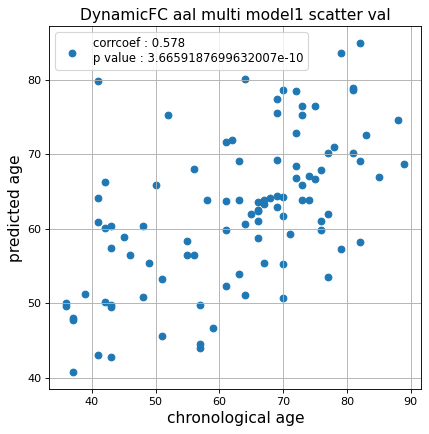

r^2 val data:  0.31484667115812404


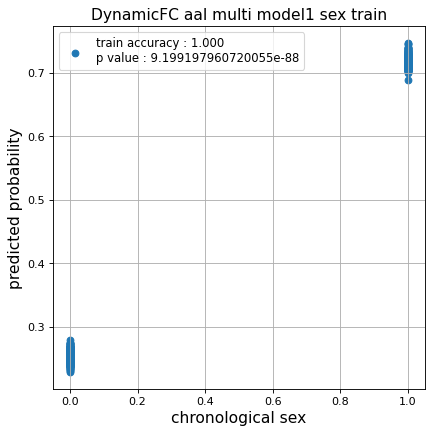

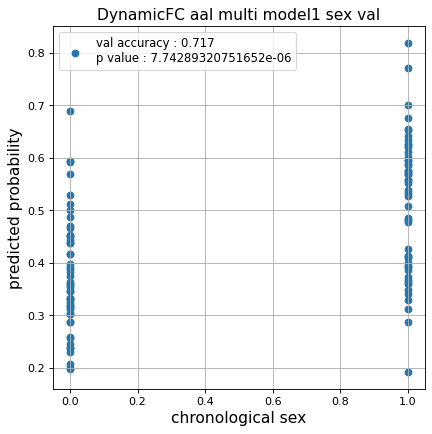

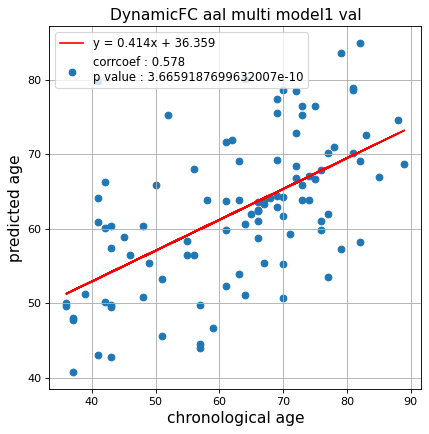

切片: 36.358729487186224
傾き: 0.4137263880941836
Kfold: 3 ::: epoch: 100, loss: 0.15551977088818184, val loss: 0.57081189006567
Kfold: 3 ::: epoch: 200, loss: 0.14262881301916563, val loss: 0.5703218206763268
Kfold: 3 ::: epoch: 300, loss: 0.13462698803498194, val loss: 0.5470396280288696
Kfold: 3 ::: epoch: 400, loss: 0.13059093058109283, val loss: 0.535762295126915
early stopping
save_epochs:202
best val loss:0.4989178329706192


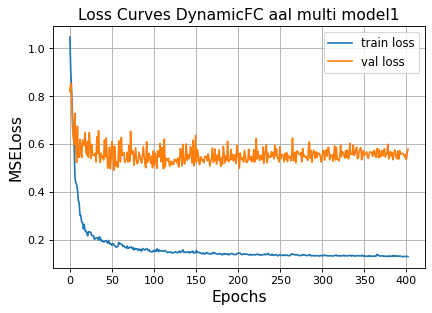

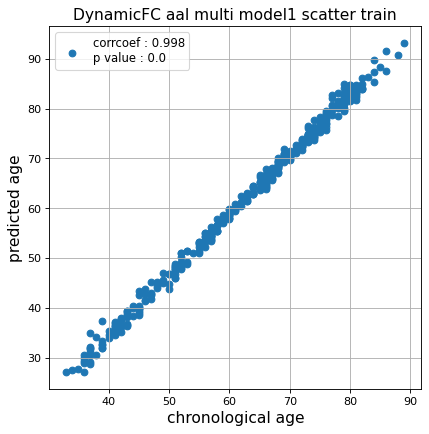

r^2 train data:  0.948988041129268


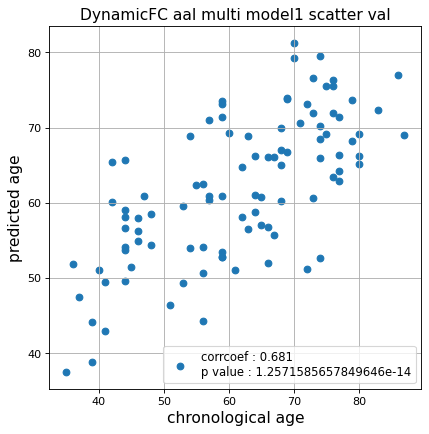

r^2 val data:  0.4598124722736796


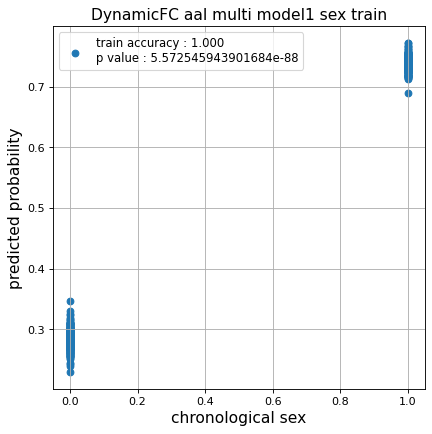

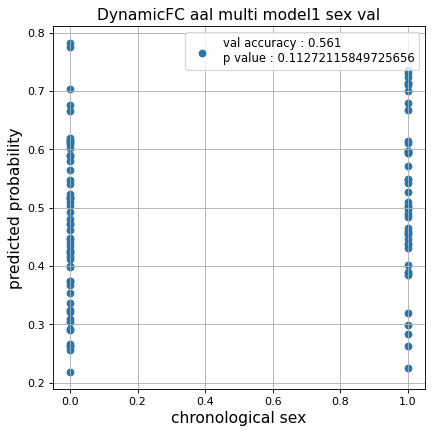

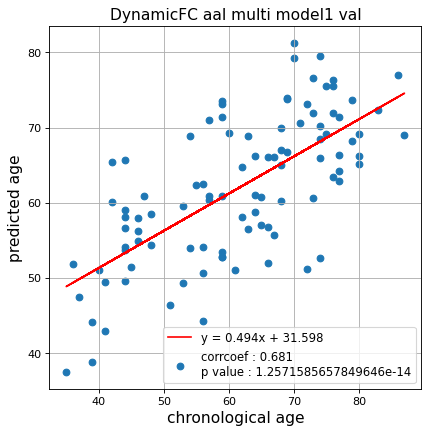

切片: 31.597633327122125
傾き: 0.49370169321370566
Kfold: 4 ::: epoch: 100, loss: 0.15386348045789278, val loss: 0.9778555929660797
Kfold: 4 ::: epoch: 200, loss: 0.1419245291214723, val loss: 0.9196479171514511
Kfold: 4 ::: epoch: 300, loss: 0.13361813471867487, val loss: 0.8734842389822006
Kfold: 4 ::: epoch: 400, loss: 0.13157975788299853, val loss: 0.8583774119615555
Kfold: 4 ::: epoch: 600, loss: 0.12784268535100496, val loss: 0.9017715752124786
early stopping
save_epochs:400
best val loss:0.8583774119615555


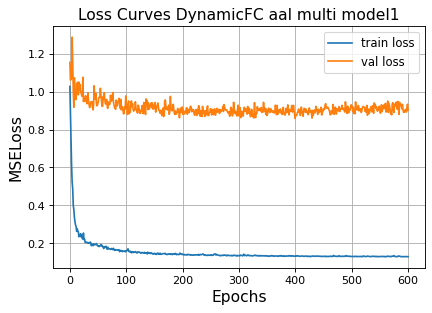

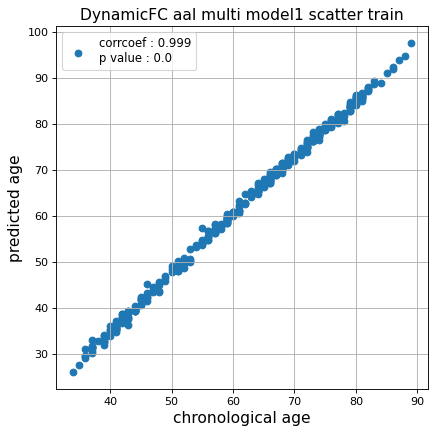

r^2 train data:  0.9260126750295695


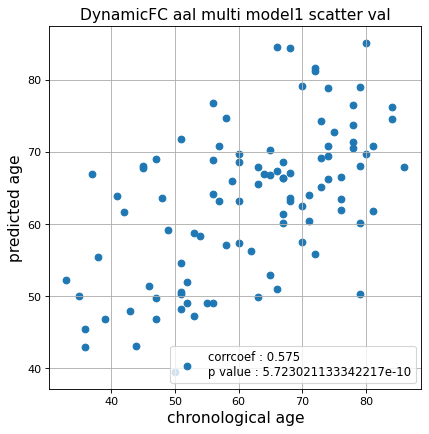

r^2 val data:  0.2828783436485133


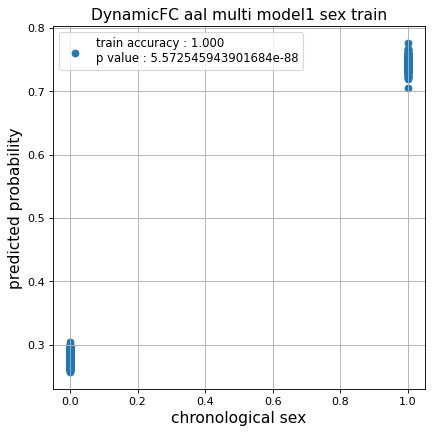

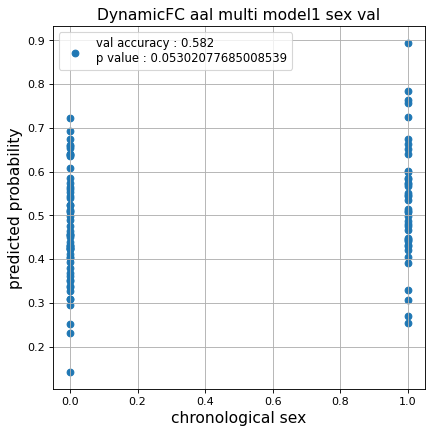

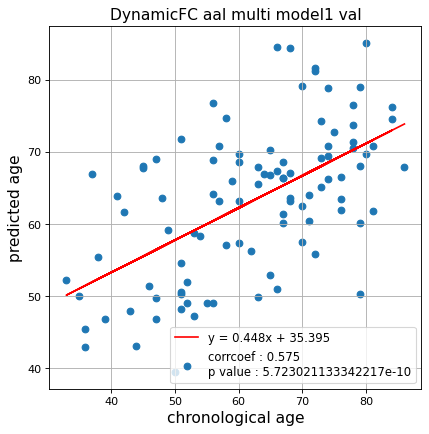

切片: 35.39538241212246
傾き: 0.44769470198873573
Kfold: 5 ::: epoch: 100, loss: 0.16259602629221404, val loss: 0.6413468196988106
Kfold: 5 ::: epoch: 200, loss: 0.14335769071028784, val loss: 0.5747234895825386
Kfold: 5 ::: epoch: 300, loss: 0.13671069191052362, val loss: 0.5718780532479286
Kfold: 5 ::: epoch: 400, loss: 0.13167255543745482, val loss: 0.5388369373977184
Kfold: 5 ::: epoch: 500, loss: 0.13242026705008286, val loss: 0.5295136757194996
Kfold: 5 ::: epoch: 600, loss: 0.13084086775779724, val loss: 0.5424857214093208
early stopping
save_epochs:491
best val loss:0.5150751918554306


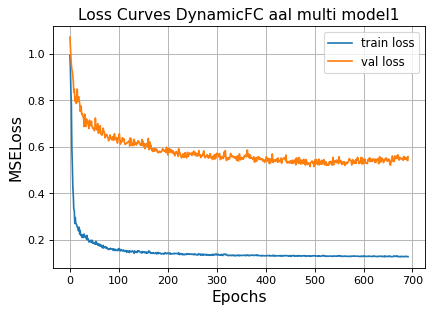

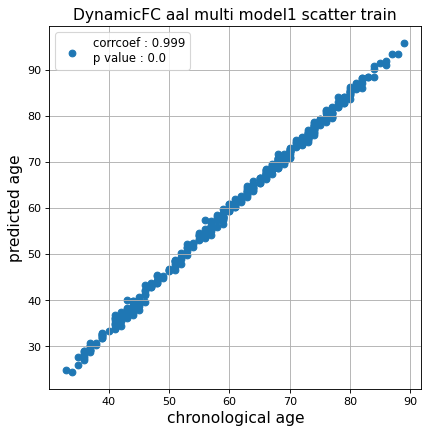

r^2 train data:  0.9179689484268745


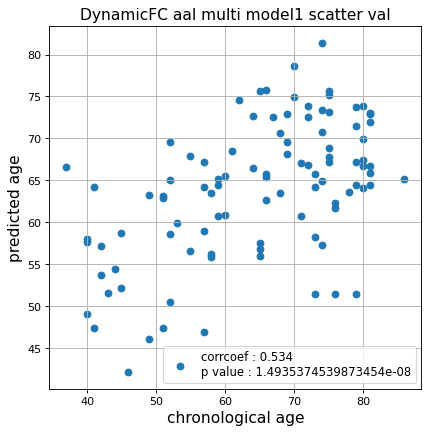

r^2 val data:  0.2722055793582244


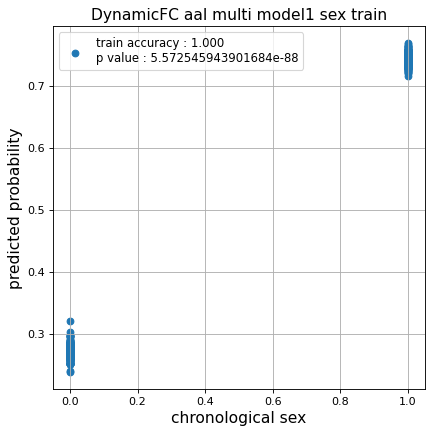

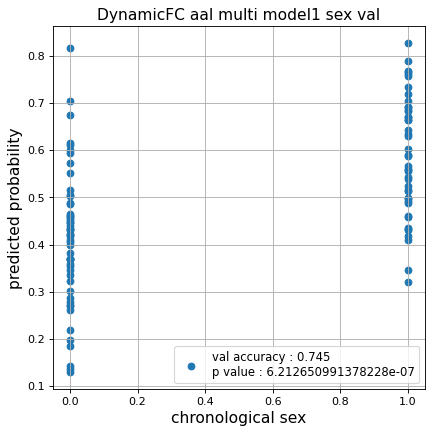

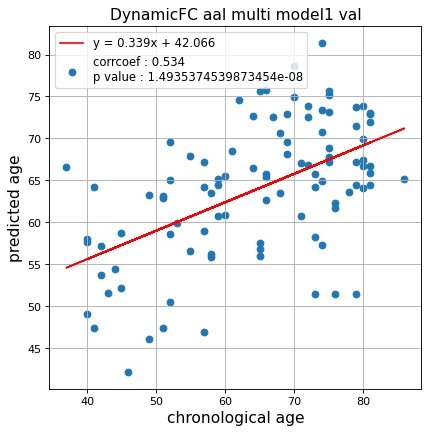

切片: 42.065834944641544
傾き: 0.3387357860107211
Nested Kfold ::: 4
Kfold: 1 ::: epoch: 100, loss: 0.15616082686644334, val loss: 0.6303642690181732
Kfold: 1 ::: epoch: 200, loss: 0.1426603255363611, val loss: 0.6138557717204094
Kfold: 1 ::: epoch: 300, loss: 0.13688149360510019, val loss: 0.6328648924827576
Kfold: 1 ::: epoch: 400, loss: 0.13307926861139444, val loss: 0.6371548101305962
early stopping
save_epochs:252
best val loss:0.5942269712686539


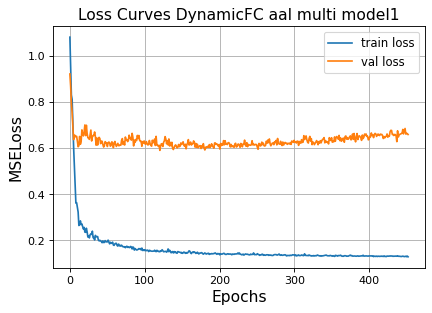

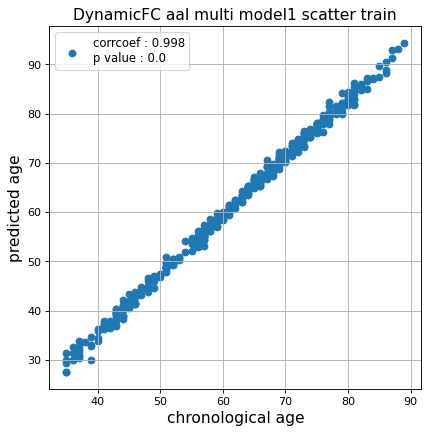

r^2 train data:  0.9572738230868907


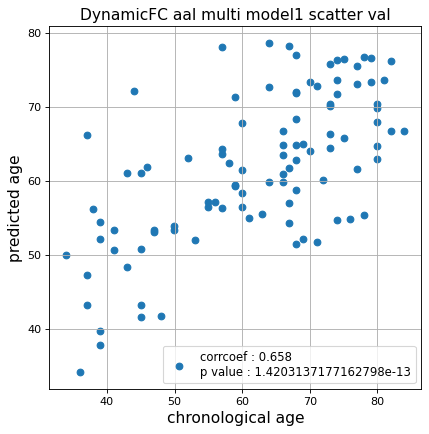

r^2 val data:  0.42579537155073777


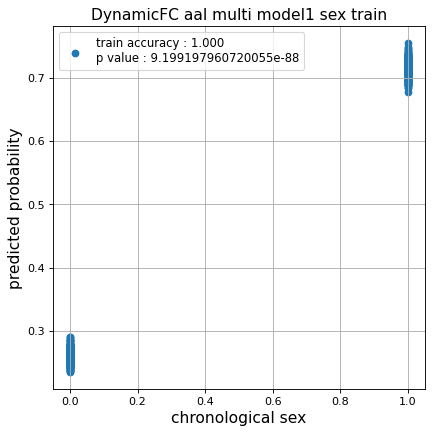

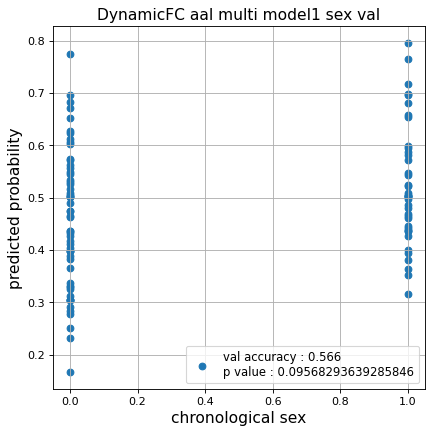

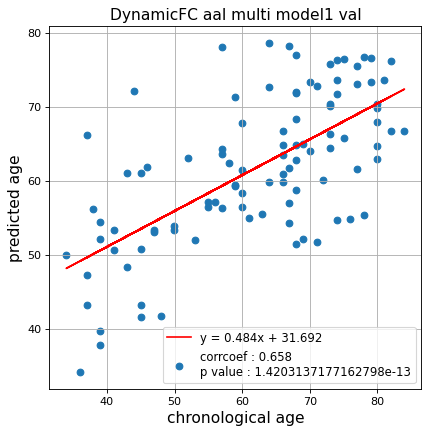

切片: 31.691814550857476
傾き: 0.4844222855549957
Kfold: 2 ::: epoch: 100, loss: 0.15495091676712036, val loss: 0.7235049605369568
Kfold: 2 ::: epoch: 200, loss: 0.14132752212194297, val loss: 0.6972406059503555
Kfold: 2 ::: epoch: 300, loss: 0.1346769378735469, val loss: 0.7078439593315125
Kfold: 2 ::: epoch: 400, loss: 0.13311563432216644, val loss: 0.7035947367548943
Kfold: 2 ::: epoch: 500, loss: 0.12976649174323449, val loss: 0.7068572342395782
early stopping
save_epochs:308
best val loss:0.6706122606992722


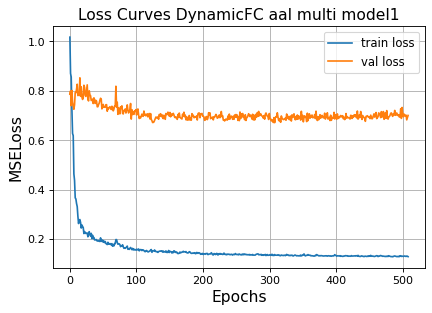

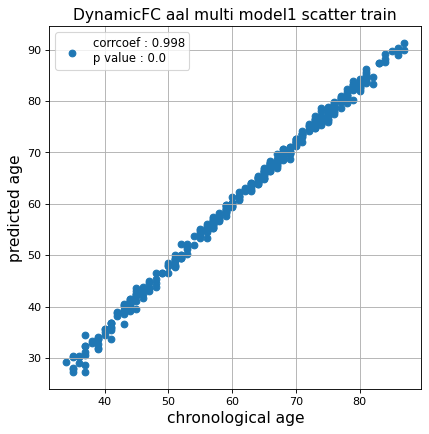

r^2 train data:  0.9525776277378575


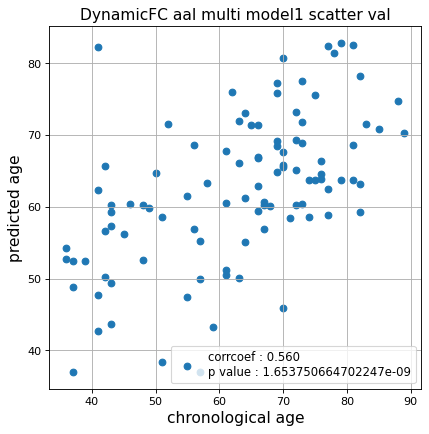

r^2 val data:  0.28160454758274023


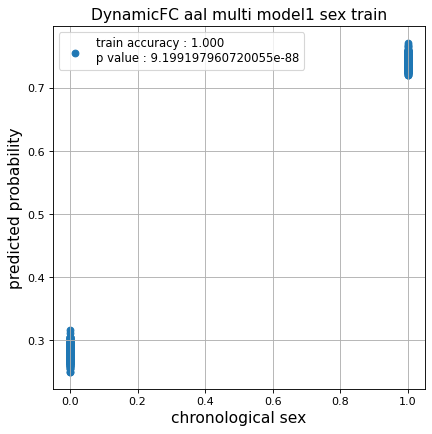

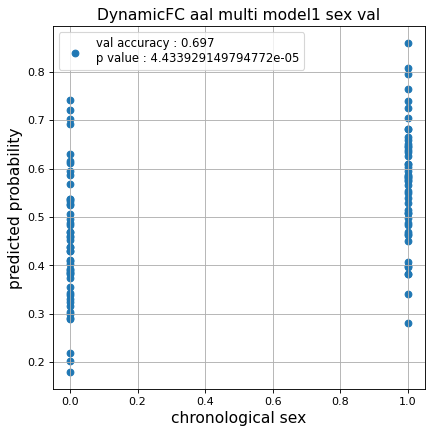

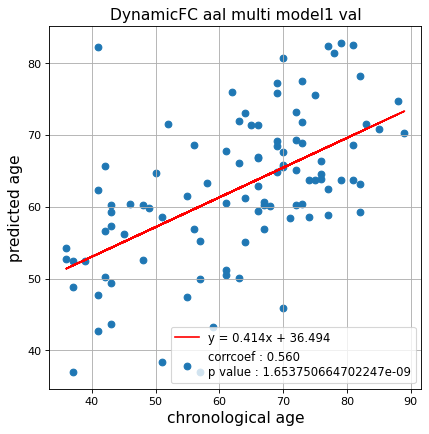

切片: 36.49430569889065
傾き: 0.4138812789806832
Kfold: 3 ::: epoch: 100, loss: 0.15889812203554007, val loss: 0.762402817606926
Kfold: 3 ::: epoch: 200, loss: 0.14153525004020104, val loss: 0.7374428063631058
Kfold: 3 ::: epoch: 300, loss: 0.13548154211961305, val loss: 0.7125637158751488
Kfold: 3 ::: epoch: 400, loss: 0.13415112518347228, val loss: 0.6995151042938232
Kfold: 3 ::: epoch: 500, loss: 0.1308582711678285, val loss: 0.6751499176025391
Kfold: 3 ::: epoch: 600, loss: 0.12875486681094536, val loss: 0.6646539941430092
Kfold: 3 ::: epoch: 700, loss: 0.13012296534501588, val loss: 0.6532317325472832
save_epochs:686
best val loss:0.6481330543756485


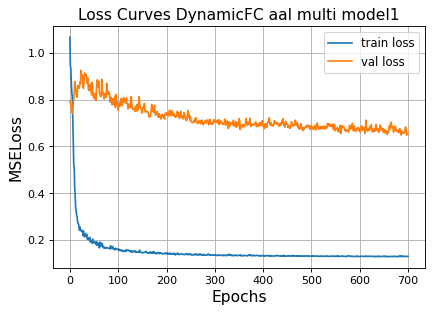

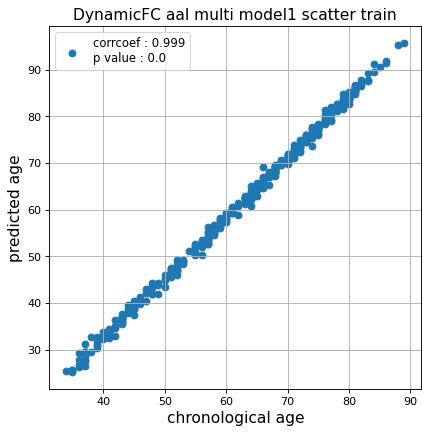

r^2 train data:  0.9060589165190966


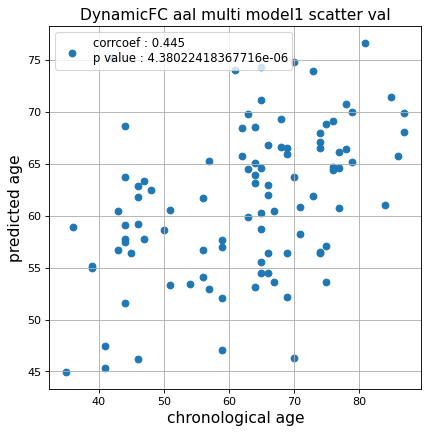

r^2 val data:  0.18192268112118115


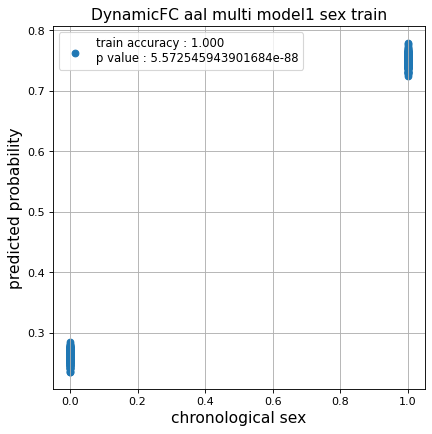

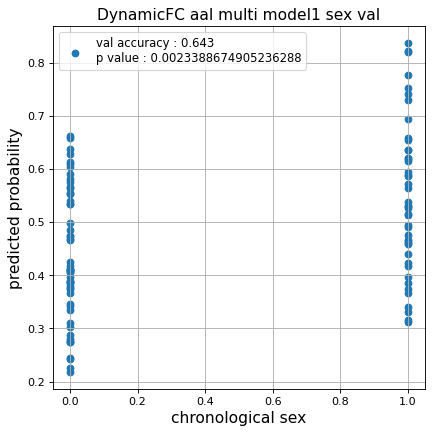

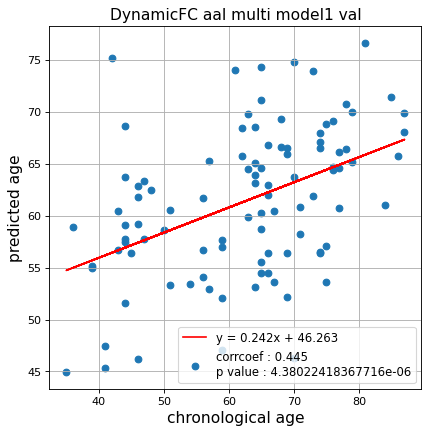

切片: 46.26275883111811
傾き: 0.24226299009019717
Kfold: 4 ::: epoch: 100, loss: 0.16092100395606115, val loss: 0.9136049598455429
Kfold: 4 ::: epoch: 200, loss: 0.14651155586426073, val loss: 0.8993702679872513
Kfold: 4 ::: epoch: 300, loss: 0.13587425993039057, val loss: 0.8884010463953018
Kfold: 4 ::: epoch: 400, loss: 0.13168812944338873, val loss: 0.8552574813365936
Kfold: 4 ::: epoch: 500, loss: 0.12950891600205347, val loss: 0.8404925763607025
early stopping
save_epochs:341
best val loss:0.8277843445539474


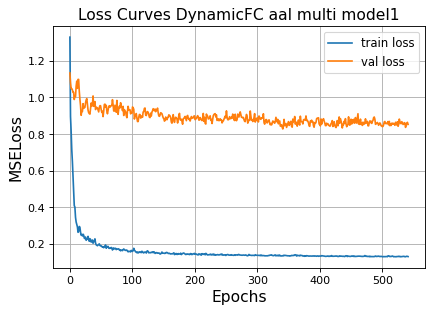

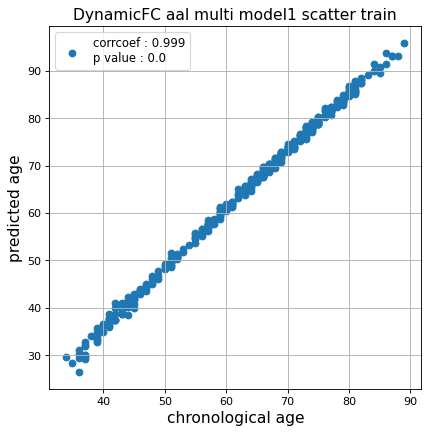

r^2 train data:  0.9240315688552285


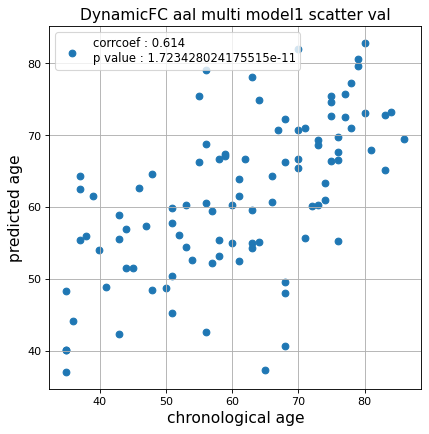

r^2 val data:  0.35214275329159317


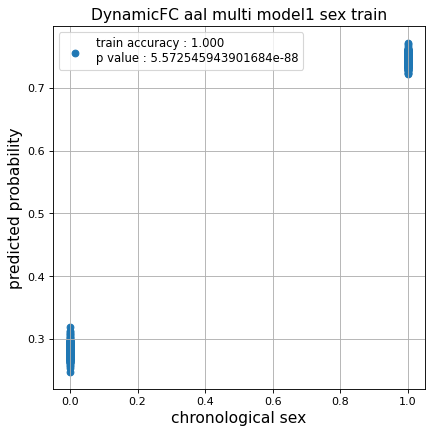

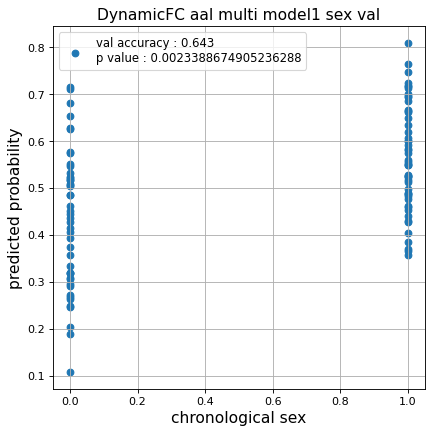

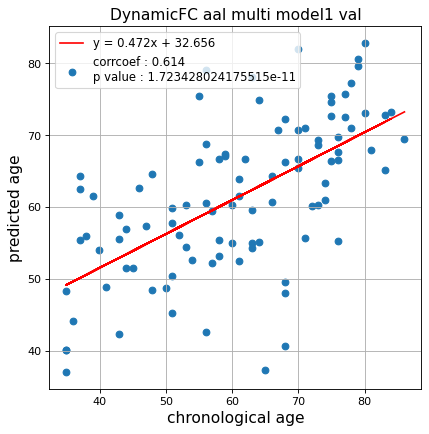

切片: 32.656437201921584
傾き: 0.47203598982323086
Kfold: 5 ::: epoch: 100, loss: 0.1511110353928346, val loss: 0.715592086315155
Kfold: 5 ::: epoch: 200, loss: 0.13862534555105063, val loss: 0.6201604828238487
Kfold: 5 ::: epoch: 300, loss: 0.1338977412535594, val loss: 0.602259024977684
Kfold: 5 ::: epoch: 400, loss: 0.1303980006621434, val loss: 0.5820658951997757
Kfold: 5 ::: epoch: 500, loss: 0.12922969116614416, val loss: 0.5605697706341743
Kfold: 5 ::: epoch: 600, loss: 0.1298519246853315, val loss: 0.5921061933040619
Kfold: 5 ::: epoch: 700, loss: 0.12760447882688963, val loss: 0.5598412938416004
save_epochs:641
best val loss:0.5500480718910694


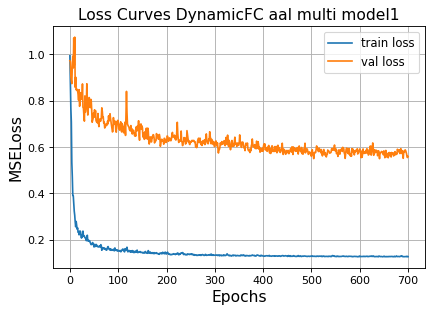

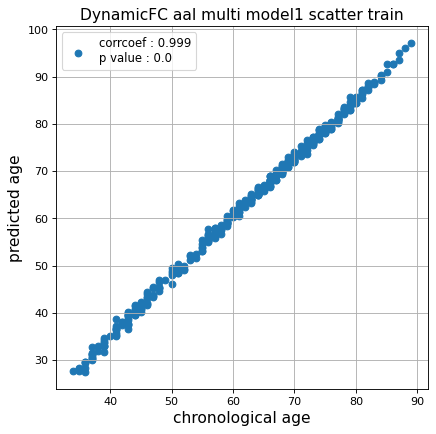

r^2 train data:  0.9295828784175302


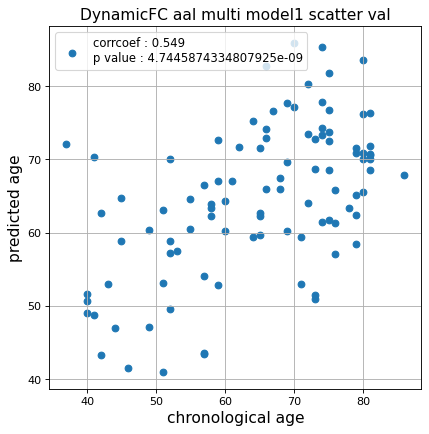

r^2 val data:  0.23745444847289654


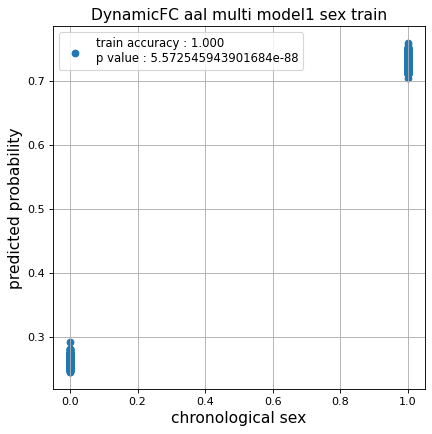

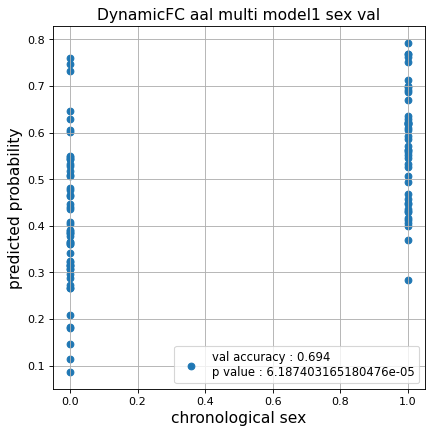

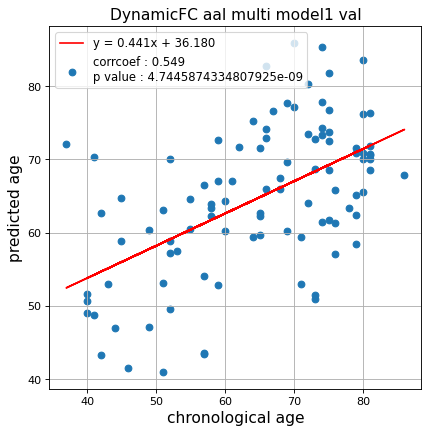

切片: 36.17976006016666
傾き: 0.4407641321017822
Nested Kfold ::: 5
Kfold: 1 ::: epoch: 100, loss: 0.1568795144557953, val loss: 0.7002703845500946
Kfold: 1 ::: epoch: 200, loss: 0.14185437903954431, val loss: 0.6878089755773544
Kfold: 1 ::: epoch: 300, loss: 0.13750293850898743, val loss: 0.6885856688022614
Kfold: 1 ::: epoch: 400, loss: 0.13148357547246492, val loss: 0.705324187874794
early stopping
save_epochs:219
best val loss:0.6470795124769211


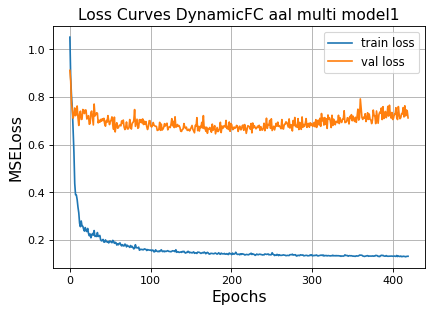

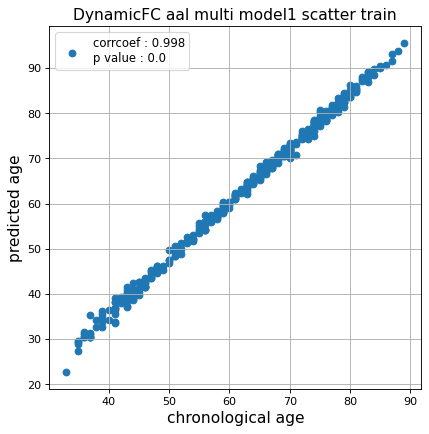

r^2 train data:  0.9431959391252189


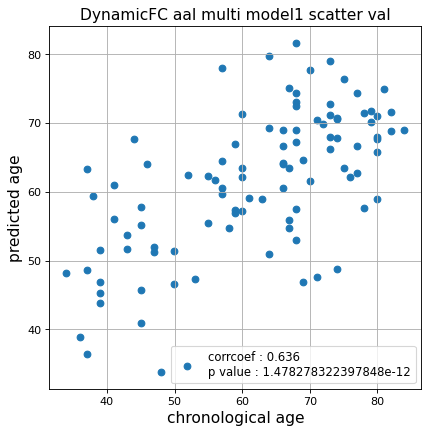

r^2 val data:  0.39155810470710506


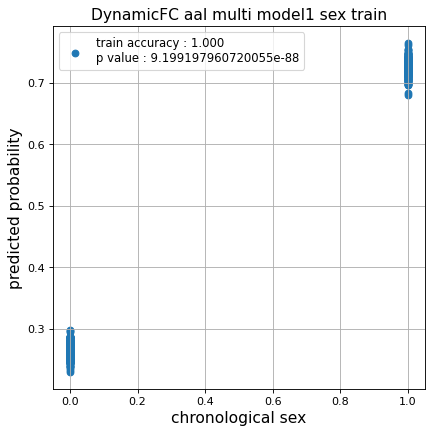

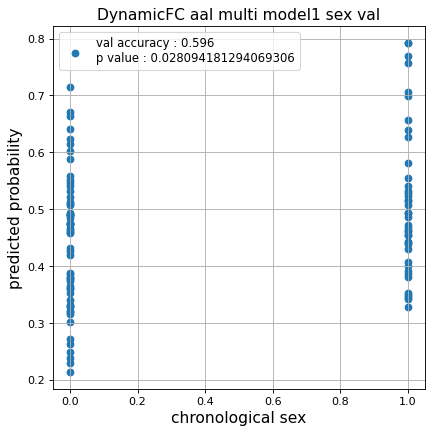

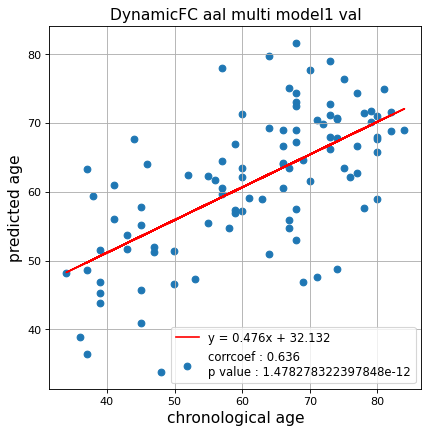

切片: 32.131506934880164
傾き: 0.47559268062800714
Kfold: 2 ::: epoch: 100, loss: 0.15899205093200391, val loss: 0.7371050119400024
Kfold: 2 ::: epoch: 200, loss: 0.13890795753552362, val loss: 0.6935793310403824
Kfold: 2 ::: epoch: 300, loss: 0.13363601725835067, val loss: 0.681895837187767
Kfold: 2 ::: epoch: 400, loss: 0.13384527426499587, val loss: 0.6897949278354645
early stopping
save_epochs:265
best val loss:0.6526683270931244


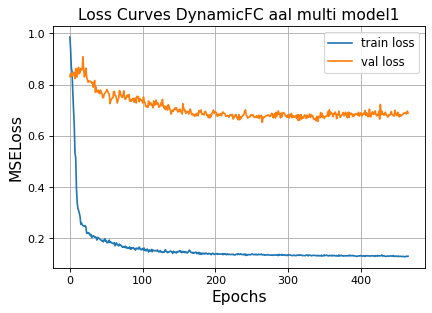

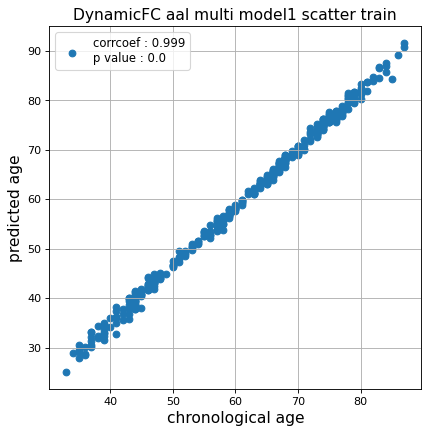

r^2 train data:  0.9562318281604121


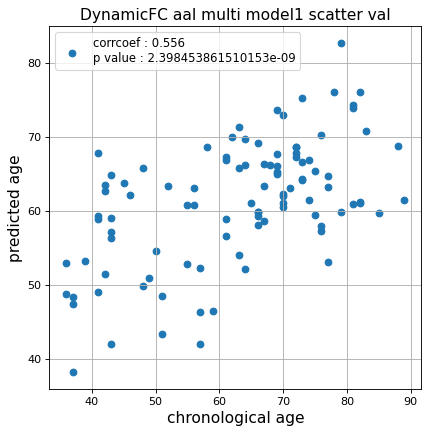

r^2 val data:  0.2979273165648654


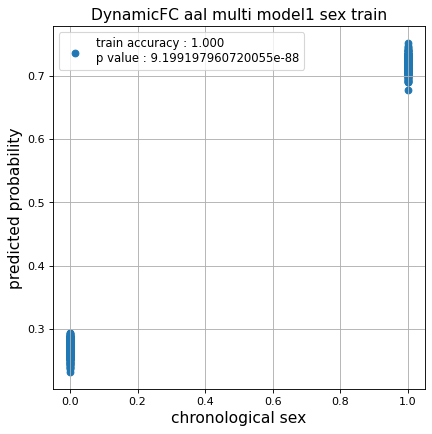

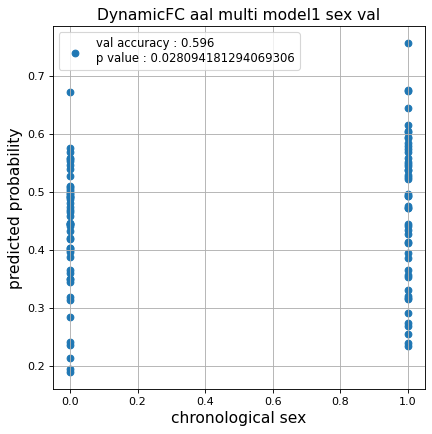

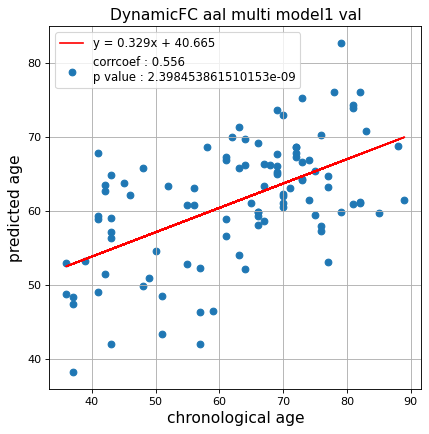

切片: 40.665253571579036
傾き: 0.3291408174040153
Kfold: 3 ::: epoch: 100, loss: 0.1713468191715387, val loss: 0.624229721724987
Kfold: 3 ::: epoch: 200, loss: 0.1488567808499703, val loss: 0.6016464456915855
Kfold: 3 ::: epoch: 300, loss: 0.14035227780158704, val loss: 0.5652234852313995
Kfold: 3 ::: epoch: 400, loss: 0.13371323851438668, val loss: 0.5574099123477936
Kfold: 3 ::: epoch: 500, loss: 0.13168831628102523, val loss: 0.5530892163515091
Kfold: 3 ::: epoch: 600, loss: 0.13034259929106787, val loss: 0.5169101431965828
Kfold: 3 ::: epoch: 700, loss: 0.13062181839576134, val loss: 0.503769613802433
save_epochs:655
best val loss:0.5016440004110336


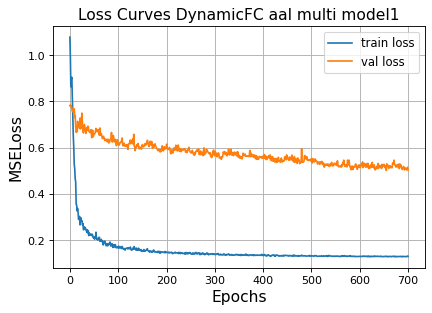

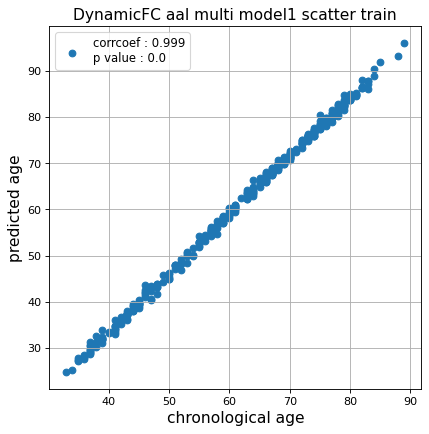

r^2 train data:  0.9215367614511251


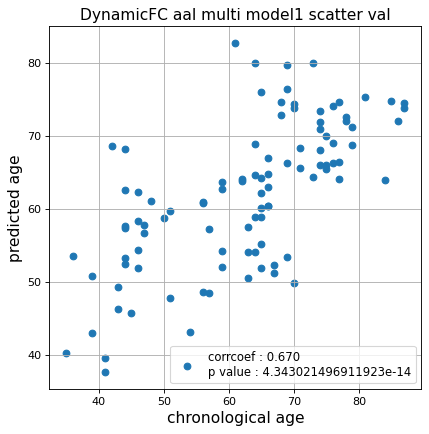

r^2 val data:  0.4401840789631535


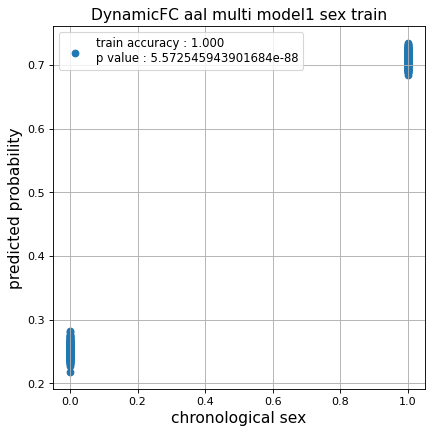

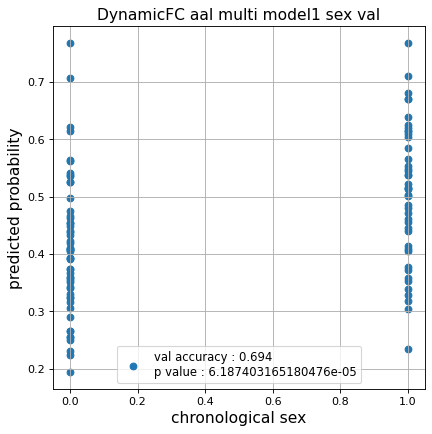

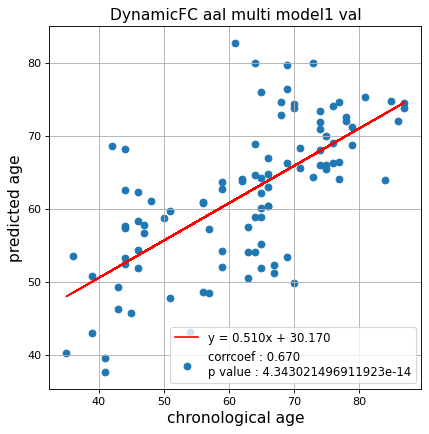

切片: 30.16979782273894
傾き: 0.5097907892052292
Kfold: 4 ::: epoch: 100, loss: 0.15969030444438642, val loss: 0.515267938375473
Kfold: 4 ::: epoch: 200, loss: 0.14629449523412263, val loss: 0.5125406309962273
Kfold: 4 ::: epoch: 300, loss: 0.13564429030968592, val loss: 0.49705297499895096
Kfold: 4 ::: epoch: 400, loss: 0.13162252192313856, val loss: 0.5035313963890076
Kfold: 4 ::: epoch: 500, loss: 0.12935851972836715, val loss: 0.5491710007190704
early stopping
save_epochs:331
best val loss:0.47635360062122345


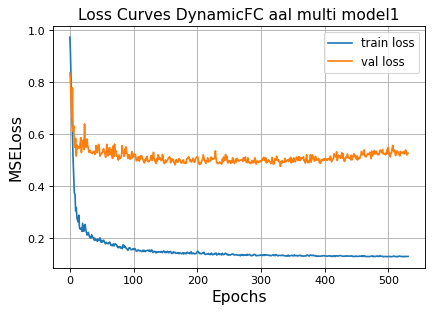

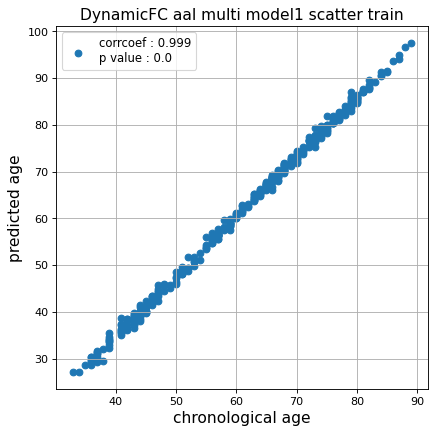

r^2 train data:  0.9120213982599595


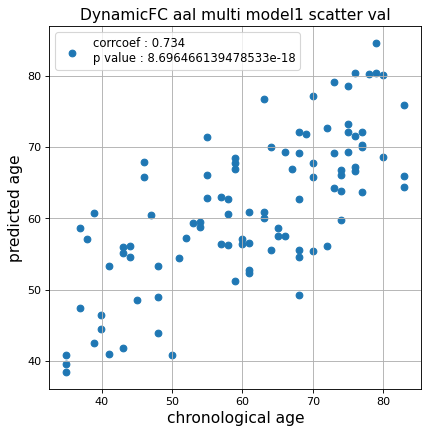

r^2 val data:  0.5358594226450758


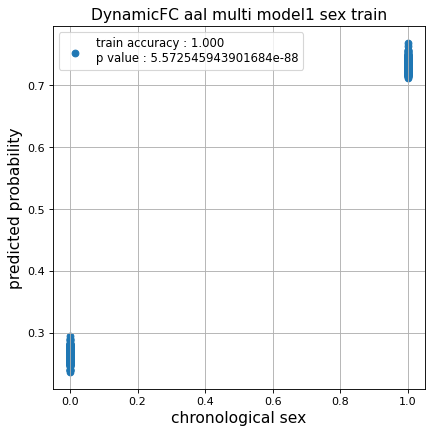

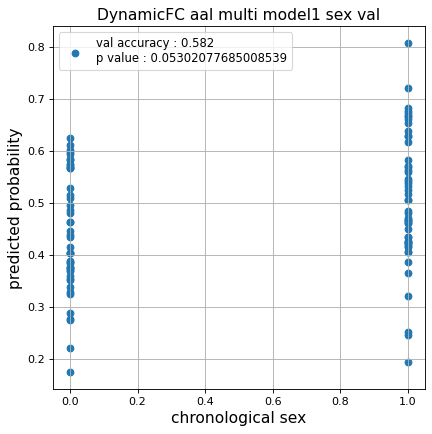

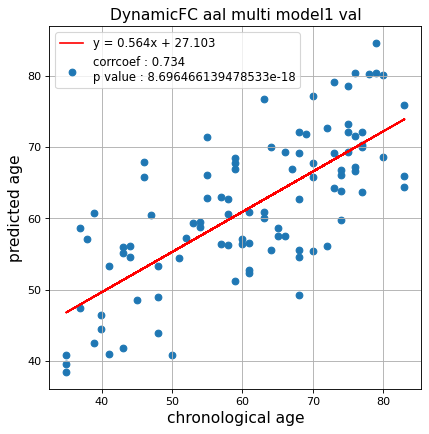

切片: 27.102573448772866
傾き: 0.5635329844538964
Kfold: 5 ::: epoch: 100, loss: 0.16056397098761338, val loss: 0.8634306192398071
Kfold: 5 ::: epoch: 200, loss: 0.14531984122899863, val loss: 0.8174069672822952
Kfold: 5 ::: epoch: 300, loss: 0.13493059346309075, val loss: 0.8430268615484238
Kfold: 5 ::: epoch: 400, loss: 0.13608331519823808, val loss: 0.8285404294729233
early stopping
save_epochs:226
best val loss:0.769755020737648


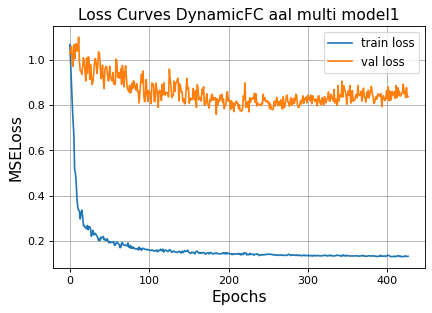

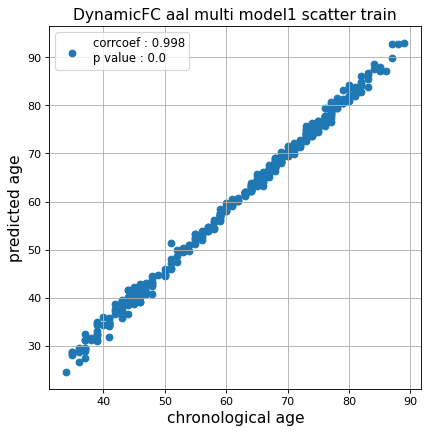

r^2 train data:  0.9415766252240333


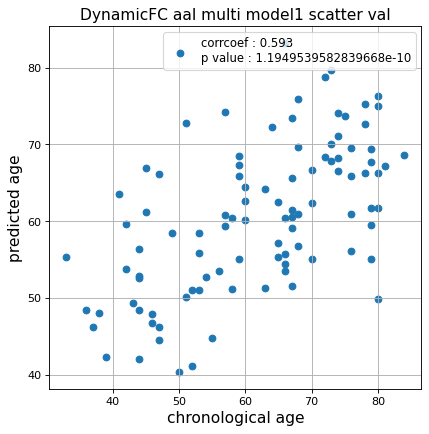

r^2 val data:  0.32358071237354935


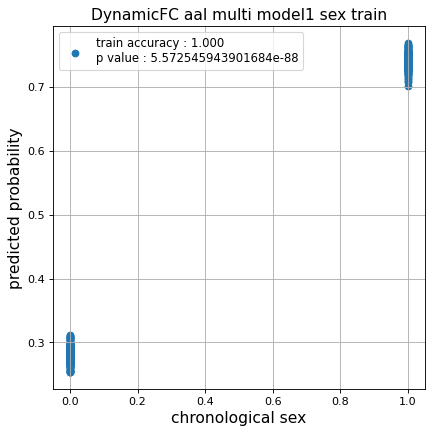

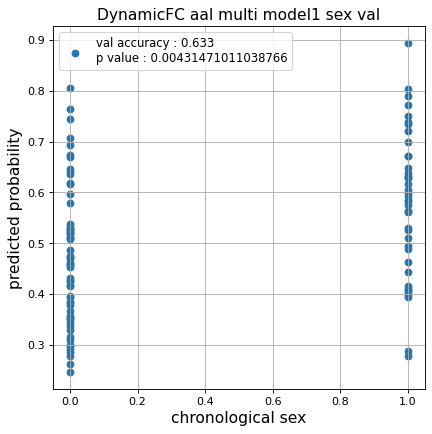

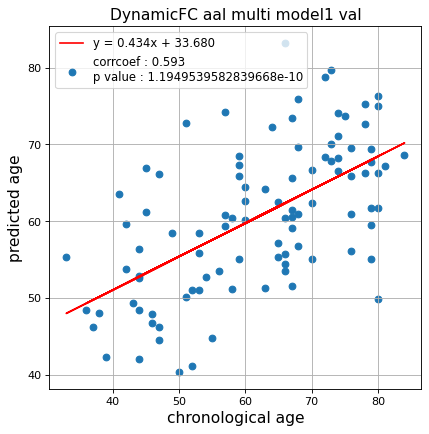

切片: 33.67955905124293
傾き: 0.4344063642274348
CPU times: user 22h 34min 29s, sys: 1min 45s, total: 22h 36min 15s
Wall time: 3h 17min 30s


In [21]:
%%time
fold = KFold(n_splits=n_splits,shuffle=False)

test_pred_aal_dynamic_1  = []
test_pred_aal_dynamic_corrected_1  = []
test_label_aal_dynamic_1 = []
test_idx_aal_dynamic_1   = []

for fold_idx, (train_idx, test_idx) in enumerate(fold.split(data_aal)):
    print(f'Nested Kfold ::: {fold_idx+1}')
    test_pred,test_pred_corrected,test_label = train_model(data_dynamic_aal,
                                                           data_label,
                                                           train_idx  = train_idx,
                                                           test_idx   = test_idx,
                                                           epochs     = 700,
                                                           d_model    = 64,
                                                           n_splits   = n_splits,
                                                           hidden_dim = 256,
                                                           nhead      = 2,#4
                                                           hidden_dim_transformer = 1,#2
                                                           pos_drop   = 0.3,
                                                           trans_drop = 0.5,
                                                           fc_drop = 0.3,
                                                           title = 'DynamicFC aal multi model1'
                                                          )
    
    test_pred_aal_dynamic_1.append(test_pred)
    test_pred_aal_dynamic_corrected_1.append(test_pred_corrected)
    test_label_aal_dynamic_1.append(test_label)
    test_idx_aal_dynamic_1.append(test_idx)

### Dynamic FC 2

Nested Kfold ::: 1
Kfold: 1 ::: epoch: 100, loss: 0.16098398543321168, val loss: 0.5990363210439682
Kfold: 1 ::: epoch: 200, loss: 0.14210382447792932, val loss: 0.5768908485770226
Kfold: 1 ::: epoch: 300, loss: 0.13662698979561144, val loss: 0.5818846970796585
Kfold: 1 ::: epoch: 400, loss: 0.13138051674916193, val loss: 0.5980996266007423
early stopping
save_epochs:210
best val loss:0.5562933757901192


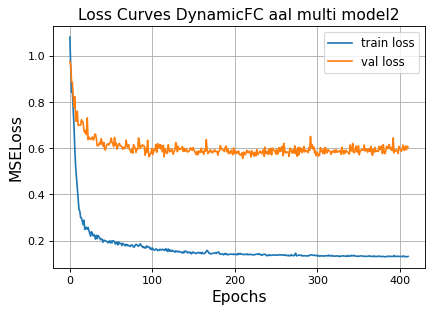

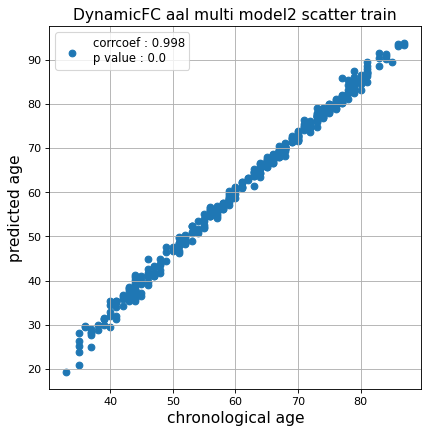

r^2 train data:  0.8882725932541107


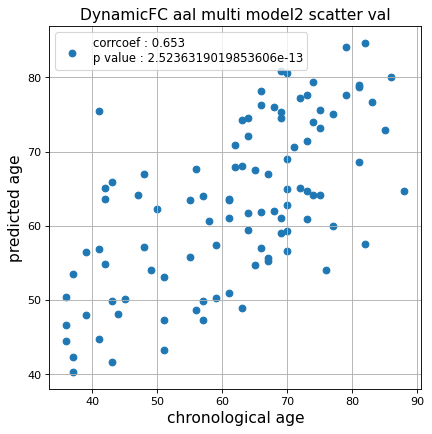

r^2 val data:  0.39894213183867944


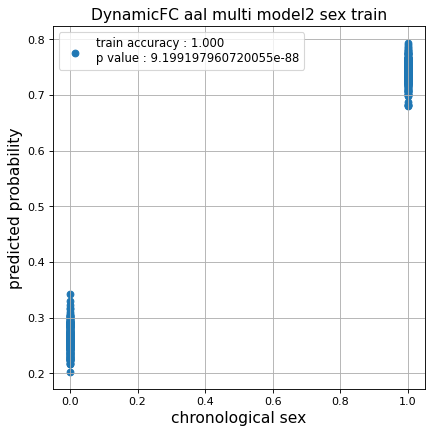

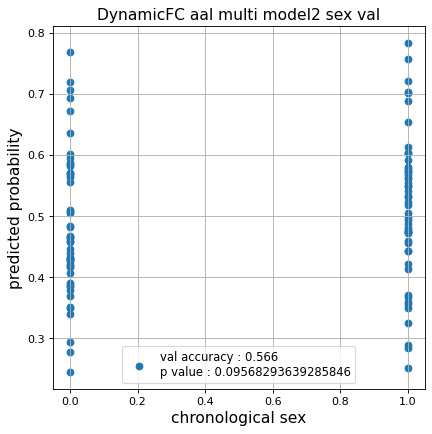

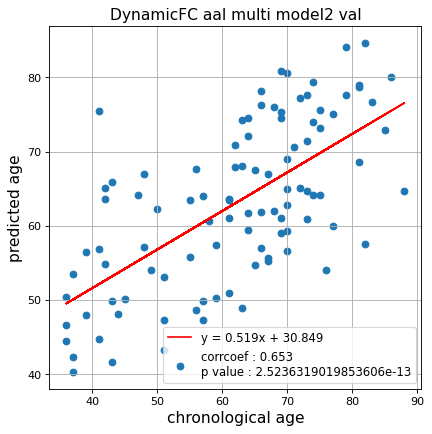

切片: 30.849405543284732
傾き: 0.5192702523864479
Kfold: 2 ::: epoch: 100, loss: 0.15642630136930025, val loss: 0.6056262105703354
Kfold: 2 ::: epoch: 200, loss: 0.13696209283975455, val loss: 0.5866536796092987
Kfold: 2 ::: epoch: 300, loss: 0.1313725056556555, val loss: 0.5535670220851898
Kfold: 2 ::: epoch: 400, loss: 0.12956235500482413, val loss: 0.5519071519374847
Kfold: 2 ::: epoch: 500, loss: 0.12831949843810156, val loss: 0.5381856709718704
Kfold: 2 ::: epoch: 600, loss: 0.12762963943756545, val loss: 0.5288396403193474
Kfold: 2 ::: epoch: 700, loss: 0.12717523483129647, val loss: 0.5176572650671005
save_epochs:639
best val loss:0.5085214897990227


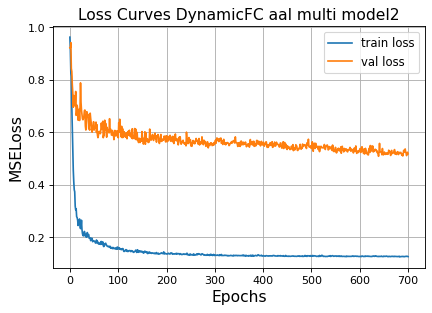

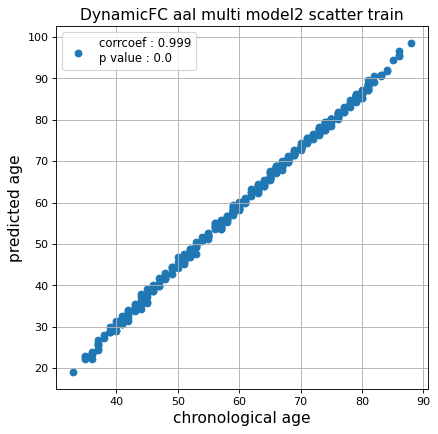

r^2 train data:  0.8252494912518058


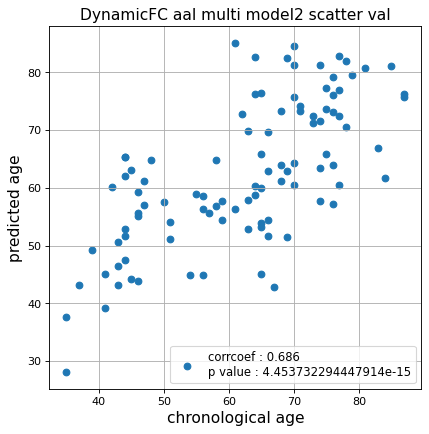

r^2 val data:  0.41645387266067246


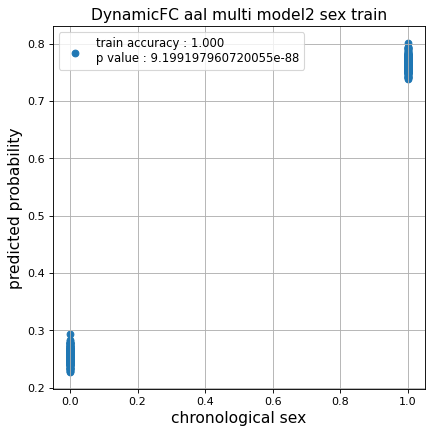

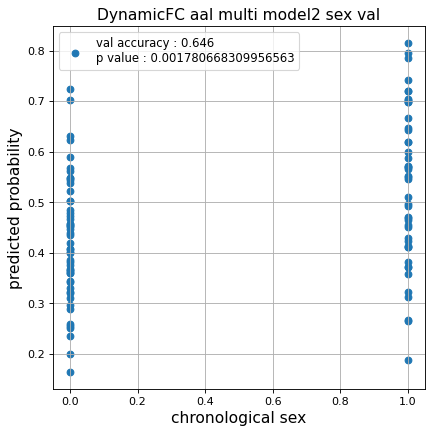

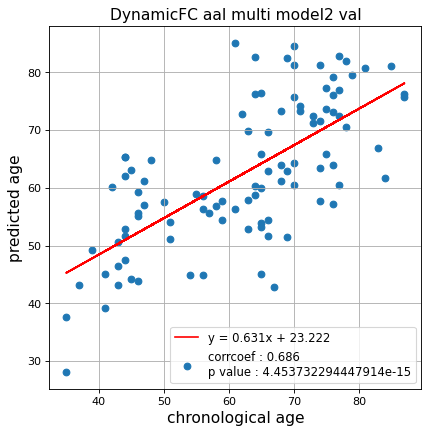

切片: 23.22230272385277
傾き: 0.6308939812838139
Kfold: 3 ::: epoch: 100, loss: 0.15776488070304578, val loss: 0.572787769138813
Kfold: 3 ::: epoch: 200, loss: 0.13794100857698, val loss: 0.5656602755188942
Kfold: 3 ::: epoch: 300, loss: 0.13518270162435678, val loss: 0.5737191922962666
Kfold: 3 ::: epoch: 400, loss: 0.13260978231063256, val loss: 0.5515713095664978
early stopping
save_epochs:212
best val loss:0.5411904789507389


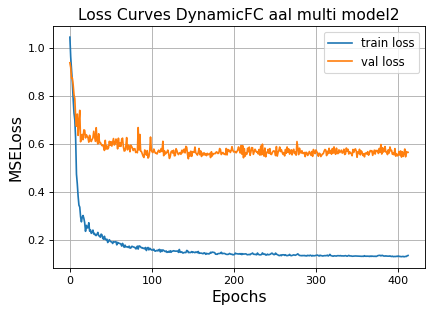

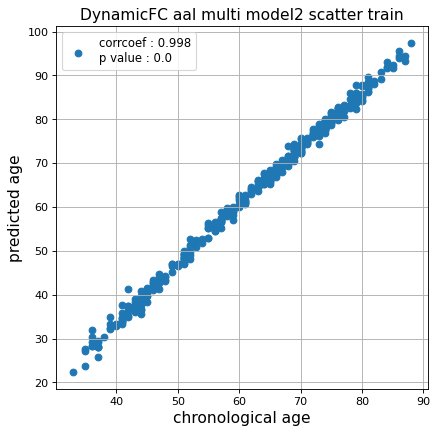

r^2 train data:  0.8844518733831336


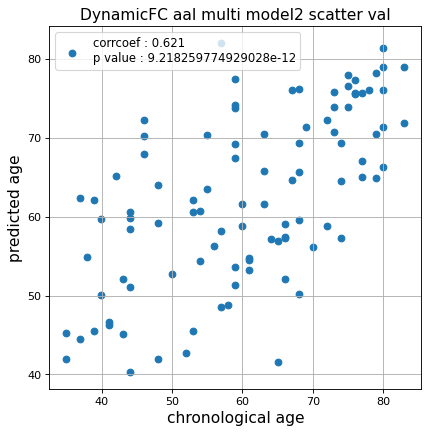

r^2 val data:  0.33368044898161786


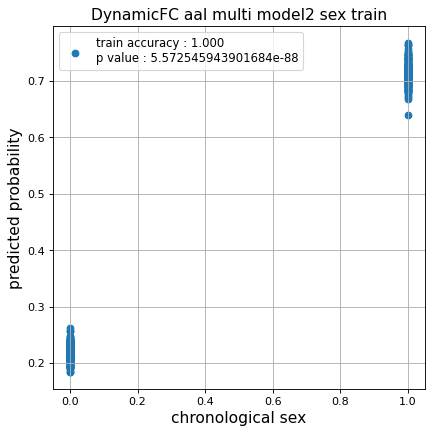

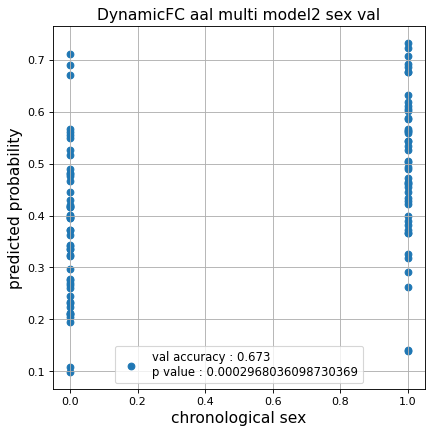

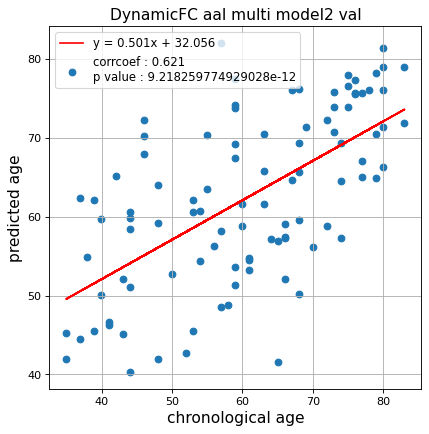

切片: 32.055996316596946
傾き: 0.50052232639244
Kfold: 4 ::: epoch: 100, loss: 0.15501869985690483, val loss: 0.6406889706850052
Kfold: 4 ::: epoch: 200, loss: 0.13949596194120553, val loss: 0.6291264295578003
Kfold: 4 ::: epoch: 300, loss: 0.1344072142472634, val loss: 0.6257080137729645
Kfold: 4 ::: epoch: 400, loss: 0.13163261917921212, val loss: 0.6304912865161896
Kfold: 4 ::: epoch: 500, loss: 0.1292688915362725, val loss: 0.5888342335820198
early stopping
save_epochs:395
best val loss:0.5745462253689766


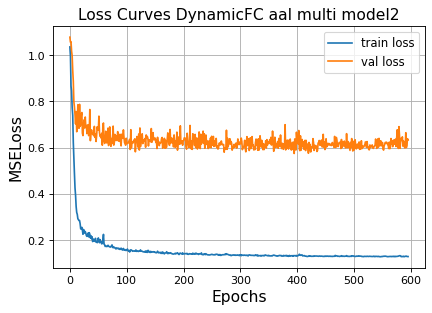

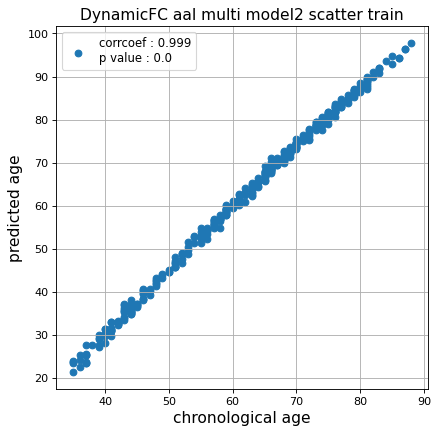

r^2 train data:  0.8026861237688612


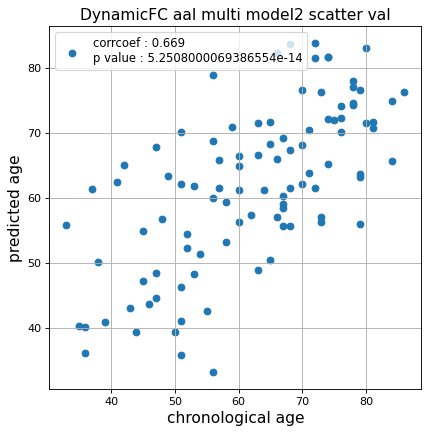

r^2 val data:  0.3780223148739287


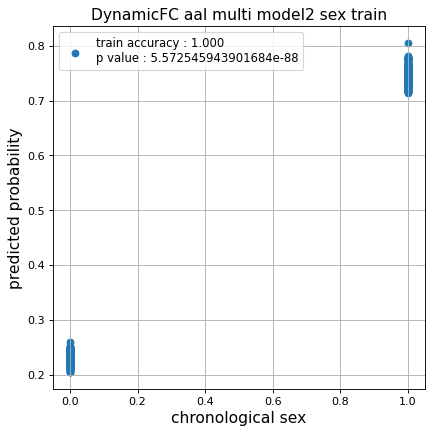

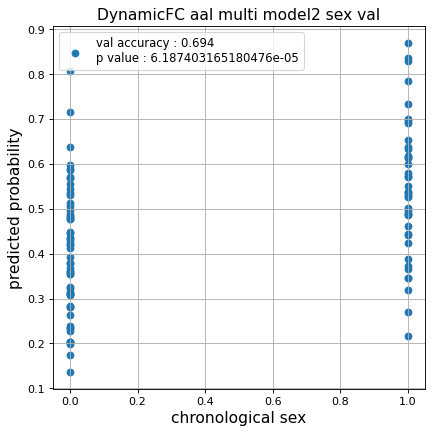

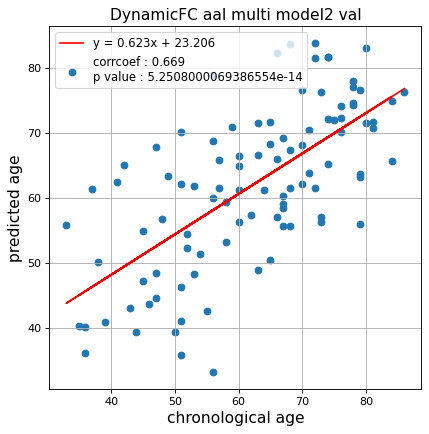

切片: 23.205555899654563
傾き: 0.6229798845911259
Kfold: 5 ::: epoch: 100, loss: 0.17268595901819375, val loss: 0.7413288876414299
Kfold: 5 ::: epoch: 200, loss: 0.14415212548696077, val loss: 0.6631896123290062
Kfold: 5 ::: epoch: 300, loss: 0.13751567556307867, val loss: 0.6385896280407906
Kfold: 5 ::: epoch: 400, loss: 0.13164542386165032, val loss: 0.6154548227787018
Kfold: 5 ::: epoch: 500, loss: 0.1297239764378621, val loss: 0.6169446185231209
Kfold: 5 ::: epoch: 600, loss: 0.13269484845491555, val loss: 0.5884478613734245
Kfold: 5 ::: epoch: 700, loss: 0.12911730775466332, val loss: 0.6057279147207737
save_epochs:652
best val loss:0.5787643641233444


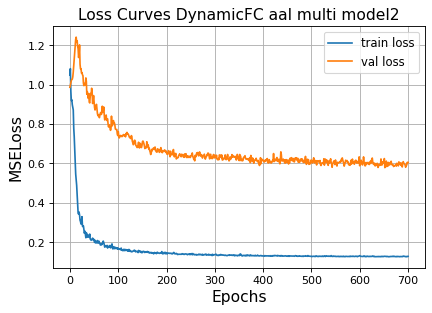

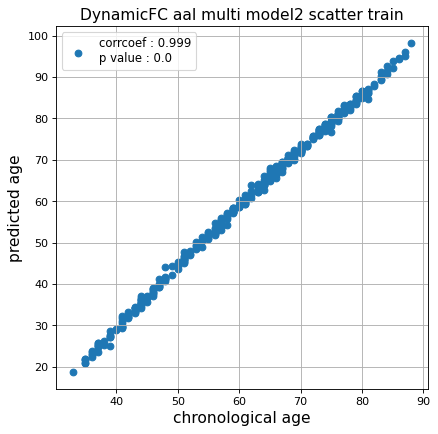

r^2 train data:  0.817149886851446


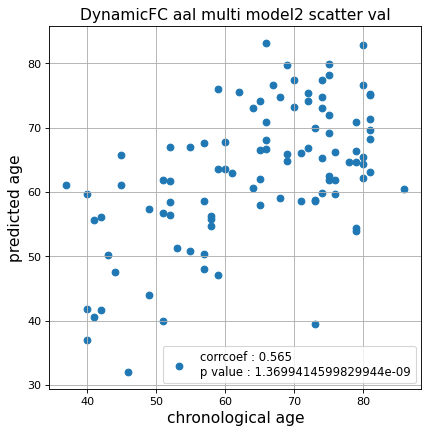

r^2 val data:  0.22536280187788704


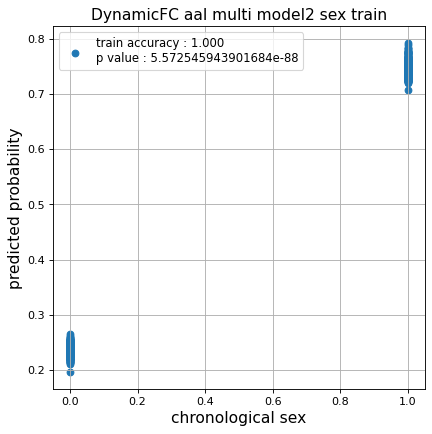

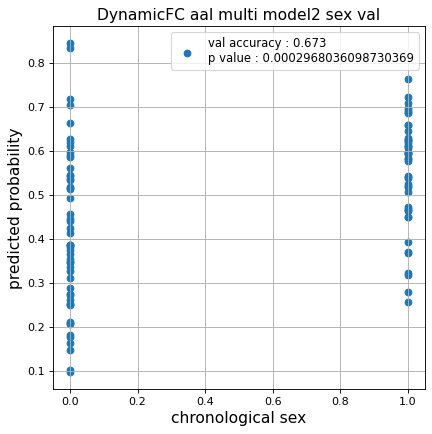

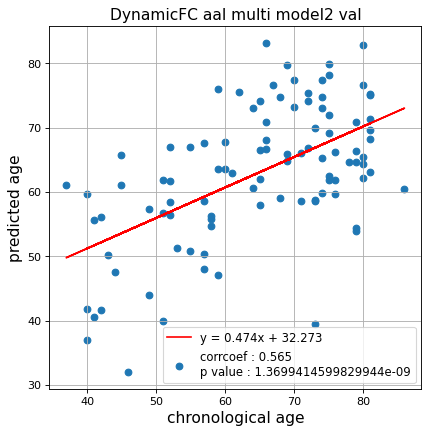

切片: 32.273134568198806
傾き: 0.47377735438306695
Nested Kfold ::: 2
Kfold: 1 ::: epoch: 100, loss: 0.16456409715689146, val loss: 0.7045793533325195
Kfold: 1 ::: epoch: 200, loss: 0.14270854454774123, val loss: 0.7006598860025406
Kfold: 1 ::: epoch: 300, loss: 0.13855295112499824, val loss: 0.7453033924102783
Kfold: 1 ::: epoch: 400, loss: 0.13190103723452642, val loss: 0.7606769800186157
early stopping
save_epochs:202
best val loss:0.6866967082023621


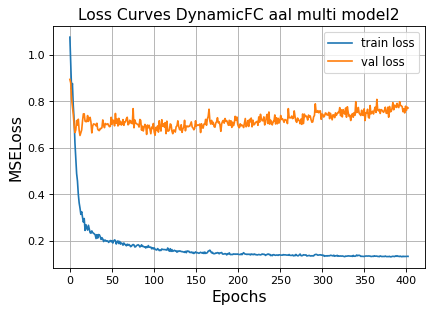

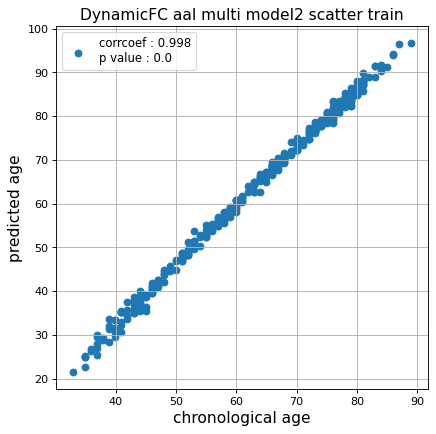

r^2 train data:  0.8716206837773262


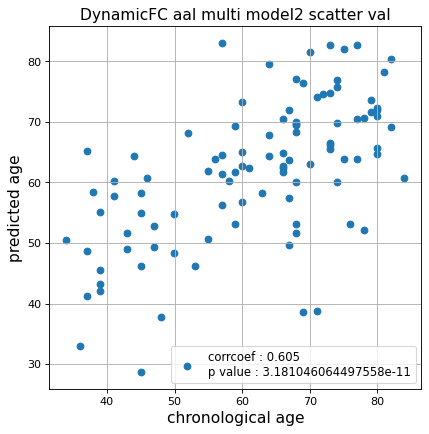

r^2 val data:  0.3052200914370682


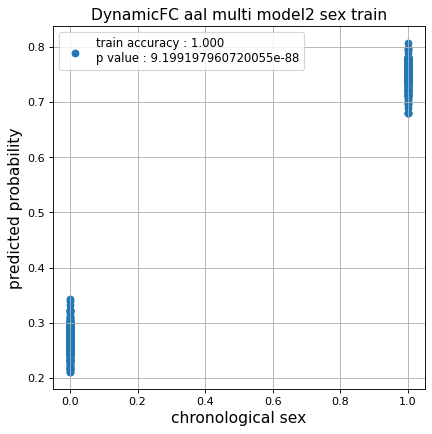

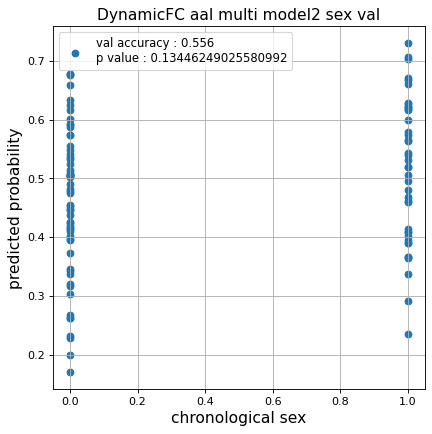

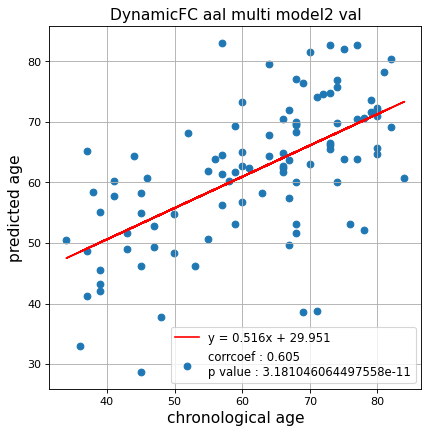

切片: 29.951121181507148
傾き: 0.5163694548890186
Kfold: 2 ::: epoch: 100, loss: 0.15381323030361763, val loss: 0.7167265564203262
Kfold: 2 ::: epoch: 200, loss: 0.13788270835693067, val loss: 0.7151684463024139
Kfold: 2 ::: epoch: 300, loss: 0.13535303106674781, val loss: 0.6814354136586189
Kfold: 2 ::: epoch: 400, loss: 0.13183138691462004, val loss: 0.7013869360089302
early stopping
save_epochs:286
best val loss:0.6521770134568214


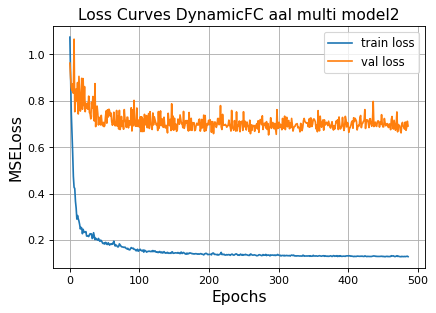

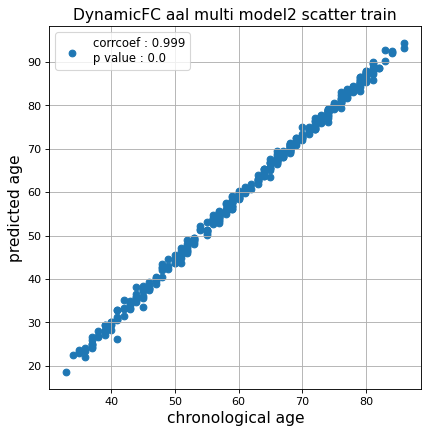

r^2 train data:  0.8132275006031404


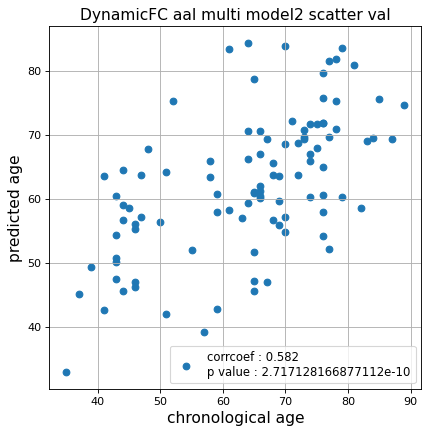

r^2 val data:  0.2708037339363345


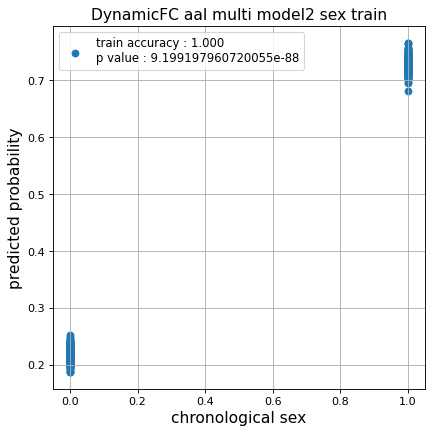

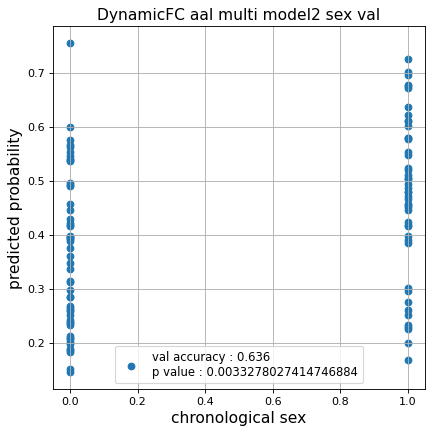

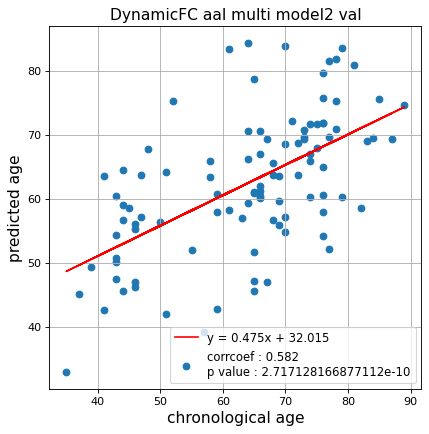

切片: 32.01491100088742
傾き: 0.47533611498226275
Kfold: 3 ::: epoch: 100, loss: 0.16437773979627168, val loss: 0.7545453608036041
Kfold: 3 ::: epoch: 200, loss: 0.1530569058198195, val loss: 0.726191058754921
Kfold: 3 ::: epoch: 300, loss: 0.13753353747037741, val loss: 0.6817674338817596
Kfold: 3 ::: epoch: 400, loss: 0.13241383891839248, val loss: 0.6331477463245392
Kfold: 3 ::: epoch: 500, loss: 0.13064923882484436, val loss: 0.5865985527634621
Kfold: 3 ::: epoch: 600, loss: 0.12833116146234366, val loss: 0.564078152179718
Kfold: 3 ::: epoch: 700, loss: 0.1286471692415384, val loss: 0.5381939634680748
save_epochs:651
best val loss:0.5257451385259628


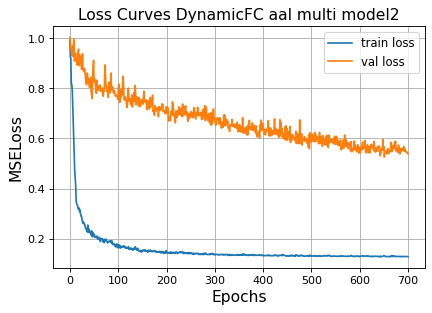

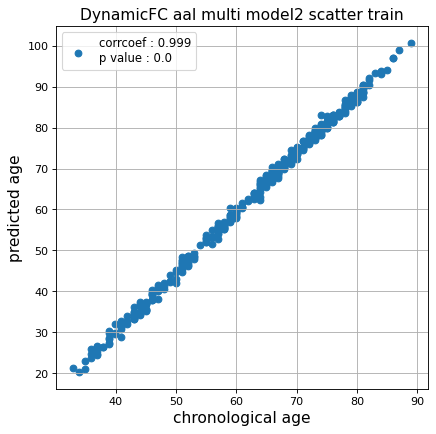

r^2 train data:  0.7867001026666444


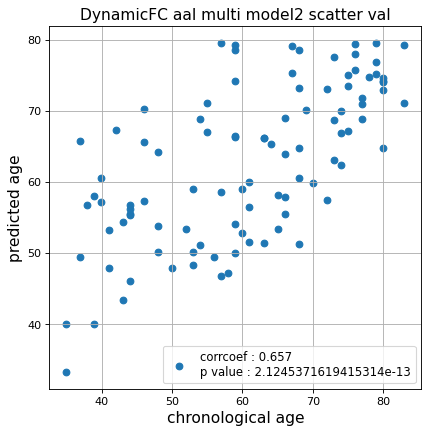

r^2 val data:  0.3871368488784894


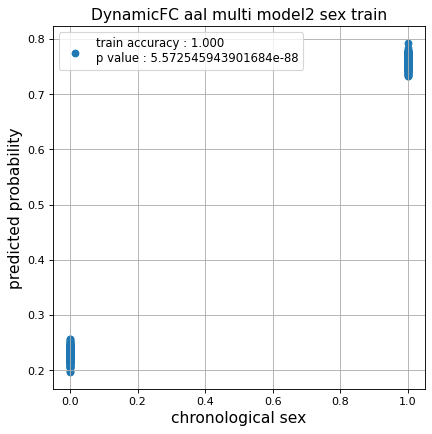

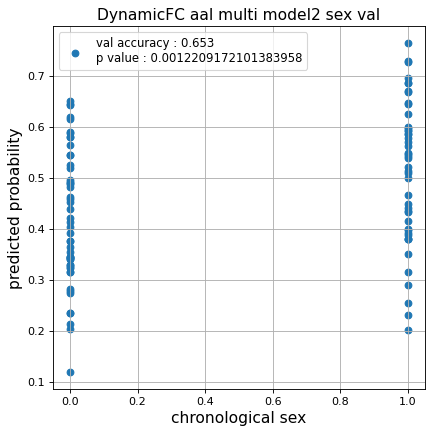

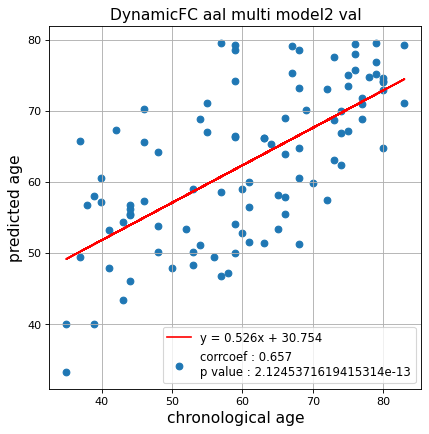

切片: 30.753836874429414
傾き: 0.5264821816042317
Kfold: 4 ::: epoch: 100, loss: 0.15941719023080972, val loss: 0.8048734962940216
Kfold: 4 ::: epoch: 200, loss: 0.13729485869407654, val loss: 0.7562891840934753
Kfold: 4 ::: epoch: 300, loss: 0.13344818812150222, val loss: 0.7964939773082733
Kfold: 4 ::: epoch: 400, loss: 0.13237232313706324, val loss: 0.8467485010623932
early stopping
save_epochs:222
best val loss:0.7588665187358856


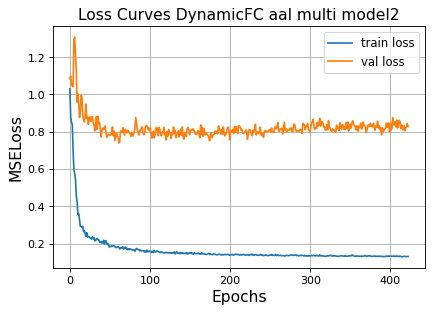

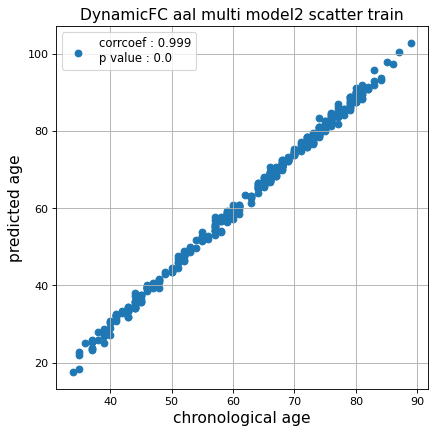

r^2 train data:  0.7587462701068061


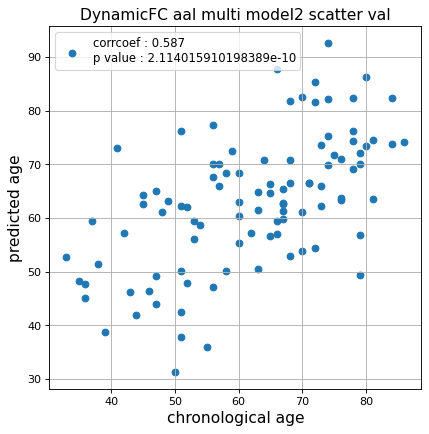

r^2 val data:  0.2249472845022088


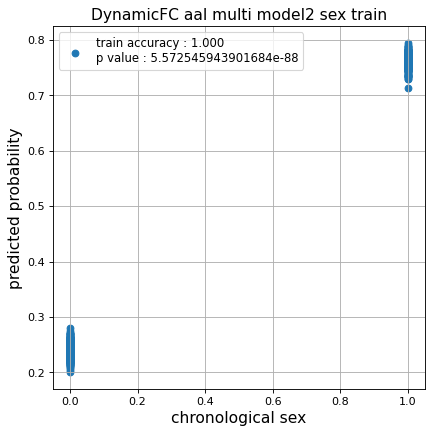

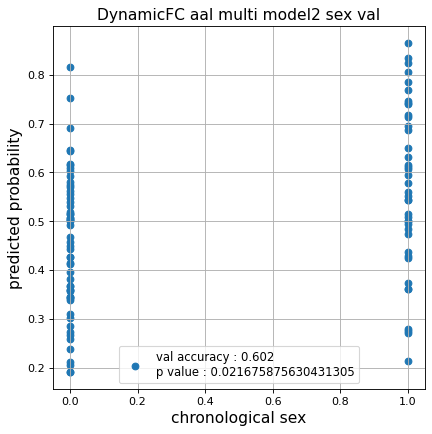

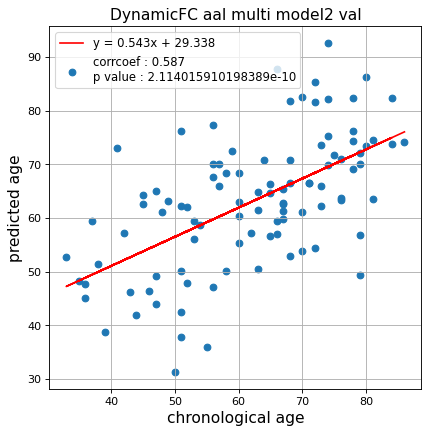

切片: 29.337788823161972
傾き: 0.5429753252494083
Kfold: 5 ::: epoch: 100, loss: 0.1578809813811229, val loss: 0.7222407311201096
Kfold: 5 ::: epoch: 200, loss: 0.14305692338026488, val loss: 0.7083605900406837
Kfold: 5 ::: epoch: 300, loss: 0.13330678871044746, val loss: 0.7304803133010864
Kfold: 5 ::: epoch: 400, loss: 0.1314878796155636, val loss: 0.7029039785265923
early stopping
save_epochs:221
best val loss:0.6720884963870049


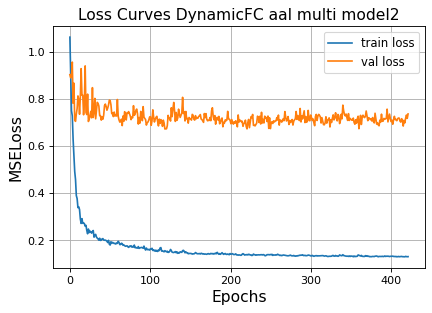

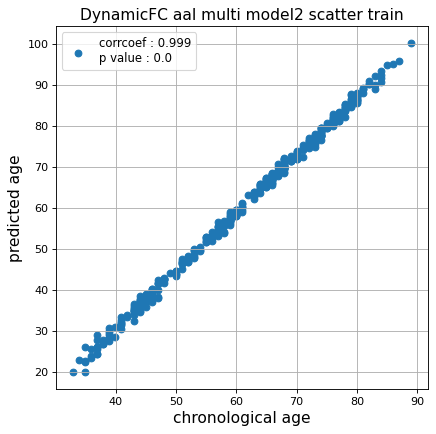

r^2 train data:  0.8274983698122963


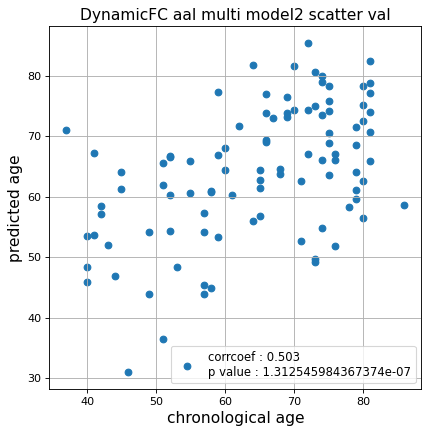

r^2 val data:  0.12418183318927789


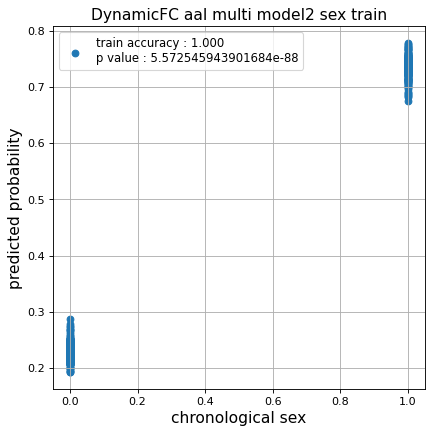

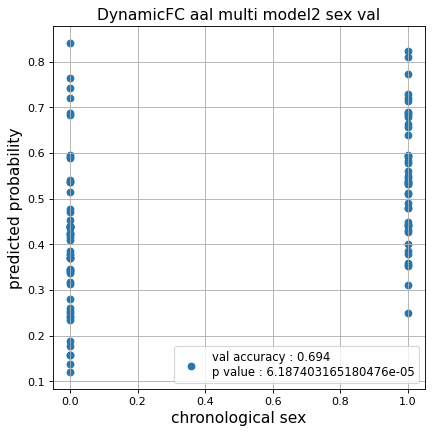

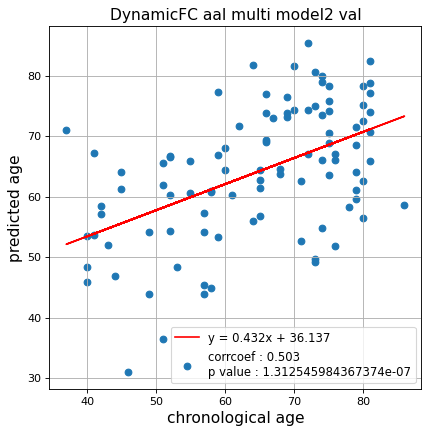

切片: 36.137178008384076
傾き: 0.43179192319838244
Nested Kfold ::: 3
Kfold: 1 ::: epoch: 100, loss: 0.16107547168548292, val loss: 0.662850484251976
Kfold: 1 ::: epoch: 200, loss: 0.14258256669227892, val loss: 0.7022219151258469
Kfold: 1 ::: epoch: 300, loss: 0.13716131792618677, val loss: 0.7619998306035995
Kfold: 1 ::: epoch: 400, loss: 0.1339265566605788, val loss: 0.7856450229883194
early stopping
save_epochs:207
best val loss:0.6782005131244659


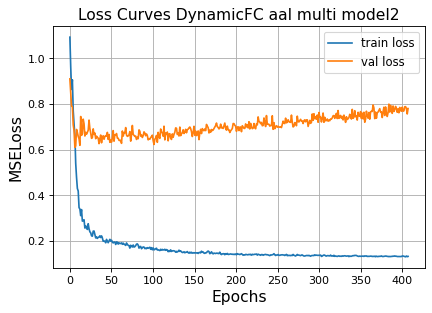

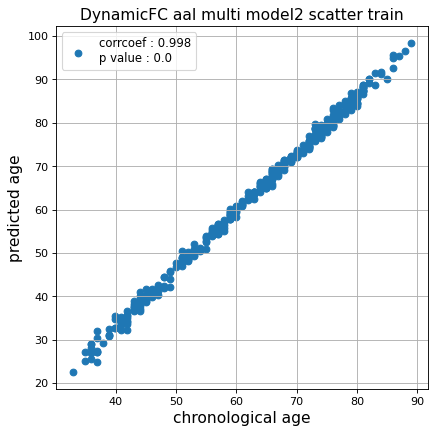

r^2 train data:  0.8840242833655422


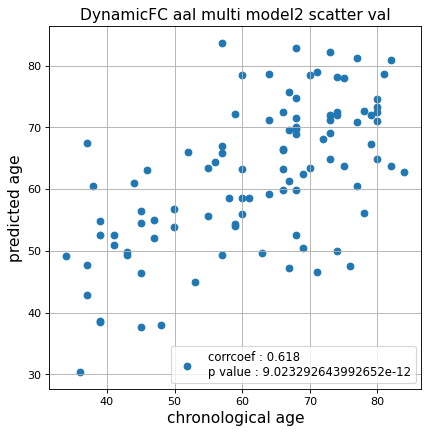

r^2 val data:  0.32640325068270837


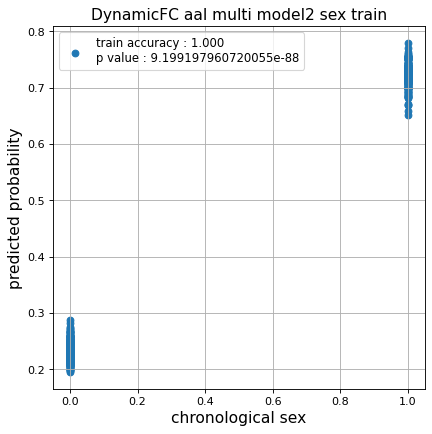

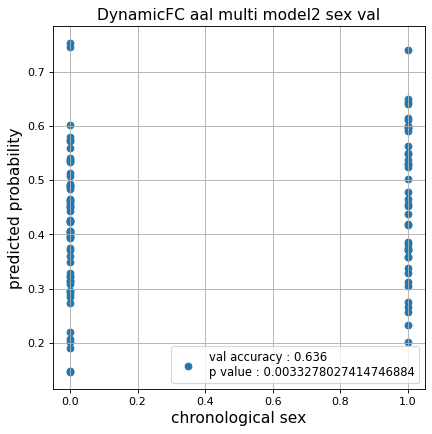

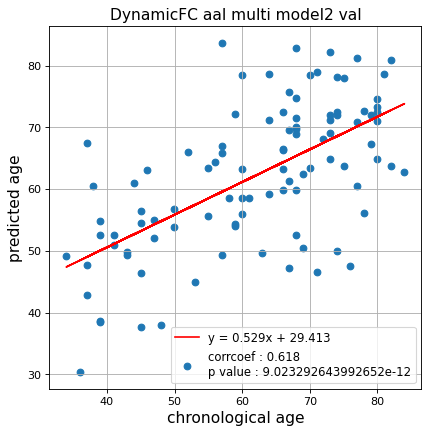

切片: 29.41268588487516
傾き: 0.5287314322570044
Kfold: 2 ::: epoch: 100, loss: 0.1600798494540728, val loss: 0.6010151281952858
Kfold: 2 ::: epoch: 200, loss: 0.13909286031356224, val loss: 0.6034340634942055
Kfold: 2 ::: epoch: 300, loss: 0.13466278177041274, val loss: 0.6308282315731049
Kfold: 2 ::: epoch: 400, loss: 0.13017112360550806, val loss: 0.6638547629117966
early stopping
save_epochs:203
best val loss:0.5983209908008575


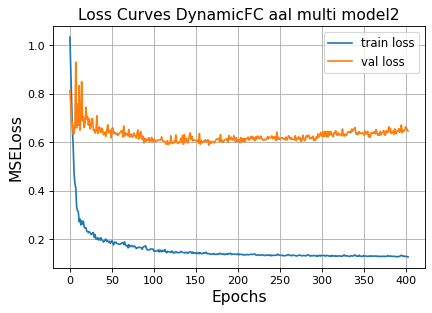

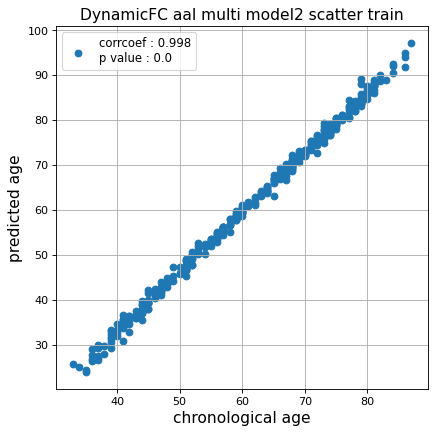

r^2 train data:  0.8836479654070863


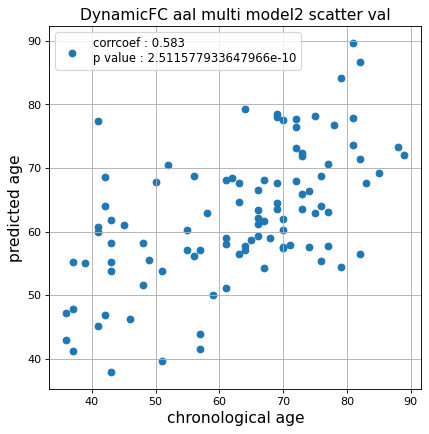

r^2 val data:  0.31249130813522374


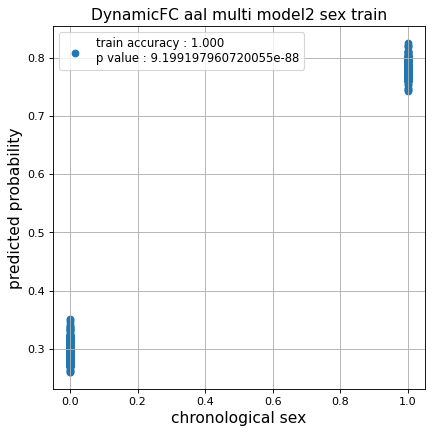

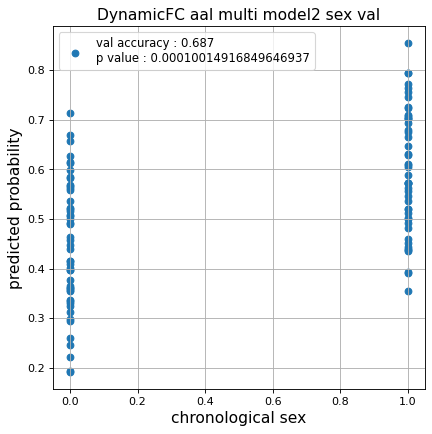

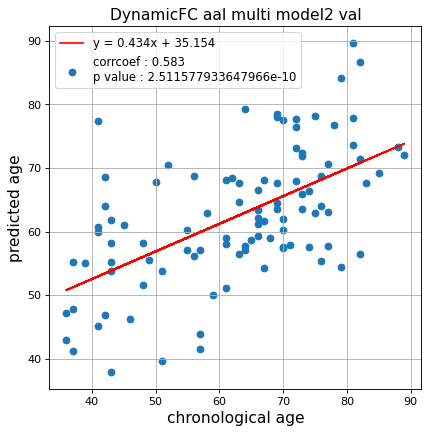

切片: 35.15390764292522
傾き: 0.43436997226649354
Kfold: 3 ::: epoch: 100, loss: 0.15771516928305992, val loss: 0.6280816495418549
Kfold: 3 ::: epoch: 200, loss: 0.13869320773161375, val loss: 0.54268778860569
Kfold: 3 ::: epoch: 300, loss: 0.13416699262765738, val loss: 0.6239592730998993
Kfold: 3 ::: epoch: 400, loss: 0.131768334370393, val loss: 0.5811103284358978
Kfold: 3 ::: epoch: 500, loss: 0.12977759883953974, val loss: 0.560207337141037
Kfold: 3 ::: epoch: 600, loss: 0.12782572782956636, val loss: 0.5435040444135666
early stopping
save_epochs:434
best val loss:0.5233142822980881


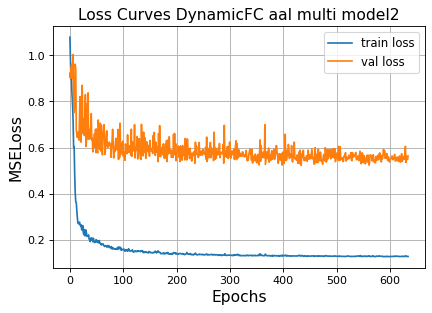

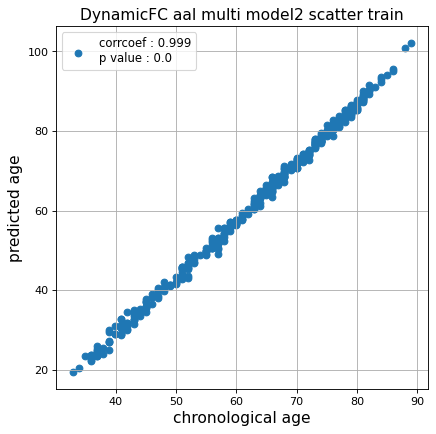

r^2 train data:  0.7860284799938413


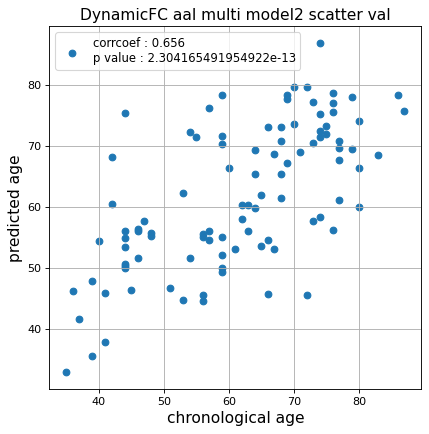

r^2 val data:  0.3760669640172005


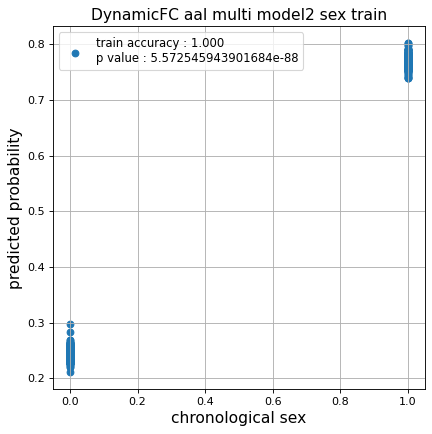

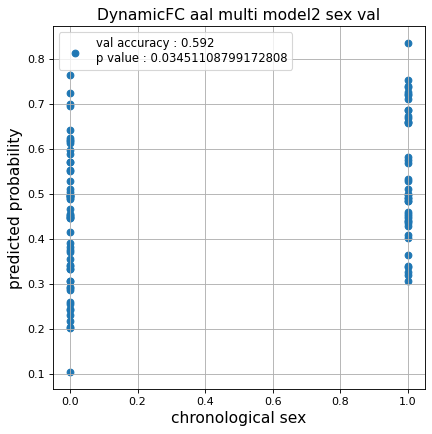

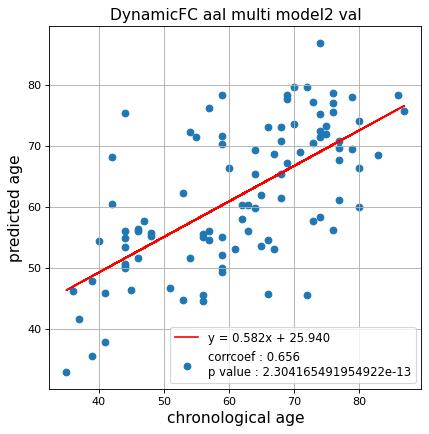

切片: 25.940054491699108
傾き: 0.5821232107696926
Kfold: 4 ::: epoch: 100, loss: 0.1562850188750487, val loss: 0.8314023464918137
Kfold: 4 ::: epoch: 200, loss: 0.13856289593073037, val loss: 0.874650239944458
Kfold: 4 ::: epoch: 300, loss: 0.13367882370948792, val loss: 0.8244109749794006
Kfold: 4 ::: epoch: 400, loss: 0.13246609155948347, val loss: 0.8342663496732712
Kfold: 4 ::: epoch: 500, loss: 0.12877563215219057, val loss: 0.8972294181585312
early stopping
save_epochs:302
best val loss:0.7807306498289108


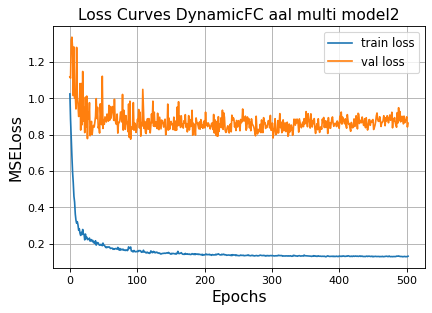

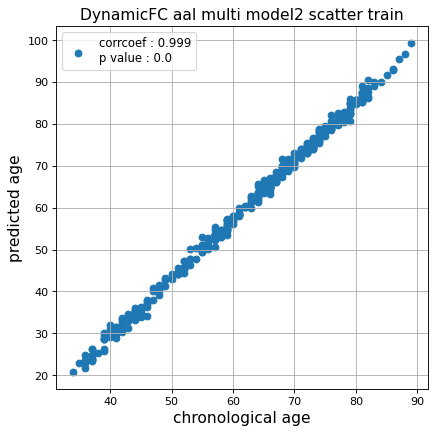

r^2 train data:  0.8160512392132979


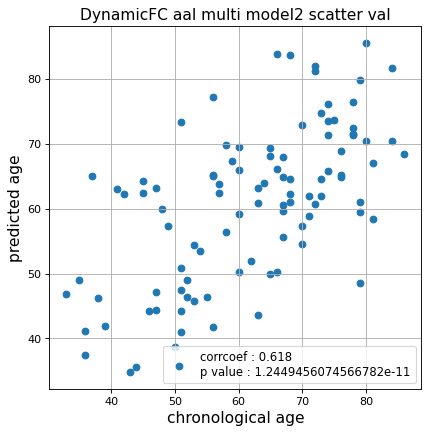

r^2 val data:  0.295166020260741


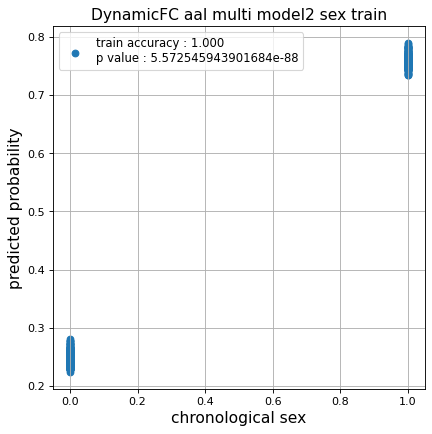

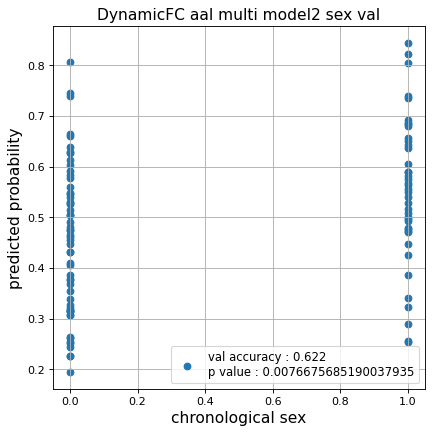

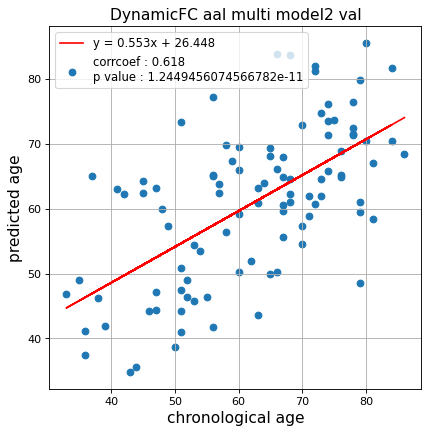

切片: 26.448342123030677
傾き: 0.5531116385978772
Kfold: 5 ::: epoch: 100, loss: 0.1718273082604775, val loss: 0.6174158155918121
Kfold: 5 ::: epoch: 200, loss: 0.1420985093483558, val loss: 0.5611674301326275
Kfold: 5 ::: epoch: 300, loss: 0.13401116889256698, val loss: 0.5662448480725288
Kfold: 5 ::: epoch: 400, loss: 0.13091212511062622, val loss: 0.5563739761710167
Kfold: 5 ::: epoch: 500, loss: 0.12936457647727087, val loss: 0.5890484265983105
Kfold: 5 ::: epoch: 600, loss: 0.1319036094041971, val loss: 0.5870759934186935
early stopping
save_epochs:438
best val loss:0.5234273467212915


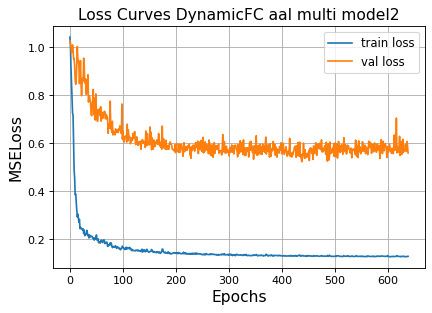

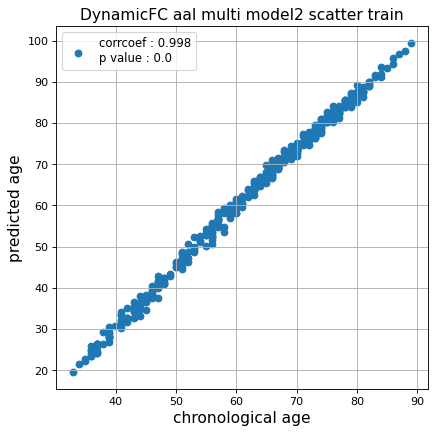

r^2 train data:  0.8080099591500916


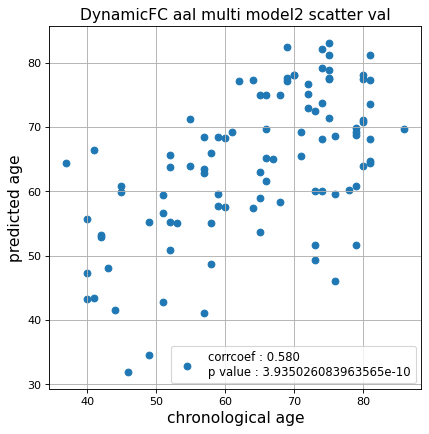

r^2 val data:  0.23593663585371438


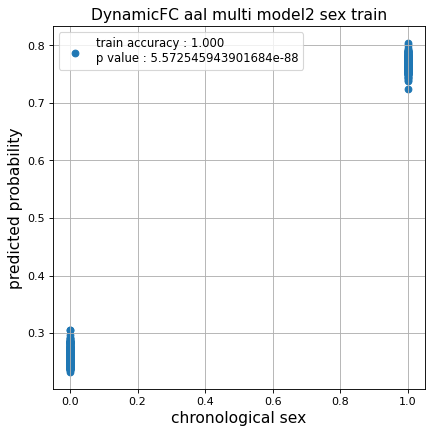

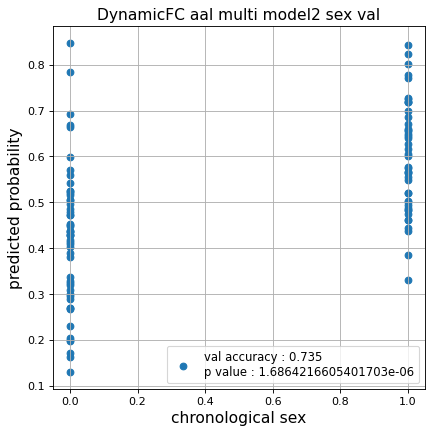

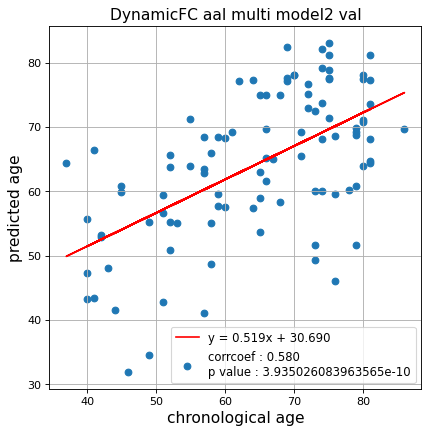

切片: 30.689678401337538
傾き: 0.5189030821136185
Nested Kfold ::: 4
Kfold: 1 ::: epoch: 100, loss: 0.16424794838978693, val loss: 0.6784483417868614
Kfold: 1 ::: epoch: 200, loss: 0.143284138578635, val loss: 0.6787565499544144
Kfold: 1 ::: epoch: 300, loss: 0.13712472869799688, val loss: 0.6875062361359596
Kfold: 1 ::: epoch: 400, loss: 0.13388039286320025, val loss: 0.7306423187255859
early stopping
save_epochs:252
best val loss:0.6388237848877907


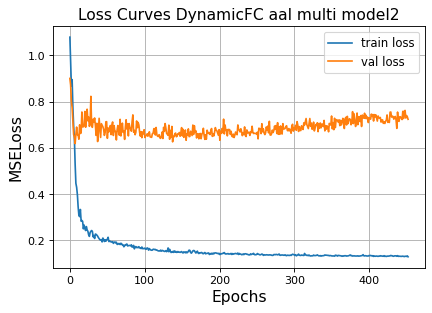

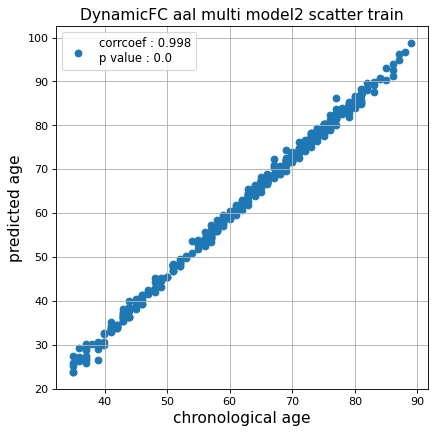

r^2 train data:  0.878120615392996


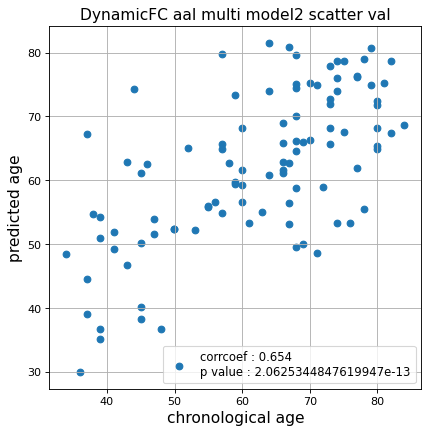

r^2 val data:  0.38564631624791734


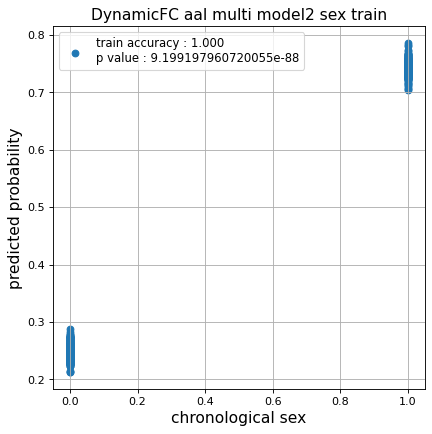

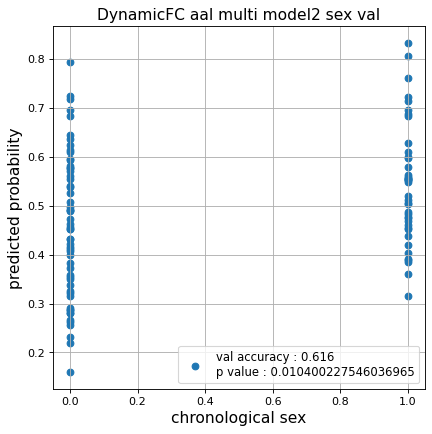

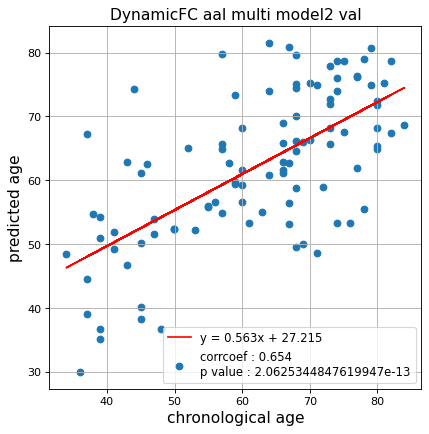

切片: 27.215374457585064
傾き: 0.562931033341833
Kfold: 2 ::: epoch: 100, loss: 0.15975609994851625, val loss: 0.8411572426557541
Kfold: 2 ::: epoch: 200, loss: 0.14162039642150587, val loss: 0.7861218303442001
Kfold: 2 ::: epoch: 300, loss: 0.13524489792493674, val loss: 0.7789480686187744
Kfold: 2 ::: epoch: 400, loss: 0.13173569853489214, val loss: 0.785162940621376
Kfold: 2 ::: epoch: 500, loss: 0.129381279532726, val loss: 0.8016289174556732
early stopping
save_epochs:351
best val loss:0.7250806391239166


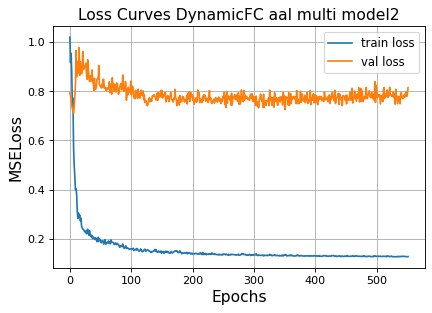

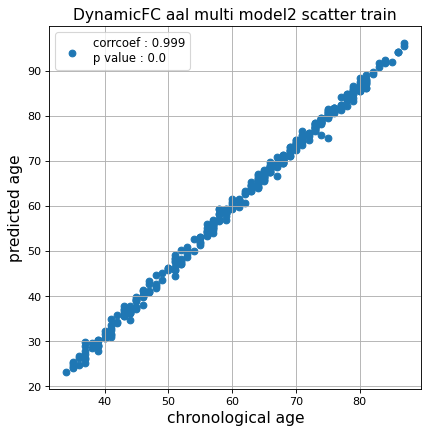

r^2 train data:  0.8528081040862537


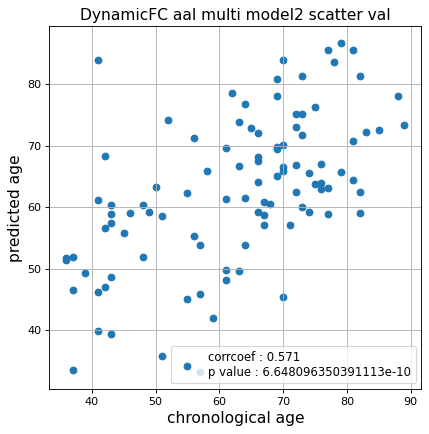

r^2 val data:  0.24249184064300566


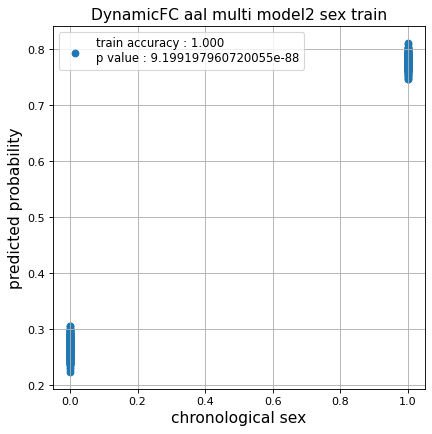

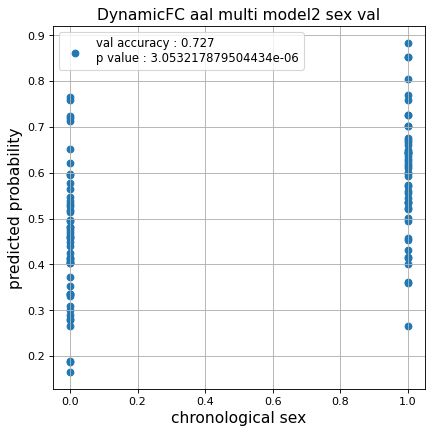

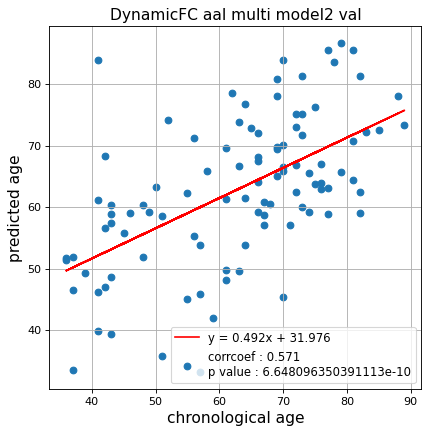

切片: 31.976215525837024
傾き: 0.4915773470038245
Kfold: 3 ::: epoch: 100, loss: 0.16393413566626036, val loss: 0.6994649171829224
Kfold: 3 ::: epoch: 200, loss: 0.14111376611086038, val loss: 0.6607176512479782
Kfold: 3 ::: epoch: 300, loss: 0.13697961889780486, val loss: 0.6477671563625336
Kfold: 3 ::: epoch: 400, loss: 0.1317745607632857, val loss: 0.5744837671518326
Kfold: 3 ::: epoch: 500, loss: 0.1324885946053725, val loss: 0.573512502014637
Kfold: 3 ::: epoch: 600, loss: 0.1298062102152751, val loss: 0.5646776407957077
early stopping
save_epochs:413
best val loss:0.5547229051589966


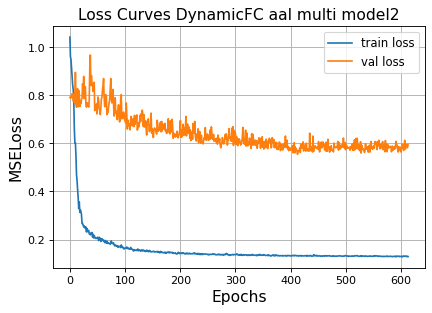

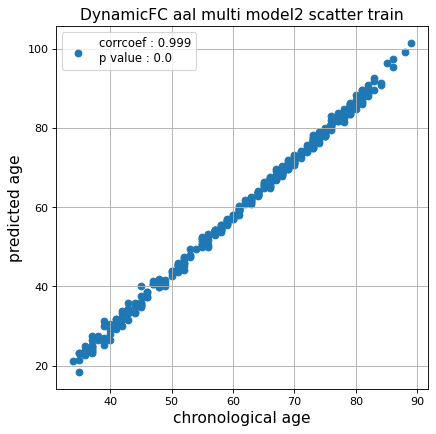

r^2 train data:  0.8020434955179514


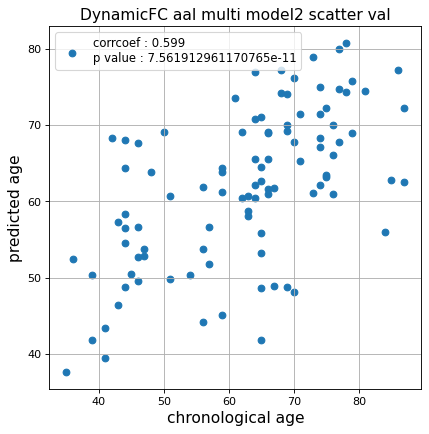

r^2 val data:  0.3275898751535232


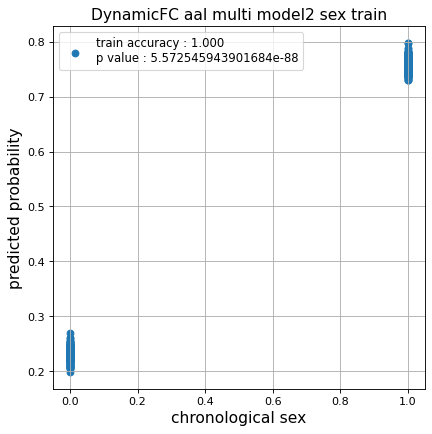

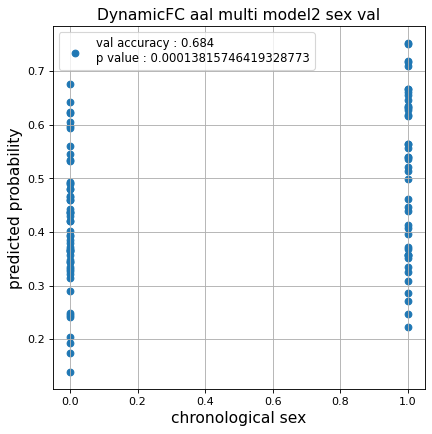

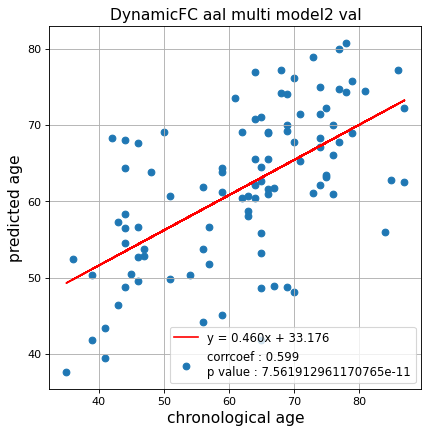

切片: 33.17614356321073
傾き: 0.46031725454878497
Kfold: 4 ::: epoch: 100, loss: 0.16868244111537933, val loss: 0.87960085272789
Kfold: 4 ::: epoch: 200, loss: 0.1469416469335556, val loss: 0.768549457192421
Kfold: 4 ::: epoch: 300, loss: 0.13755527826455924, val loss: 0.7326981648802757
Kfold: 4 ::: epoch: 400, loss: 0.13580790505959436, val loss: 0.6989448592066765
Kfold: 4 ::: epoch: 500, loss: 0.13035345192138964, val loss: 0.7693416699767113
Kfold: 4 ::: epoch: 600, loss: 0.1288295009961495, val loss: 0.7347423061728477
early stopping
save_epochs:427
best val loss:0.683874137699604


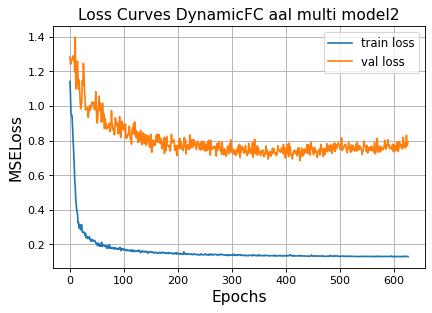

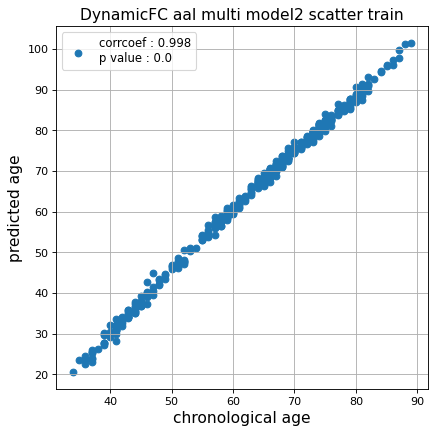

r^2 train data:  0.766937585507508


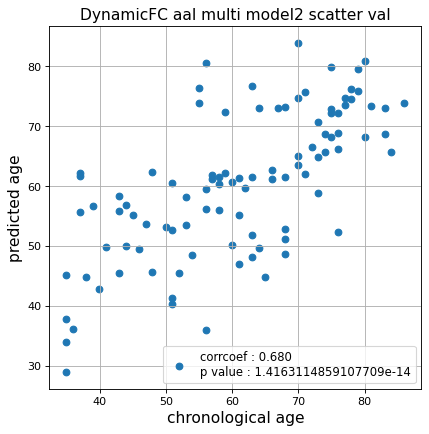

r^2 val data:  0.42664399225003846


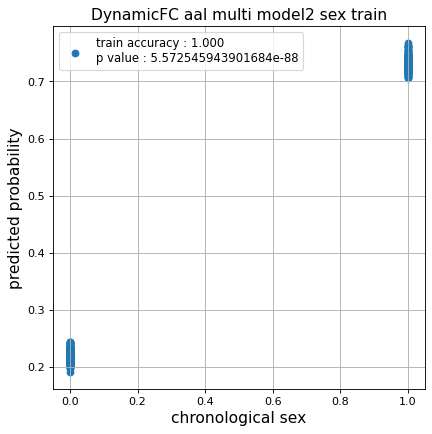

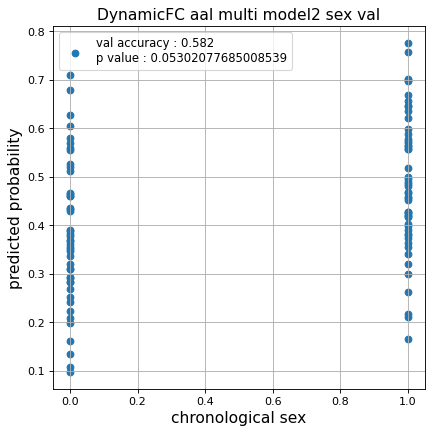

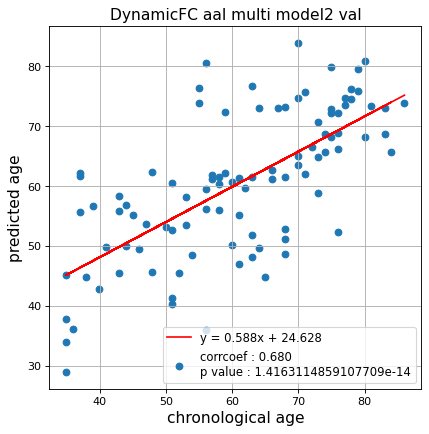

切片: 24.628189226111324
傾き: 0.5879163918327474
Kfold: 5 ::: epoch: 100, loss: 0.16738629570374122, val loss: 0.8014063835144043
Kfold: 5 ::: epoch: 200, loss: 0.14371459759198701, val loss: 0.7050077021121979
Kfold: 5 ::: epoch: 300, loss: 0.1370039742726546, val loss: 0.6522768437862396
Kfold: 5 ::: epoch: 400, loss: 0.13159764042267433, val loss: 0.6234486922621727
Kfold: 5 ::: epoch: 500, loss: 0.1335026931304198, val loss: 0.6200754344463348
Kfold: 5 ::: epoch: 600, loss: 0.12909193222339338, val loss: 0.5915376879274845
Kfold: 5 ::: epoch: 700, loss: 0.12936946291189927, val loss: 0.5721809789538383
save_epochs:660
best val loss:0.5548684373497963


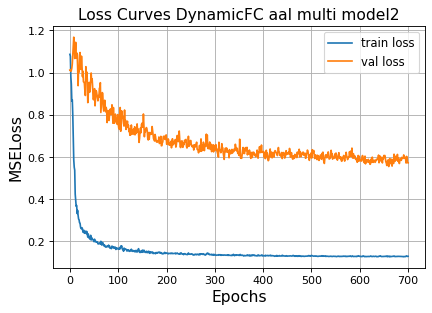

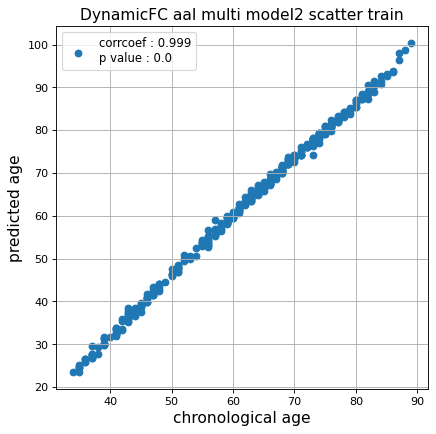

r^2 train data:  0.8630622660041771


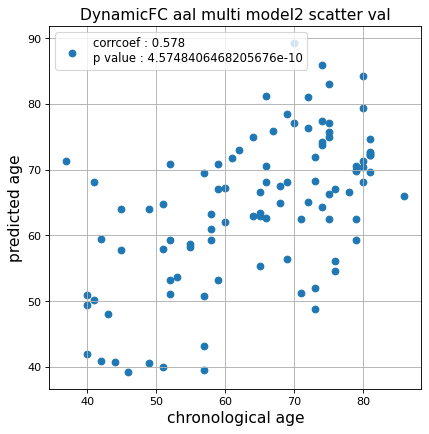

r^2 val data:  0.23861745988228777


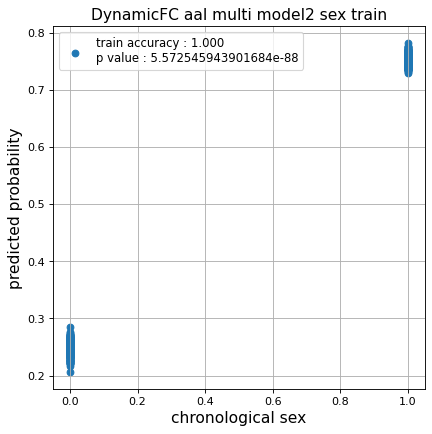

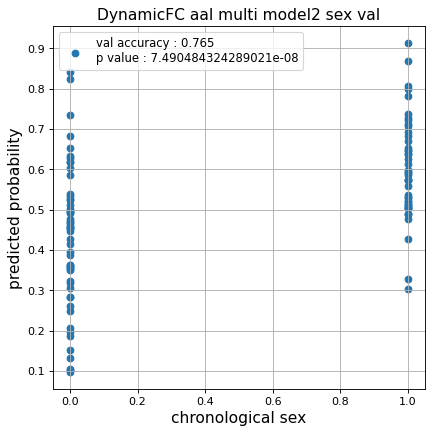

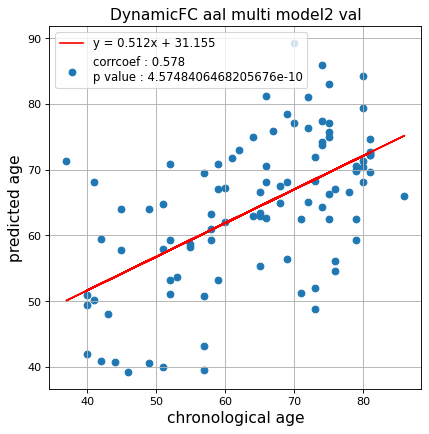

切片: 31.155032352030034
傾き: 0.5119974744212018
Nested Kfold ::: 5
Kfold: 1 ::: epoch: 100, loss: 0.1636299445078923, val loss: 0.7285361438989639
Kfold: 1 ::: epoch: 200, loss: 0.14143195404456213, val loss: 0.7153576761484146
Kfold: 1 ::: epoch: 300, loss: 0.13679838180541992, val loss: 0.7278634607791901
Kfold: 1 ::: epoch: 400, loss: 0.1313522354914592, val loss: 0.7721137702465057
early stopping
save_epochs:276
best val loss:0.6858746409416199


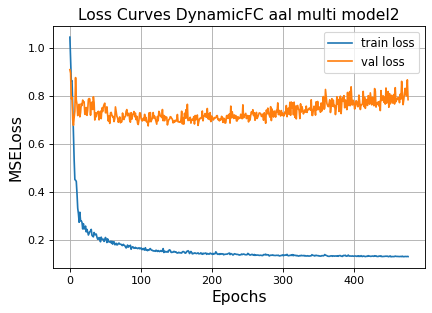

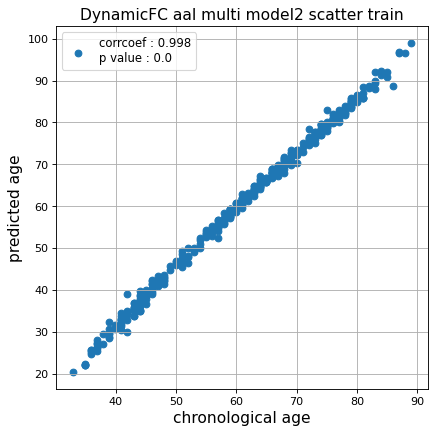

r^2 train data:  0.8593774119446198


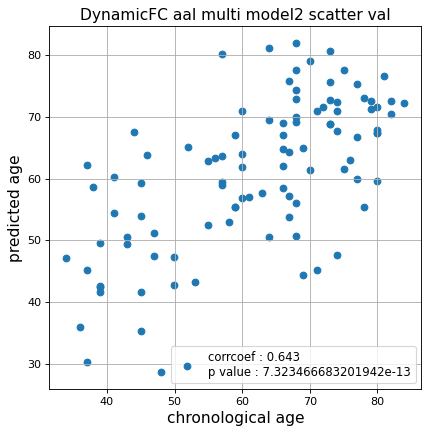

r^2 val data:  0.35552042701045006


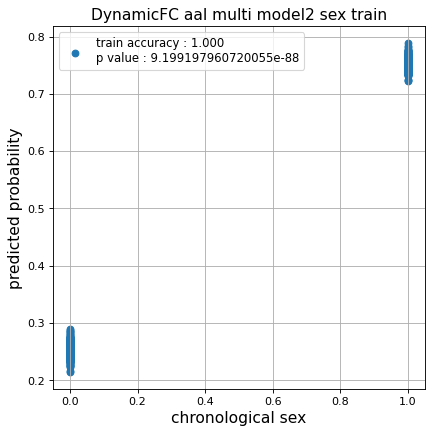

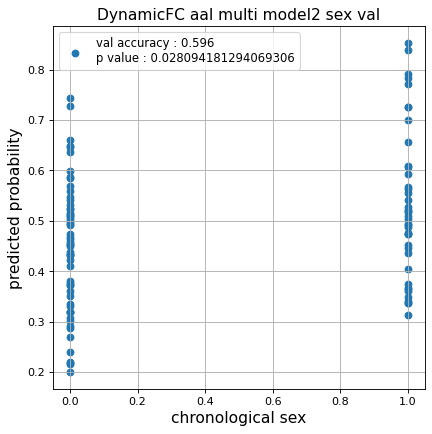

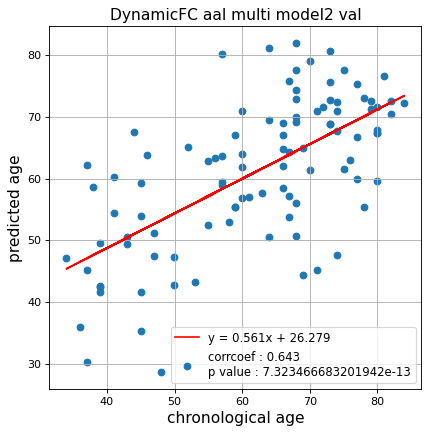

切片: 26.278745592115783
傾き: 0.5612944022451062
Kfold: 2 ::: epoch: 100, loss: 0.16519382366767296, val loss: 0.710583433508873
Kfold: 2 ::: epoch: 200, loss: 0.1433788755765328, val loss: 0.6712954640388489
Kfold: 2 ::: epoch: 300, loss: 0.13651906297757074, val loss: 0.6779433041810989
Kfold: 2 ::: epoch: 400, loss: 0.13343899410504562, val loss: 0.7231920957565308
early stopping
save_epochs:213
best val loss:0.6497551649808884


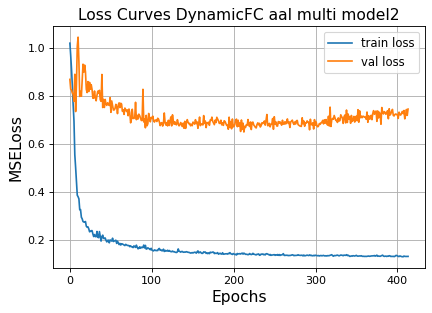

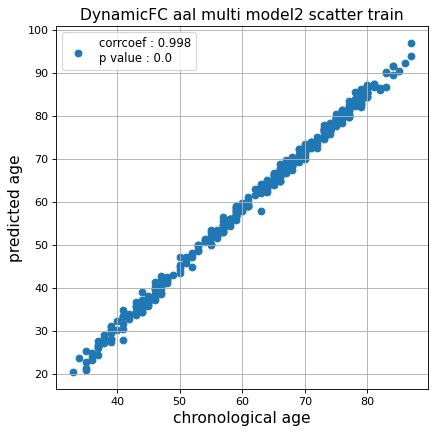

r^2 train data:  0.849191602331641


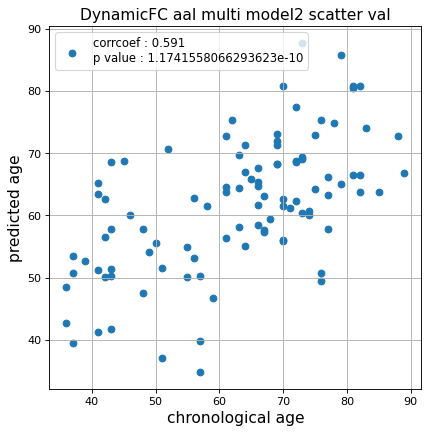

r^2 val data:  0.3165125354320867


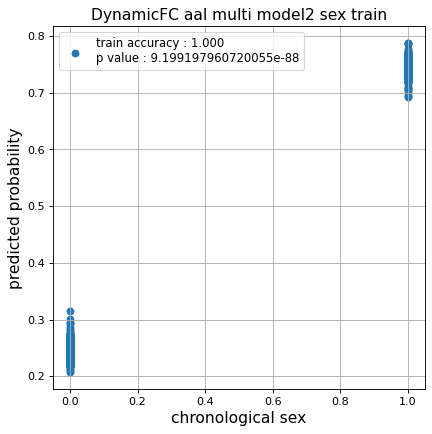

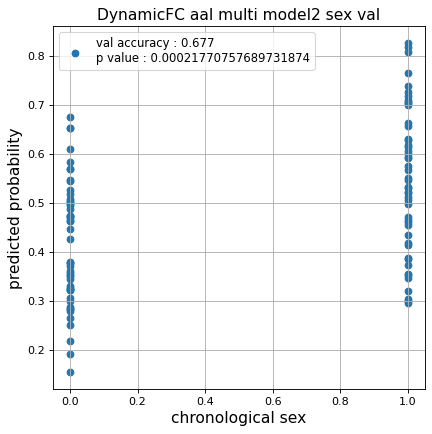

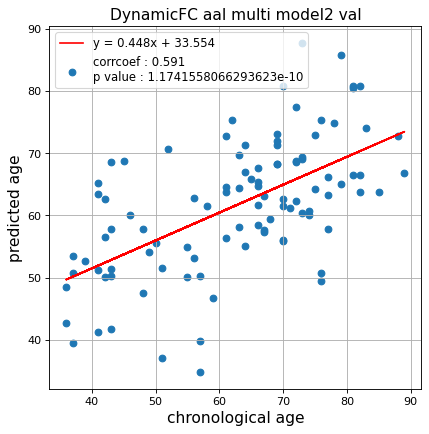

切片: 33.5540768510618
傾き: 0.448438953869164
Kfold: 3 ::: epoch: 100, loss: 0.17491707320396715, val loss: 0.6521855369210243
Kfold: 3 ::: epoch: 200, loss: 0.1444932875724939, val loss: 0.5386752337217331
Kfold: 3 ::: epoch: 300, loss: 0.13673726641214812, val loss: 0.5346570983529091
Kfold: 3 ::: epoch: 400, loss: 0.13376763463020325, val loss: 0.5172321051359177
Kfold: 3 ::: epoch: 500, loss: 0.1320304973767354, val loss: 0.48497429490089417
Kfold: 3 ::: epoch: 600, loss: 0.12957481810679802, val loss: 0.49999359250068665
Kfold: 3 ::: epoch: 700, loss: 0.13055000396875235, val loss: 0.5382174700498581
save_epochs:649
best val loss:0.4619735851883888


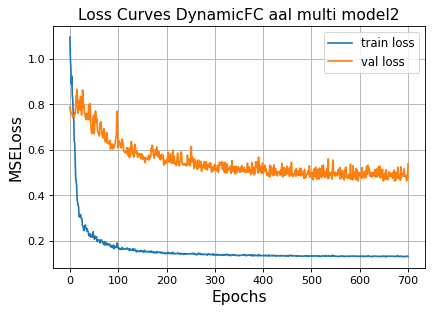

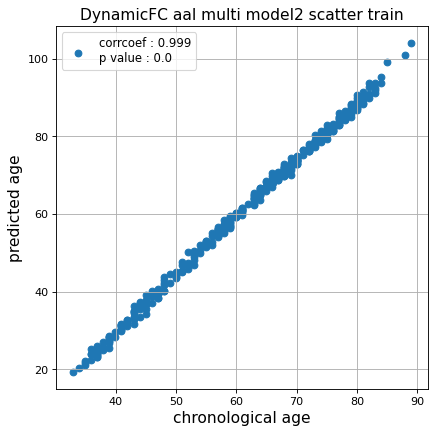

r^2 train data:  0.7685041216984334


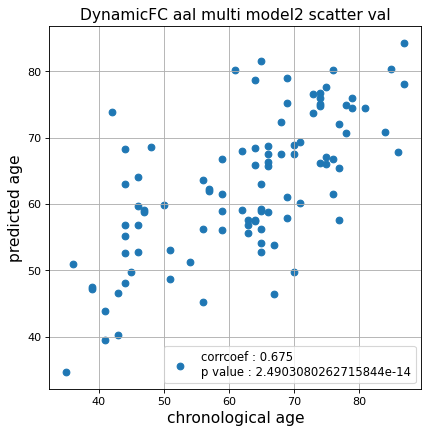

r^2 val data:  0.4370955355939513


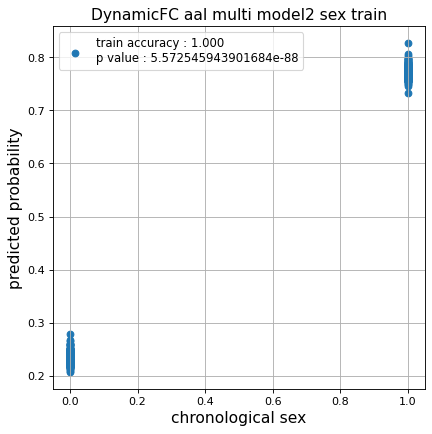

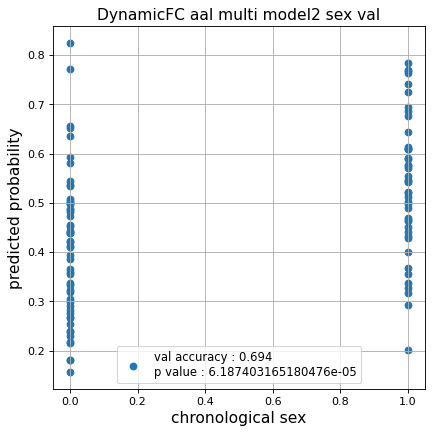

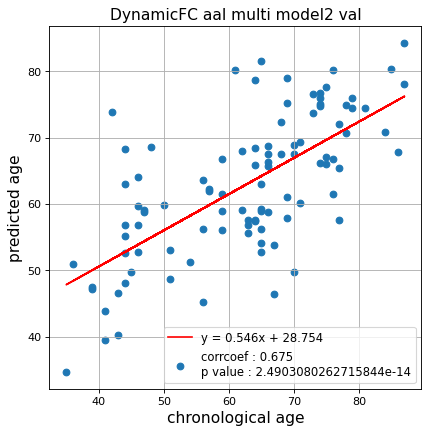

切片: 28.754400482374393
傾き: 0.5455861690630475
Kfold: 4 ::: epoch: 100, loss: 0.1764872418000148, val loss: 0.6014380753040314
Kfold: 4 ::: epoch: 200, loss: 0.144436960036938, val loss: 0.6079034954309464
Kfold: 4 ::: epoch: 300, loss: 0.13535046577453613, val loss: 0.6233225017786026
Kfold: 4 ::: epoch: 400, loss: 0.13082244992256165, val loss: 0.5998227894306183
early stopping
save_epochs:207
best val loss:0.5694403350353241


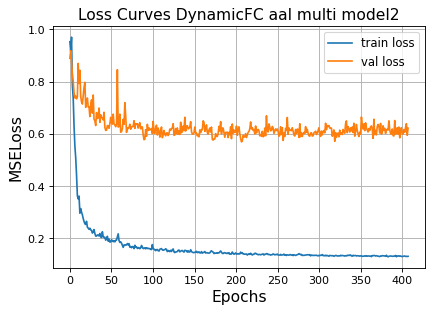

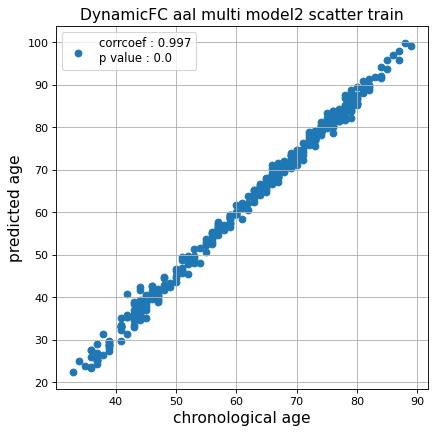

r^2 train data:  0.8293284145331337


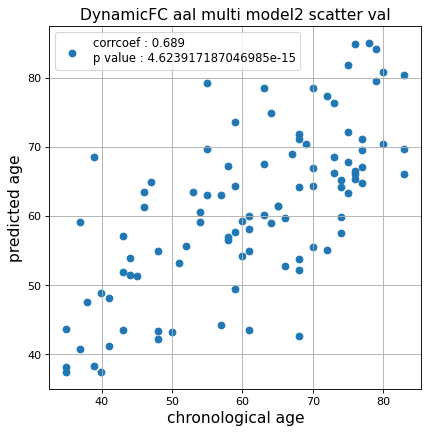

r^2 val data:  0.44293296179454167


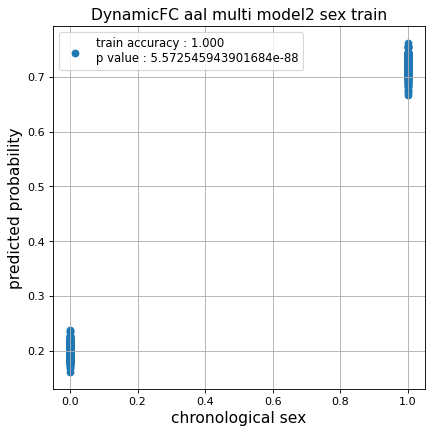

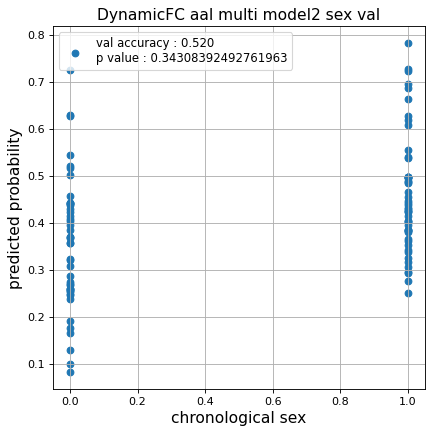

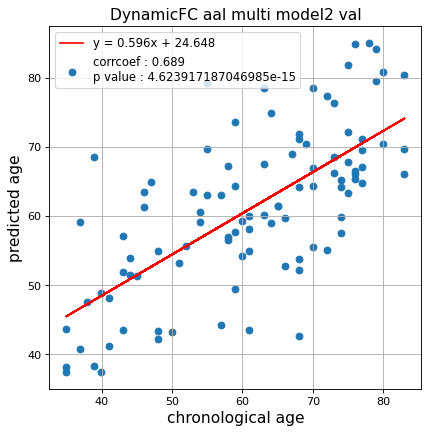

切片: 24.648302076470976
傾き: 0.5960523017571671
Kfold: 5 ::: epoch: 100, loss: 0.16113194364767808, val loss: 0.938634991645813
Kfold: 5 ::: epoch: 200, loss: 0.1405866535810324, val loss: 0.88382887840271
Kfold: 5 ::: epoch: 300, loss: 0.1329199866606639, val loss: 0.8313129991292953
Kfold: 5 ::: epoch: 400, loss: 0.1330235772407972, val loss: 0.8849481791257858
Kfold: 5 ::: epoch: 500, loss: 0.13046694948123053, val loss: 0.875766709446907
early stopping
save_epochs:332
best val loss:0.8109532445669174


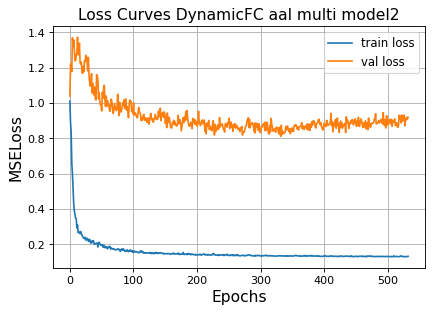

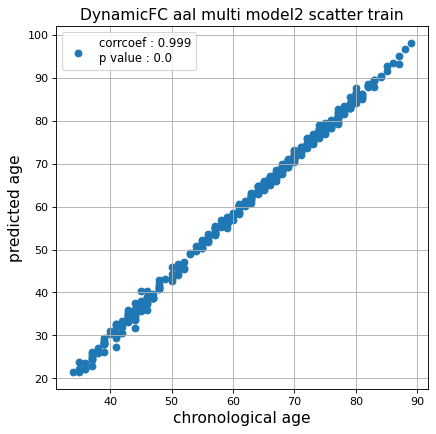

r^2 train data:  0.8299847640275853


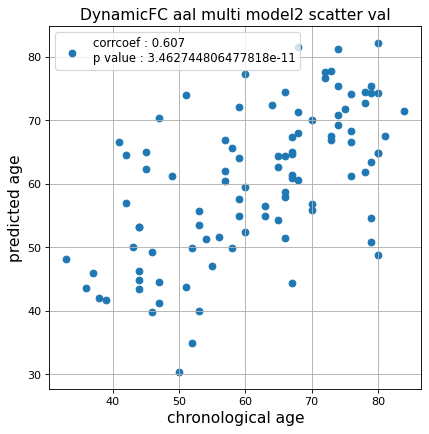

r^2 val data:  0.28193479220842343


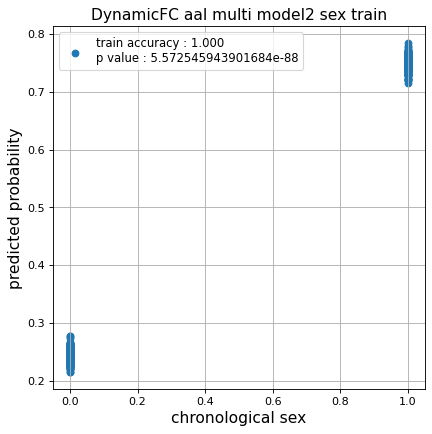

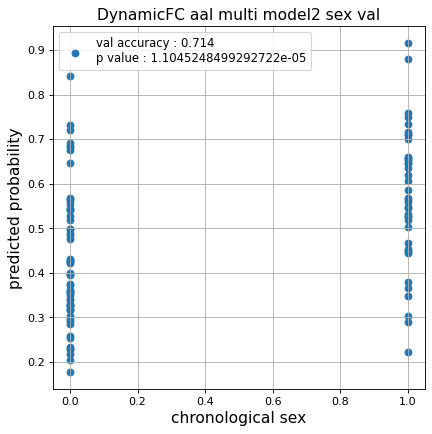

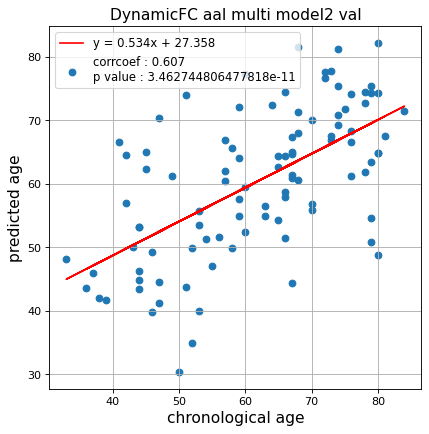

切片: 27.357672233718546
傾き: 0.5338329689834458
CPU times: user 21h 42min 30s, sys: 1min 33s, total: 21h 44min 3s
Wall time: 3h 9min 50s


In [22]:
%%time
fold = KFold(n_splits=n_splits,shuffle=False)

test_pred_aal_dynamic_2  = []
test_pred_aal_dynamic_corrected_2  = []
test_label_aal_dynamic_2 = []
test_idx_aal_dynamic_2   = []

for fold_idx, (train_idx, test_idx) in enumerate(fold.split(data_aal)):
    print(f'Nested Kfold ::: {fold_idx+1}')
    test_pred,test_pred_corrected,test_label = train_model(data_dynamic_aal,
                                                           data_label,
                                                           train_idx  = train_idx,
                                                           test_idx   = test_idx,
                                                           epochs     = 700,
                                                           d_model    = 64,
                                                           n_splits   = n_splits,
                                                           hidden_dim = 256,
                                                           nhead      = 2,#4
                                                           hidden_dim_transformer = 1,#2
                                                           pos_drop    = 0.5,
                                                           trans_drop = 0.5,
                                                           fc_drop = 0.3,
                                                           title = 'DynamicFC aal multi model2'
                                                          )
    
    test_pred_aal_dynamic_2.append(test_pred)
    test_pred_aal_dynamic_corrected_2.append(test_pred_corrected)
    test_label_aal_dynamic_2.append(test_label)
    test_idx_aal_dynamic_2.append(test_idx)

### データ保存

In [23]:
test_pred_aal_dynamic_1 = np.array(test_pred_aal_dynamic_1, dtype=object)
test_pred_aal_dynamic_corrected_1 = np.array(test_pred_aal_dynamic_corrected_1, dtype=object)

test_pred_aal_dynamic_2 = np.array(test_pred_aal_dynamic_2, dtype=object)
test_pred_aal_dynamic_corrected_2 = np.array(test_pred_aal_dynamic_corrected_2, dtype=object)

In [24]:
np.savez('../02_data_analysis/temp/multi_smooth_dynamic_aal_1',
         test_pred_aal_dynamic_1,
         test_pred_aal_dynamic_corrected_1,
         test_label_aal_dynamic_1,
         test_idx_aal_dynamic_1)
np.savez('../02_data_analysis/temp/multi_smooth_dynamic_aal_2',
         test_pred_aal_dynamic_2,
         test_pred_aal_dynamic_corrected_2,
         test_label_aal_dynamic_2,
         test_idx_aal_dynamic_2)

## 学習(Harvard-Oxford)

### ROI 1

Nested Kfold ::: 1
Kfold: 1 ::: epoch: 100, loss: 0.16501392194857964, val loss: 0.7713878229260445
Kfold: 1 ::: epoch: 200, loss: 0.1454451599946389, val loss: 0.6906566619873047
Kfold: 1 ::: epoch: 300, loss: 0.13994151468460375, val loss: 0.6482028886675835
Kfold: 1 ::: epoch: 400, loss: 0.1336390467790457, val loss: 0.5998476967215538
Kfold: 1 ::: epoch: 500, loss: 0.131985421364124, val loss: 0.588482204824686
Kfold: 1 ::: epoch: 600, loss: 0.1304456087259146, val loss: 0.5710278898477554
Kfold: 1 ::: epoch: 700, loss: 0.1294505034501736, val loss: 0.5593908801674843
Kfold: 1 ::: epoch: 800, loss: 0.12937668080513293, val loss: 0.5454539656639099
Kfold: 1 ::: epoch: 900, loss: 0.1282552068050091, val loss: 0.5546859391033649
Kfold: 1 ::: epoch: 1000, loss: 0.12757316919473502, val loss: 0.5415155254304409
save_epochs:980
best val loss:0.5397598668932915


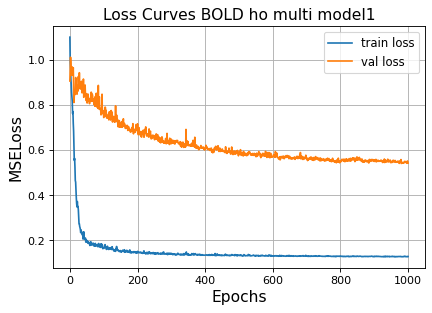

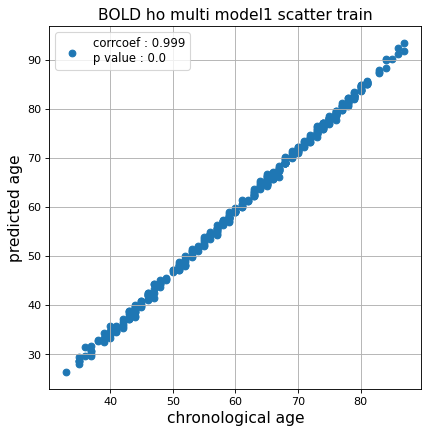

r^2 train data:  0.939381678054022


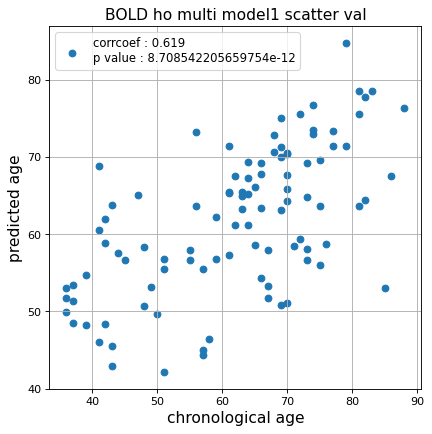

r^2 val data:  0.3789537582104079


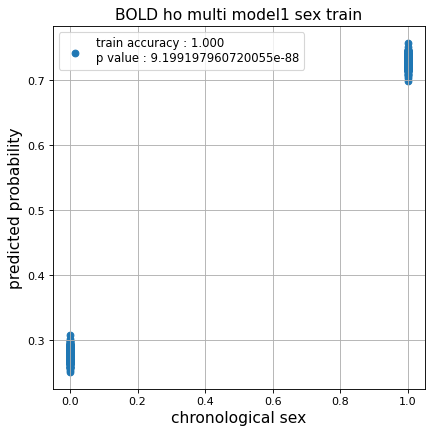

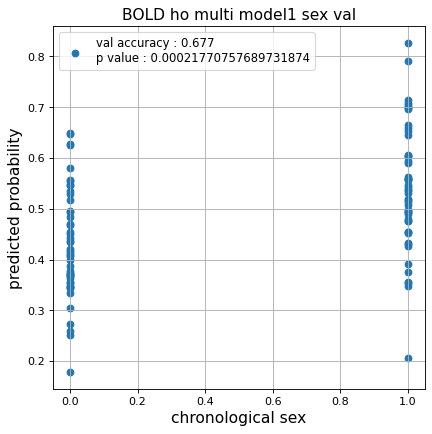

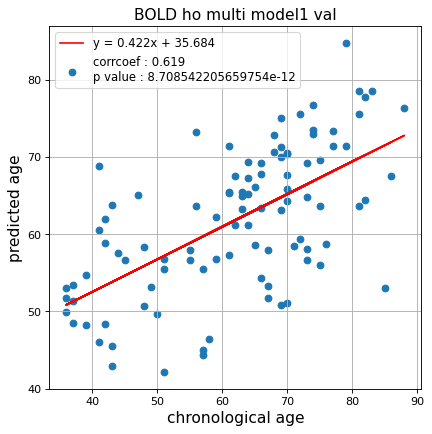

切片: 35.68418652418205
傾き: 0.4216747836233203
Kfold: 2 ::: epoch: 100, loss: 0.16822783648967743, val loss: 0.7343469262123108
Kfold: 2 ::: epoch: 200, loss: 0.1437423676252365, val loss: 0.6675756275653839
Kfold: 2 ::: epoch: 300, loss: 0.13670218220123878, val loss: 0.6457392275333405
Kfold: 2 ::: epoch: 400, loss: 0.1328150091262964, val loss: 0.6132499724626541
Kfold: 2 ::: epoch: 500, loss: 0.13179713029127854, val loss: 0.6016723364591599
Kfold: 2 ::: epoch: 600, loss: 0.1294850351718756, val loss: 0.6005299985408783
Kfold: 2 ::: epoch: 700, loss: 0.12827863486913535, val loss: 0.5989565998315811
Kfold: 2 ::: epoch: 800, loss: 0.12719280330034402, val loss: 0.5957391858100891
Kfold: 2 ::: epoch: 900, loss: 0.12712373756445372, val loss: 0.5824578106403351
Kfold: 2 ::: epoch: 1000, loss: 0.1269692715543967, val loss: 0.5822947770357132
save_epochs:912
best val loss:0.5555000156164169


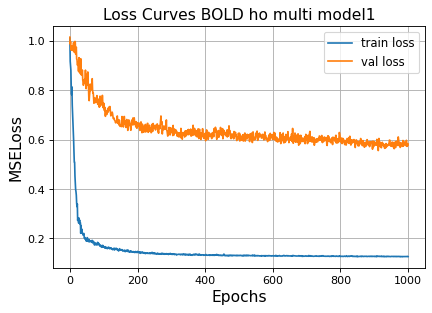

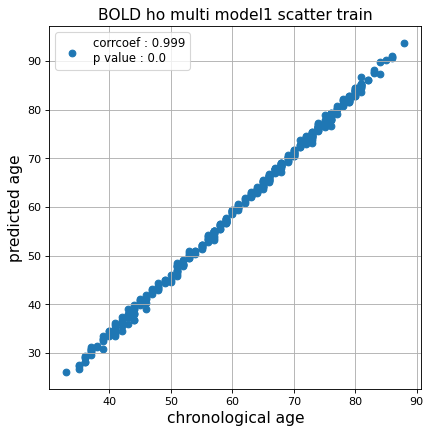

r^2 train data:  0.933038895333674


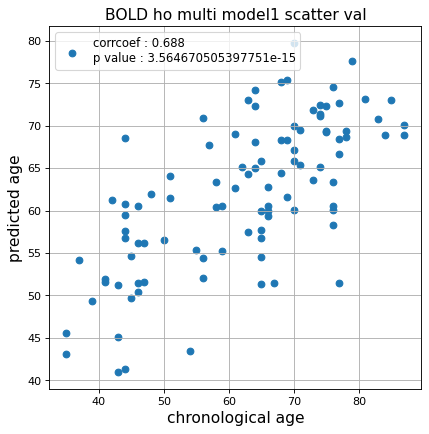

r^2 val data:  0.47184908531038694


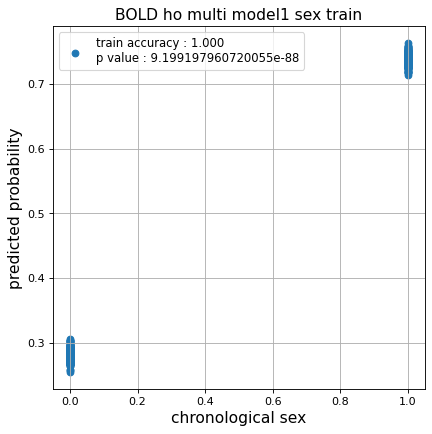

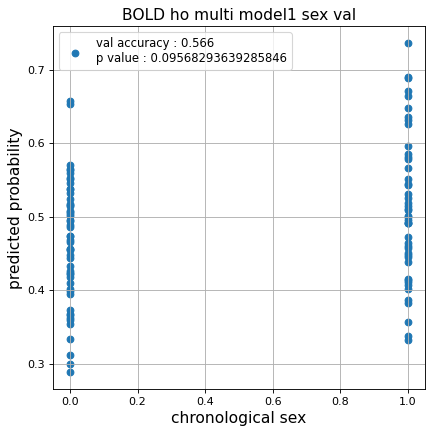

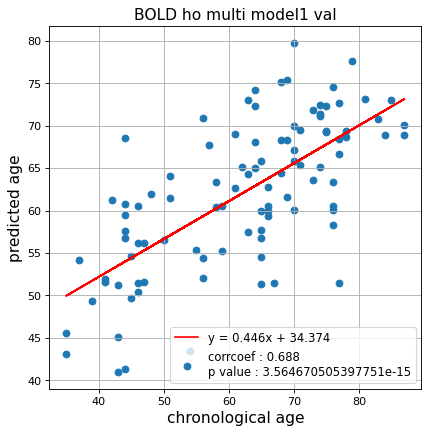

切片: 34.37367415415896
傾き: 0.44557076933828066
Kfold: 3 ::: epoch: 100, loss: 0.16108300250310165, val loss: 0.9857645332813263
Kfold: 3 ::: epoch: 200, loss: 0.1417534614984806, val loss: 0.9145683497190475
Kfold: 3 ::: epoch: 300, loss: 0.1346531189405001, val loss: 0.8463423401117325
Kfold: 3 ::: epoch: 400, loss: 0.1337381532559028, val loss: 0.8526940941810608
Kfold: 3 ::: epoch: 500, loss: 0.13205779286531302, val loss: 0.8306257724761963
Kfold: 3 ::: epoch: 600, loss: 0.1295091280570397, val loss: 0.8083607107400894
Kfold: 3 ::: epoch: 700, loss: 0.1284154229439222, val loss: 0.7828166782855988
Kfold: 3 ::: epoch: 800, loss: 0.12754532637504432, val loss: 0.7947243750095367
early stopping
save_epochs:634
best val loss:0.7697305828332901


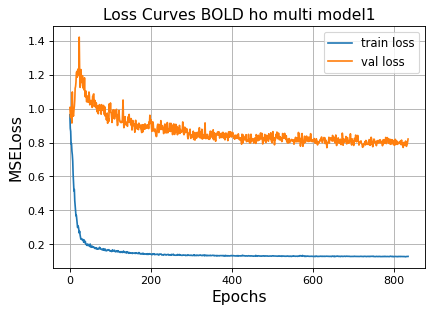

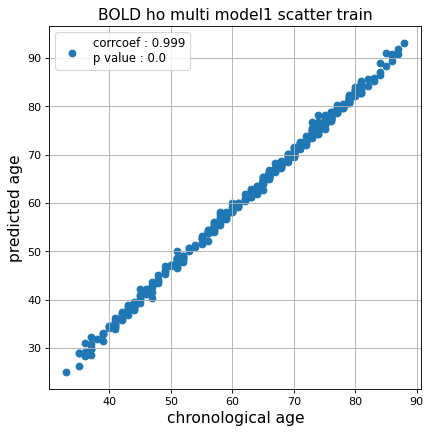

r^2 train data:  0.9460729989419875


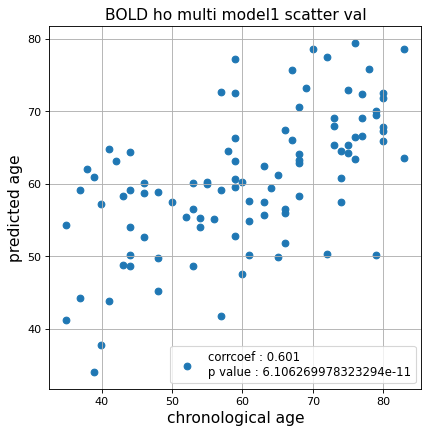

r^2 val data:  0.3524708975839276


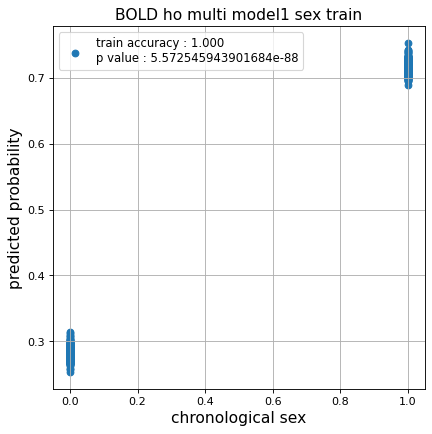

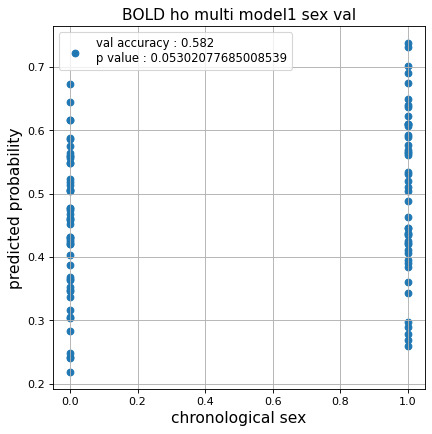

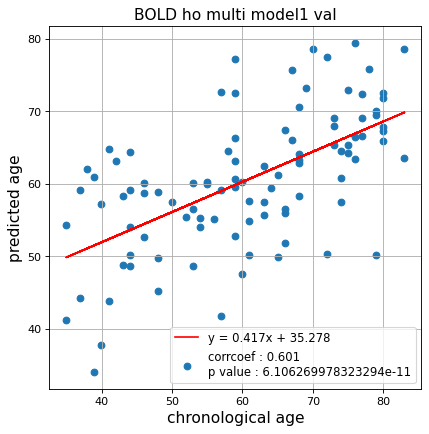

切片: 35.27782581781277
傾き: 0.41653213074240203
Kfold: 4 ::: epoch: 100, loss: 0.160117228443806, val loss: 1.066660538315773
Kfold: 4 ::: epoch: 200, loss: 0.14296803566125724, val loss: 1.0229241400957108
Kfold: 4 ::: epoch: 300, loss: 0.13376130622166854, val loss: 1.0175148695707321
Kfold: 4 ::: epoch: 400, loss: 0.13174050129376924, val loss: 1.0289469808340073
early stopping
save_epochs:235
best val loss:0.9516840130090714


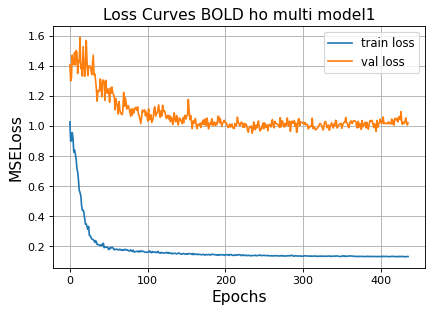

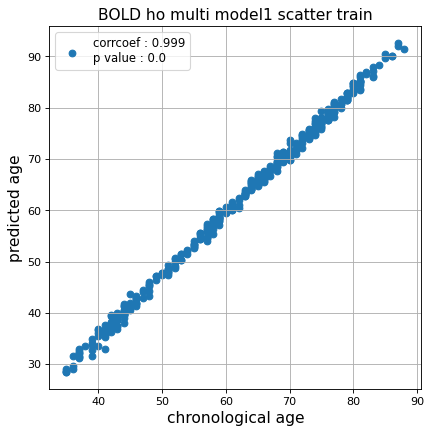

r^2 train data:  0.9541132065901187


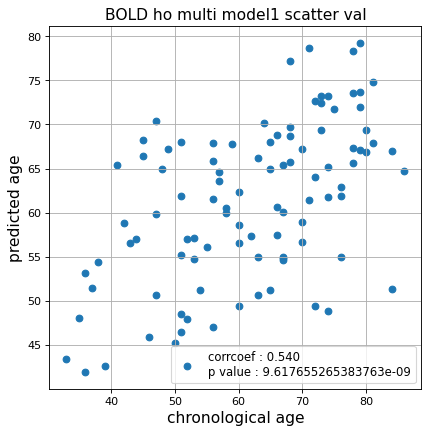

r^2 val data:  0.2719253507965895


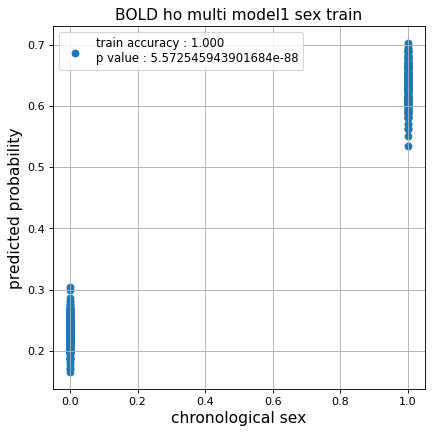

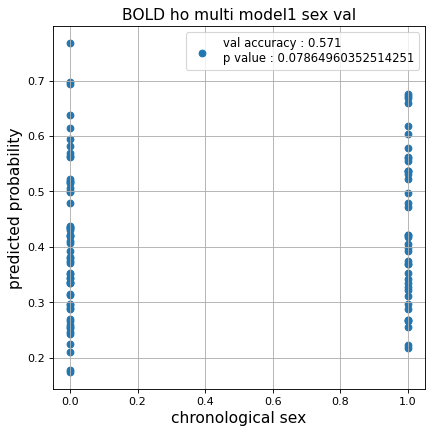

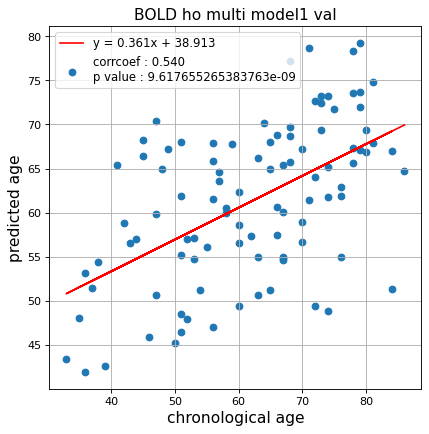

切片: 38.91310630166026
傾き: 0.3607851614587217
Kfold: 5 ::: epoch: 100, loss: 0.16174704868059891, val loss: 0.8812310993671417
Kfold: 5 ::: epoch: 200, loss: 0.1400367124722554, val loss: 0.8410990387201309
Kfold: 5 ::: epoch: 300, loss: 0.134112876195174, val loss: 0.8173116743564606
Kfold: 5 ::: epoch: 400, loss: 0.13247486719718346, val loss: 0.7978134453296661
Kfold: 5 ::: epoch: 500, loss: 0.13077853620052338, val loss: 0.7716609984636307
Kfold: 5 ::: epoch: 600, loss: 0.1304012227516908, val loss: 0.775279238820076
Kfold: 5 ::: epoch: 700, loss: 0.12920071070010847, val loss: 0.7716922760009766
Kfold: 5 ::: epoch: 800, loss: 0.12904032950217909, val loss: 0.7504621148109436
Kfold: 5 ::: epoch: 900, loss: 0.12597458236492598, val loss: 0.7544844150543213
Kfold: 5 ::: epoch: 1000, loss: 0.12707012261335665, val loss: 0.7372567057609558
save_epochs:948
best val loss:0.7294020503759384


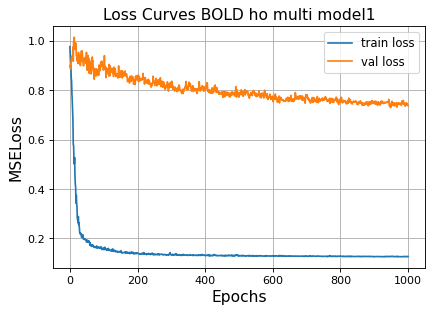

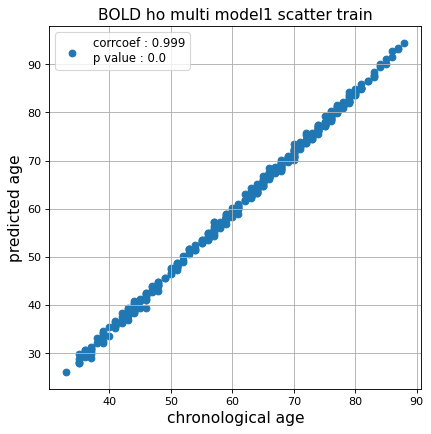

r^2 train data:  0.9409109428986704


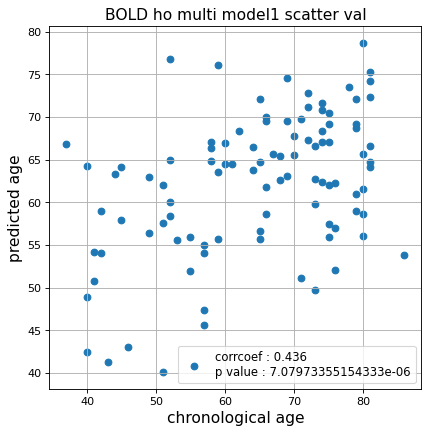

r^2 val data:  0.11443389810194993


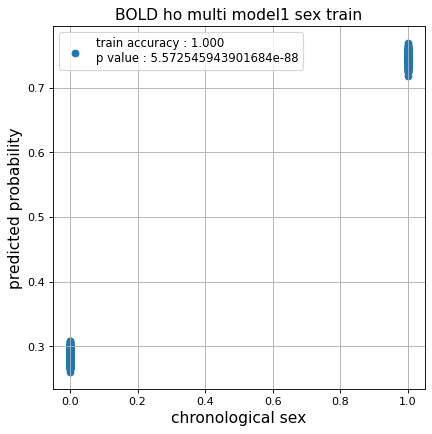

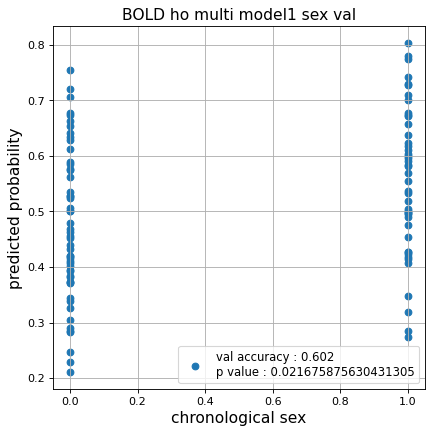

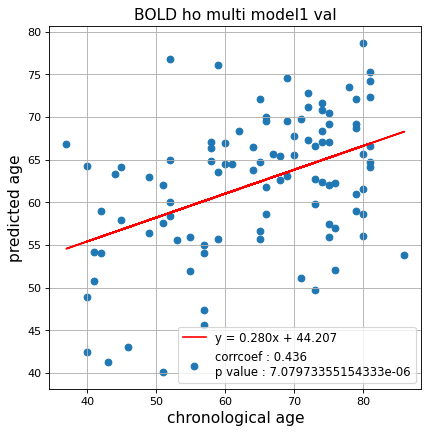

切片: 44.206925624918085
傾き: 0.279902152098051
Nested Kfold ::: 2
Kfold: 1 ::: epoch: 100, loss: 0.1678854926274373, val loss: 0.6815090179443359
Kfold: 1 ::: epoch: 200, loss: 0.1466919332742691, val loss: 0.6694037467241287
Kfold: 1 ::: epoch: 300, loss: 0.13999785024386185, val loss: 0.6211908012628555
Kfold: 1 ::: epoch: 400, loss: 0.13522368554885572, val loss: 0.603936642408371
Kfold: 1 ::: epoch: 500, loss: 0.1339649993639726, val loss: 0.5852940380573273
Kfold: 1 ::: epoch: 600, loss: 0.13050987628790048, val loss: 0.5920598283410072
Kfold: 1 ::: epoch: 700, loss: 0.1308351342494671, val loss: 0.57342329621315
Kfold: 1 ::: epoch: 800, loss: 0.12983818925344026, val loss: 0.5793772265315056
Kfold: 1 ::: epoch: 900, loss: 0.1291362574467292, val loss: 0.5747712701559067
Kfold: 1 ::: epoch: 1000, loss: 0.12763887643814087, val loss: 0.5647650510072708
save_epochs:907
best val loss:0.5525854602456093


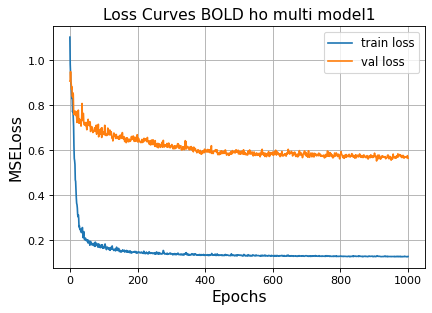

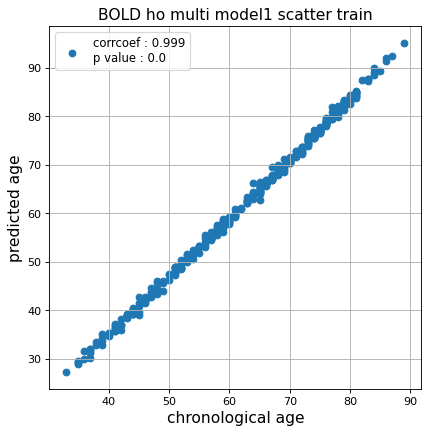

r^2 train data:  0.951810526696331


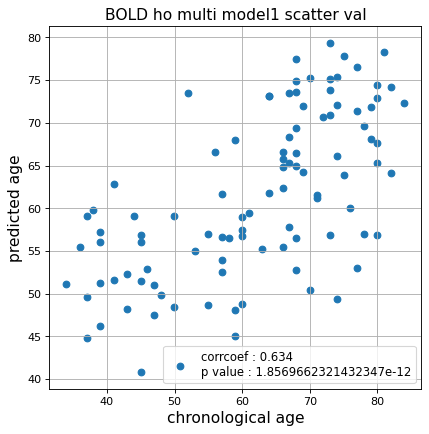

r^2 val data:  0.3973857003594867


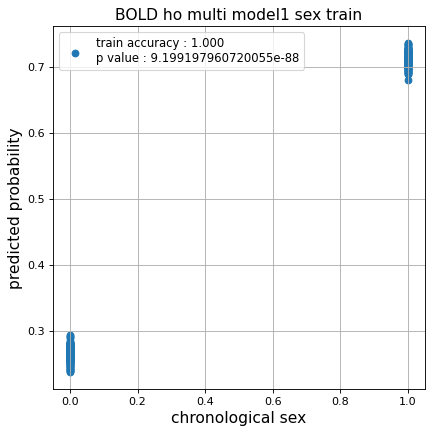

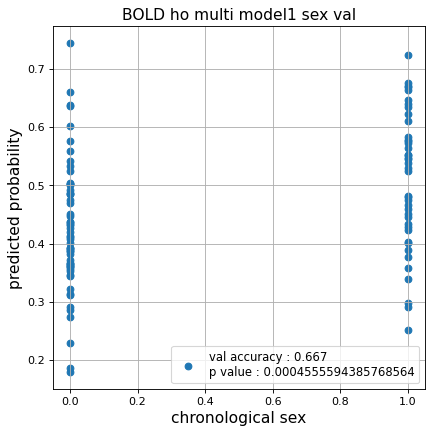

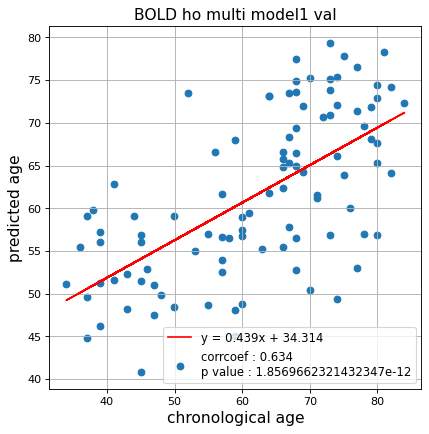

切片: 34.31435002737678
傾き: 0.4390701132375553
Kfold: 2 ::: epoch: 100, loss: 0.16527482408743638, val loss: 0.8582892119884491
Kfold: 2 ::: epoch: 200, loss: 0.1447006704715582, val loss: 0.7887929230928421
Kfold: 2 ::: epoch: 300, loss: 0.136691710123649, val loss: 0.7638999223709106
Kfold: 2 ::: epoch: 400, loss: 0.13319007249978873, val loss: 0.752544492483139
Kfold: 2 ::: epoch: 500, loss: 0.1319641608458299, val loss: 0.7315721809864044
Kfold: 2 ::: epoch: 600, loss: 0.1300442356329698, val loss: 0.7138698399066925
Kfold: 2 ::: epoch: 700, loss: 0.12841220429310432, val loss: 0.7113736271858215
Kfold: 2 ::: epoch: 800, loss: 0.12710828735278204, val loss: 0.696916401386261
Kfold: 2 ::: epoch: 900, loss: 0.12705049491845644, val loss: 0.6879132390022278
Kfold: 2 ::: epoch: 1000, loss: 0.12611264276963013, val loss: 0.6845425814390182
save_epochs:954
best val loss:0.6644837558269501


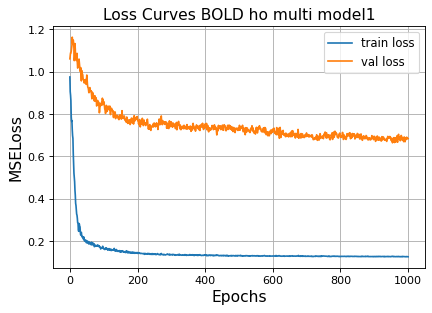

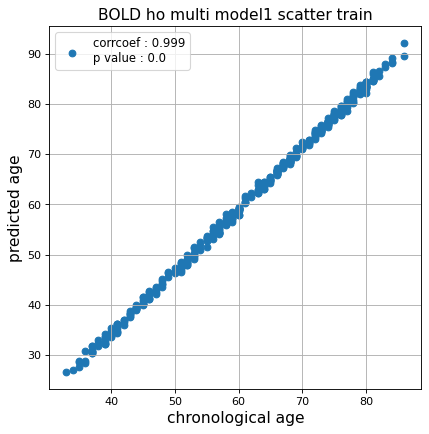

r^2 train data:  0.9423501985658764


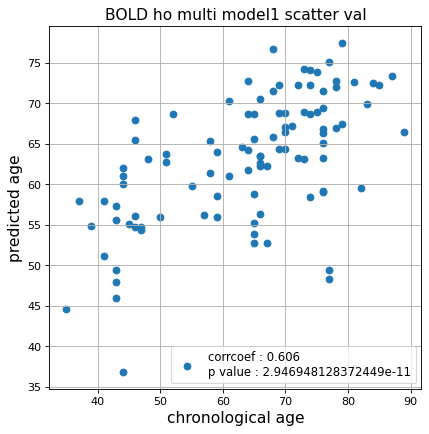

r^2 val data:  0.3644152288887177


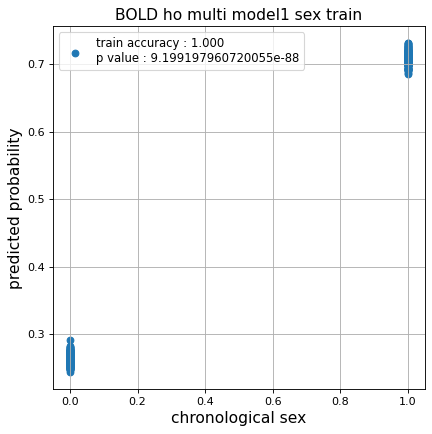

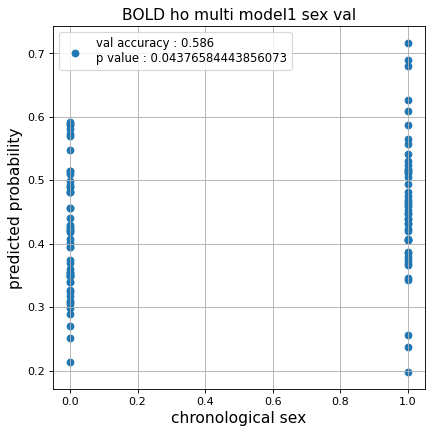

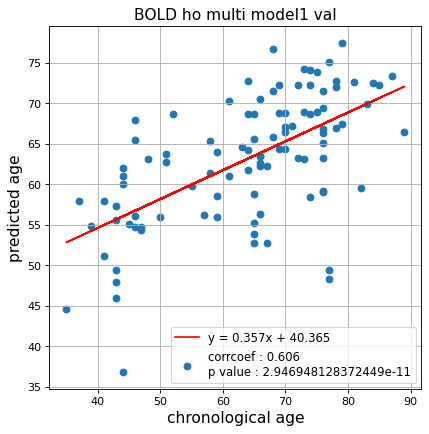

切片: 40.364719008497225
傾き: 0.35656509160087146
Kfold: 3 ::: epoch: 100, loss: 0.16457691903297716, val loss: 1.0691325217485428
Kfold: 3 ::: epoch: 200, loss: 0.14220699667930603, val loss: 0.9824254363775253
Kfold: 3 ::: epoch: 300, loss: 0.13563848802676567, val loss: 1.0203254520893097
Kfold: 3 ::: epoch: 400, loss: 0.13334954931185797, val loss: 0.9714320749044418
Kfold: 3 ::: epoch: 500, loss: 0.13093852652953222, val loss: 0.9593336880207062
Kfold: 3 ::: epoch: 600, loss: 0.12957234680652618, val loss: 0.8716574758291245
Kfold: 3 ::: epoch: 700, loss: 0.1303445272720777, val loss: 0.8927492499351501
Kfold: 3 ::: epoch: 800, loss: 0.1276602796637095, val loss: 0.9139644950628281
Kfold: 3 ::: epoch: 900, loss: 0.1271823656100493, val loss: 0.9064131379127502
early stopping
save_epochs:722
best val loss:0.8475805073976517


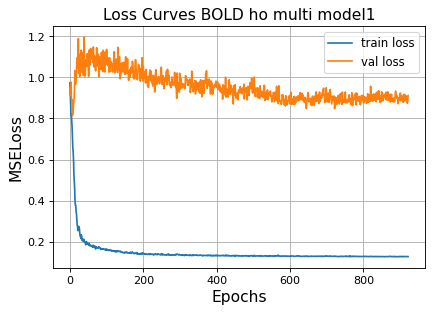

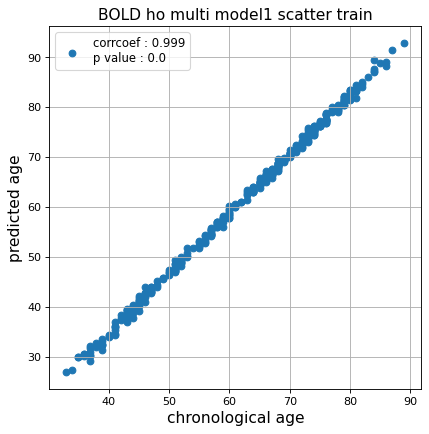

r^2 train data:  0.9570713760766725


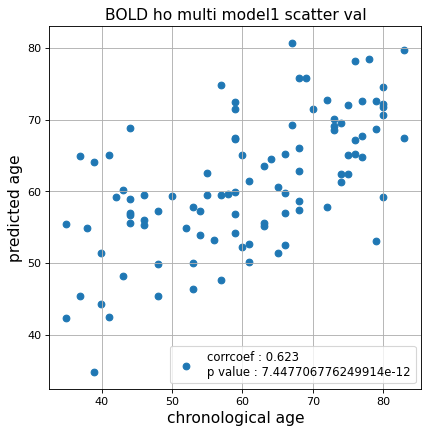

r^2 val data:  0.3827525913249349


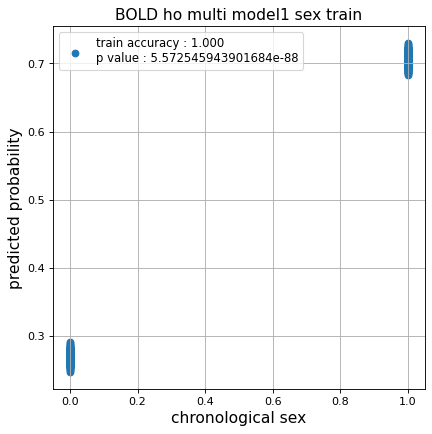

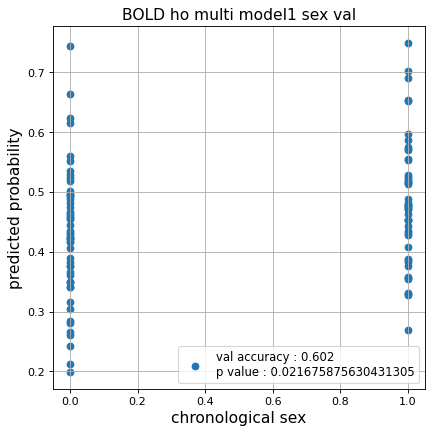

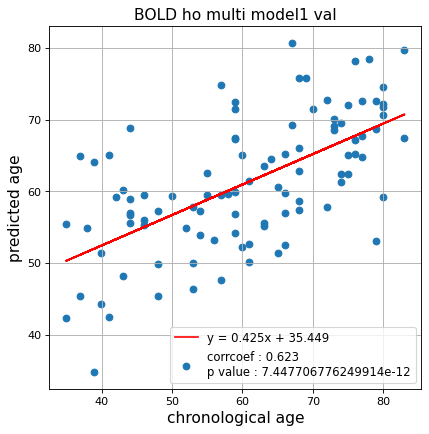

切片: 35.448778241340406
傾き: 0.4247508994986361
Kfold: 4 ::: epoch: 100, loss: 0.15666241714587578, val loss: 0.9162470549345016
Kfold: 4 ::: epoch: 200, loss: 0.14011484613785377, val loss: 0.7860891669988632
Kfold: 4 ::: epoch: 300, loss: 0.13339519271483788, val loss: 0.7910406738519669
Kfold: 4 ::: epoch: 400, loss: 0.13292593910143927, val loss: 0.806882232427597
early stopping
save_epochs:283
best val loss:0.7608213722705841


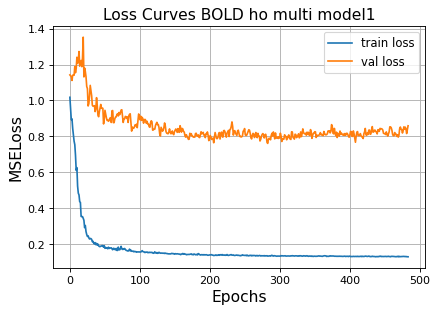

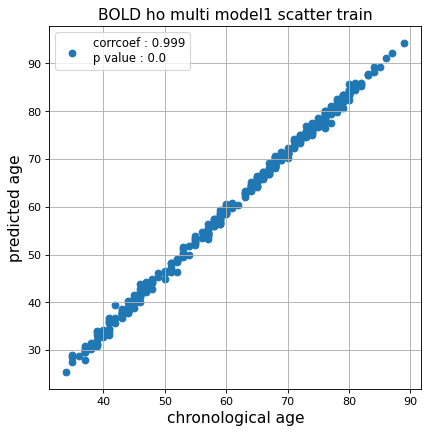

r^2 train data:  0.9339637466375514


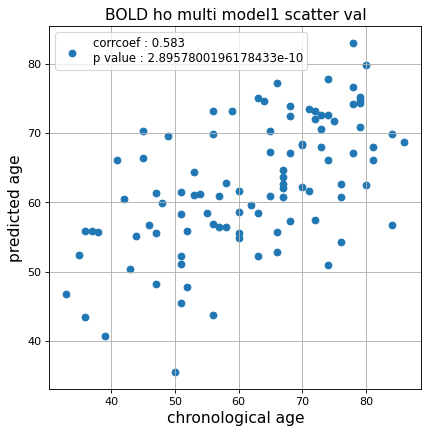

r^2 val data:  0.3244752112494207


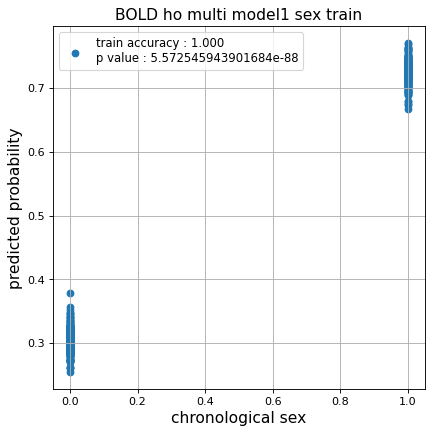

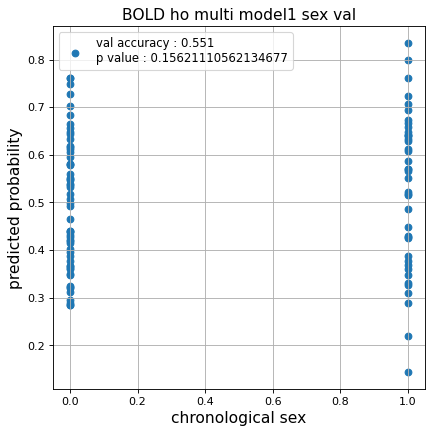

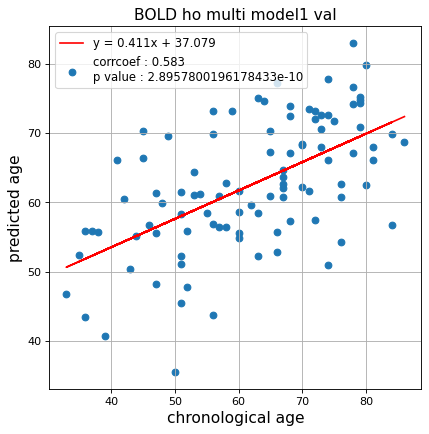

切片: 37.078990900561585
傾き: 0.41050635168922955
Kfold: 5 ::: epoch: 100, loss: 0.1623397056873028, val loss: 0.7367247045040131
Kfold: 5 ::: epoch: 200, loss: 0.14258913122690642, val loss: 0.7129945680499077
Kfold: 5 ::: epoch: 300, loss: 0.13616432593419, val loss: 0.7096578404307365
Kfold: 5 ::: epoch: 400, loss: 0.13327517417760995, val loss: 0.7160310000181198
early stopping
save_epochs:213
best val loss:0.6963033825159073


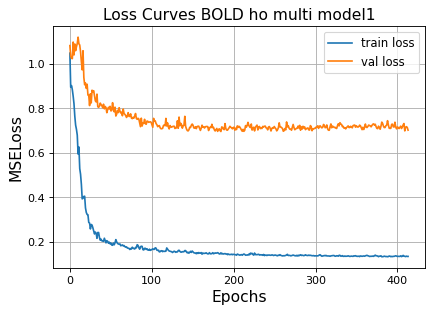

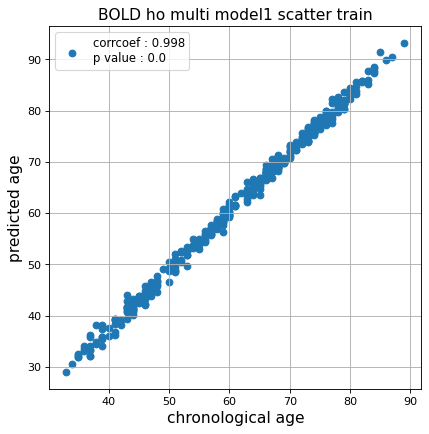

r^2 train data:  0.9700685971025389


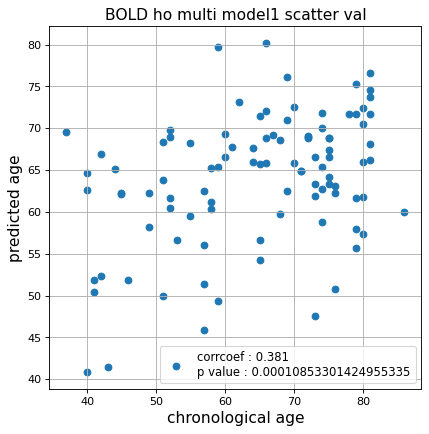

r^2 val data:  0.08948250851853023


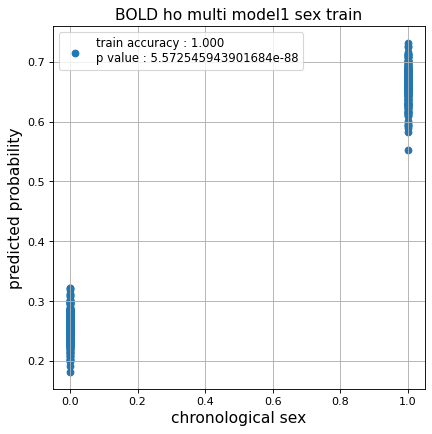

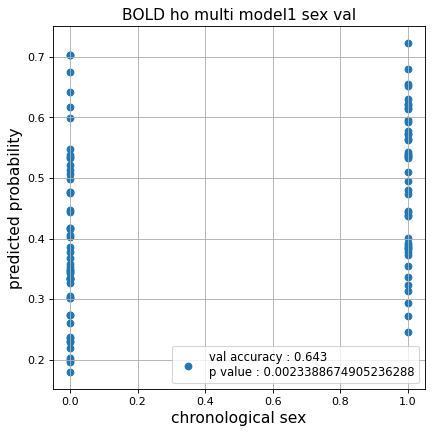

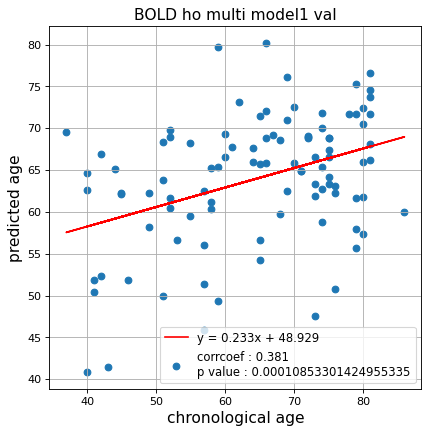

切片: 48.929025514700285
傾き: 0.23292807060659607
Nested Kfold ::: 3
Kfold: 1 ::: epoch: 100, loss: 0.1715825841977046, val loss: 0.6246882453560829
Kfold: 1 ::: epoch: 200, loss: 0.145554142502638, val loss: 0.5967757925391197
Kfold: 1 ::: epoch: 300, loss: 0.13835705931370074, val loss: 0.5752877853810787
Kfold: 1 ::: epoch: 400, loss: 0.13535917951510504, val loss: 0.5749687775969505
Kfold: 1 ::: epoch: 500, loss: 0.13130107407386488, val loss: 0.5565689504146576
Kfold: 1 ::: epoch: 600, loss: 0.1290159122301982, val loss: 0.5527880601584911
Kfold: 1 ::: epoch: 700, loss: 0.13006548583507538, val loss: 0.5454884618520737
Kfold: 1 ::: epoch: 800, loss: 0.1291738381752601, val loss: 0.5520200580358505
early stopping
save_epochs:622
best val loss:0.5380313545465469


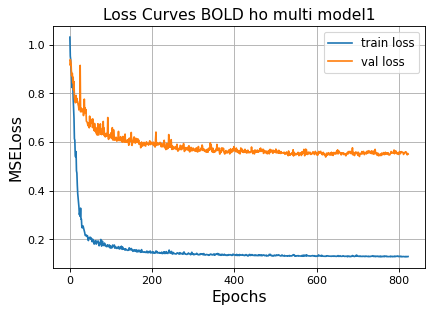

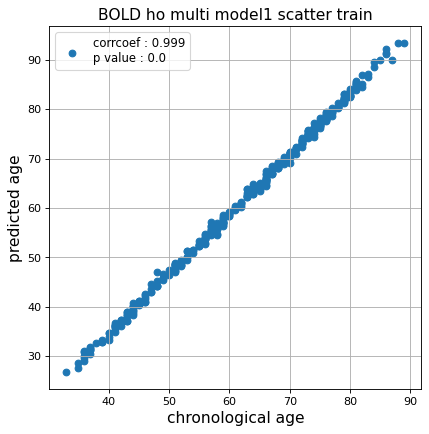

r^2 train data:  0.9499437456986866


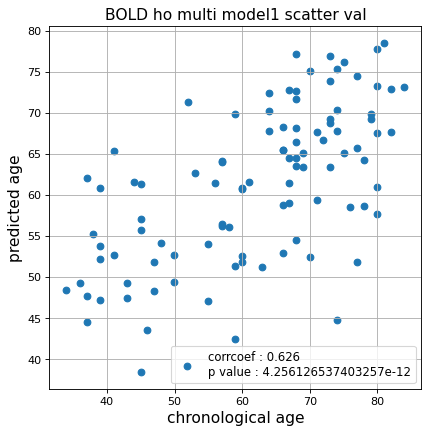

r^2 val data:  0.3858140376450262


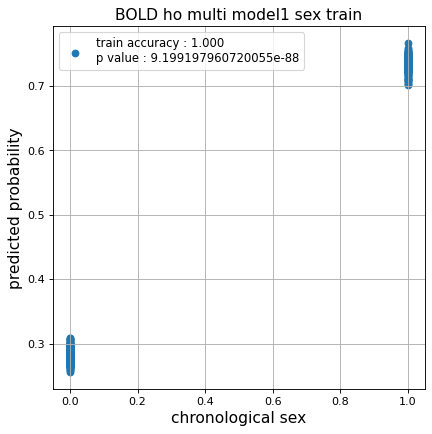

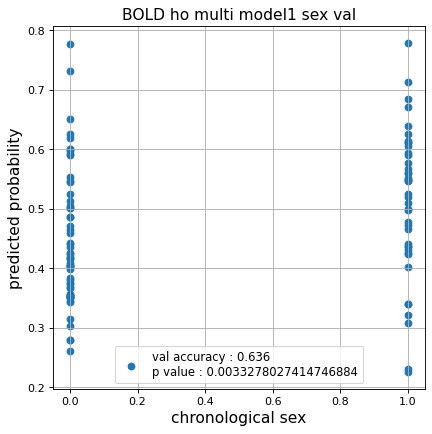

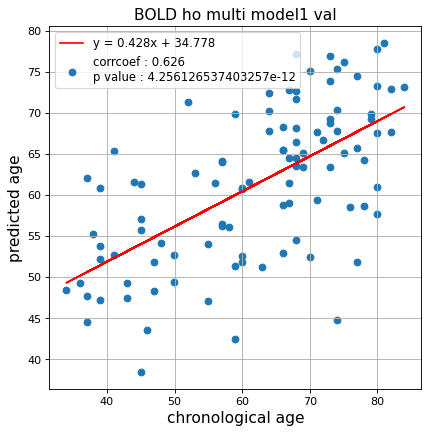

切片: 34.77838938044361
傾き: 0.427657453743531
Kfold: 2 ::: epoch: 100, loss: 0.16423037877449623, val loss: 0.7431478202342987
Kfold: 2 ::: epoch: 200, loss: 0.14122887184986702, val loss: 0.6589004993438721
Kfold: 2 ::: epoch: 300, loss: 0.13345525241815126, val loss: 0.6377565860748291
Kfold: 2 ::: epoch: 400, loss: 0.13344022746269518, val loss: 0.6249956414103508
Kfold: 2 ::: epoch: 500, loss: 0.13082221150398254, val loss: 0.607287771999836
Kfold: 2 ::: epoch: 600, loss: 0.13014244804015526, val loss: 0.6094893030822277
Kfold: 2 ::: epoch: 700, loss: 0.13010531205397385, val loss: 0.6157933063805103
Kfold: 2 ::: epoch: 800, loss: 0.12756498501851007, val loss: 0.6017552018165588
Kfold: 2 ::: epoch: 900, loss: 0.12757909985689017, val loss: 0.6028420366346836
Kfold: 2 ::: epoch: 1000, loss: 0.12714322140583625, val loss: 0.5963927358388901
save_epochs:985
best val loss:0.5877199545502663


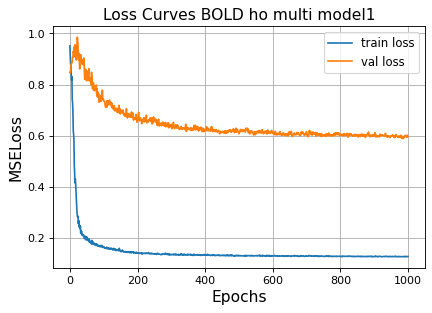

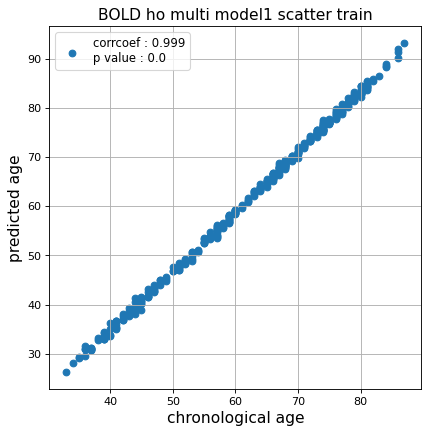

r^2 train data:  0.9493270640485708


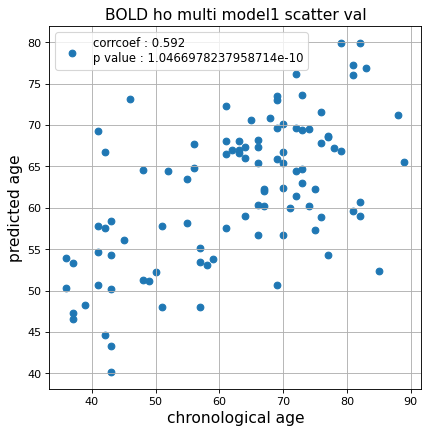

r^2 val data:  0.34875556989945666


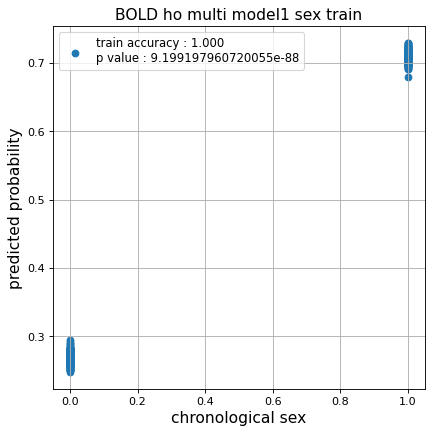

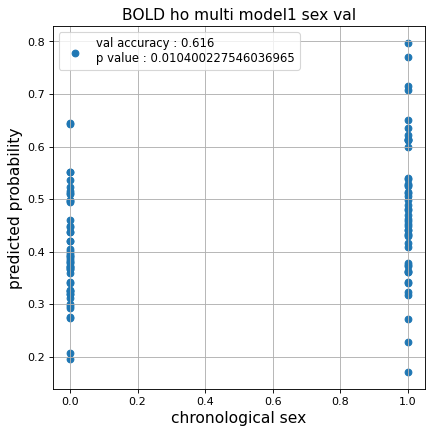

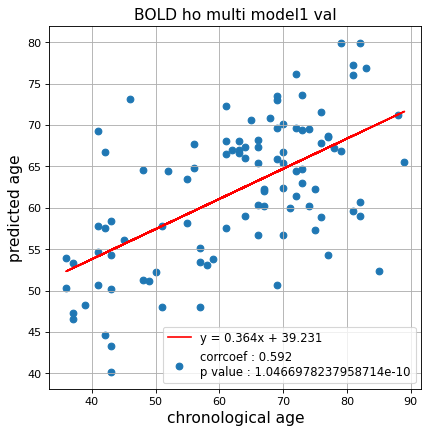

切片: 39.23127682317069
傾き: 0.3642077228713804
Kfold: 3 ::: epoch: 100, loss: 0.15772483555170205, val loss: 0.8668069690465927
Kfold: 3 ::: epoch: 200, loss: 0.13849405141977164, val loss: 0.7731545120477676
Kfold: 3 ::: epoch: 300, loss: 0.13527054740832403, val loss: 0.7253814190626144
Kfold: 3 ::: epoch: 400, loss: 0.13324285814395317, val loss: 0.7261257767677307
Kfold: 3 ::: epoch: 500, loss: 0.13097920555334824, val loss: 0.7624060064554214
Kfold: 3 ::: epoch: 600, loss: 0.1299904241011693, val loss: 0.7178705930709839
Kfold: 3 ::: epoch: 700, loss: 0.12807522943386665, val loss: 0.7220733314752579
Kfold: 3 ::: epoch: 800, loss: 0.1273415031341406, val loss: 0.7033886313438416
early stopping
save_epochs:604
best val loss:0.686103418469429


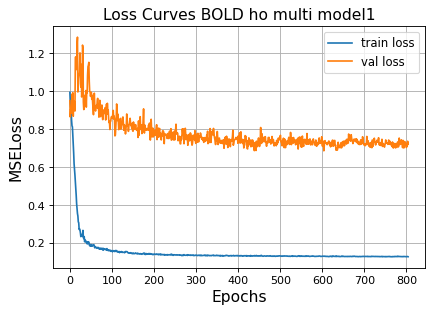

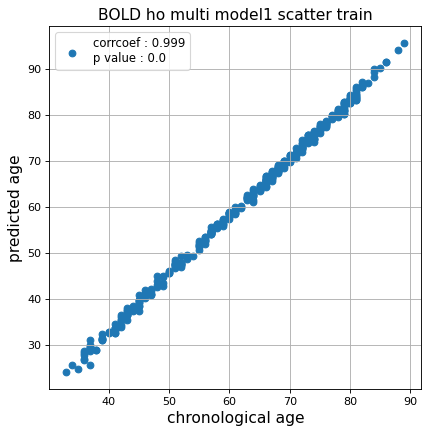

r^2 train data:  0.9200211015683595


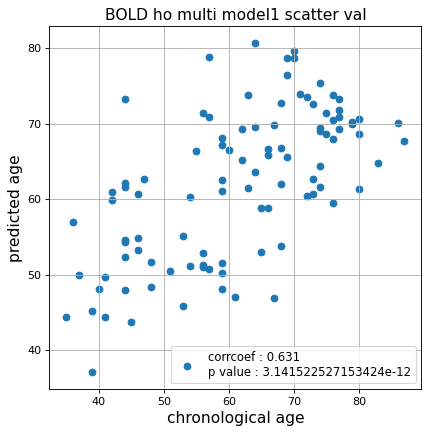

r^2 val data:  0.3817730116431307


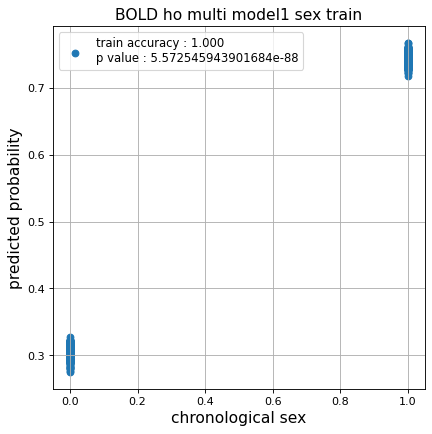

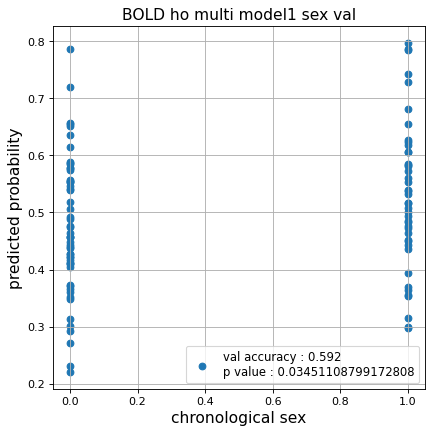

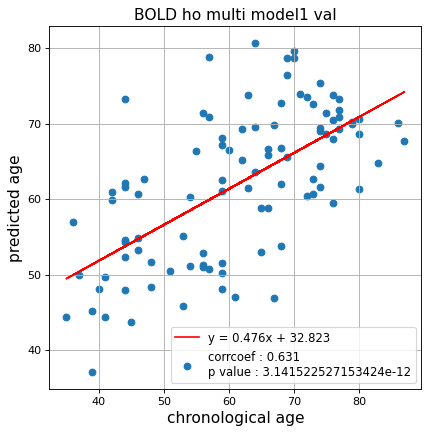

切片: 32.823319777916026
傾き: 0.47555653580139073
Kfold: 4 ::: epoch: 100, loss: 0.16179147133460411, val loss: 1.1308219283819199
Kfold: 4 ::: epoch: 200, loss: 0.14300658611150888, val loss: 1.0411340445280075
Kfold: 4 ::: epoch: 300, loss: 0.13604702399327204, val loss: 1.053406298160553
Kfold: 4 ::: epoch: 400, loss: 0.1346337371147596, val loss: 1.052002638578415
Kfold: 4 ::: epoch: 500, loss: 0.1296239300416066, val loss: 1.0035279244184494
Kfold: 4 ::: epoch: 600, loss: 0.13021557262310615, val loss: 0.9760886430740356
Kfold: 4 ::: epoch: 700, loss: 0.1293843789742543, val loss: 0.955788642168045
Kfold: 4 ::: epoch: 800, loss: 0.1272843096118707, val loss: 0.9549633413553238
Kfold: 4 ::: epoch: 900, loss: 0.12658449720877868, val loss: 0.9746337682008743
Kfold: 4 ::: epoch: 1000, loss: 0.12630227208137512, val loss: 0.9703263640403748
save_epochs:904
best val loss:0.9274776726961136


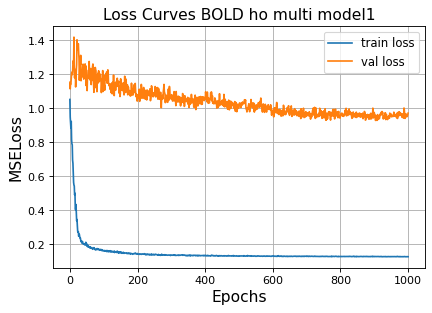

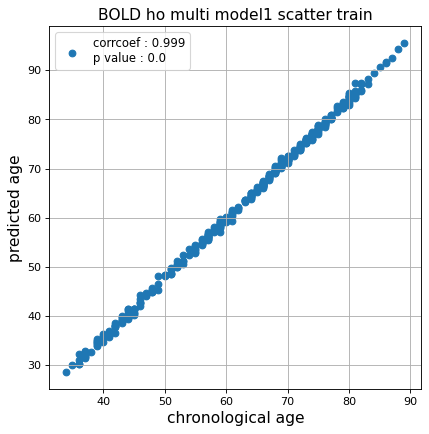

r^2 train data:  0.9523235911454766


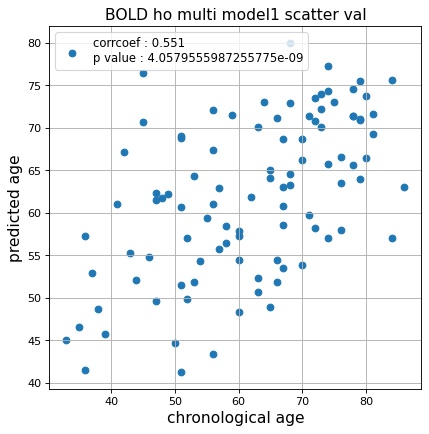

r^2 val data:  0.2834369581790812


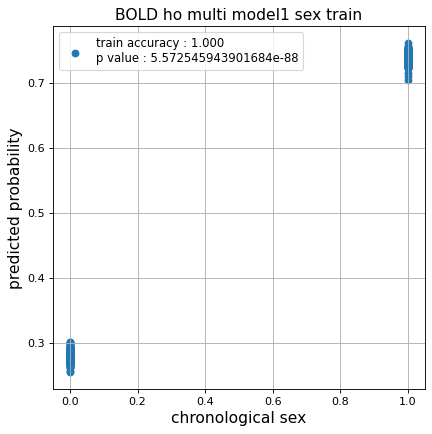

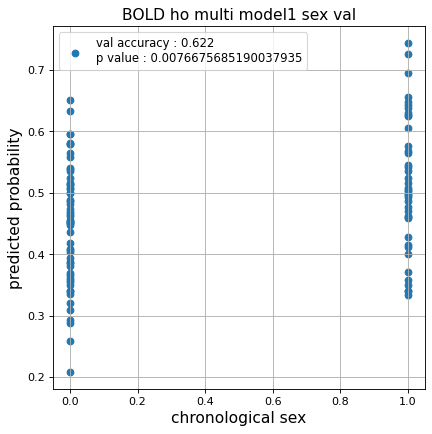

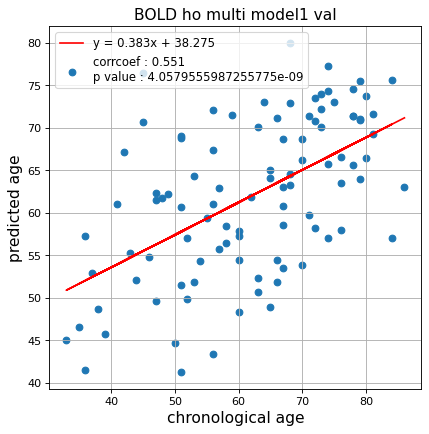

切片: 38.27533456619705
傾き: 0.38261181302393016
Kfold: 5 ::: epoch: 100, loss: 0.16294149939830488, val loss: 0.8915733844041824
Kfold: 5 ::: epoch: 200, loss: 0.14281896215218765, val loss: 0.87907674908638
Kfold: 5 ::: epoch: 300, loss: 0.13356069991221795, val loss: 0.8541389852762222
Kfold: 5 ::: epoch: 400, loss: 0.13274901646834153, val loss: 0.8270504772663116
Kfold: 5 ::: epoch: 500, loss: 0.13103854656219482, val loss: 0.811562642455101
Kfold: 5 ::: epoch: 600, loss: 0.13017598711527312, val loss: 0.8037150502204895
Kfold: 5 ::: epoch: 700, loss: 0.12974519569140214, val loss: 0.8095475137233734
Kfold: 5 ::: epoch: 800, loss: 0.12903307263667768, val loss: 0.7955520749092102
Kfold: 5 ::: epoch: 900, loss: 0.12711599239936242, val loss: 0.7948252558708191
Kfold: 5 ::: epoch: 1000, loss: 0.12608941529805845, val loss: 0.7960887253284454
save_epochs:992
best val loss:0.7717450261116028


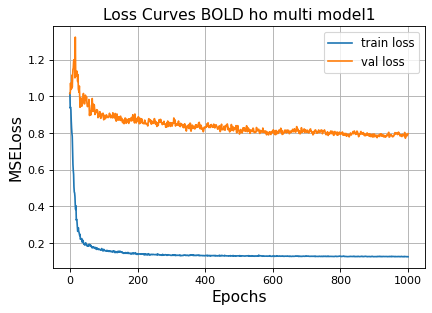

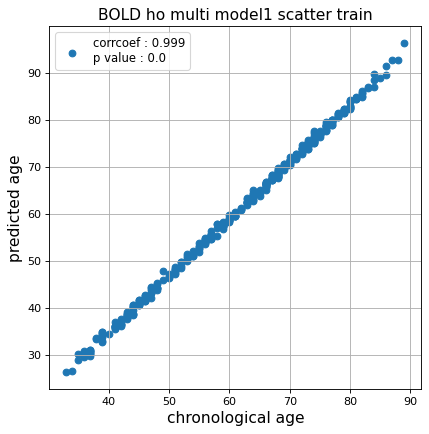

r^2 train data:  0.951556038231328


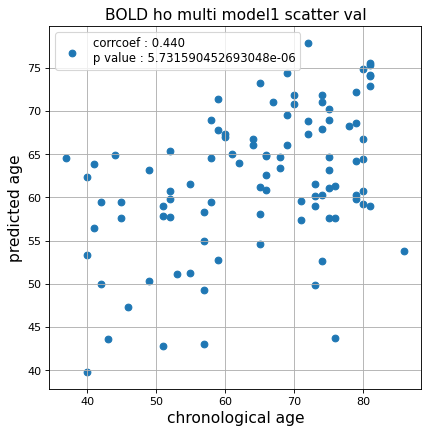

r^2 val data:  0.11484497893042611


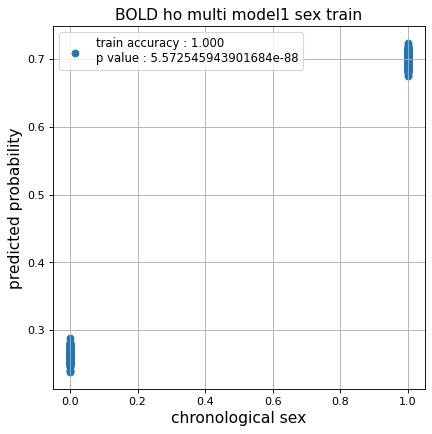

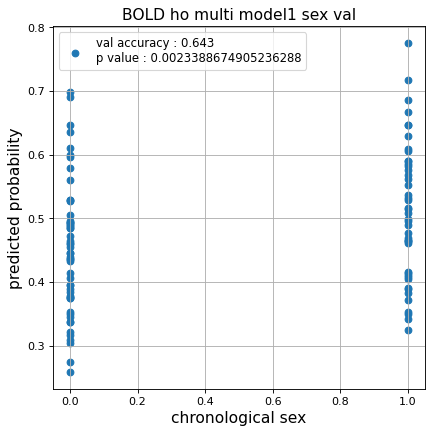

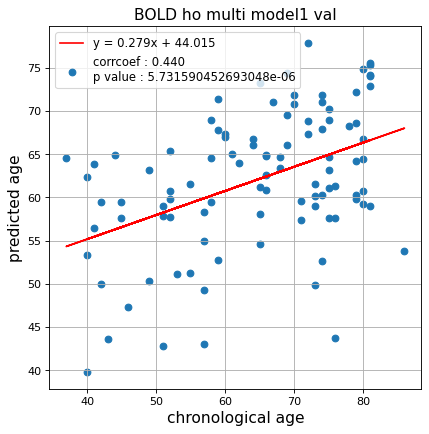

切片: 44.01488953782666
傾き: 0.2789795927120149
Nested Kfold ::: 4
Kfold: 1 ::: epoch: 100, loss: 0.17354565514967993, val loss: 0.6210584938526154
Kfold: 1 ::: epoch: 200, loss: 0.14364232122898102, val loss: 0.589693695306778
Kfold: 1 ::: epoch: 300, loss: 0.14194633754400107, val loss: 0.5793127194046974
Kfold: 1 ::: epoch: 400, loss: 0.13416015414091256, val loss: 0.5705088227987289
Kfold: 1 ::: epoch: 500, loss: 0.1326555208517955, val loss: 0.5619078725576401
Kfold: 1 ::: epoch: 600, loss: 0.13089156953188089, val loss: 0.5513532906770706
Kfold: 1 ::: epoch: 700, loss: 0.12911589787556574, val loss: 0.5366555824875832
Kfold: 1 ::: epoch: 800, loss: 0.128759510242022, val loss: 0.5292893201112747
Kfold: 1 ::: epoch: 900, loss: 0.12950306213819063, val loss: 0.5249526873230934
Kfold: 1 ::: epoch: 1000, loss: 0.12826628066026247, val loss: 0.5334305763244629
save_epochs:873
best val loss:0.5112570375204086


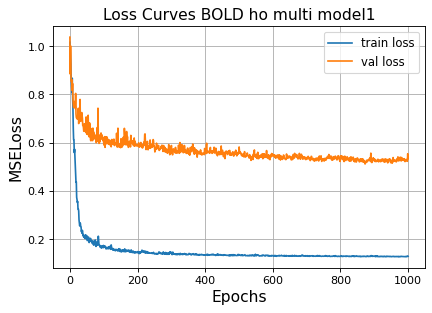

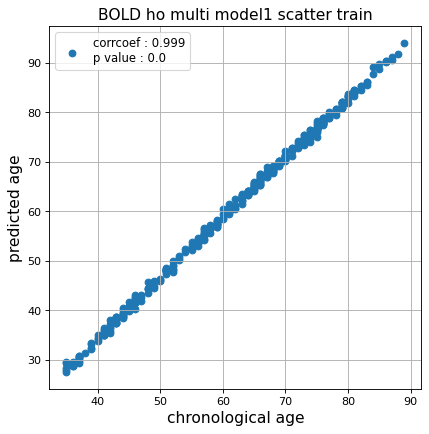

r^2 train data:  0.9505904431560562


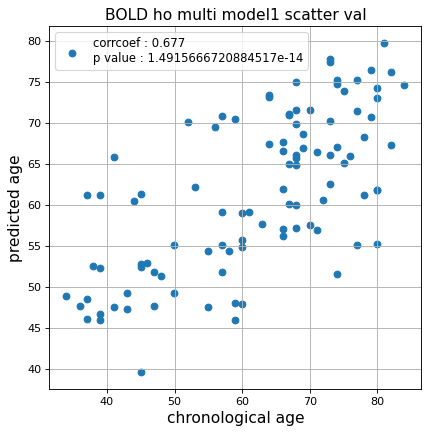

r^2 val data:  0.4558252122249692


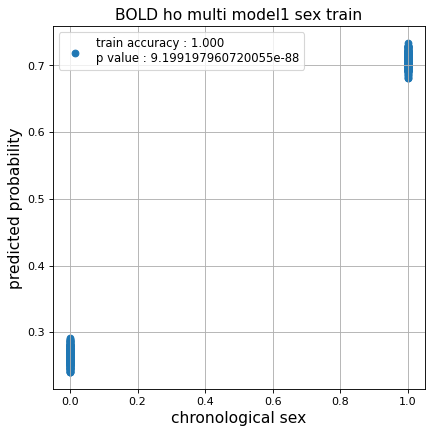

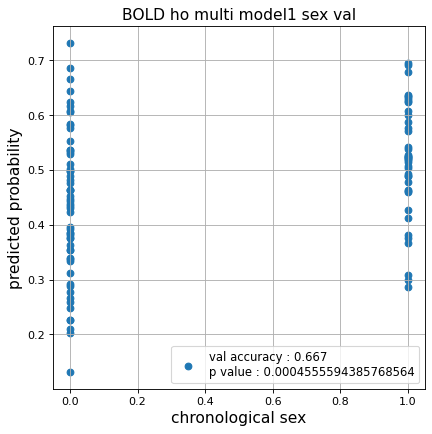

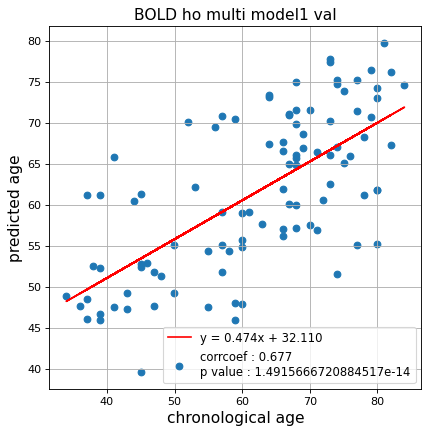

切片: 32.11024974733044
傾き: 0.4735043193763932
Kfold: 2 ::: epoch: 100, loss: 0.1643157246021124, val loss: 0.7137772291898727
Kfold: 2 ::: epoch: 200, loss: 0.14741052457919487, val loss: 0.6622903645038605
Kfold: 2 ::: epoch: 300, loss: 0.13797618677982917, val loss: 0.6151077300310135
Kfold: 2 ::: epoch: 400, loss: 0.13164408161089972, val loss: 0.6095398440957069
Kfold: 2 ::: epoch: 500, loss: 0.13102393081555, val loss: 0.5852987170219421
Kfold: 2 ::: epoch: 600, loss: 0.13020875935371107, val loss: 0.5903193056583405
Kfold: 2 ::: epoch: 700, loss: 0.1293763781969364, val loss: 0.5861095264554024
Kfold: 2 ::: epoch: 800, loss: 0.1281799192611988, val loss: 0.567881166934967
Kfold: 2 ::: epoch: 900, loss: 0.1280155904017962, val loss: 0.5662194639444351
Kfold: 2 ::: epoch: 1000, loss: 0.12663052746882805, val loss: 0.5603599846363068
save_epochs:909
best val loss:0.556057795882225


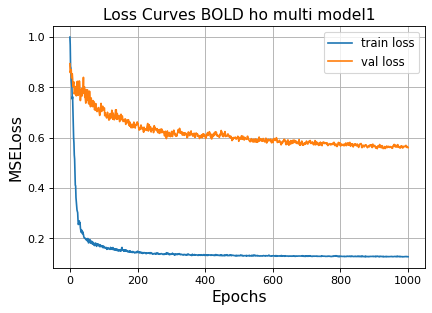

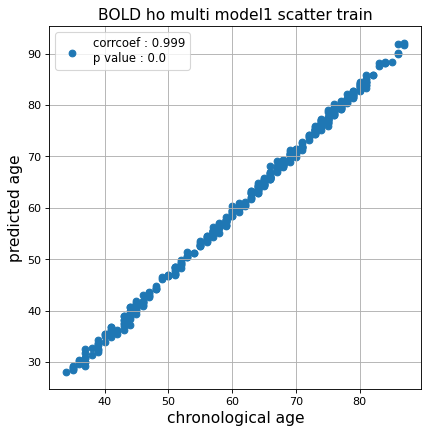

r^2 train data:  0.9467028086042444


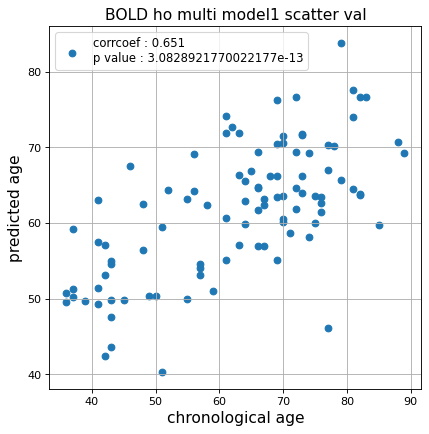

r^2 val data:  0.41799409555359945


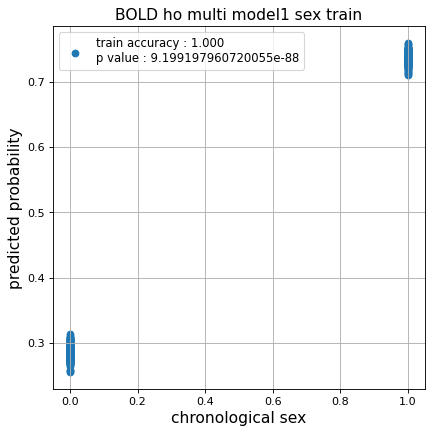

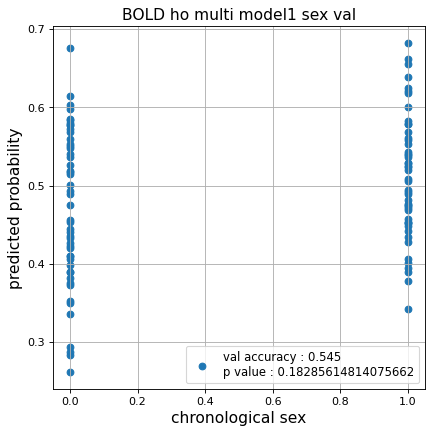

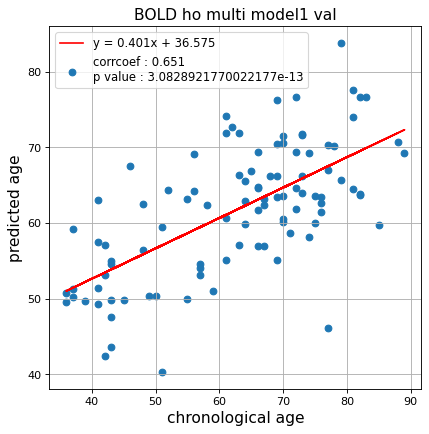

切片: 36.575150711413514
傾き: 0.40137365693143773
Kfold: 3 ::: epoch: 100, loss: 0.16106874553056863, val loss: 0.6915247291326523
Kfold: 3 ::: epoch: 200, loss: 0.13918116230231065, val loss: 0.666999101638794
Kfold: 3 ::: epoch: 300, loss: 0.13467922921364123, val loss: 0.6677749305963516
Kfold: 3 ::: epoch: 400, loss: 0.1331470482624494, val loss: 0.6482712924480438
Kfold: 3 ::: epoch: 500, loss: 0.13005709877380958, val loss: 0.6417024433612823
Kfold: 3 ::: epoch: 600, loss: 0.1294550494505809, val loss: 0.624732717871666
Kfold: 3 ::: epoch: 700, loss: 0.12838797156627363, val loss: 0.6346889734268188
early stopping
save_epochs:528
best val loss:0.6094300597906113


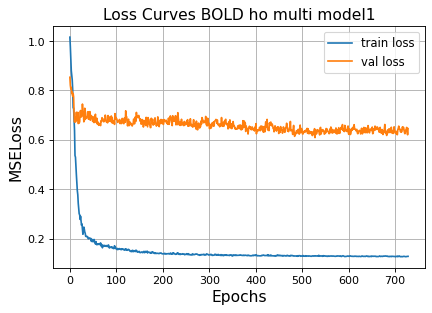

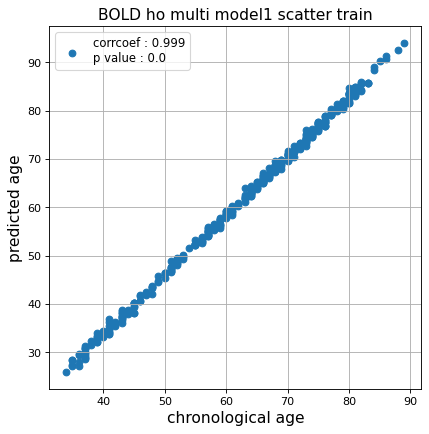

r^2 train data:  0.9397154386915682


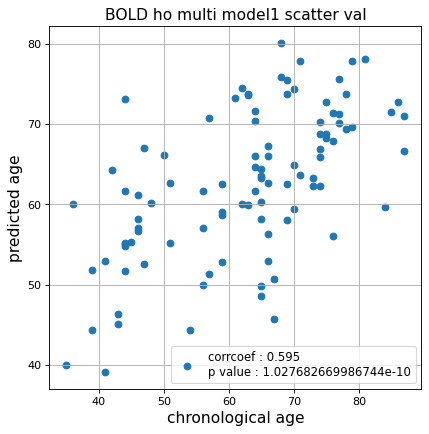

r^2 val data:  0.3426284636943632


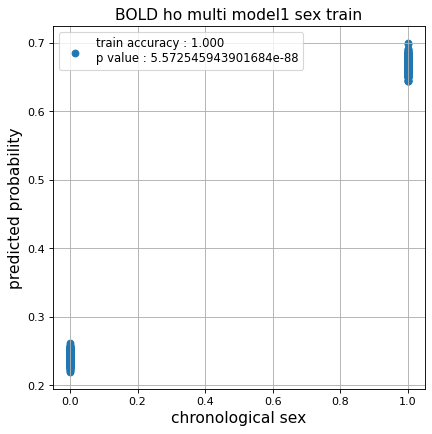

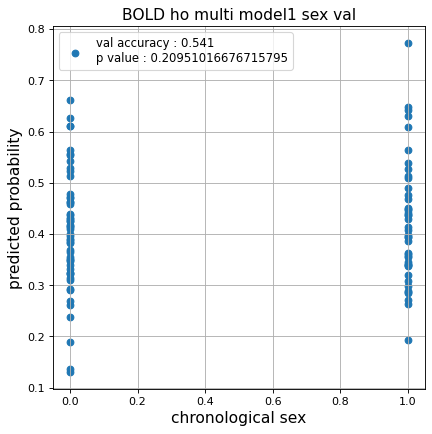

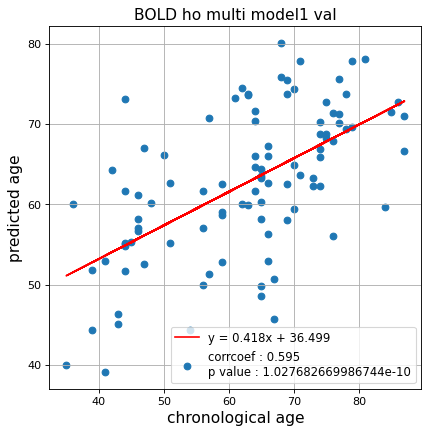

切片: 36.499210895022856
傾き: 0.41786857558638524
Kfold: 4 ::: epoch: 100, loss: 0.1555443715590697, val loss: 1.1225963234901428
Kfold: 4 ::: epoch: 200, loss: 0.13808558193536905, val loss: 1.065179094672203
Kfold: 4 ::: epoch: 300, loss: 0.13691831208192384, val loss: 1.0527374744415283
Kfold: 4 ::: epoch: 400, loss: 0.1332121594594075, val loss: 1.0182289630174637
Kfold: 4 ::: epoch: 500, loss: 0.13047700432630685, val loss: 1.0485756695270538
Kfold: 4 ::: epoch: 600, loss: 0.12935169499654037, val loss: 1.0275284796953201
Kfold: 4 ::: epoch: 700, loss: 0.1282983674452855, val loss: 1.0047144889831543
early stopping
save_epochs:536
best val loss:0.9819995015859604


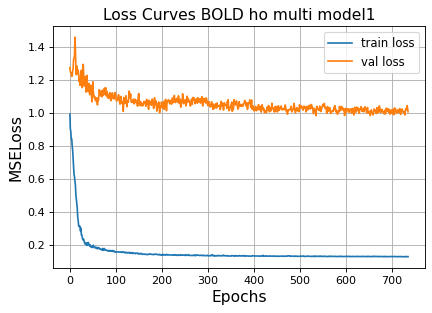

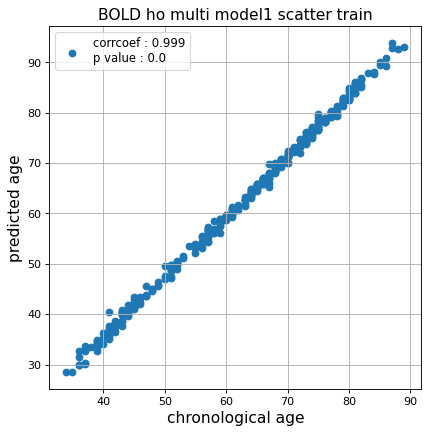

r^2 train data:  0.9587982529830794


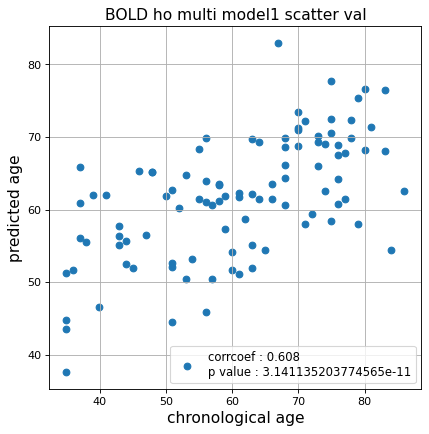

r^2 val data:  0.365728682070114


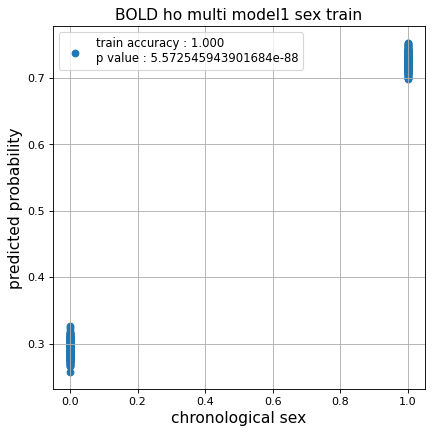

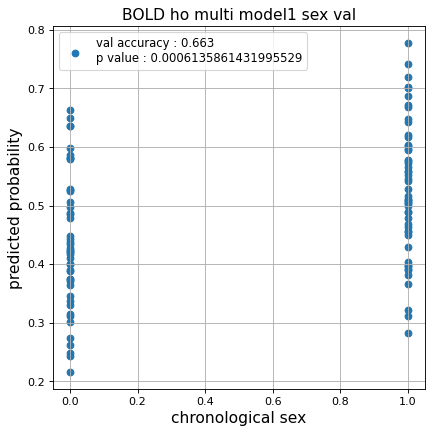

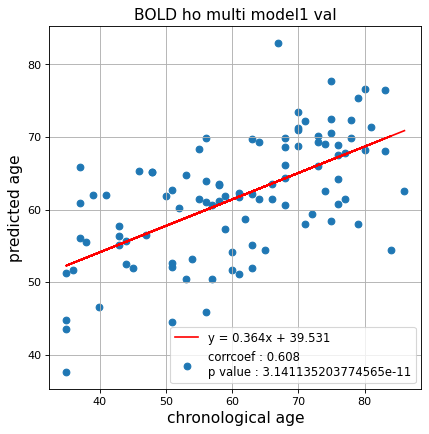

切片: 39.53106911929036
傾き: 0.364350491855403
Kfold: 5 ::: epoch: 100, loss: 0.16509903050385988, val loss: 1.0129673480987549
Kfold: 5 ::: epoch: 200, loss: 0.14565981580660894, val loss: 0.9144538044929504
Kfold: 5 ::: epoch: 300, loss: 0.1346739072066087, val loss: 0.9166595339775085
Kfold: 5 ::: epoch: 400, loss: 0.13180879446176383, val loss: 0.8726453185081482
Kfold: 5 ::: epoch: 500, loss: 0.12992120132996485, val loss: 0.8783902376890182
Kfold: 5 ::: epoch: 600, loss: 0.12919303087087777, val loss: 0.8304681479930878
Kfold: 5 ::: epoch: 700, loss: 0.12869477272033691, val loss: 0.8169995695352554
Kfold: 5 ::: epoch: 800, loss: 0.1280305924323889, val loss: 0.8189210891723633
Kfold: 5 ::: epoch: 900, loss: 0.12721112026618078, val loss: 0.7887130826711655
Kfold: 5 ::: epoch: 1000, loss: 0.12764928891108587, val loss: 0.8002681881189346
save_epochs:898
best val loss:0.786073848605156


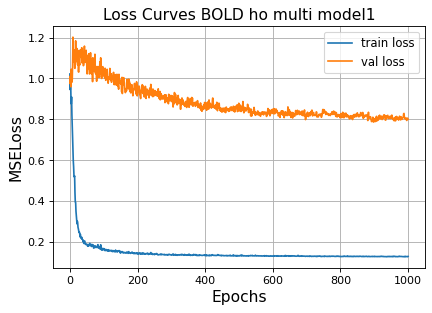

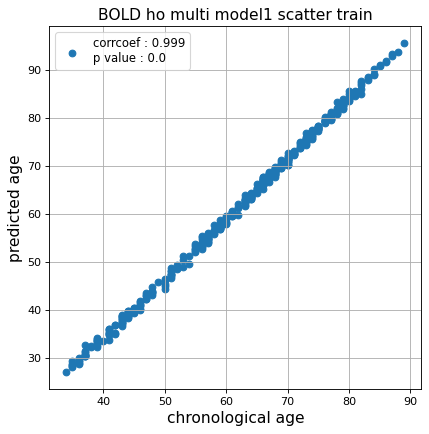

r^2 train data:  0.9329242294049351


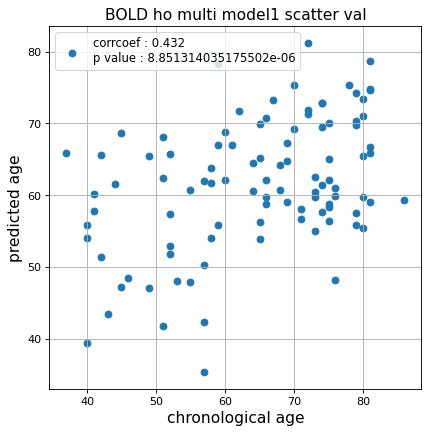

r^2 val data:  0.054115010392835505


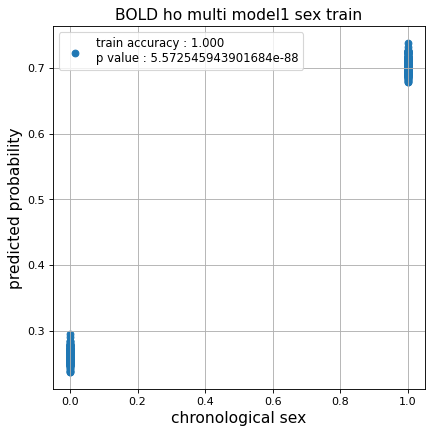

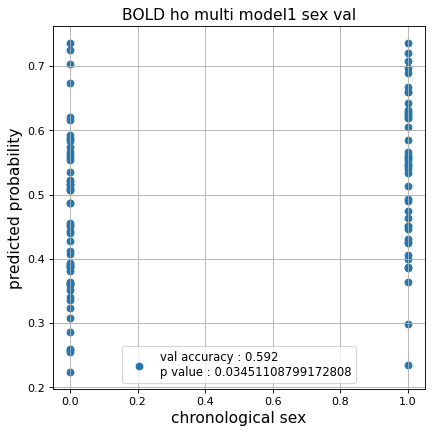

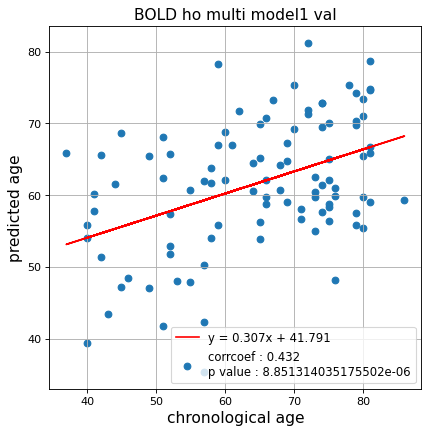

切片: 41.791482164816884
傾き: 0.3074859447636055
Nested Kfold ::: 5
Kfold: 1 ::: epoch: 100, loss: 0.16797366165197813, val loss: 0.6053028106689453
Kfold: 1 ::: epoch: 200, loss: 0.14690155593248513, val loss: 0.5820601992309093
Kfold: 1 ::: epoch: 300, loss: 0.13815651260889494, val loss: 0.5764035061001778
Kfold: 1 ::: epoch: 400, loss: 0.13461242272303656, val loss: 0.5817694216966629
Kfold: 1 ::: epoch: 500, loss: 0.1315190574297538, val loss: 0.5931548625230789
early stopping
save_epochs:314
best val loss:0.5641072392463684


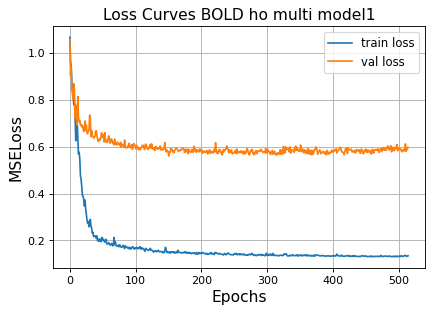

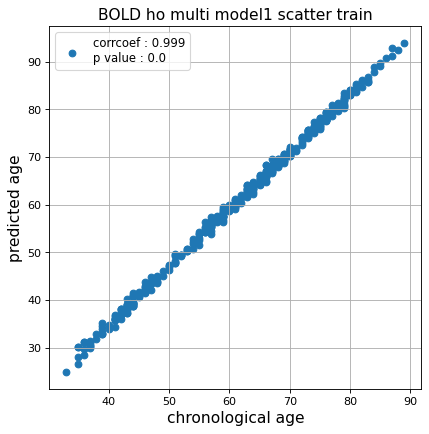

r^2 train data:  0.9519160508511095


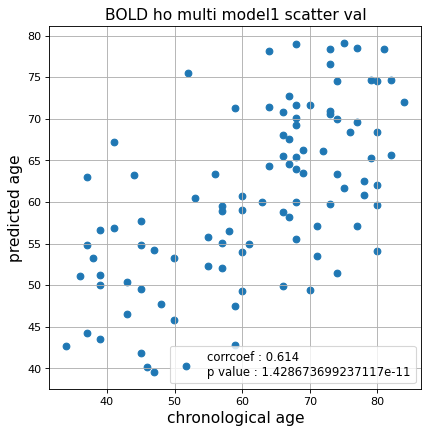

r^2 val data:  0.35518294502515735


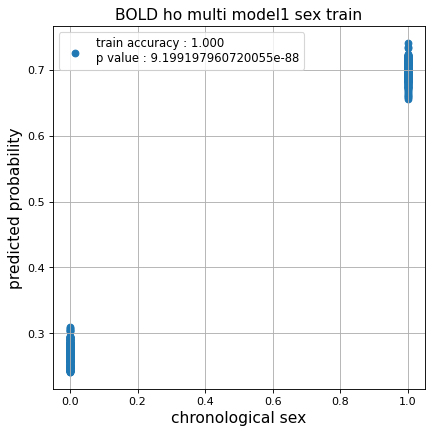

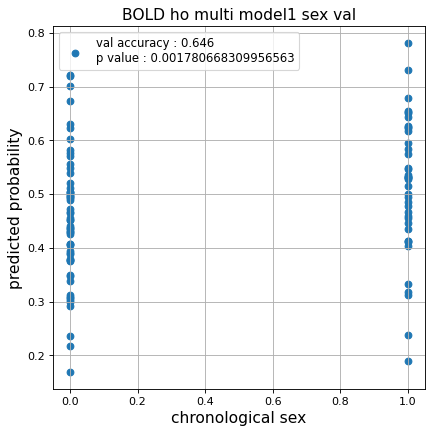

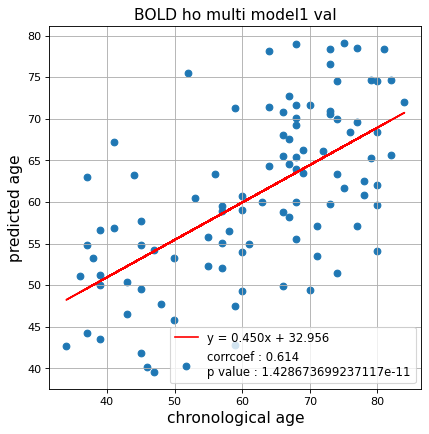

切片: 32.95601366145828
傾き: 0.44964275428964307
Kfold: 2 ::: epoch: 100, loss: 0.16152522884882414, val loss: 0.769228145480156
Kfold: 2 ::: epoch: 200, loss: 0.14430386630388406, val loss: 0.6730154901742935
Kfold: 2 ::: epoch: 300, loss: 0.13338284767591035, val loss: 0.6621360629796982
Kfold: 2 ::: epoch: 400, loss: 0.1309061233813946, val loss: 0.6454314365983009
Kfold: 2 ::: epoch: 500, loss: 0.13151465356349945, val loss: 0.6272250786423683
Kfold: 2 ::: epoch: 600, loss: 0.12900332189523256, val loss: 0.6159650981426239
Kfold: 2 ::: epoch: 700, loss: 0.1283809760442147, val loss: 0.6084590926766396
Kfold: 2 ::: epoch: 800, loss: 0.12723744030182177, val loss: 0.5893605574965477
Kfold: 2 ::: epoch: 900, loss: 0.12623068403739196, val loss: 0.6000818759202957
Kfold: 2 ::: epoch: 1000, loss: 0.12668562279297754, val loss: 0.6067026257514954
save_epochs:860
best val loss:0.5860437229275703


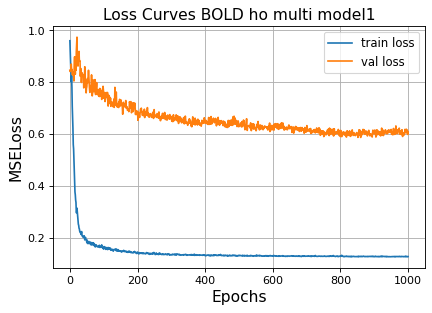

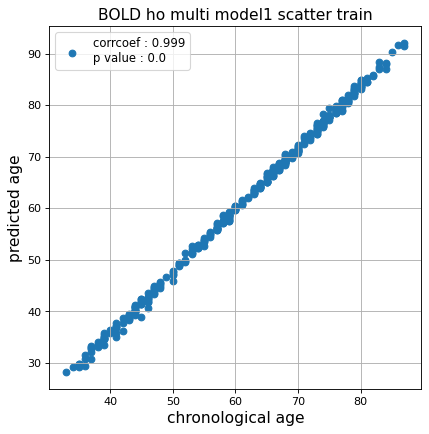

r^2 train data:  0.9572681906790064


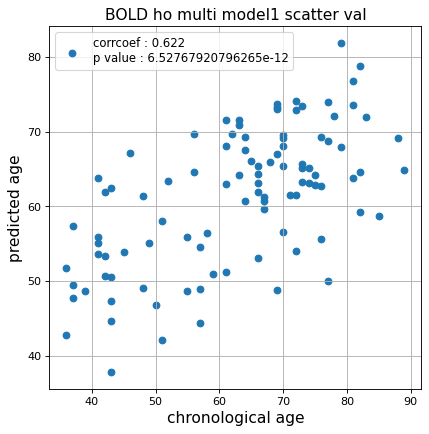

r^2 val data:  0.3768755651238628


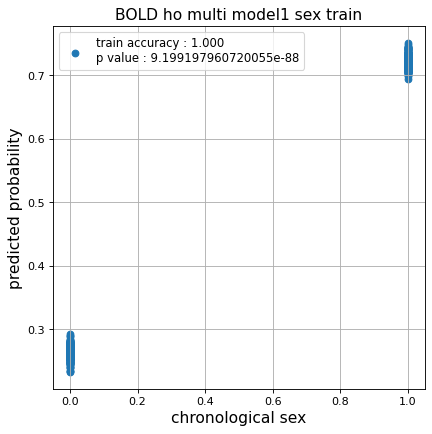

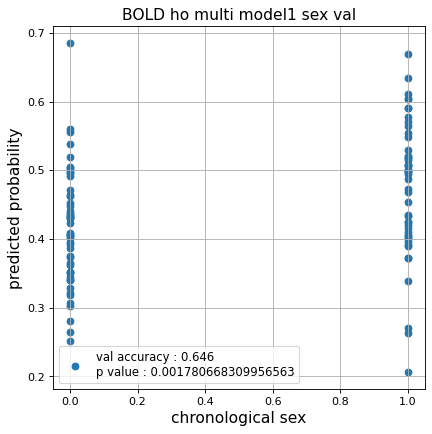

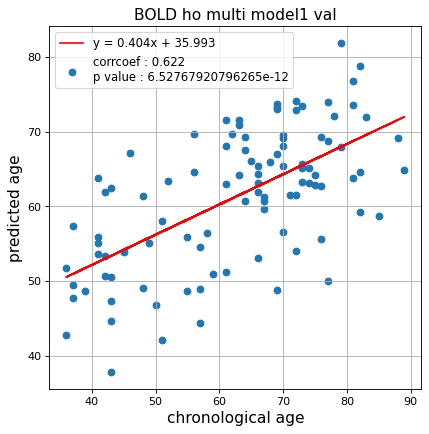

切片: 35.99320909537087
傾き: 0.40428046718749694
Kfold: 3 ::: epoch: 100, loss: 0.1646252182813791, val loss: 0.5640630349516869
Kfold: 3 ::: epoch: 200, loss: 0.14197902725293085, val loss: 0.5370120108127594
Kfold: 3 ::: epoch: 300, loss: 0.13558921905664298, val loss: 0.5514043420553207
Kfold: 3 ::: epoch: 400, loss: 0.13212796587210435, val loss: 0.5056480914354324
Kfold: 3 ::: epoch: 500, loss: 0.130357020176374, val loss: 0.4969245046377182
Kfold: 3 ::: epoch: 600, loss: 0.13101682296166053, val loss: 0.49855367839336395
Kfold: 3 ::: epoch: 700, loss: 0.1288574326496858, val loss: 0.494919590651989
Kfold: 3 ::: epoch: 800, loss: 0.12737528865153974, val loss: 0.4781523384153843
Kfold: 3 ::: epoch: 900, loss: 0.1272882200204409, val loss: 0.48044266551733017
Kfold: 3 ::: epoch: 1000, loss: 0.12698271755988783, val loss: 0.47679443657398224
save_epochs:996
best val loss:0.4661799892783165


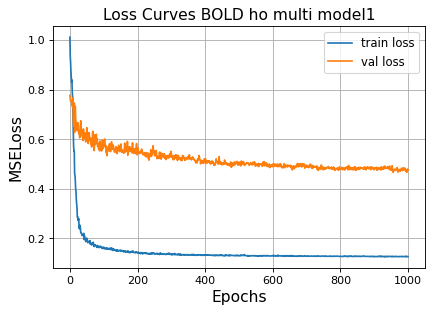

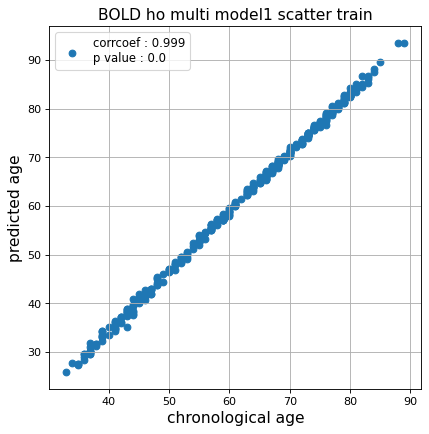

r^2 train data:  0.947035705263516


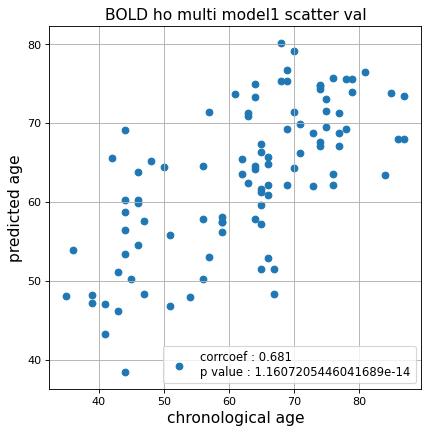

r^2 val data:  0.460949937202097


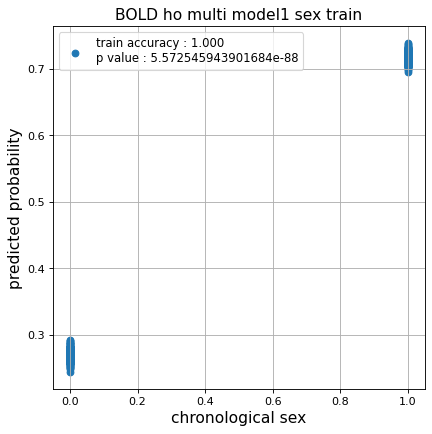

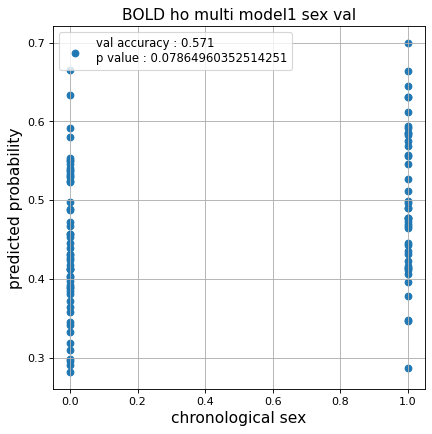

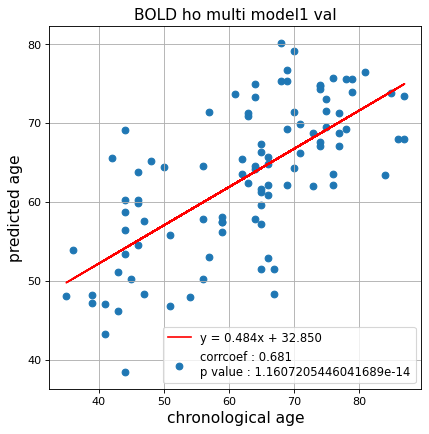

切片: 32.8498505953462
傾き: 0.4841038960142467
Kfold: 4 ::: epoch: 100, loss: 0.16654642499410188, val loss: 0.5773690342903137
Kfold: 4 ::: epoch: 200, loss: 0.1421300986638436, val loss: 0.5192636400461197
Kfold: 4 ::: epoch: 300, loss: 0.13549797810040987, val loss: 0.46804559975862503
Kfold: 4 ::: epoch: 400, loss: 0.1312171106155102, val loss: 0.4502551443874836
Kfold: 4 ::: epoch: 500, loss: 0.1298673519721398, val loss: 0.43926839530467987
Kfold: 4 ::: epoch: 600, loss: 0.12927310054118818, val loss: 0.4442918300628662
Kfold: 4 ::: epoch: 700, loss: 0.12917891374001136, val loss: 0.44250404834747314
Kfold: 4 ::: epoch: 800, loss: 0.12756327940867498, val loss: 0.42949122190475464
Kfold: 4 ::: epoch: 900, loss: 0.12838499362652117, val loss: 0.4313959926366806
Kfold: 4 ::: epoch: 1000, loss: 0.12675956235482141, val loss: 0.4293786510825157
save_epochs:849
best val loss:0.4221344143152237


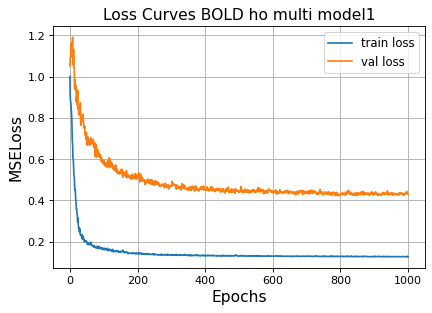

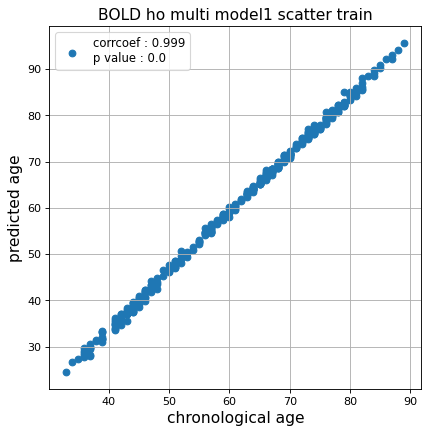

r^2 train data:  0.9283241484989877


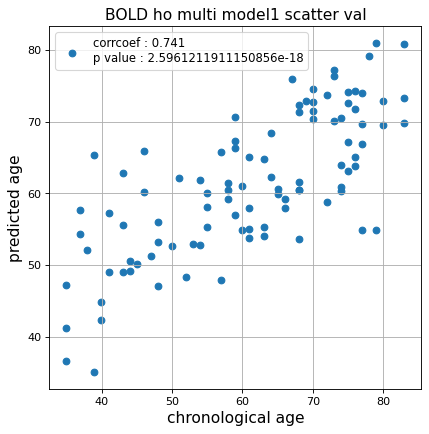

r^2 val data:  0.5487242052766417


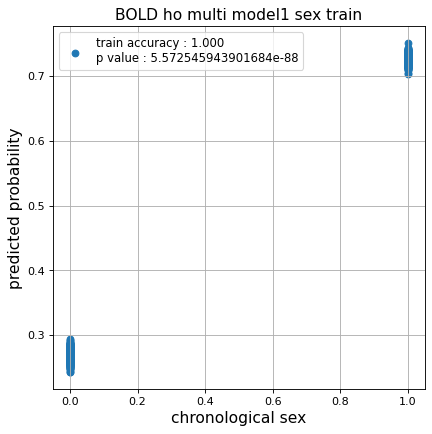

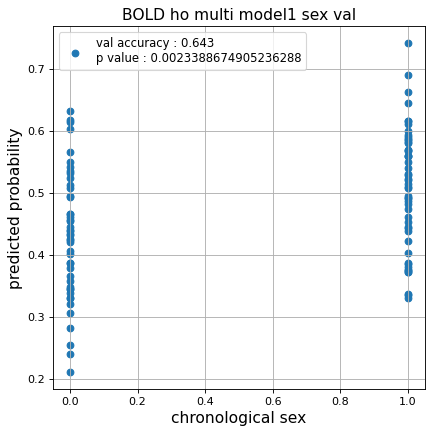

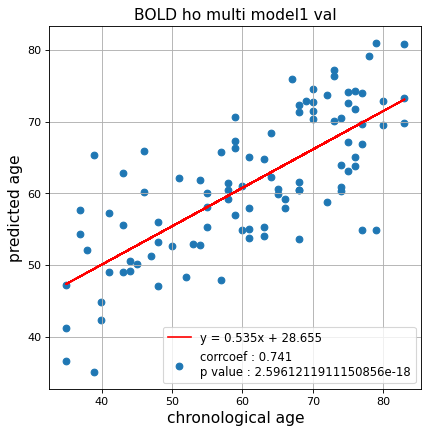

切片: 28.654893309236428
傾き: 0.5354579533363472
Kfold: 5 ::: epoch: 100, loss: 0.15981350724513715, val loss: 0.8263345062732697
Kfold: 5 ::: epoch: 200, loss: 0.13893463863776281, val loss: 0.8123737573623657
Kfold: 5 ::: epoch: 300, loss: 0.1345415161206172, val loss: 0.8005111962556839
Kfold: 5 ::: epoch: 400, loss: 0.13144980141749749, val loss: 0.8295170068740845
early stopping
save_epochs:247
best val loss:0.7527609616518021


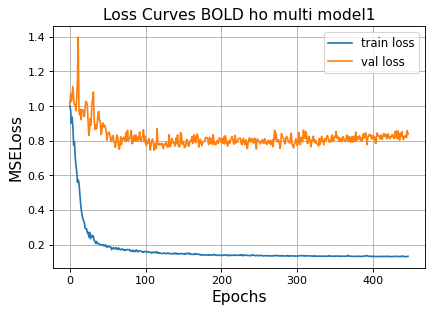

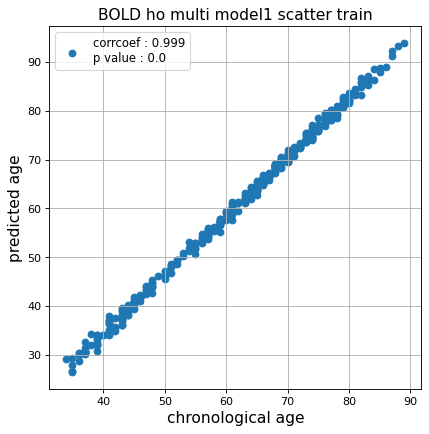

r^2 train data:  0.9483906720038379


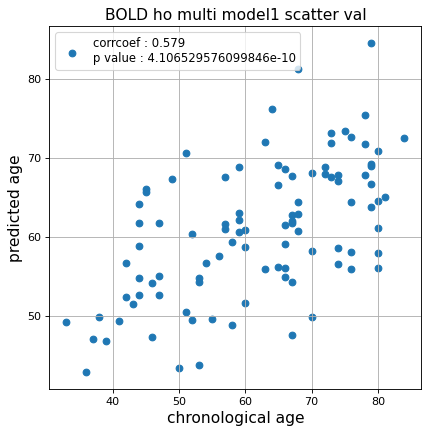

r^2 val data:  0.32483350154822777


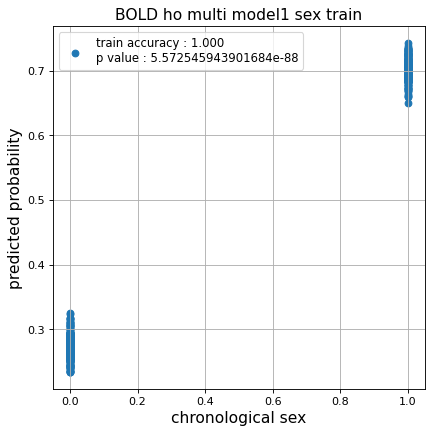

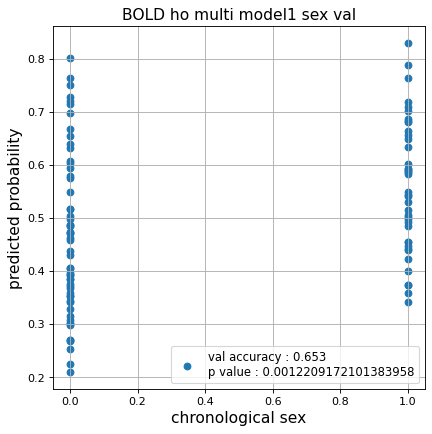

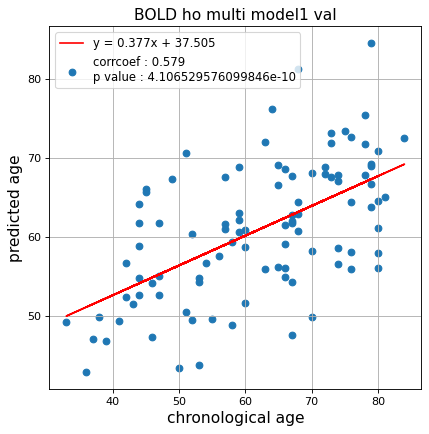

切片: 37.50490893685368
傾き: 0.377148750614326
CPU times: user 1h 55min 55s, sys: 16min 32s, total: 2h 12min 28s
Wall time: 2h 12min 44s


In [25]:
%%time
fold = KFold(n_splits=n_splits,shuffle=False)

test_pred_ho_1  = []
test_pred_ho_corrected_1  = []
test_label_ho_1 = []
test_idx_ho_1   = []

for fold_idx, (train_idx, test_idx) in enumerate(fold.split(data_ho)):
    print(f'Nested Kfold ::: {fold_idx+1}')
    test_pred,test_pred_corrected,test_label = train_model(data_ho,
                                                           data_label,
                                                           train_idx  = train_idx,
                                                           test_idx   = test_idx,
                                                           epochs     = 1000,
                                                           d_model    = 256,
                                                           n_splits   = n_splits,
                                                           hidden_dim = 1024,
                                                           nhead      = 32,
                                                           hidden_dim_transformer = 2,
                                                           pos_drop    = 0.1,
                                                           trans_drop = 0.2,
                                                           fc_drop = 0.1,
                                                           title = 'ROI ho multi model1'
                                                          )
    
    test_pred_ho_1.append(test_pred)
    test_pred_ho_corrected_1.append(test_pred_corrected)
    test_label_ho_1.append(test_label)
    test_idx_ho_1.append(test_idx)

### ROI 2

Nested Kfold ::: 1
Kfold: 1 ::: epoch: 100, loss: 0.17636936902999878, val loss: 0.7495137155056
Kfold: 1 ::: epoch: 200, loss: 0.16370784090115473, val loss: 0.700398750603199
Kfold: 1 ::: epoch: 300, loss: 0.14891987695143774, val loss: 0.6776849627494812
Kfold: 1 ::: epoch: 400, loss: 0.13895510595578414, val loss: 0.6329746395349503
Kfold: 1 ::: epoch: 500, loss: 0.13756194137609923, val loss: 0.6372853294014931
Kfold: 1 ::: epoch: 600, loss: 0.13568523296943077, val loss: 0.6141011193394661
Kfold: 1 ::: epoch: 700, loss: 0.13230516474980575, val loss: 0.6125663295388222
Kfold: 1 ::: epoch: 800, loss: 0.13163651869847223, val loss: 0.5994216501712799
Kfold: 1 ::: epoch: 900, loss: 0.13102648923030266, val loss: 0.5993260890245438
Kfold: 1 ::: epoch: 1000, loss: 0.1287847264454915, val loss: 0.5797218792140484
save_epochs:994
best val loss:0.5727122388780117


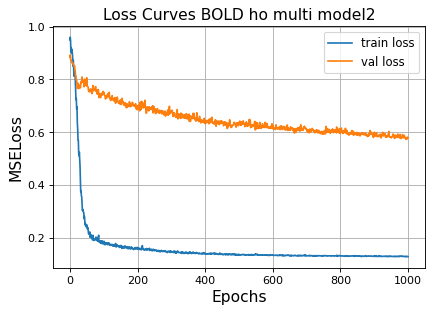

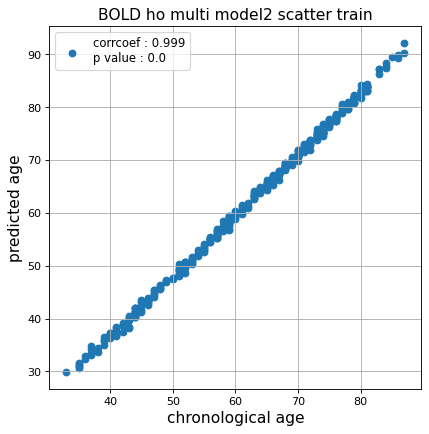

r^2 train data:  0.9739908735929234


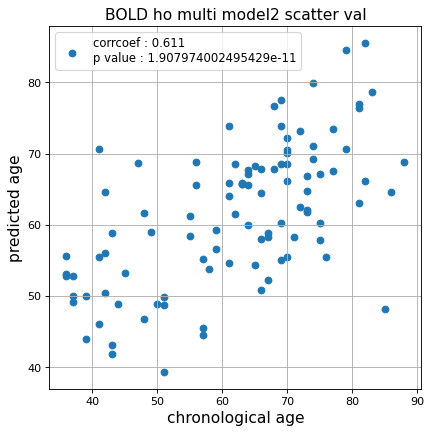

r^2 val data:  0.36130875991377787


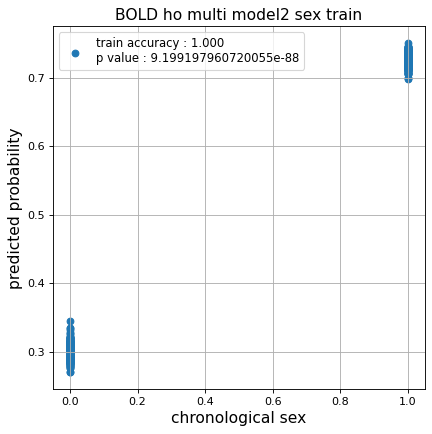

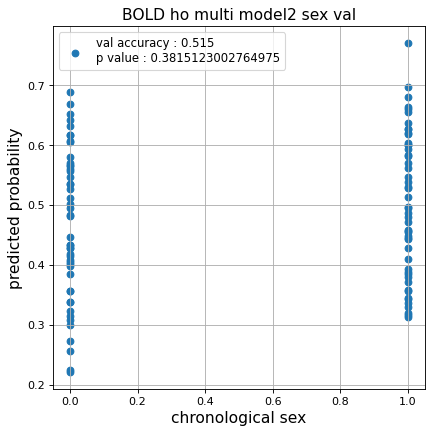

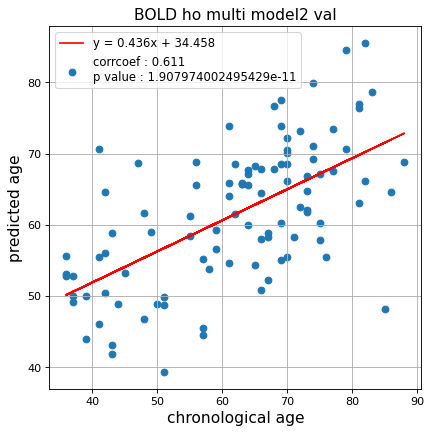

切片: 34.45759215304184
傾き: 0.4363775806938218
Kfold: 2 ::: epoch: 100, loss: 0.18455680173176986, val loss: 0.6537313312292099
Kfold: 2 ::: epoch: 200, loss: 0.15921019132320696, val loss: 0.6794655174016953
Kfold: 2 ::: epoch: 300, loss: 0.1468304109114867, val loss: 0.7049716711044312
Kfold: 2 ::: epoch: 400, loss: 0.13987679664905256, val loss: 0.6761263012886047
Kfold: 2 ::: epoch: 500, loss: 0.1366953792480322, val loss: 0.6642735451459885
Kfold: 2 ::: epoch: 600, loss: 0.13311625329347757, val loss: 0.6849293559789658
Kfold: 2 ::: epoch: 700, loss: 0.13253137354667371, val loss: 0.6420493423938751
Kfold: 2 ::: epoch: 800, loss: 0.1302996793618569, val loss: 0.6673386842012405
Kfold: 2 ::: epoch: 900, loss: 0.12990715755866125, val loss: 0.652064636349678
Kfold: 2 ::: epoch: 1000, loss: 0.13000725209712982, val loss: 0.6575398445129395
save_epochs:907
best val loss:0.6153708696365356


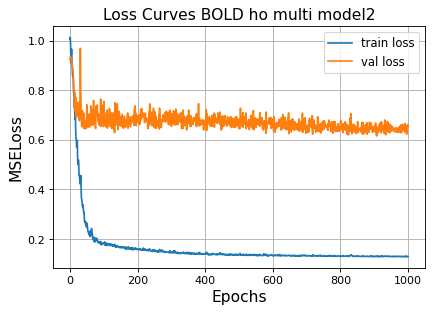

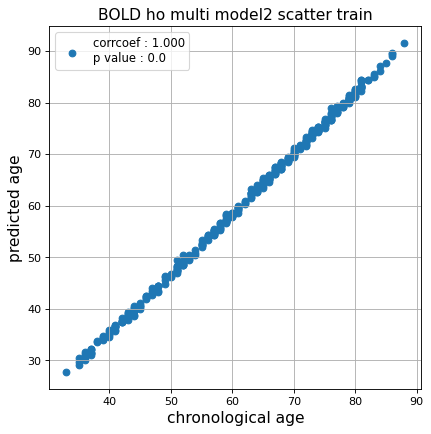

r^2 train data:  0.96345363030785


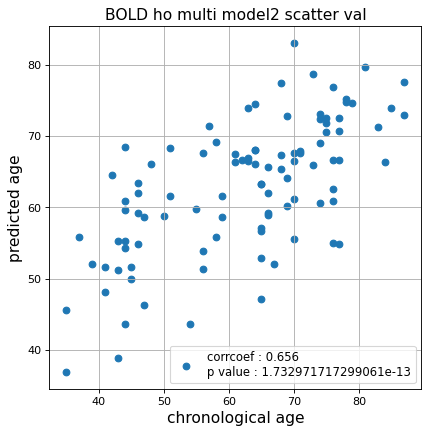

r^2 val data:  0.42522405017170284


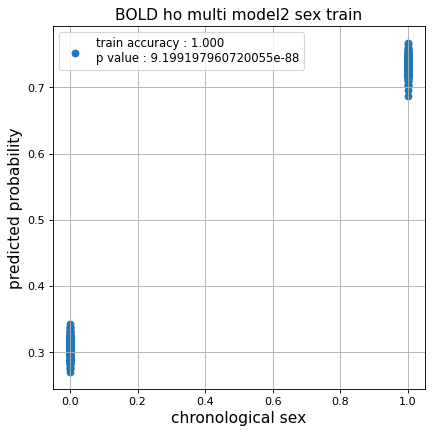

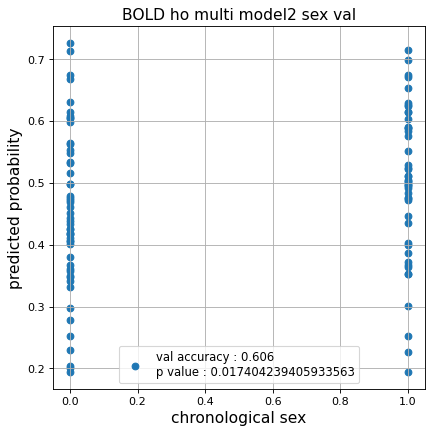

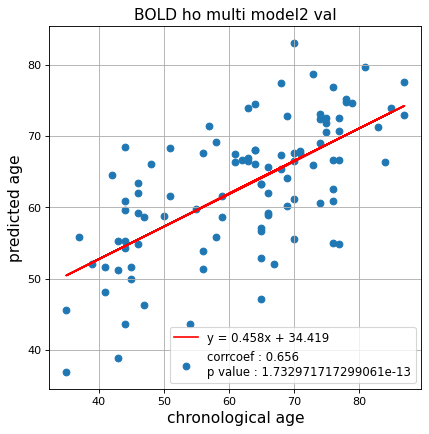

切片: 34.41880243944419
傾き: 0.4579718071571151
Kfold: 3 ::: epoch: 100, loss: 0.1806523192387361, val loss: 0.7607600390911102
Kfold: 3 ::: epoch: 200, loss: 0.16172399887671837, val loss: 0.6749889403581619
Kfold: 3 ::: epoch: 300, loss: 0.1516092580098372, val loss: 0.698294073343277
Kfold: 3 ::: epoch: 400, loss: 0.1432801209963285, val loss: 0.6709368228912354
Kfold: 3 ::: epoch: 500, loss: 0.13815352320671082, val loss: 0.6558945626020432
Kfold: 3 ::: epoch: 600, loss: 0.1348316497527636, val loss: 0.6069627702236176
Kfold: 3 ::: epoch: 700, loss: 0.13185725876918206, val loss: 0.6142962723970413
Kfold: 3 ::: epoch: 800, loss: 0.13049888266966894, val loss: 0.6039170622825623
Kfold: 3 ::: epoch: 900, loss: 0.13083335413382605, val loss: 0.5858168452978134
Kfold: 3 ::: epoch: 1000, loss: 0.12878106992978317, val loss: 0.5935263186693192
save_epochs:993
best val loss:0.5707594752311707


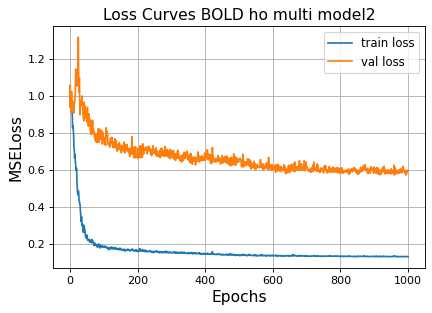

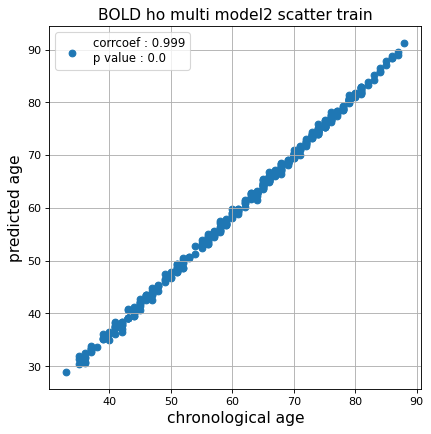

r^2 train data:  0.9758862506914935


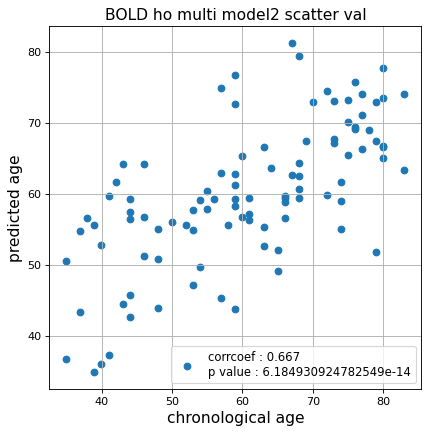

r^2 val data:  0.43827069795360973


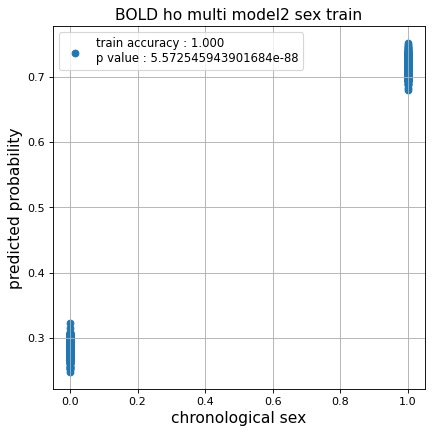

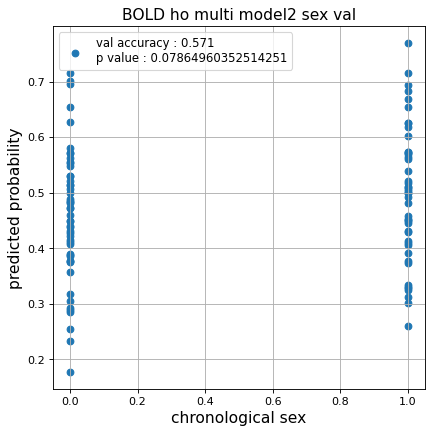

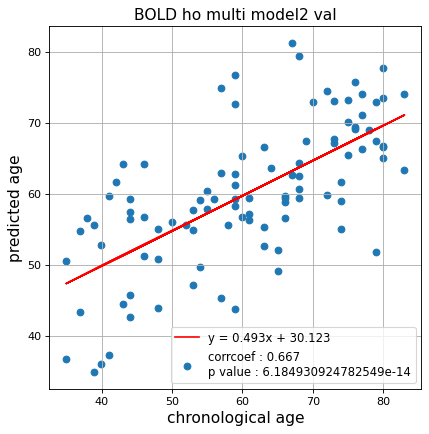

切片: 30.12255293553803
傾き: 0.49331634265550006
Kfold: 4 ::: epoch: 100, loss: 0.18230947508261755, val loss: 1.2793833017349243
Kfold: 4 ::: epoch: 200, loss: 0.16290988830419686, val loss: 1.2574851363897324
Kfold: 4 ::: epoch: 300, loss: 0.14928265832937682, val loss: 1.2366529256105423
Kfold: 4 ::: epoch: 400, loss: 0.13875771600466508, val loss: 1.2556359022855759
Kfold: 4 ::: epoch: 500, loss: 0.13661091258892646, val loss: 1.15472811460495
Kfold: 4 ::: epoch: 600, loss: 0.13512458480321443, val loss: 1.1886349469423294
Kfold: 4 ::: epoch: 700, loss: 0.13255334358948928, val loss: 1.1341302692890167
Kfold: 4 ::: epoch: 800, loss: 0.1320547851232382, val loss: 1.1465923190116882
Kfold: 4 ::: epoch: 900, loss: 0.1304313769707313, val loss: 1.1103158444166183
Kfold: 4 ::: epoch: 1000, loss: 0.12956853210926056, val loss: 1.1145253628492355
save_epochs:944
best val loss:1.072043091058731


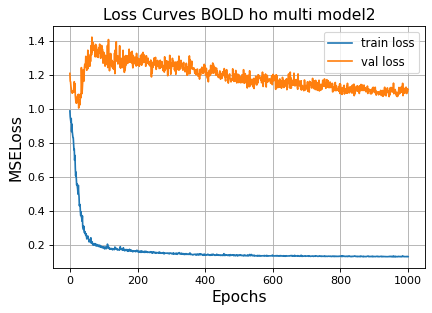

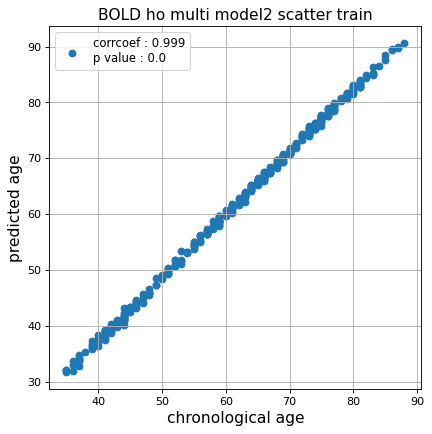

r^2 train data:  0.981878286055896


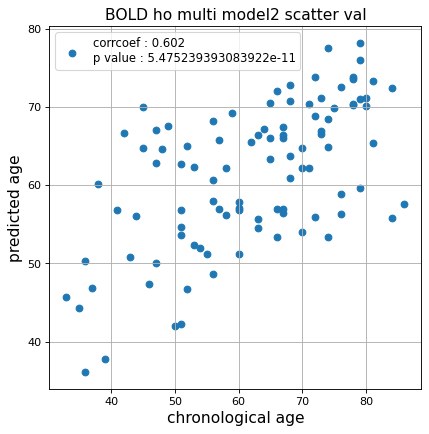

r^2 val data:  0.35240237196613877


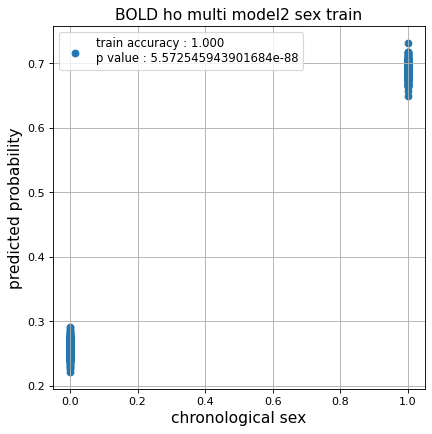

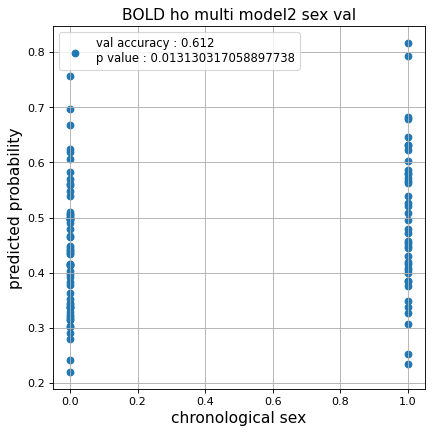

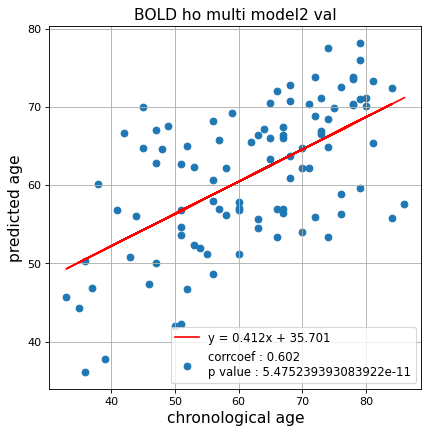

切片: 35.70055470408913
傾き: 0.41247199034075566
Kfold: 5 ::: epoch: 100, loss: 0.17873958097054407, val loss: 0.8100009858608246
Kfold: 5 ::: epoch: 200, loss: 0.15580308781220362, val loss: 0.7829528152942657
Kfold: 5 ::: epoch: 300, loss: 0.14698046789719507, val loss: 0.7442795932292938
Kfold: 5 ::: epoch: 400, loss: 0.1380375623703003, val loss: 0.747331902384758
Kfold: 5 ::: epoch: 500, loss: 0.13568934225119078, val loss: 0.7252497971057892
Kfold: 5 ::: epoch: 600, loss: 0.13218980912978834, val loss: 0.7136043161153793
Kfold: 5 ::: epoch: 700, loss: 0.13112098322464869, val loss: 0.7012875229120255
Kfold: 5 ::: epoch: 800, loss: 0.13084839857541597, val loss: 0.6826178133487701
Kfold: 5 ::: epoch: 900, loss: 0.12954907004649824, val loss: 0.6851600706577301
Kfold: 5 ::: epoch: 1000, loss: 0.12988538696215704, val loss: 0.6715334355831146
save_epochs:867
best val loss:0.6592088788747787


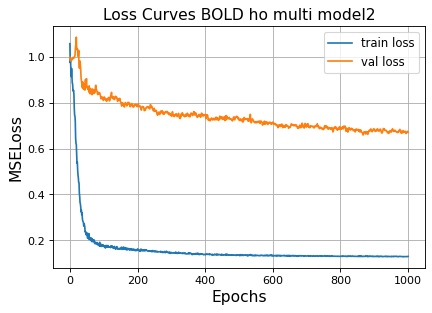

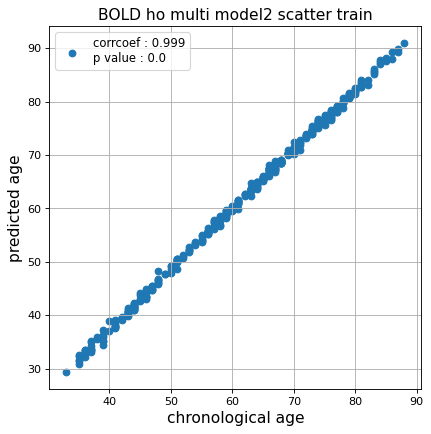

r^2 train data:  0.9835711833345224


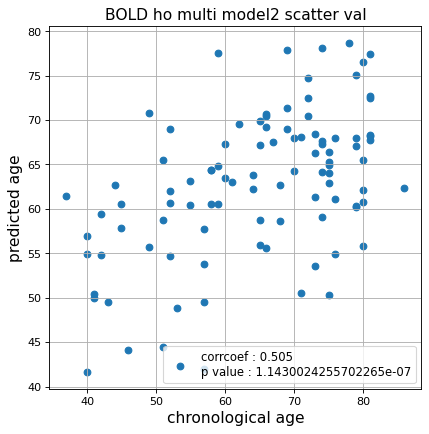

r^2 val data:  0.21806703727196497


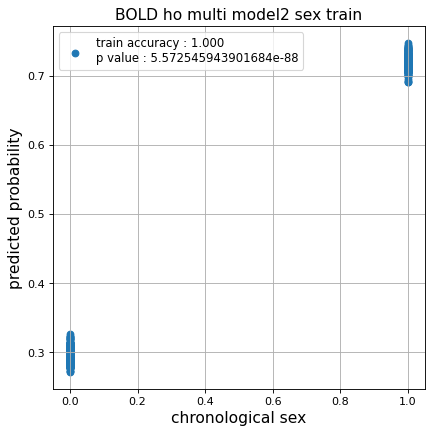

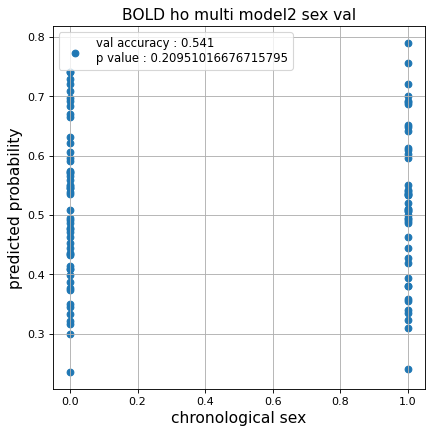

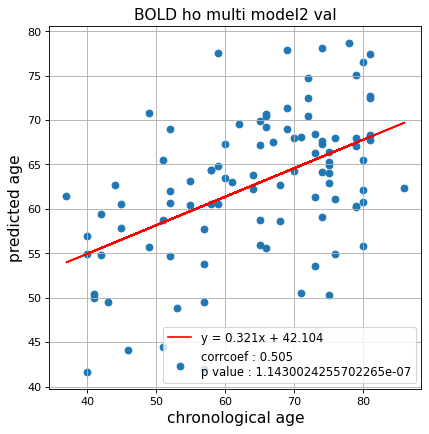

切片: 42.10426320412509
傾き: 0.3208988206042794
Nested Kfold ::: 2
Kfold: 1 ::: epoch: 100, loss: 0.17664557236891526, val loss: 0.7533974498510361
Kfold: 1 ::: epoch: 200, loss: 0.16401665256573603, val loss: 0.7023589536547661
Kfold: 1 ::: epoch: 300, loss: 0.15092395360653216, val loss: 0.6716496348381042
Kfold: 1 ::: epoch: 400, loss: 0.14324955527599043, val loss: 0.6178784221410751
Kfold: 1 ::: epoch: 500, loss: 0.13712697418836448, val loss: 0.6131781749427319
Kfold: 1 ::: epoch: 600, loss: 0.1369460683602553, val loss: 0.5938676856458187
Kfold: 1 ::: epoch: 700, loss: 0.1337220875116495, val loss: 0.580550953745842
Kfold: 1 ::: epoch: 800, loss: 0.13249317384683168, val loss: 0.5626344233751297
Kfold: 1 ::: epoch: 900, loss: 0.1308481555718642, val loss: 0.5558407083153725
Kfold: 1 ::: epoch: 1000, loss: 0.12885107673131502, val loss: 0.5415932051837444
save_epochs:994
best val loss:0.535656038671732


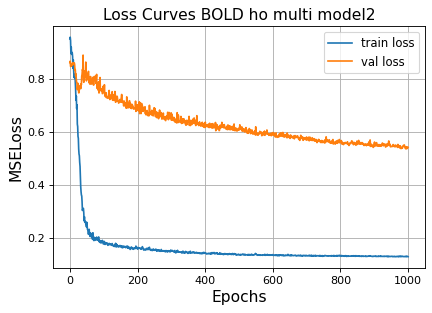

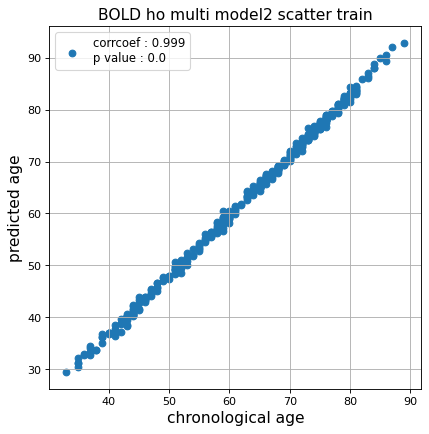

r^2 train data:  0.9739067948314221


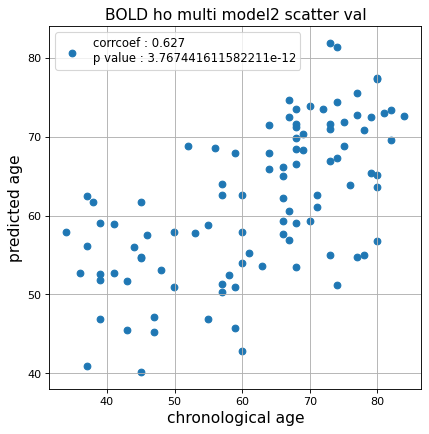

r^2 val data:  0.3882933847060569


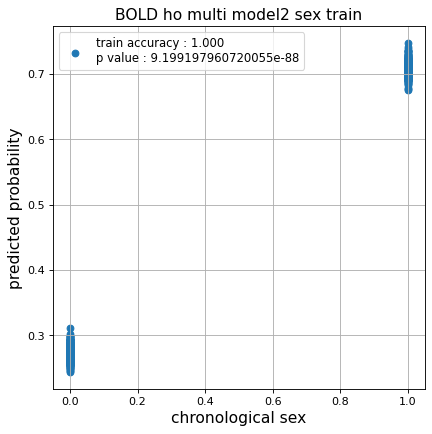

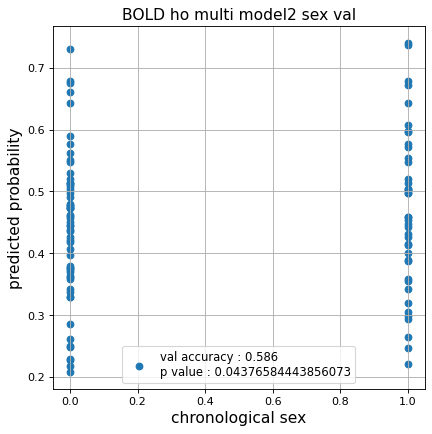

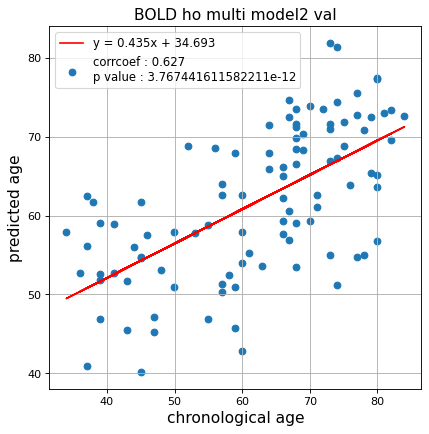

切片: 34.692947988708546
傾き: 0.43518963128066596
Kfold: 2 ::: epoch: 100, loss: 0.18243515949982864, val loss: 0.872916117310524
Kfold: 2 ::: epoch: 200, loss: 0.1548948952784905, val loss: 0.8955110013484955
Kfold: 2 ::: epoch: 300, loss: 0.14741876606757826, val loss: 0.924496591091156
Kfold: 2 ::: epoch: 400, loss: 0.14031528738828805, val loss: 0.8349535465240479
Kfold: 2 ::: epoch: 500, loss: 0.13687567527477557, val loss: 0.8283291757106781
Kfold: 2 ::: epoch: 600, loss: 0.13779006210657266, val loss: 0.8817519545555115
Kfold: 2 ::: epoch: 700, loss: 0.13307802149882683, val loss: 0.8337206244468689
Kfold: 2 ::: epoch: 800, loss: 0.1295523173533953, val loss: 0.8197308331727982
early stopping
save_epochs:660
best val loss:0.7809189110994339


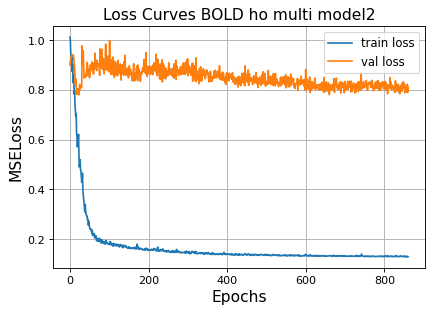

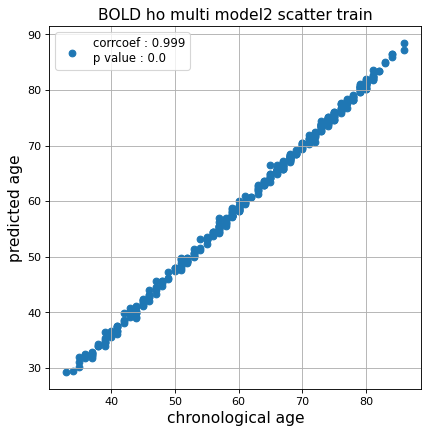

r^2 train data:  0.9774168465788297


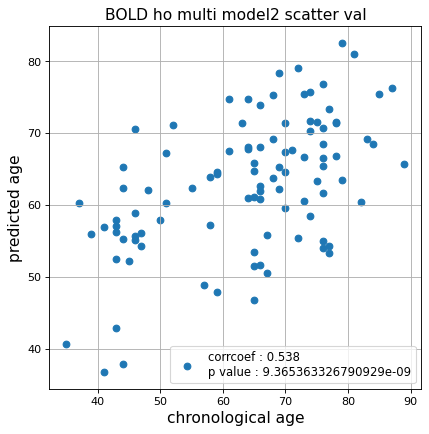

r^2 val data:  0.26041496856622837


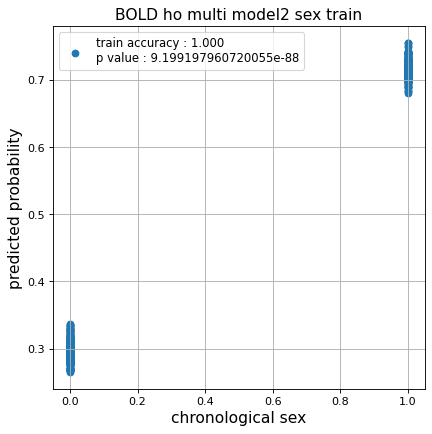

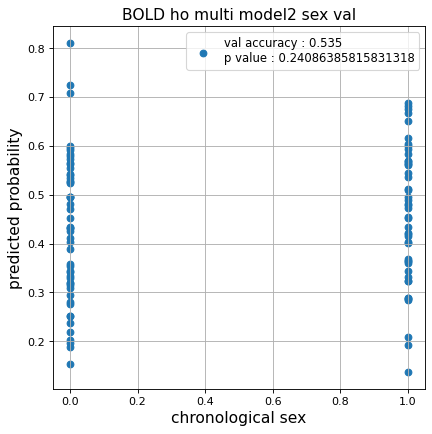

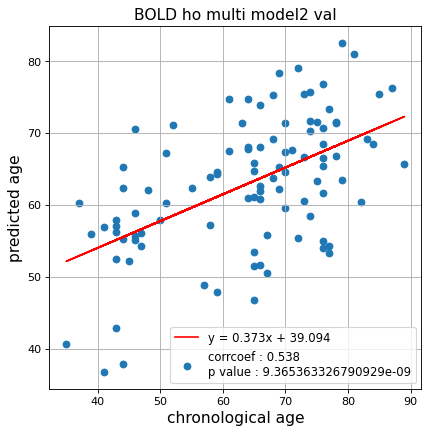

切片: 39.09439787989149
傾き: 0.37296866290490654
Kfold: 3 ::: epoch: 100, loss: 0.17746689113286826, val loss: 1.0549627989530563
Kfold: 3 ::: epoch: 200, loss: 0.1531149699137761, val loss: 1.0678253173828125
Kfold: 3 ::: epoch: 300, loss: 0.14628747793344352, val loss: 1.006202444434166
Kfold: 3 ::: epoch: 400, loss: 0.13701638693992907, val loss: 0.9676136821508408
Kfold: 3 ::: epoch: 500, loss: 0.13530494960454795, val loss: 0.9827932864427567
Kfold: 3 ::: epoch: 600, loss: 0.13361924657454857, val loss: 0.9538365304470062
Kfold: 3 ::: epoch: 700, loss: 0.13379514102752393, val loss: 0.8948666006326675
Kfold: 3 ::: epoch: 800, loss: 0.13066472113132477, val loss: 0.936398908495903
Kfold: 3 ::: epoch: 900, loss: 0.12999732907001788, val loss: 0.9767564386129379
Kfold: 3 ::: epoch: 1000, loss: 0.12971293123868796, val loss: 0.9431720823049545
save_epochs:937
best val loss:0.8761987239122391


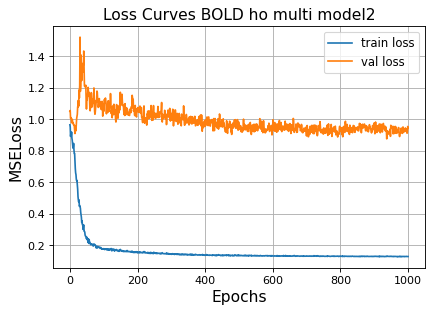

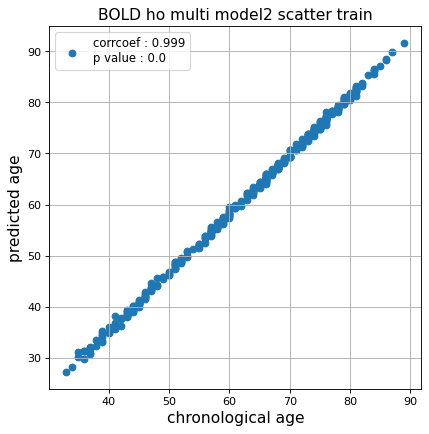

r^2 train data:  0.9661316312584403


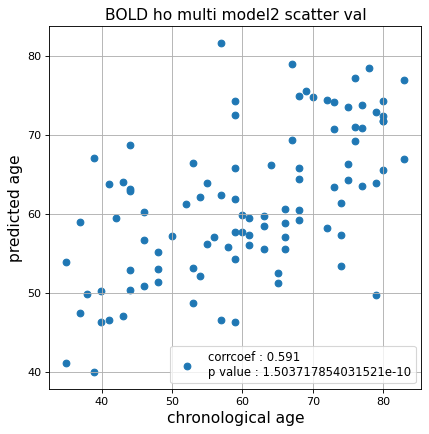

r^2 val data:  0.33711202801766915


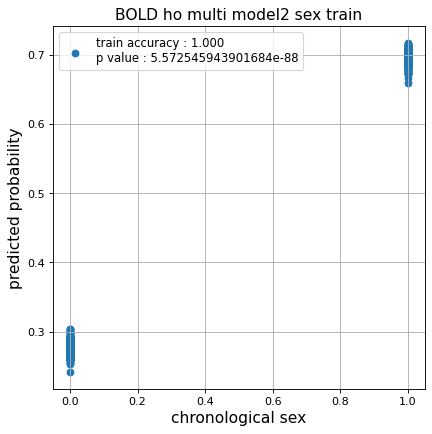

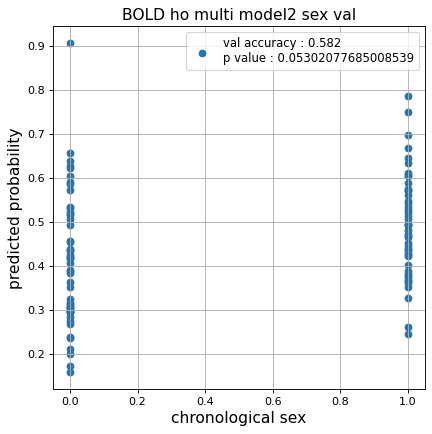

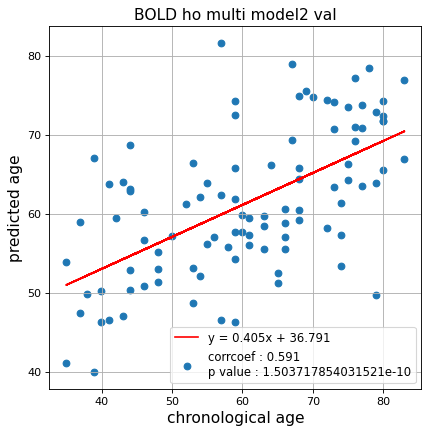

切片: 36.79122484567826
傾き: 0.40537678949988953
Kfold: 4 ::: epoch: 100, loss: 0.18965078317202055, val loss: 1.0183438807725906
Kfold: 4 ::: epoch: 200, loss: 0.1610852720645758, val loss: 1.017231360077858
Kfold: 4 ::: epoch: 300, loss: 0.14498040767816398, val loss: 0.9834167659282684
Kfold: 4 ::: epoch: 400, loss: 0.13855197108708894, val loss: 0.9524611979722977
Kfold: 4 ::: epoch: 500, loss: 0.13433094437305743, val loss: 0.9344050586223602
Kfold: 4 ::: epoch: 600, loss: 0.13477231906010553, val loss: 0.9190945327281952
Kfold: 4 ::: epoch: 700, loss: 0.13280848814890936, val loss: 0.9092528223991394
Kfold: 4 ::: epoch: 800, loss: 0.12993100170905775, val loss: 0.9046743959188461
Kfold: 4 ::: epoch: 900, loss: 0.1307720817052401, val loss: 0.9076422154903412
Kfold: 4 ::: epoch: 1000, loss: 0.12921337554088005, val loss: 0.9085044413805008
save_epochs:889
best val loss:0.8669809699058533


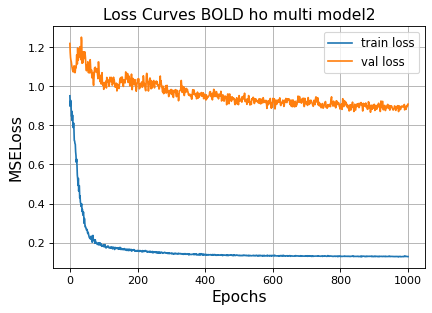

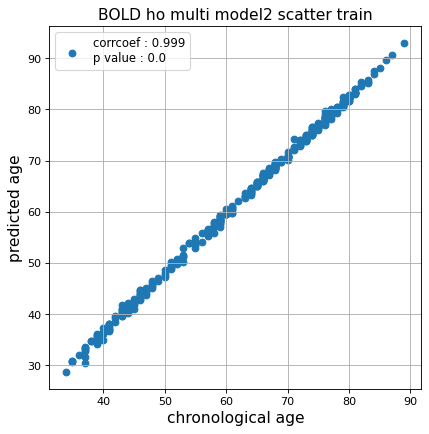

r^2 train data:  0.9764193445524865


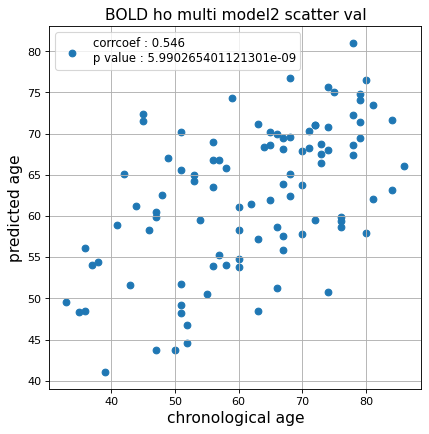

r^2 val data:  0.2847998324514157


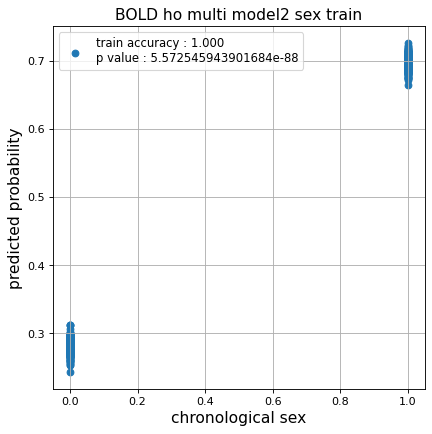

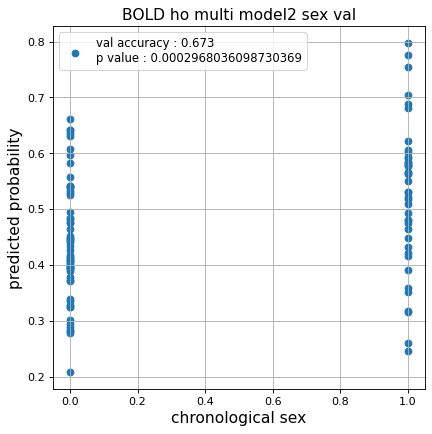

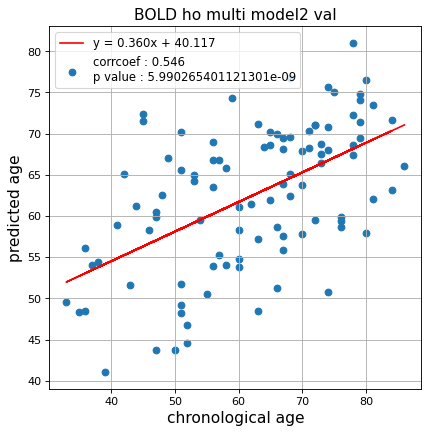

切片: 40.11706611973944
傾き: 0.35970876590195844
Kfold: 5 ::: epoch: 100, loss: 0.18277302499000841, val loss: 0.9485499262809753
Kfold: 5 ::: epoch: 200, loss: 0.15831511181134444, val loss: 0.8511076122522354
Kfold: 5 ::: epoch: 300, loss: 0.15071415901184082, val loss: 0.8161801397800446
Kfold: 5 ::: epoch: 400, loss: 0.14452277009303754, val loss: 0.7843555510044098
Kfold: 5 ::: epoch: 500, loss: 0.1390736148907588, val loss: 0.7660917639732361
Kfold: 5 ::: epoch: 600, loss: 0.1361568421125412, val loss: 0.7324385046958923
Kfold: 5 ::: epoch: 700, loss: 0.13288633754620185, val loss: 0.7397619485855103
Kfold: 5 ::: epoch: 800, loss: 0.13114655705598685, val loss: 0.7180851846933365
Kfold: 5 ::: epoch: 900, loss: 0.13153095199511602, val loss: 0.7088529020547867
Kfold: 5 ::: epoch: 1000, loss: 0.12914665845724252, val loss: 0.7175659537315369
save_epochs:982
best val loss:0.704048216342926


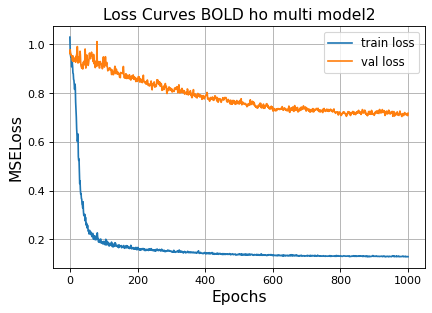

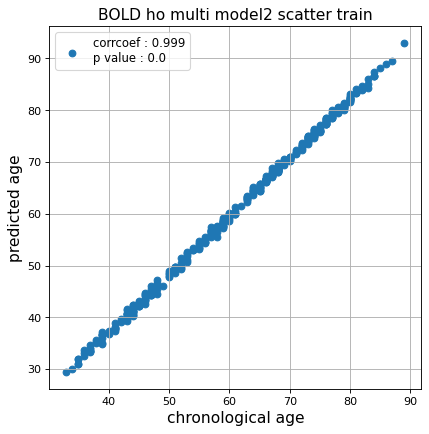

r^2 train data:  0.981895443970232


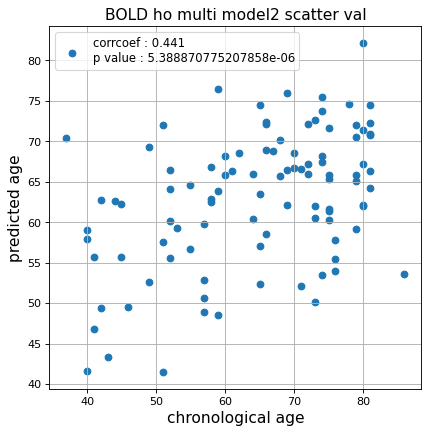

r^2 val data:  0.1354162183231502


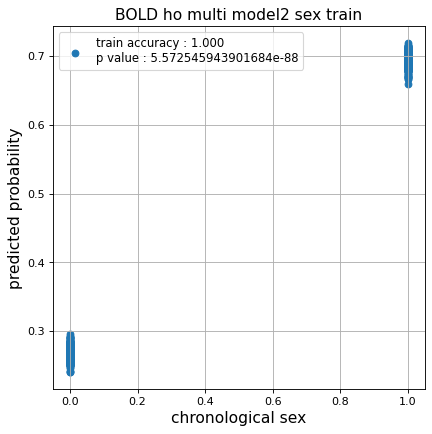

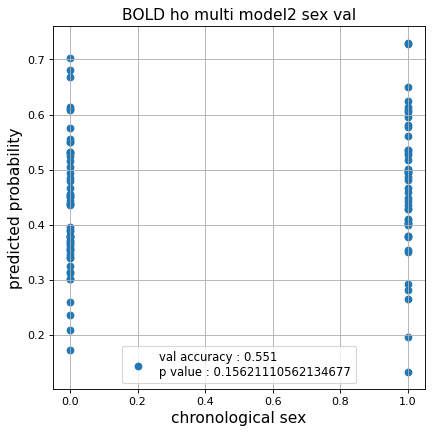

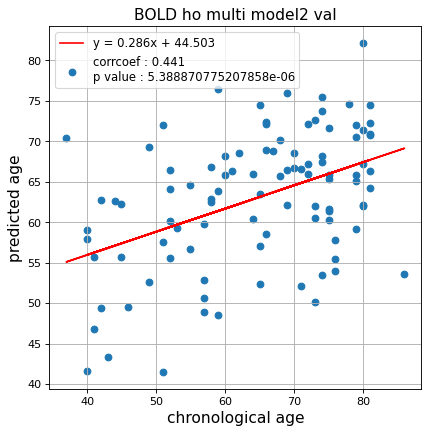

切片: 44.50289572666614
傾き: 0.2864528397133767
Nested Kfold ::: 3
Kfold: 1 ::: epoch: 100, loss: 0.18086195794435647, val loss: 0.756225049495697
Kfold: 1 ::: epoch: 200, loss: 0.16530409913796645, val loss: 0.6747623682022095
Kfold: 1 ::: epoch: 300, loss: 0.14867240075881666, val loss: 0.6438190340995789
Kfold: 1 ::: epoch: 400, loss: 0.1442296917621906, val loss: 0.6280746906995773
Kfold: 1 ::: epoch: 500, loss: 0.13644573780206534, val loss: 0.6039002537727356
Kfold: 1 ::: epoch: 600, loss: 0.13459705847960252, val loss: 0.5816207081079483
Kfold: 1 ::: epoch: 700, loss: 0.13636944271050966, val loss: 0.5768153108656406
Kfold: 1 ::: epoch: 800, loss: 0.132410290149542, val loss: 0.5716640613973141
Kfold: 1 ::: epoch: 900, loss: 0.12997689384680527, val loss: 0.5571486502885818
Kfold: 1 ::: epoch: 1000, loss: 0.13044488659271827, val loss: 0.5573411844670773
save_epochs:992
best val loss:0.5468655824661255


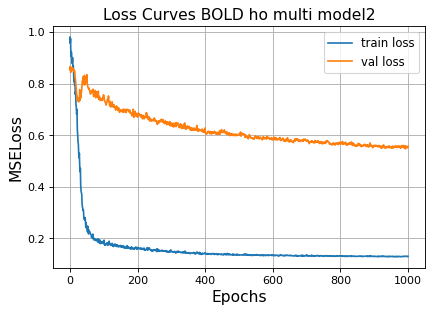

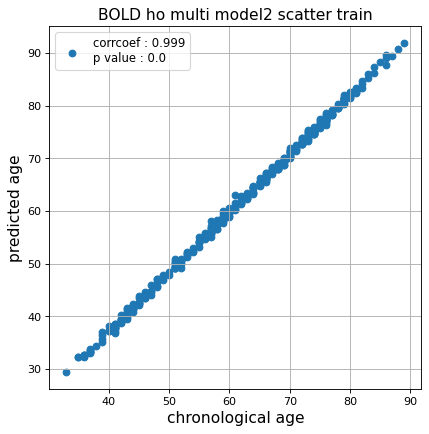

r^2 train data:  0.9837270986825764


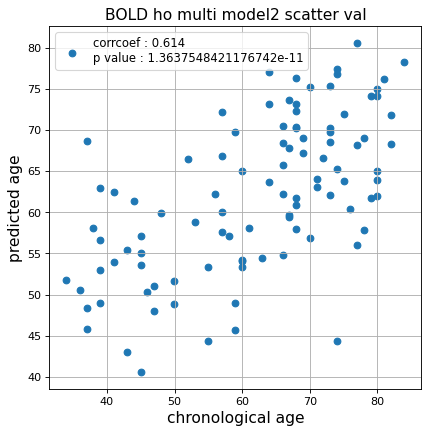

r^2 val data:  0.3727708260164184


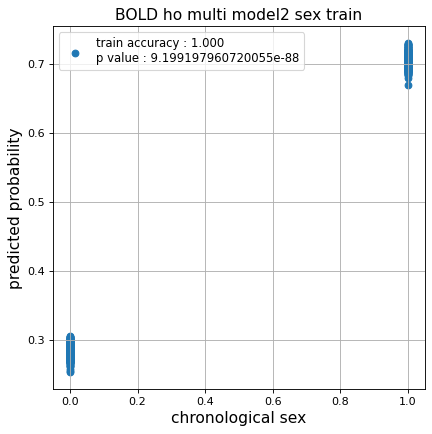

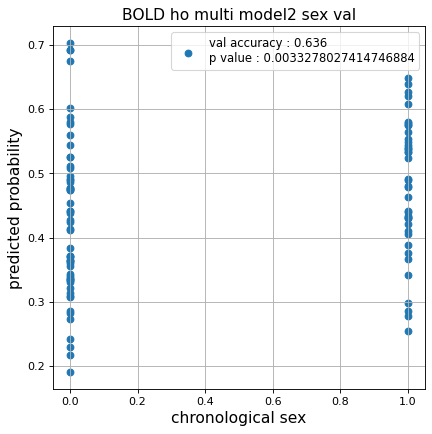

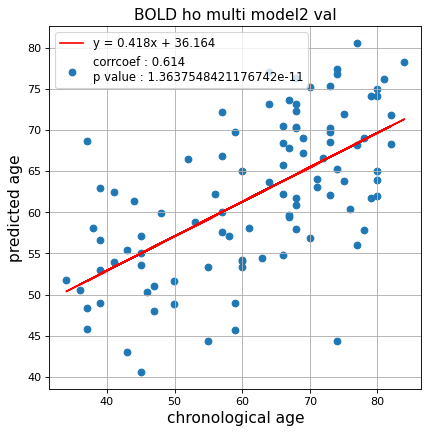

切片: 36.16444670544122
傾き: 0.4184074346849887
Kfold: 2 ::: epoch: 100, loss: 0.18188612163066864, val loss: 1.004741907119751
Kfold: 2 ::: epoch: 200, loss: 0.1558816937299875, val loss: 0.8845315277576447
Kfold: 2 ::: epoch: 300, loss: 0.14681092707010415, val loss: 0.8150682002305984
Kfold: 2 ::: epoch: 400, loss: 0.13903782344781435, val loss: 0.7696718722581863
Kfold: 2 ::: epoch: 500, loss: 0.13783007287062132, val loss: 0.7489397078752518
Kfold: 2 ::: epoch: 600, loss: 0.13457087484689859, val loss: 0.699475847184658
Kfold: 2 ::: epoch: 700, loss: 0.1322033004118846, val loss: 0.6941941976547241
Kfold: 2 ::: epoch: 800, loss: 0.13137678458140448, val loss: 0.6751874536275864
Kfold: 2 ::: epoch: 900, loss: 0.1299673204238598, val loss: 0.6696288138628006
Kfold: 2 ::: epoch: 1000, loss: 0.12892007254637206, val loss: 0.6586941853165627
save_epochs:997
best val loss:0.6530090942978859


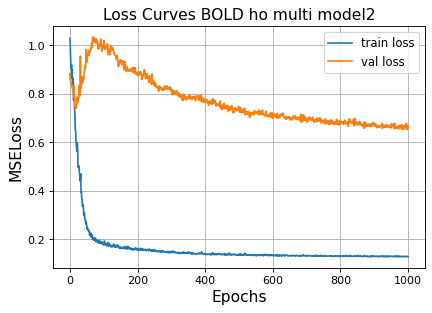

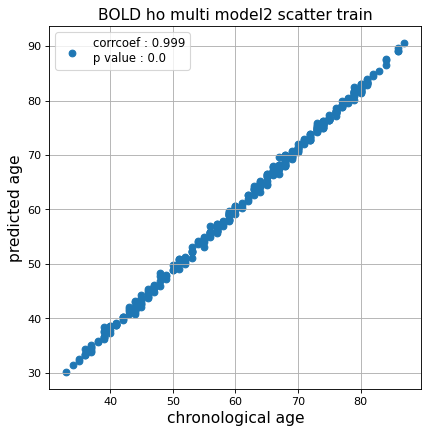

r^2 train data:  0.9849041128098919


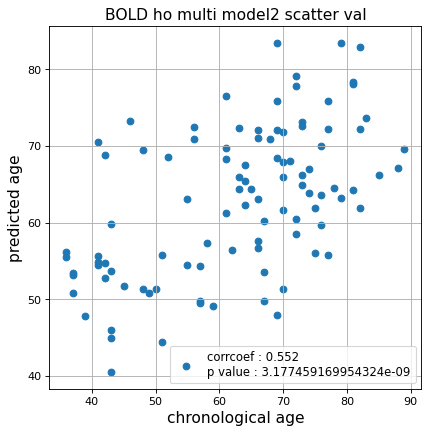

r^2 val data:  0.28626851040873214


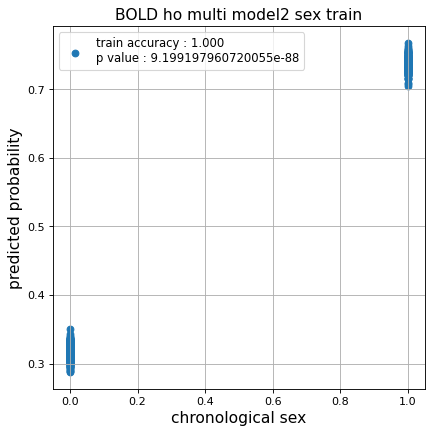

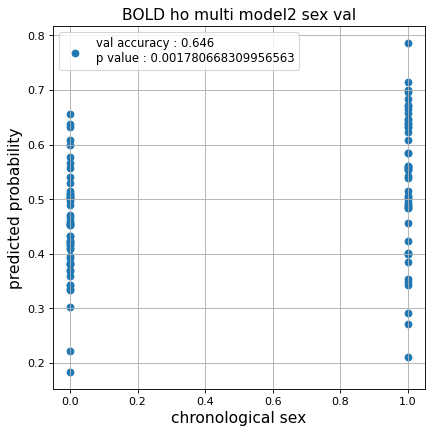

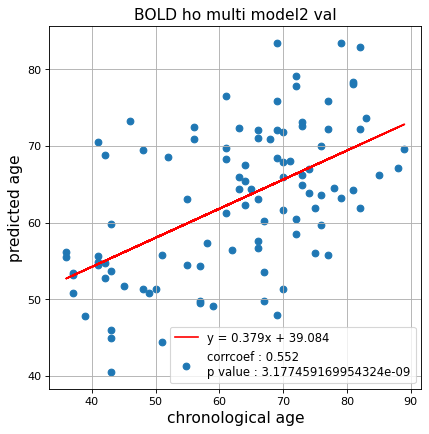

切片: 39.08393257609863
傾き: 0.37916469031047423
Kfold: 3 ::: epoch: 100, loss: 0.17705025237340194, val loss: 1.0292931348085403
Kfold: 3 ::: epoch: 200, loss: 0.16147034672590402, val loss: 0.8688741028308868
Kfold: 3 ::: epoch: 300, loss: 0.14944307849957392, val loss: 0.9257683604955673
Kfold: 3 ::: epoch: 400, loss: 0.14189160443269289, val loss: 0.8757922798395157
Kfold: 3 ::: epoch: 500, loss: 0.13590913781752953, val loss: 0.8881765604019165
early stopping
save_epochs:373
best val loss:0.8169616609811783


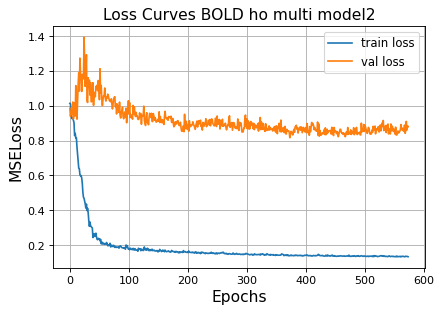

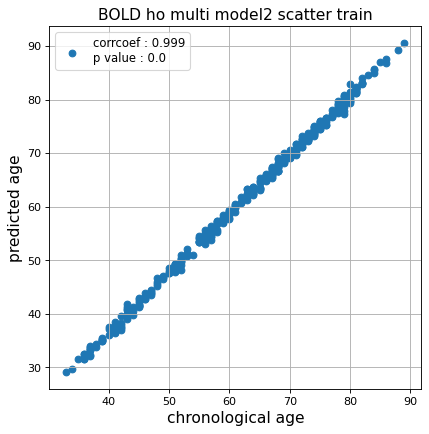

r^2 train data:  0.9812042621281645


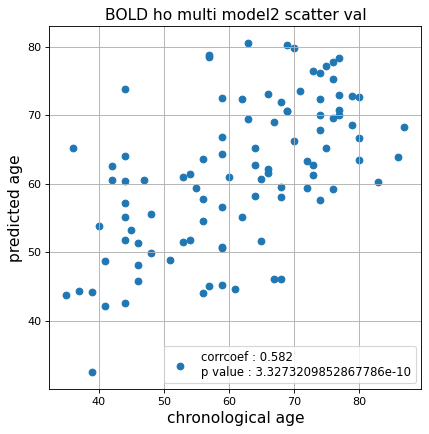

r^2 val data:  0.2840797894752427


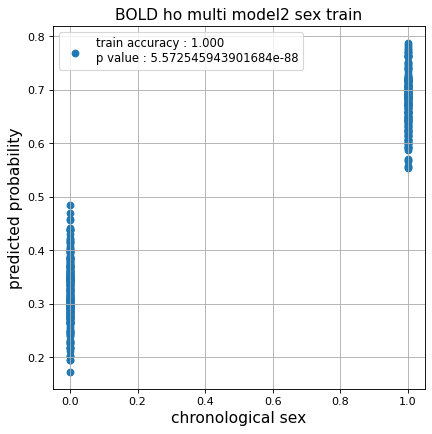

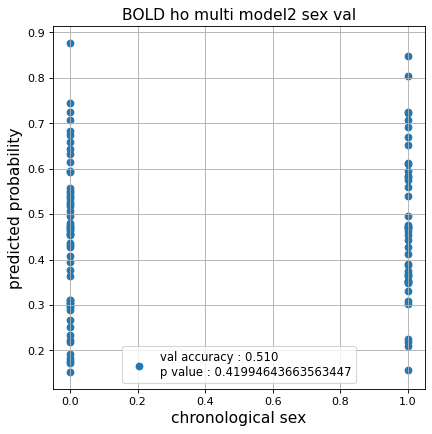

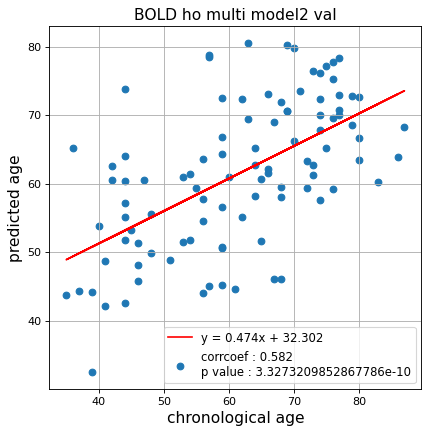

切片: 32.30230361368462
傾き: 0.4742199554583759
Kfold: 4 ::: epoch: 100, loss: 0.17854238931949323, val loss: 1.431317999958992
Kfold: 4 ::: epoch: 200, loss: 0.16595792311888474, val loss: 1.391516923904419
Kfold: 4 ::: epoch: 300, loss: 0.14582688418718484, val loss: 1.4101333618164062
Kfold: 4 ::: epoch: 400, loss: 0.14071607360473046, val loss: 1.4569207280874252
early stopping
save_epochs:291
best val loss:1.3606085777282715


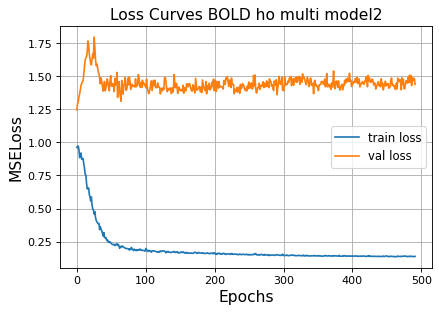

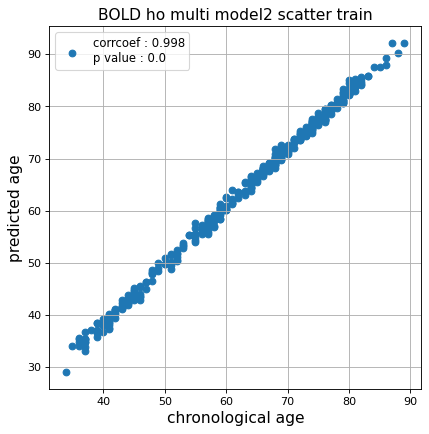

r^2 train data:  0.9783053357490031


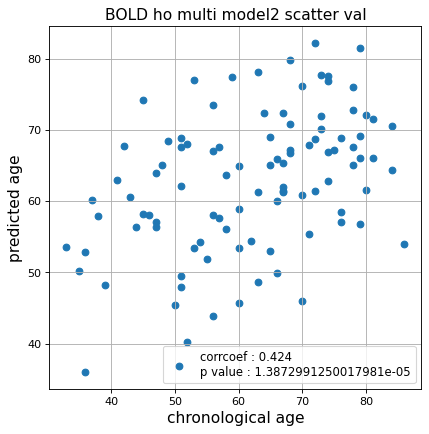

r^2 val data:  0.0884140689359797


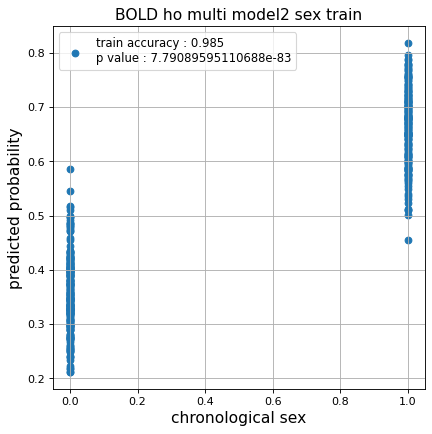

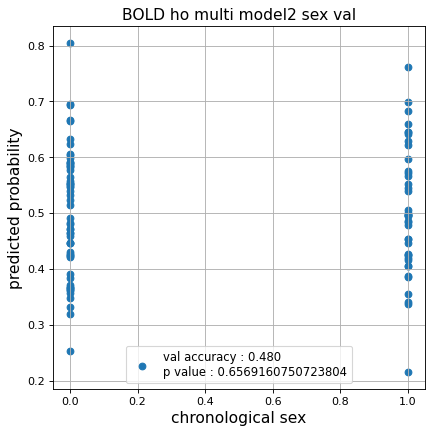

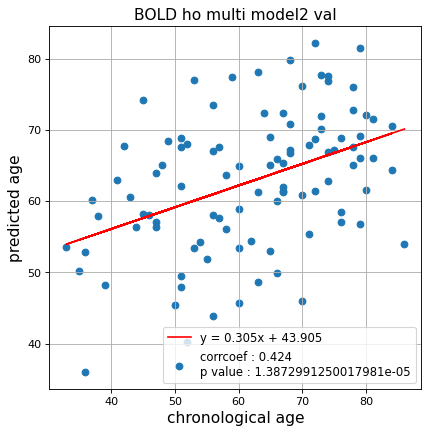

切片: 43.90541805085408
傾き: 0.304800232116898
Kfold: 5 ::: epoch: 100, loss: 0.17810392952882326, val loss: 0.7936521172523499
Kfold: 5 ::: epoch: 200, loss: 0.16125987126277044, val loss: 0.7544891387224197
Kfold: 5 ::: epoch: 300, loss: 0.14908689375107104, val loss: 0.7419630885124207
Kfold: 5 ::: epoch: 400, loss: 0.14100970786351424, val loss: 0.7351312786340714
Kfold: 5 ::: epoch: 500, loss: 0.13445952190802649, val loss: 0.7014282643795013
Kfold: 5 ::: epoch: 600, loss: 0.1336623842899616, val loss: 0.6974894180893898
Kfold: 5 ::: epoch: 700, loss: 0.13321810846145338, val loss: 0.6874415129423141
Kfold: 5 ::: epoch: 800, loss: 0.13037278445867392, val loss: 0.6809664517641068
Kfold: 5 ::: epoch: 900, loss: 0.13029507604929116, val loss: 0.6839307546615601
Kfold: 5 ::: epoch: 1000, loss: 0.12941941733543688, val loss: 0.6746975928544998
save_epochs:996
best val loss:0.6633356809616089


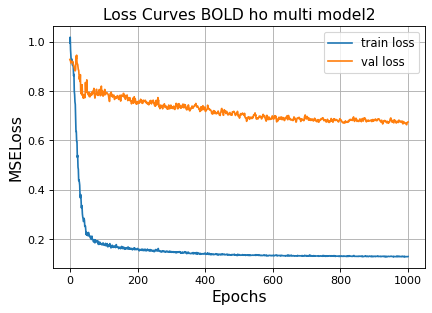

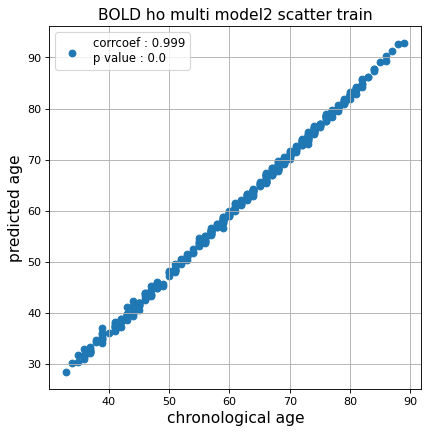

r^2 train data:  0.9722580997496327


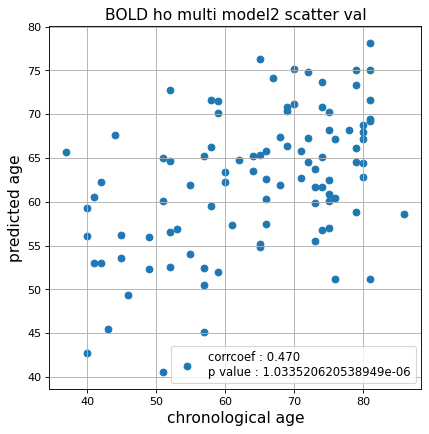

r^2 val data:  0.17246319592678805


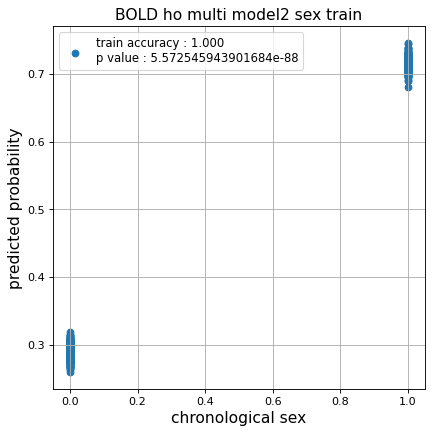

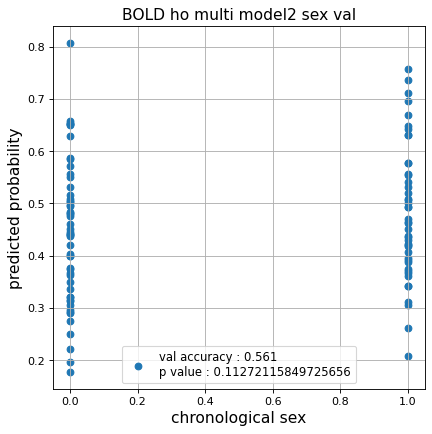

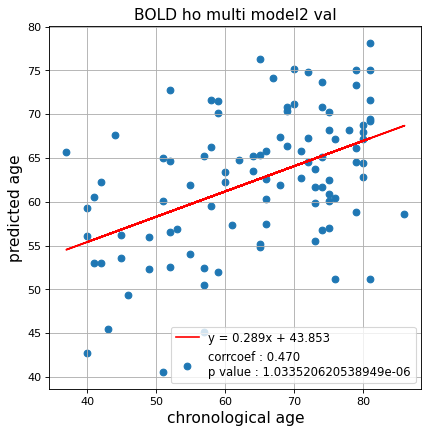

切片: 43.852662136305774
傾き: 0.2886968548790503
Nested Kfold ::: 4
Kfold: 1 ::: epoch: 100, loss: 0.18166364156282866, val loss: 0.7889842540025711
Kfold: 1 ::: epoch: 200, loss: 0.1634572950693277, val loss: 0.7222308069467545
Kfold: 1 ::: epoch: 300, loss: 0.14943305001809046, val loss: 0.6977763175964355
Kfold: 1 ::: epoch: 400, loss: 0.144403976889757, val loss: 0.6764244139194489
Kfold: 1 ::: epoch: 500, loss: 0.13785788531486803, val loss: 0.6532143503427505
Kfold: 1 ::: epoch: 600, loss: 0.1341258298892241, val loss: 0.6295373290777206
Kfold: 1 ::: epoch: 700, loss: 0.13327141450001642, val loss: 0.6080324053764343
Kfold: 1 ::: epoch: 800, loss: 0.1317227459870852, val loss: 0.6008887439966202
Kfold: 1 ::: epoch: 900, loss: 0.1302046409020057, val loss: 0.5706153959035873
Kfold: 1 ::: epoch: 1000, loss: 0.12991727544711187, val loss: 0.5660004243254662
save_epochs:998
best val loss:0.5582430511713028


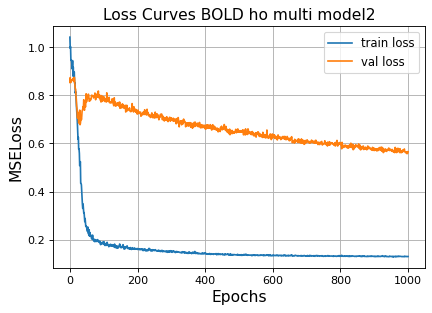

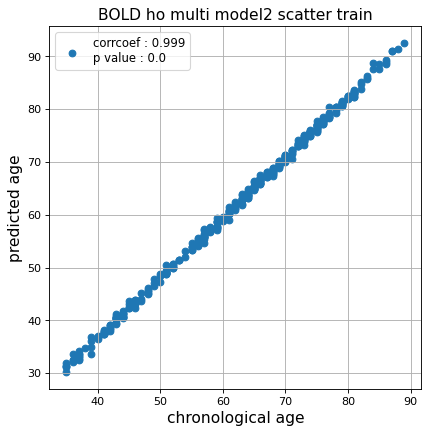

r^2 train data:  0.9788307849410316


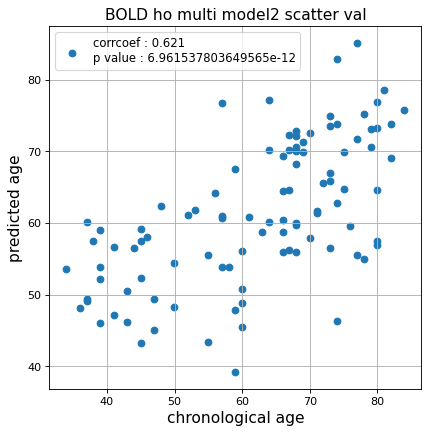

r^2 val data:  0.37185747686280723


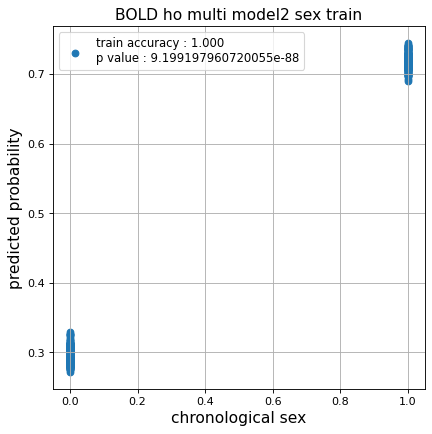

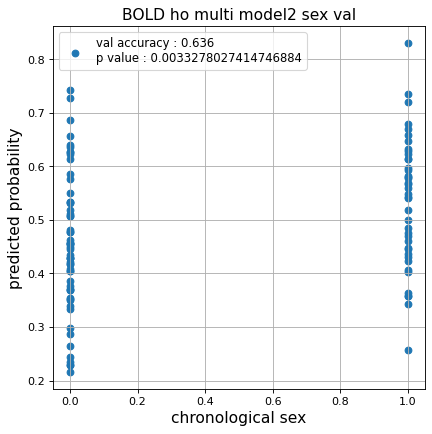

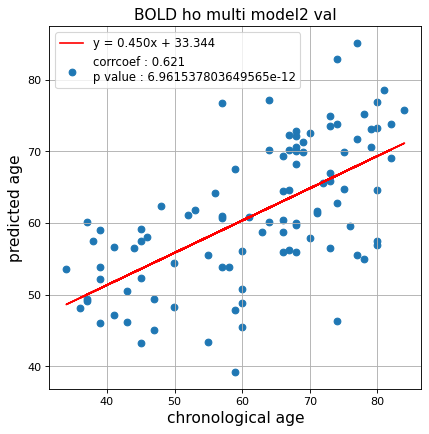

切片: 33.34448939596059
傾き: 0.44980643870815246
Kfold: 2 ::: epoch: 100, loss: 0.18948351534513327, val loss: 0.8263475000858307
Kfold: 2 ::: epoch: 200, loss: 0.15866782917426184, val loss: 0.7194738984107971
Kfold: 2 ::: epoch: 300, loss: 0.1480949864937709, val loss: 0.6879317164421082
Kfold: 2 ::: epoch: 400, loss: 0.14223293043099916, val loss: 0.6744194999337196
Kfold: 2 ::: epoch: 500, loss: 0.13643070253042075, val loss: 0.6586467325687408
Kfold: 2 ::: epoch: 600, loss: 0.1366812540934636, val loss: 0.6451888680458069
Kfold: 2 ::: epoch: 700, loss: 0.13307006657123566, val loss: 0.6264190524816513
Kfold: 2 ::: epoch: 800, loss: 0.12998597897016084, val loss: 0.6318987756967545
Kfold: 2 ::: epoch: 900, loss: 0.12983925067461455, val loss: 0.621452085673809
Kfold: 2 ::: epoch: 1000, loss: 0.13132131902071145, val loss: 0.6219590082764626
save_epochs:912
best val loss:0.6146090626716614


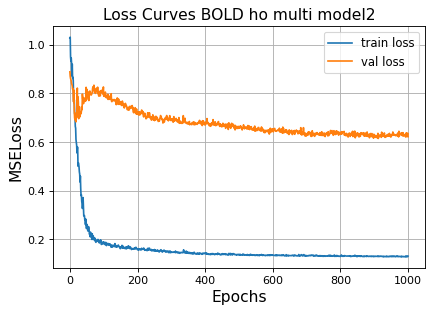

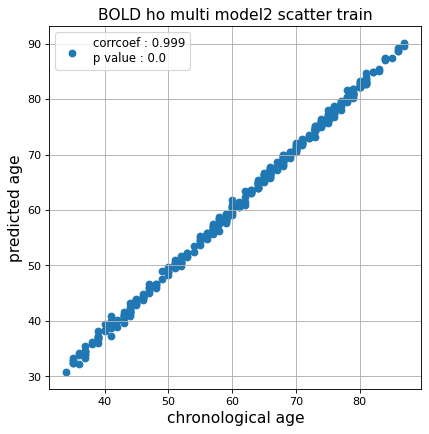

r^2 train data:  0.9853799478159869


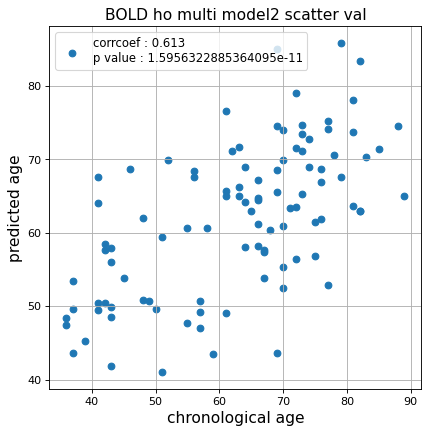

r^2 val data:  0.3599582103769742


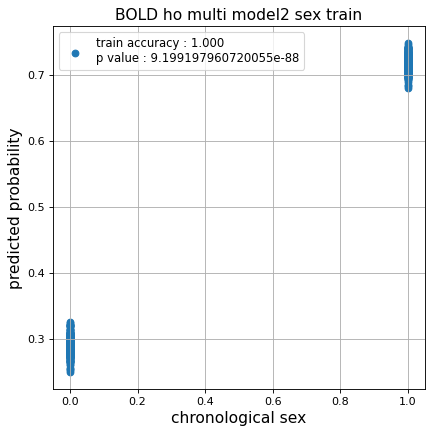

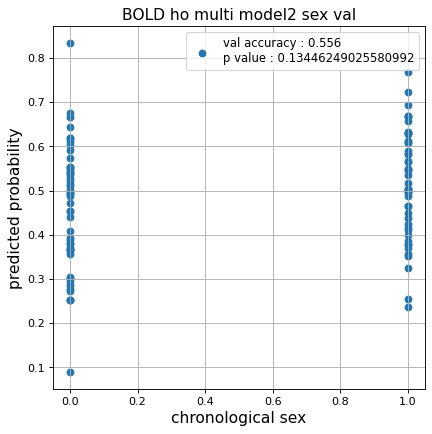

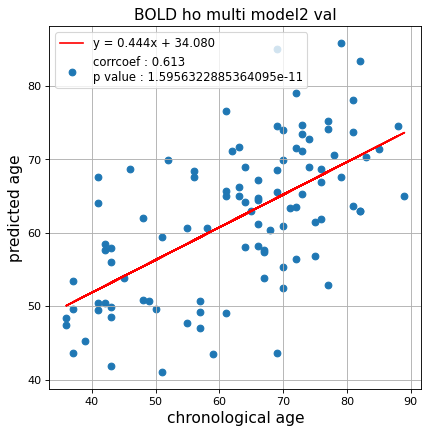

切片: 34.07965270043163
傾き: 0.4444663976070899
Kfold: 3 ::: epoch: 100, loss: 0.17817323826826537, val loss: 0.5961456671357155
Kfold: 3 ::: epoch: 200, loss: 0.16283972102862138, val loss: 0.5715212151408195
Kfold: 3 ::: epoch: 300, loss: 0.15087887071646178, val loss: 0.5575694888830185
Kfold: 3 ::: epoch: 400, loss: 0.14213187190202567, val loss: 0.5509059354662895
Kfold: 3 ::: epoch: 500, loss: 0.1347205753509815, val loss: 0.5418210625648499
Kfold: 3 ::: epoch: 600, loss: 0.13508451328827784, val loss: 0.5350819677114487
Kfold: 3 ::: epoch: 700, loss: 0.1320777523976106, val loss: 0.5180421322584152
Kfold: 3 ::: epoch: 800, loss: 0.13154377387120172, val loss: 0.5265991240739822
Kfold: 3 ::: epoch: 900, loss: 0.1316556563744178, val loss: 0.5193239897489548
Kfold: 3 ::: epoch: 1000, loss: 0.1301490286221871, val loss: 0.5102501511573792
save_epochs:902
best val loss:0.5014200210571289


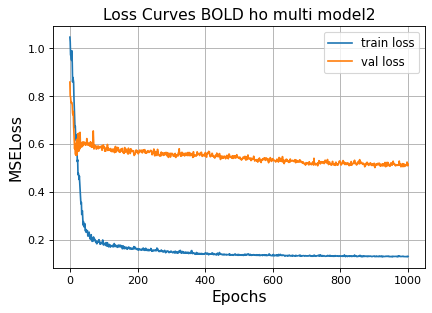

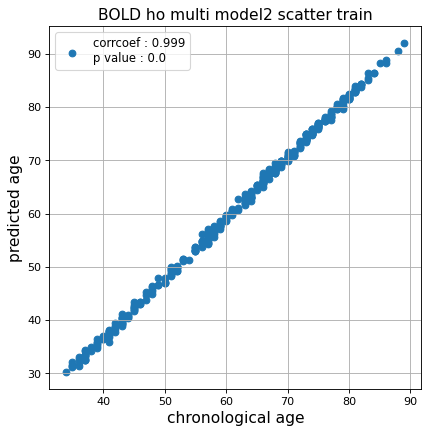

r^2 train data:  0.9789459138280844


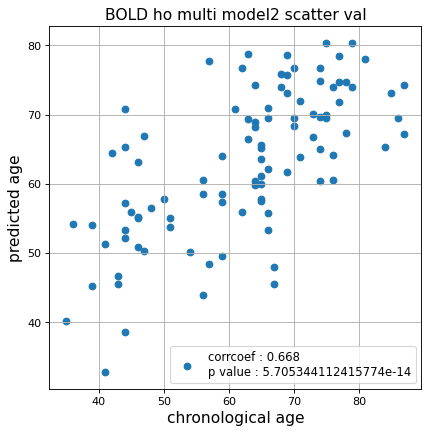

r^2 val data:  0.4264347916064436


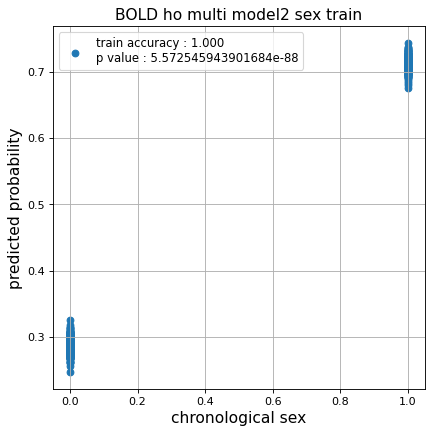

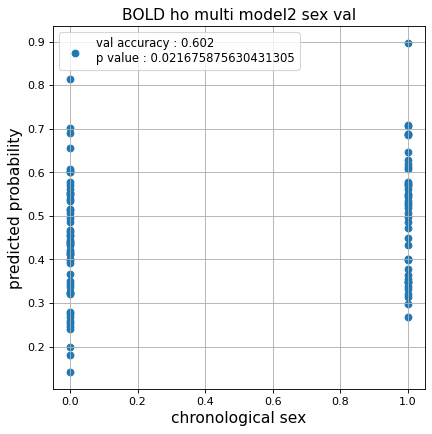

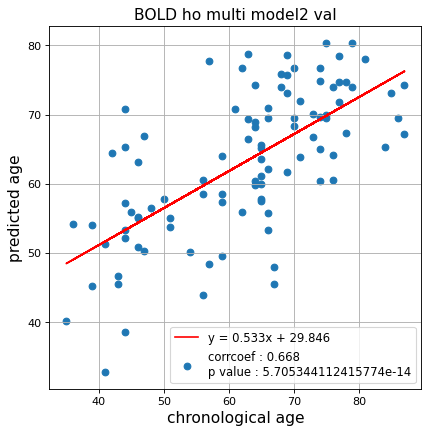

切片: 29.84597838061623
傾き: 0.5333332738905173
Kfold: 4 ::: epoch: 100, loss: 0.18118337713755095, val loss: 1.297383263707161
Kfold: 4 ::: epoch: 200, loss: 0.1805357004587467, val loss: 1.1784747242927551
Kfold: 4 ::: epoch: 300, loss: 0.14925249608663413, val loss: 1.1474502384662628
Kfold: 4 ::: epoch: 400, loss: 0.13839972706941459, val loss: 1.1090414375066757
Kfold: 4 ::: epoch: 500, loss: 0.13417410621276268, val loss: 1.0871035605669022
Kfold: 4 ::: epoch: 600, loss: 0.13724963940106905, val loss: 1.044154942035675
Kfold: 4 ::: epoch: 700, loss: 0.1329377144575119, val loss: 1.0411720275878906
Kfold: 4 ::: epoch: 800, loss: 0.13085304315273577, val loss: 1.009725570678711
Kfold: 4 ::: epoch: 900, loss: 0.130057611144506, val loss: 1.0035127848386765
Kfold: 4 ::: epoch: 1000, loss: 0.12940720640696013, val loss: 0.9927235692739487
save_epochs:922
best val loss:0.9738929271697998


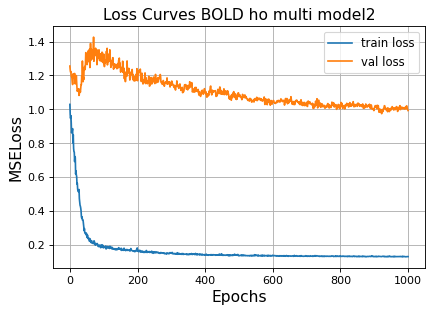

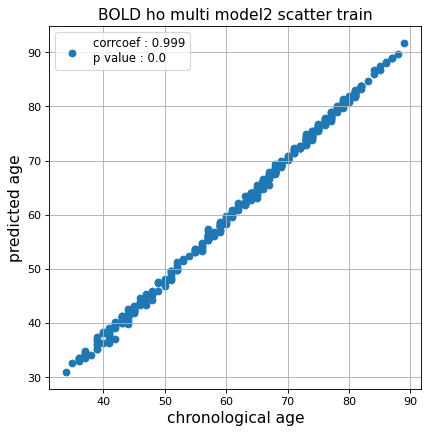

r^2 train data:  0.9850879049595257


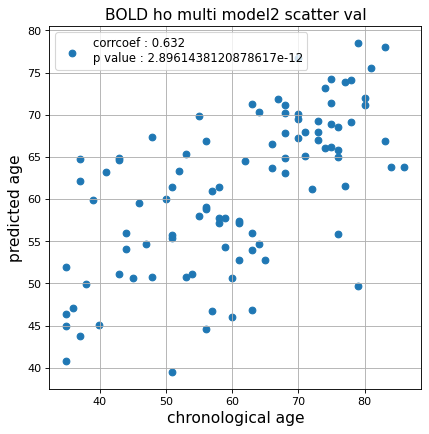

r^2 val data:  0.39909676860501386


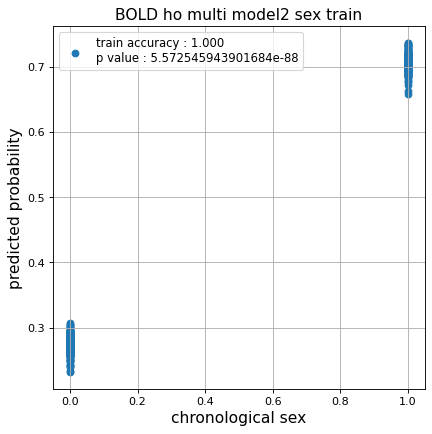

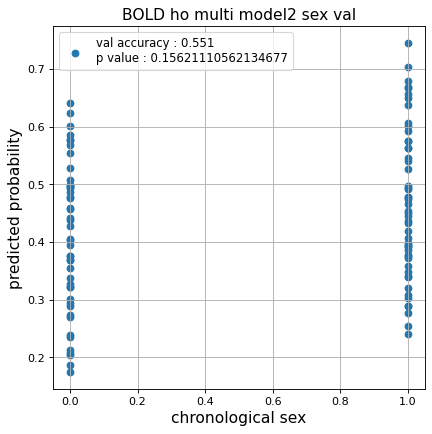

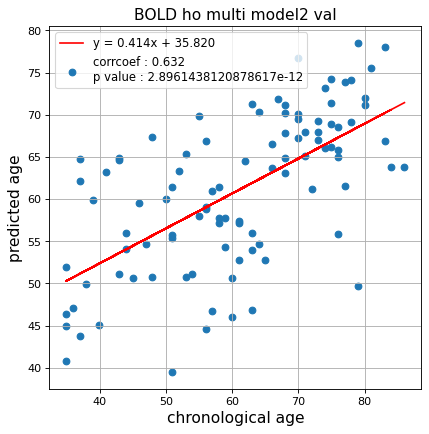

切片: 35.81976540592426
傾き: 0.41399847742848894
Kfold: 5 ::: epoch: 100, loss: 0.19210893259598658, val loss: 0.8815437406301498
Kfold: 5 ::: epoch: 200, loss: 0.1545206491763775, val loss: 0.8156494945287704
Kfold: 5 ::: epoch: 300, loss: 0.14238060323091653, val loss: 0.7837686687707901
Kfold: 5 ::: epoch: 400, loss: 0.1382295982195781, val loss: 0.7656440585851669
Kfold: 5 ::: epoch: 500, loss: 0.1345646450152764, val loss: 0.7581335157155991
Kfold: 5 ::: epoch: 600, loss: 0.1328110729272549, val loss: 0.7355447709560394
Kfold: 5 ::: epoch: 700, loss: 0.1324631766631053, val loss: 0.7283534556627274
Kfold: 5 ::: epoch: 800, loss: 0.13205161002966073, val loss: 0.7219198793172836
Kfold: 5 ::: epoch: 900, loss: 0.12955181300640106, val loss: 0.7275157570838928
Kfold: 5 ::: epoch: 1000, loss: 0.12914288960970366, val loss: 0.7249251157045364
save_epochs:917
best val loss:0.7137959748506546


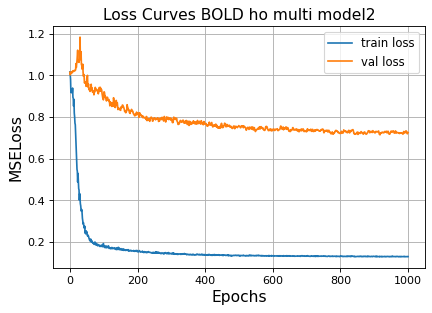

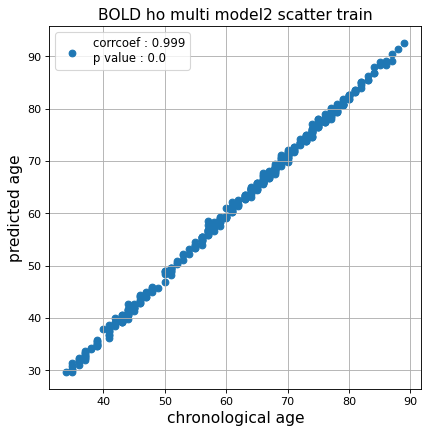

r^2 train data:  0.976156903034318


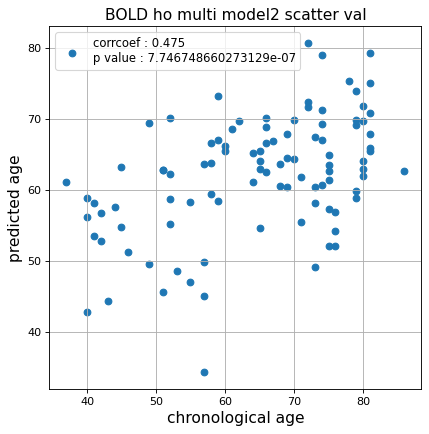

r^2 val data:  0.1530007179528683


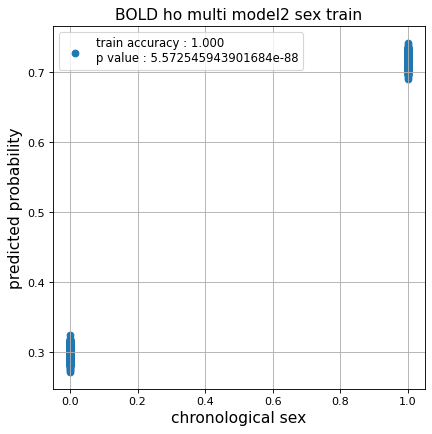

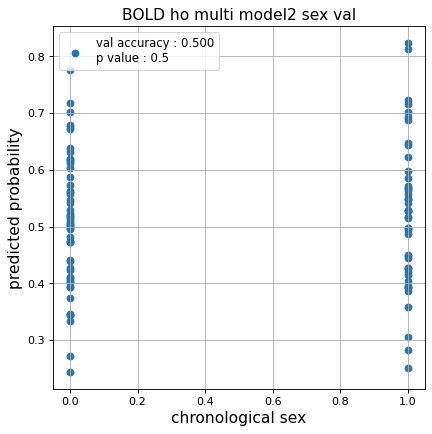

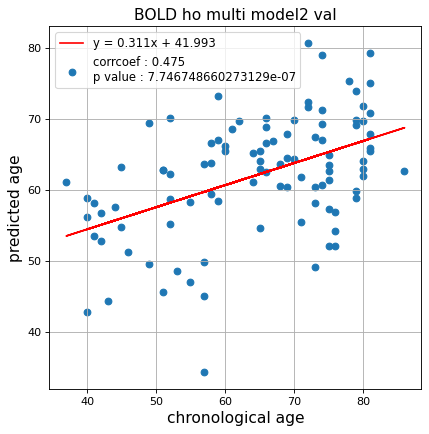

切片: 41.99287371380042
傾き: 0.31078721578392393
Nested Kfold ::: 5
Kfold: 1 ::: epoch: 100, loss: 0.1845063968346669, val loss: 0.7513554394245148
Kfold: 1 ::: epoch: 200, loss: 0.16033563590966737, val loss: 0.6889751628041267
Kfold: 1 ::: epoch: 300, loss: 0.1474968447135045, val loss: 0.6678063198924065
Kfold: 1 ::: epoch: 400, loss: 0.14217944213977227, val loss: 0.6594997942447662
Kfold: 1 ::: epoch: 500, loss: 0.13620994985103607, val loss: 0.6333634108304977
Kfold: 1 ::: epoch: 600, loss: 0.13365683532678163, val loss: 0.6215380802750587
Kfold: 1 ::: epoch: 700, loss: 0.13212728729614845, val loss: 0.6030113771557808
Kfold: 1 ::: epoch: 800, loss: 0.13161316972512466, val loss: 0.5827273055911064
Kfold: 1 ::: epoch: 900, loss: 0.1290515844638531, val loss: 0.5668997950851917
Kfold: 1 ::: epoch: 1000, loss: 0.12985659677248734, val loss: 0.5603183805942535
save_epochs:960
best val loss:0.5524188056588173


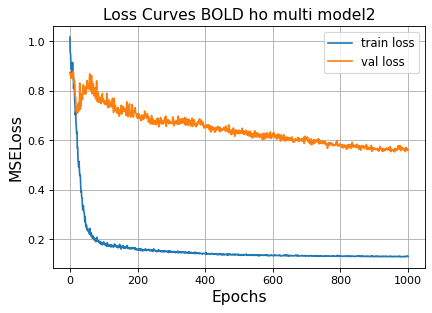

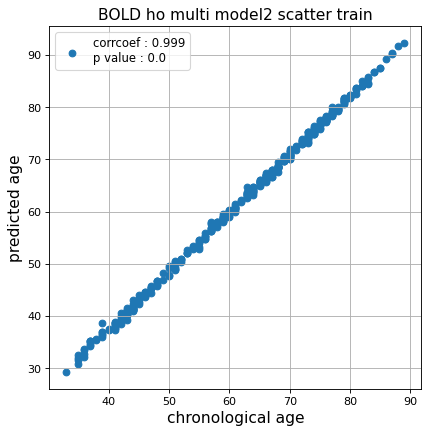

r^2 train data:  0.9846778602922144


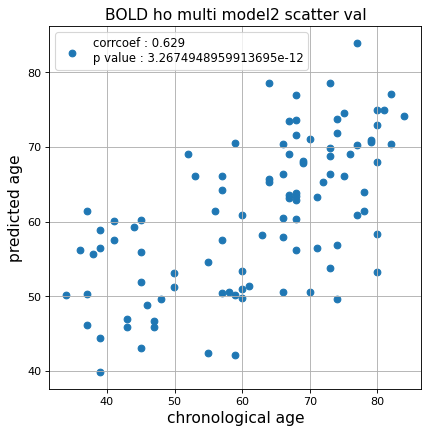

r^2 val data:  0.37964271526714166


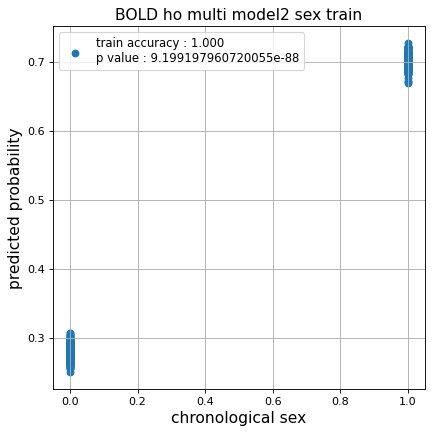

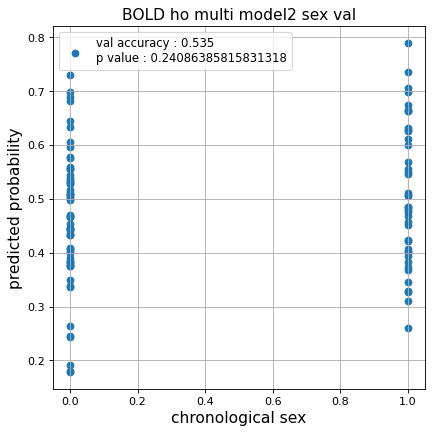

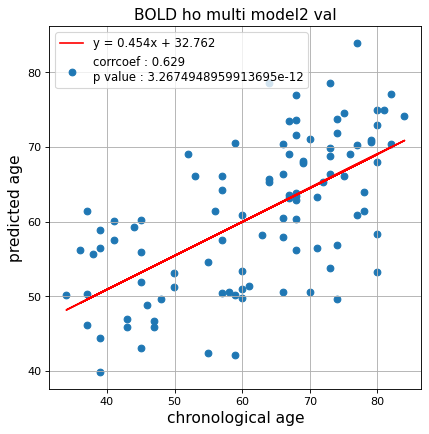

切片: 32.76180036914036
傾き: 0.4535532177184595
Kfold: 2 ::: epoch: 100, loss: 0.18560122755857614, val loss: 0.837553933262825
Kfold: 2 ::: epoch: 200, loss: 0.15689053787634924, val loss: 0.7850940674543381
Kfold: 2 ::: epoch: 300, loss: 0.14502094571407026, val loss: 0.7405598610639572
Kfold: 2 ::: epoch: 400, loss: 0.14291622317754304, val loss: 0.7195071652531624
Kfold: 2 ::: epoch: 500, loss: 0.13558630301402166, val loss: 0.7070567309856415
Kfold: 2 ::: epoch: 600, loss: 0.13496249111799094, val loss: 0.688550628721714
Kfold: 2 ::: epoch: 700, loss: 0.13165507866786078, val loss: 0.6802057325839996
Kfold: 2 ::: epoch: 800, loss: 0.13008227256628183, val loss: 0.6746082305908203
Kfold: 2 ::: epoch: 900, loss: 0.12984248651907995, val loss: 0.6637486591935158
Kfold: 2 ::: epoch: 1000, loss: 0.12939734986195198, val loss: 0.6520663276314735
save_epochs:992
best val loss:0.6512456759810448


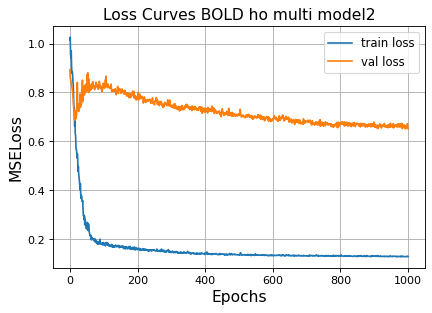

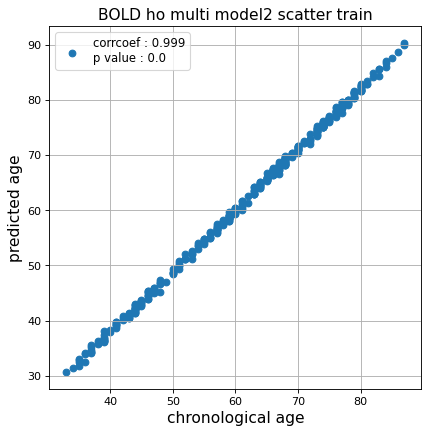

r^2 train data:  0.9874981965943525


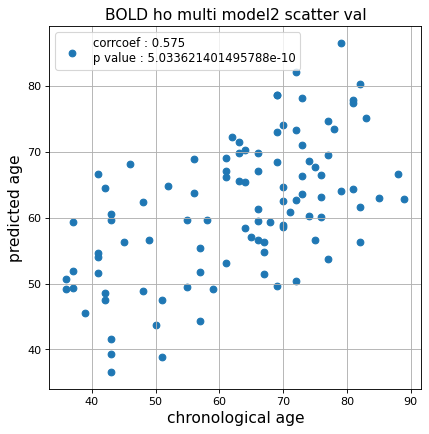

r^2 val data:  0.29673495228025903


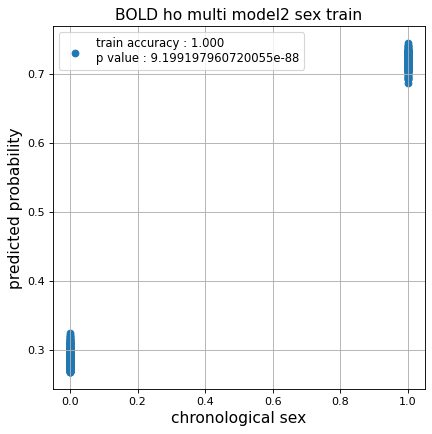

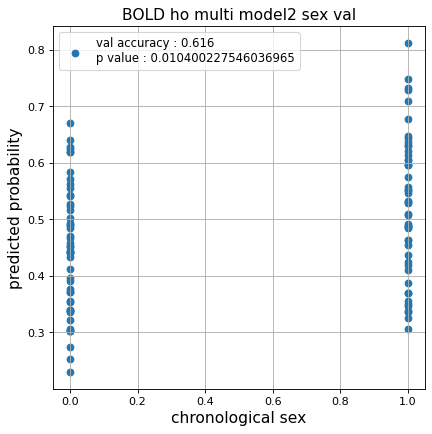

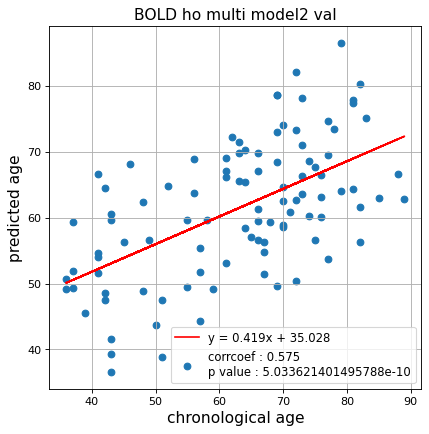

切片: 35.028142597579645
傾き: 0.4191642175171259
Kfold: 3 ::: epoch: 100, loss: 0.17909520176740792, val loss: 0.6639507114887238
Kfold: 3 ::: epoch: 200, loss: 0.16113971632260543, val loss: 0.684514194726944
Kfold: 3 ::: epoch: 300, loss: 0.15358573886064383, val loss: 0.6923516392707825
Kfold: 3 ::: epoch: 400, loss: 0.14101653947280005, val loss: 0.7169433236122131
early stopping
save_epochs:211
best val loss:0.6548591256141663


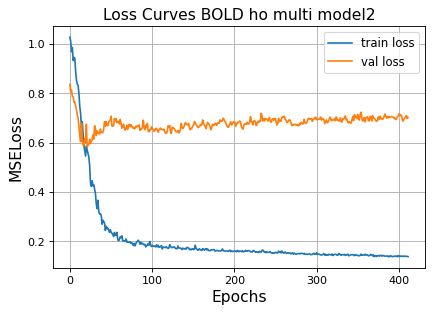

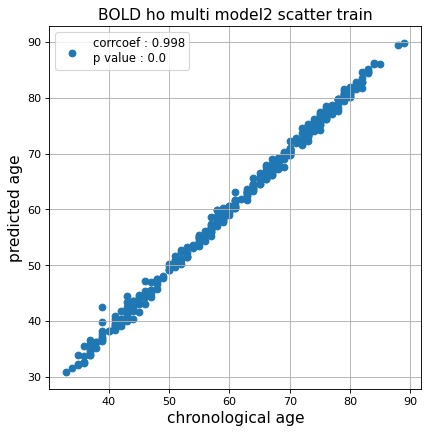

r^2 train data:  0.9913955433324303


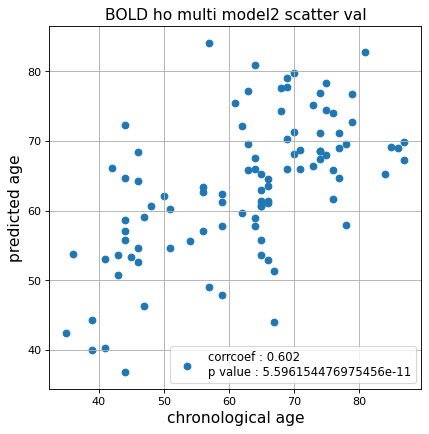

r^2 val data:  0.33121160918563897


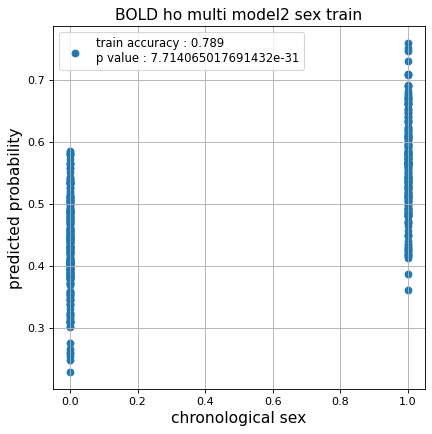

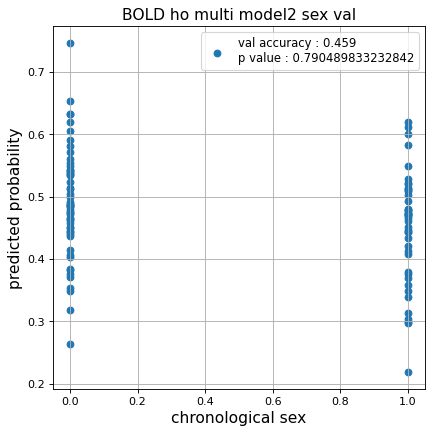

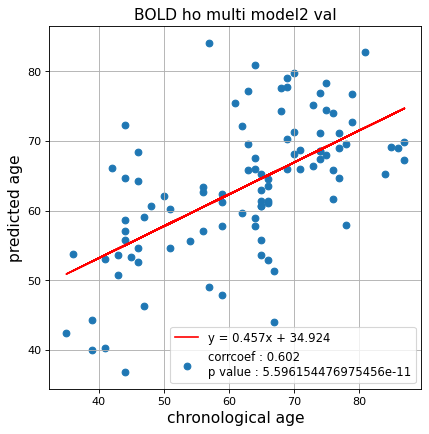

切片: 34.92389620554692
傾き: 0.45709972792643255
Kfold: 4 ::: epoch: 100, loss: 0.1783585651562764, val loss: 0.6180730611085892
Kfold: 4 ::: epoch: 200, loss: 0.15946417703078344, val loss: 0.5618554279208183
Kfold: 4 ::: epoch: 300, loss: 0.14505216135428503, val loss: 0.5450360924005508
Kfold: 4 ::: epoch: 400, loss: 0.13791470802747285, val loss: 0.5376642048358917
Kfold: 4 ::: epoch: 500, loss: 0.13571039873820084, val loss: 0.5352058410644531
Kfold: 4 ::: epoch: 600, loss: 0.13375074702959794, val loss: 0.5352967232465744
Kfold: 4 ::: epoch: 700, loss: 0.13250833635146803, val loss: 0.5271677225828171
Kfold: 4 ::: epoch: 800, loss: 0.13188027647825387, val loss: 0.5247648507356644
Kfold: 4 ::: epoch: 900, loss: 0.12995549921806043, val loss: 0.5214537903666496
Kfold: 4 ::: epoch: 1000, loss: 0.12894977170687455, val loss: 0.5209908932447433
save_epochs:983
best val loss:0.5120609924197197


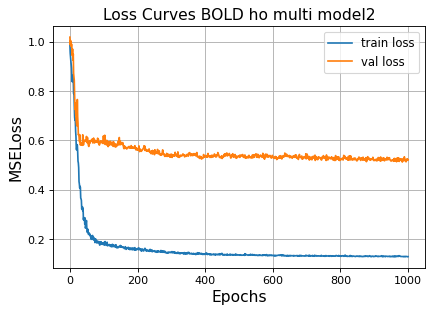

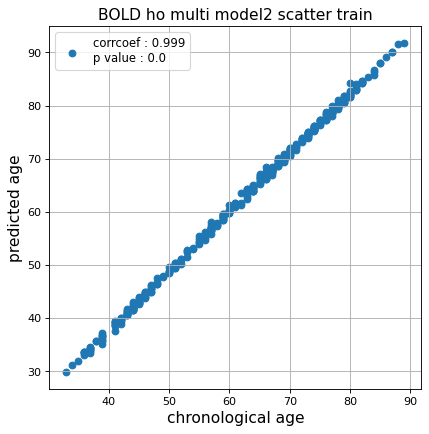

r^2 train data:  0.984539293951948


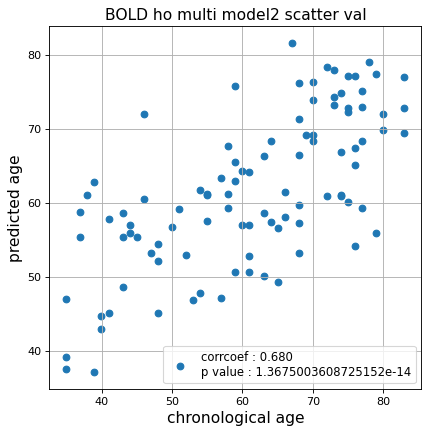

r^2 val data:  0.4550079676646277


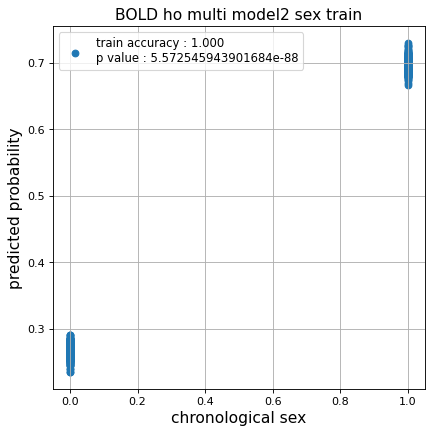

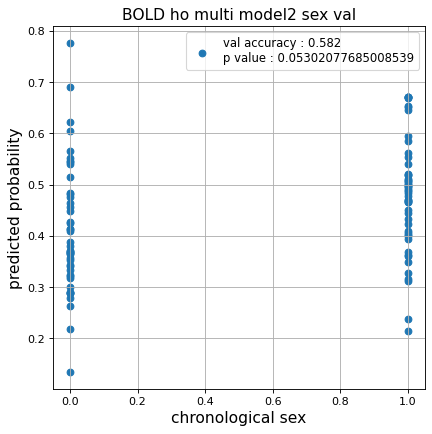

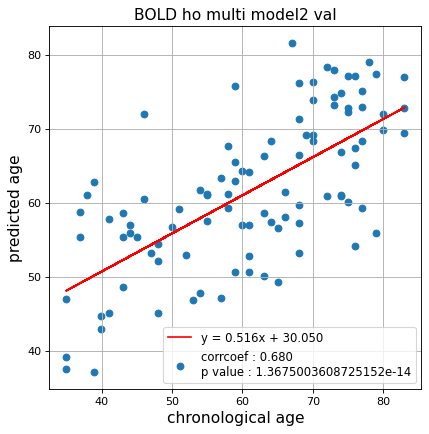

切片: 30.050085751890954
傾き: 0.5157866013160619
Kfold: 5 ::: epoch: 100, loss: 0.18627143479310548, val loss: 0.9016528874635696
Kfold: 5 ::: epoch: 200, loss: 0.16221695221387422, val loss: 0.8819312751293182
Kfold: 5 ::: epoch: 300, loss: 0.1436752241391402, val loss: 0.8356017023324966
Kfold: 5 ::: epoch: 400, loss: 0.13960997416422918, val loss: 0.8394912332296371
Kfold: 5 ::: epoch: 500, loss: 0.1369072783451814, val loss: 0.7832986861467361
Kfold: 5 ::: epoch: 600, loss: 0.1343172868857017, val loss: 0.8032025843858719
early stopping
save_epochs:481
best val loss:0.7585126757621765


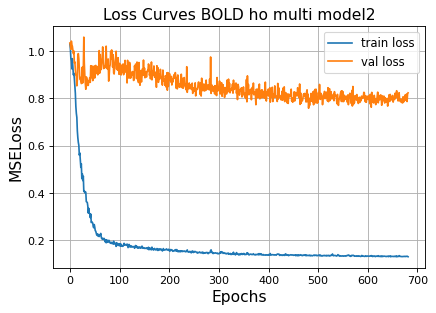

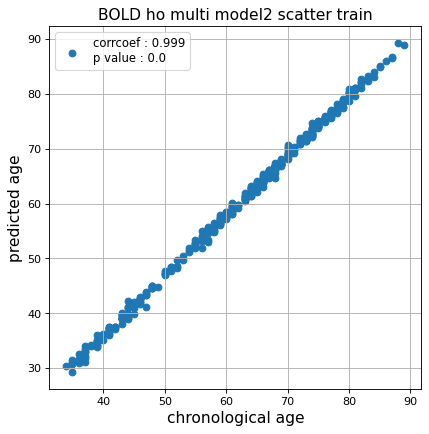

r^2 train data:  0.9687494517553649


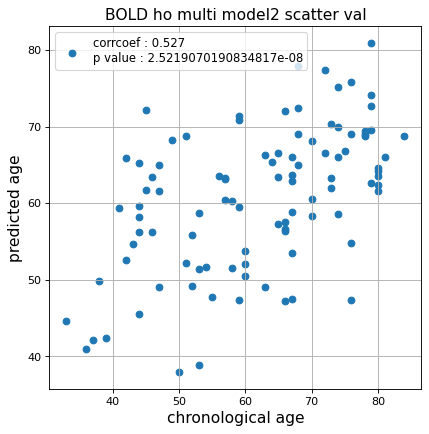

r^2 val data:  0.23627868119561812


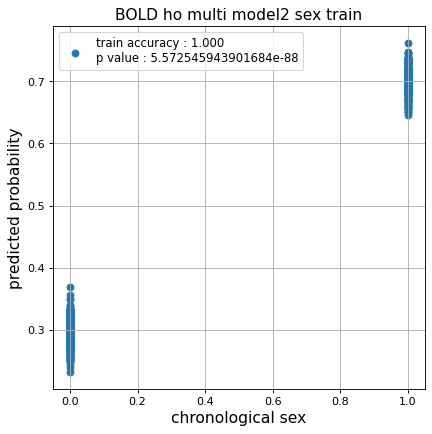

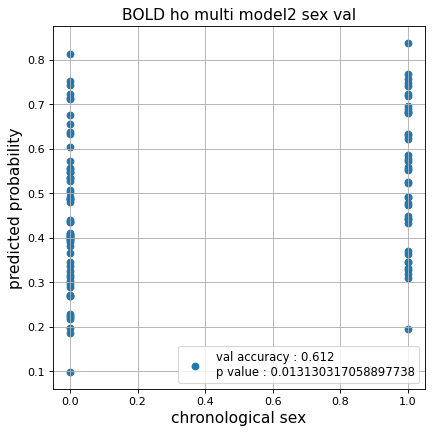

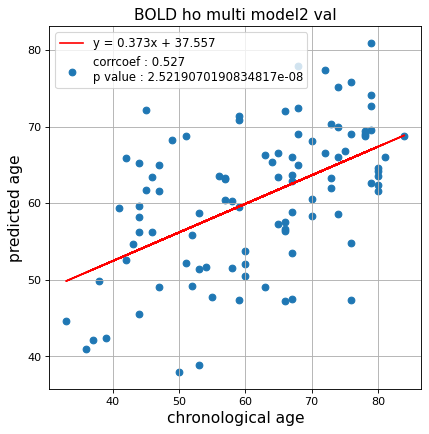

切片: 37.556853850475164
傾き: 0.3726365010190655
CPU times: user 1h 40min 28s, sys: 9min 31s, total: 1h 49min 59s
Wall time: 1h 50min 10s


In [26]:
%%time
fold = KFold(n_splits=n_splits,shuffle=False)

test_pred_ho_2  = []
test_pred_ho_corrected_2  = []
test_label_ho_2 = []
test_idx_ho_2   = []

for fold_idx, (train_idx, test_idx) in enumerate(fold.split(data_ho)):
    print(f'Nested Kfold ::: {fold_idx+1}')
    test_pred,test_pred_corrected,test_label = train_model(data_ho,
                                                           data_label,
                                                           train_idx  = train_idx,
                                                           test_idx   = test_idx,
                                                           epochs     = 1000,
                                                           d_model    = 128,
                                                           n_splits   = n_splits,
                                                           hidden_dim = 128,
                                                           nhead      = 32,
                                                           hidden_dim_transformer = 2,
                                                           pos_drop    = 0.1,
                                                           trans_drop = 0.1,
                                                           fc_drop = 0.1,
                                                           title = 'ROI ho multi model2'
                                                          )
    
    test_pred_ho_2.append(test_pred)
    test_pred_ho_corrected_2.append(test_pred_corrected)
    test_label_ho_2.append(test_label)
    test_idx_ho_2.append(test_idx)

### データ保存

In [27]:
test_pred_ho_1 = np.array(test_pred_ho_1, dtype=object)
test_pred_ho_corrected_1 = np.array(test_pred_ho_corrected_1, dtype=object)

test_pred_ho_2 = np.array(test_pred_ho_2, dtype=object)
test_pred_ho_corrected_2 = np.array(test_pred_ho_corrected_2, dtype=object)

In [28]:
np.savez('../02_data_analysis/temp/multi_smooth_ho_1',
         test_pred_ho_1,
         test_pred_ho_corrected_1,
         test_label_ho_1,
         test_idx_ho_1)
np.savez('../02_data_analysis/temp/multi_smooth_ho_2',
         test_pred_ho_2,
         test_pred_ho_corrected_2,
         test_label_ho_2,
         test_idx_ho_2)

### Data定義(dynamic FC)

In [29]:
%%time
df_dynamic_ho = pd.read_csv('../02_data_analysis/dynamic_FC/dynamic_ho.csv')
data_dynamic_ho = make_data(df_dynamic_ho)
print(data_dynamic_ho.shape)

(615, 123, 5995)
CPU times: user 2min 46s, sys: 3.06 s, total: 2min 49s
Wall time: 2min 50s


### Dynamic FC 1

Nested Kfold ::: 1
Kfold: 1 ::: epoch: 100, loss: 0.17611158581880423, val loss: 0.5592219978570938
Kfold: 1 ::: epoch: 200, loss: 0.14473996139489687, val loss: 0.5048614256083965
Kfold: 1 ::: epoch: 300, loss: 0.13487720833374903, val loss: 0.4909244775772095
Kfold: 1 ::: epoch: 400, loss: 0.13211576182108659, val loss: 0.48349352180957794
Kfold: 1 ::: epoch: 500, loss: 0.13077305486569038, val loss: 0.48312142491340637
Kfold: 1 ::: epoch: 600, loss: 0.1290621700195166, val loss: 0.4830351546406746
early stopping
save_epochs:461
best val loss:0.46986185014247894


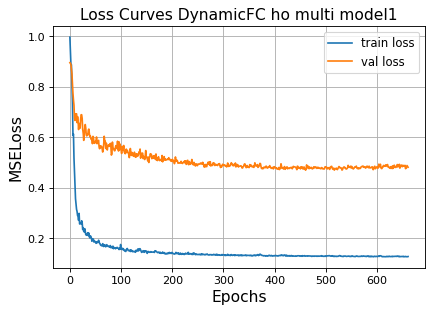

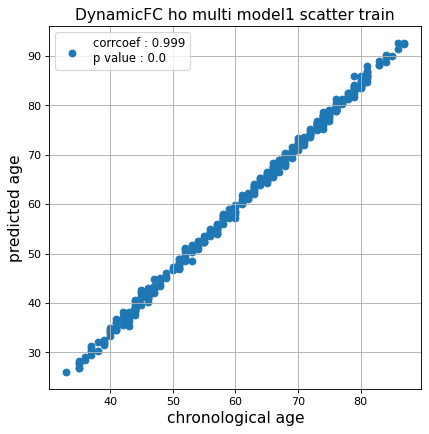

r^2 train data:  0.9276165308707376


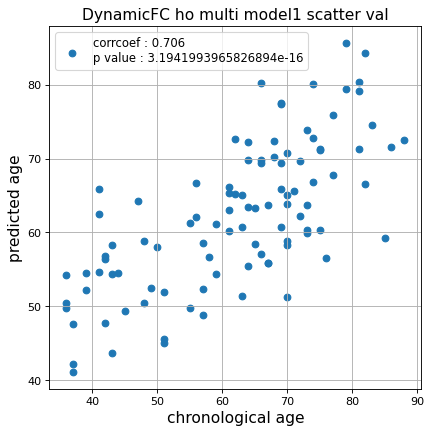

r^2 val data:  0.4981128146977978


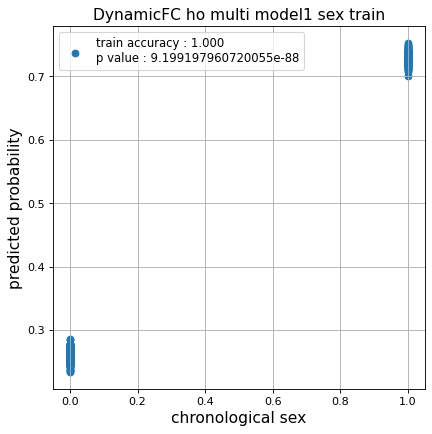

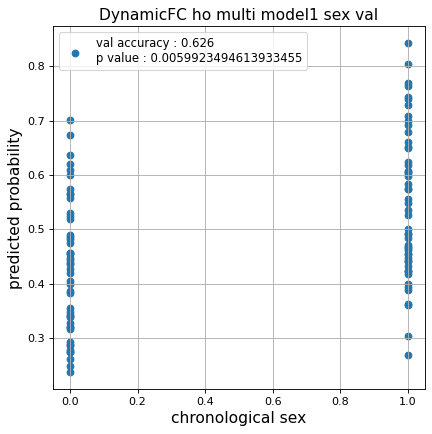

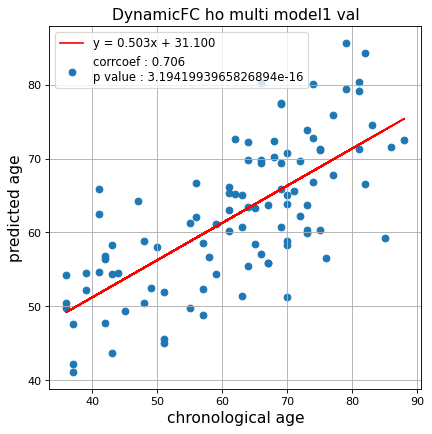

切片: 31.09976144566388
傾き: 0.5032537060594606
Kfold: 2 ::: epoch: 100, loss: 0.15651164834315962, val loss: 0.687658429145813
Kfold: 2 ::: epoch: 200, loss: 0.13835914318378156, val loss: 0.6850796639919281
Kfold: 2 ::: epoch: 300, loss: 0.1322124027288877, val loss: 0.6752154678106308
Kfold: 2 ::: epoch: 400, loss: 0.13078831365475288, val loss: 0.6610916256904602
Kfold: 2 ::: epoch: 500, loss: 0.12851250974031594, val loss: 0.6842043697834015
Kfold: 2 ::: epoch: 600, loss: 0.12746158643410757, val loss: 0.6527821570634842
Kfold: 2 ::: epoch: 700, loss: 0.12676643580198288, val loss: 0.6647061109542847
save_epochs:596
best val loss:0.6363331004977226


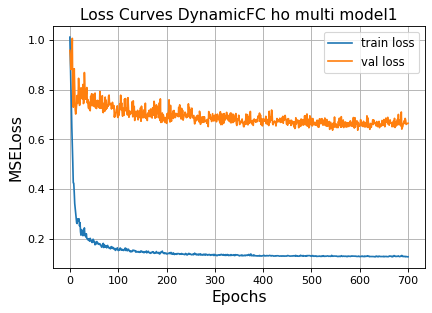

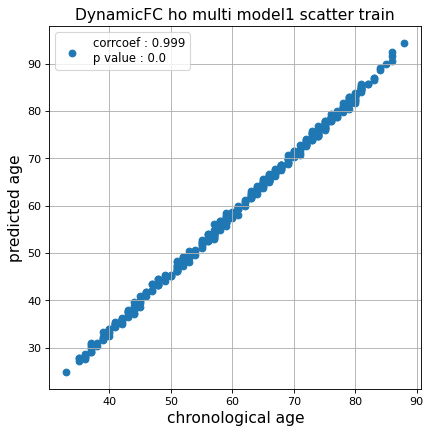

r^2 train data:  0.9301951964543328


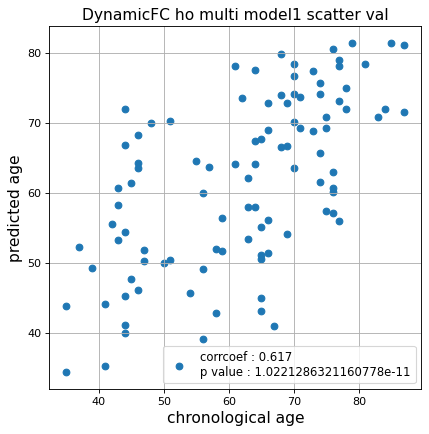

r^2 val data:  0.2996614505201597


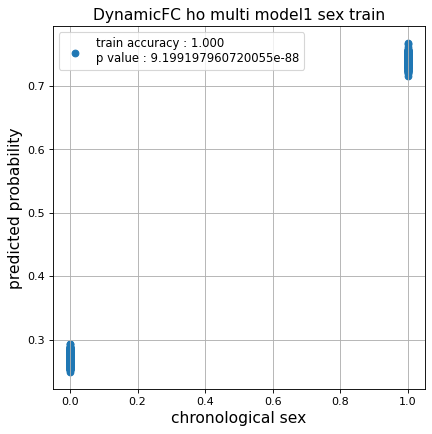

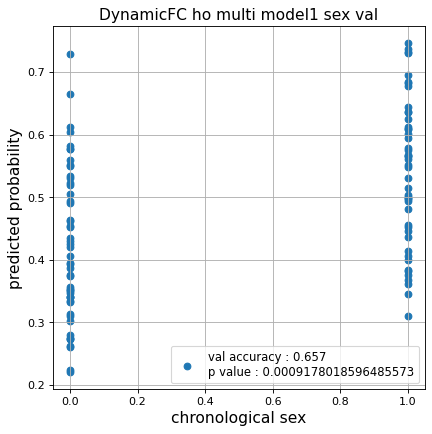

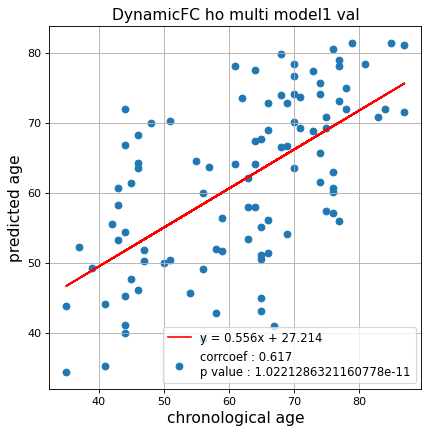

切片: 27.213553744919707
傾き: 0.556114213463745
Kfold: 3 ::: epoch: 100, loss: 0.1598208065216358, val loss: 1.2050156593322754
Kfold: 3 ::: epoch: 200, loss: 0.14619759756785172, val loss: 1.252322942018509
Kfold: 3 ::: epoch: 300, loss: 0.13771650997491983, val loss: 1.2234406173229218
Kfold: 3 ::: epoch: 400, loss: 0.13290254313212174, val loss: 1.2595608830451965
early stopping
save_epochs:204
best val loss:1.1550434827804565


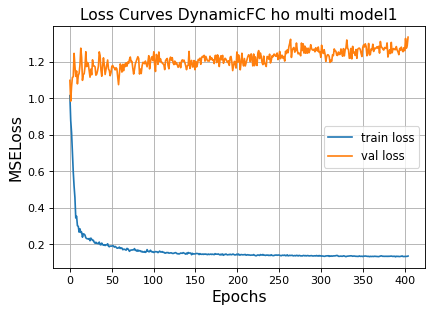

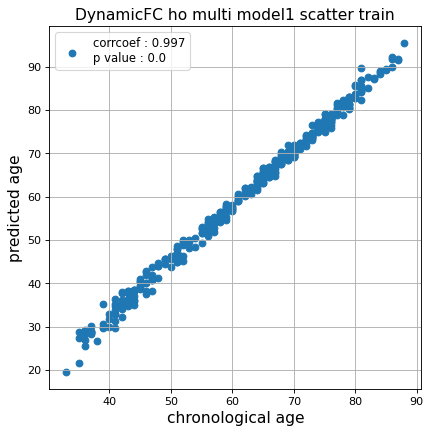

r^2 train data:  0.9092295948723277


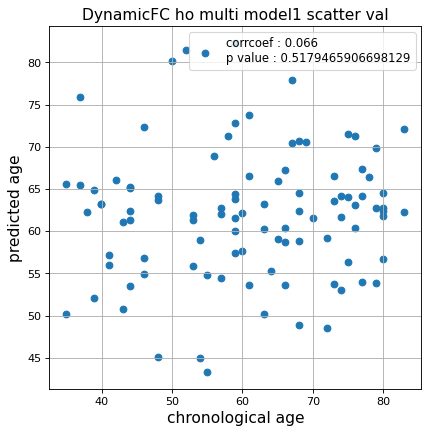

r^2 val data:  -0.25139144420687787


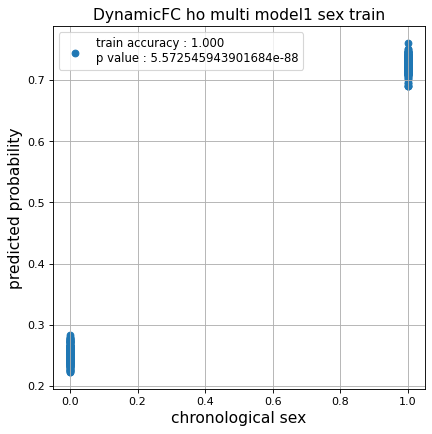

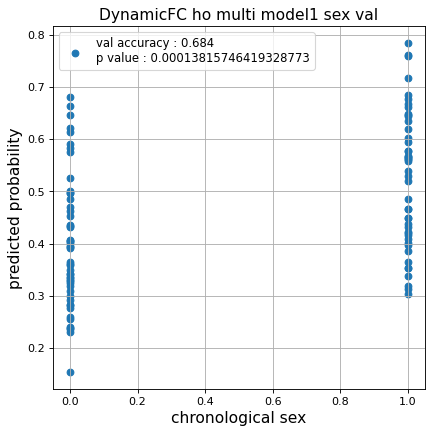

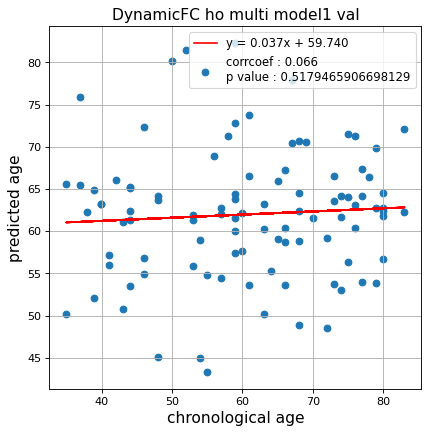

切片: 59.740041739738004
傾き: 0.03711886703715627
Kfold: 4 ::: epoch: 100, loss: 0.16045080583829147, val loss: 1.2255898416042328
Kfold: 4 ::: epoch: 200, loss: 0.14181186373417193, val loss: 1.1931574940681458
Kfold: 4 ::: epoch: 300, loss: 0.1372706683782431, val loss: 1.3270036280155182
Kfold: 4 ::: epoch: 400, loss: 0.13177468799627745, val loss: 1.308327741920948
early stopping
save_epochs:204
best val loss:1.1833171844482422


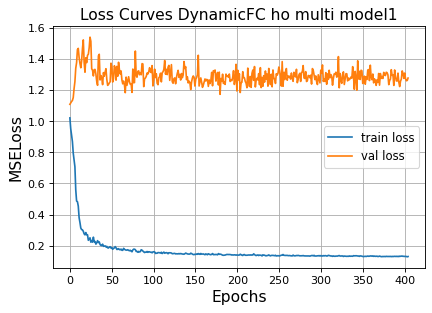

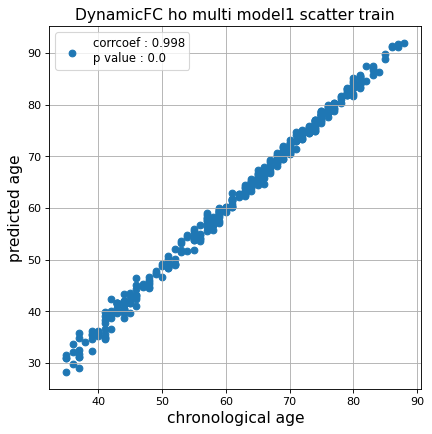

r^2 train data:  0.9627752794334821


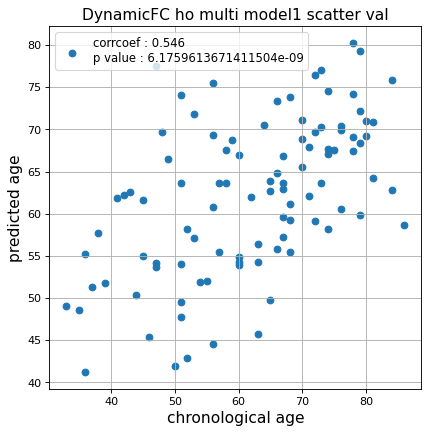

r^2 val data:  0.27899844188962586


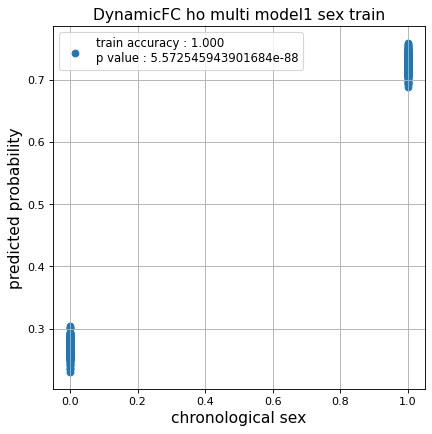

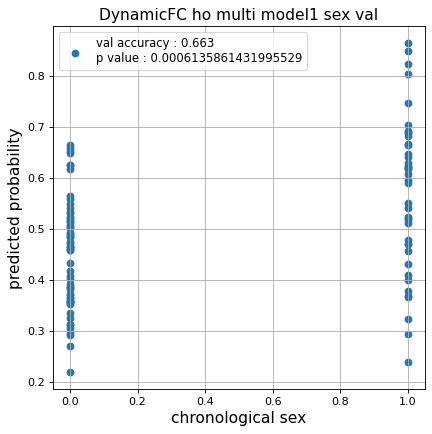

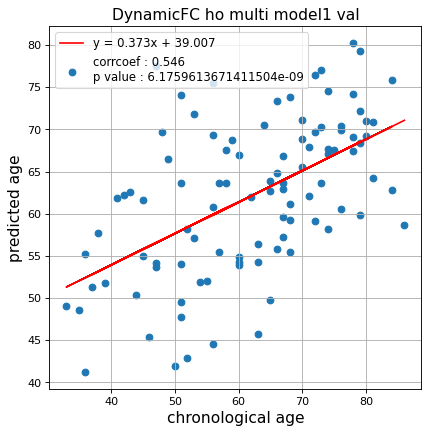

切片: 39.0074910818854
傾き: 0.37275847180559796
Kfold: 5 ::: epoch: 100, loss: 0.15918696155914894, val loss: 0.9624313712120056
Kfold: 5 ::: epoch: 200, loss: 0.14051484373899606, val loss: 0.8921429663896561
Kfold: 5 ::: epoch: 300, loss: 0.14019320905208588, val loss: 0.8506507873535156
Kfold: 5 ::: epoch: 400, loss: 0.1341433823108673, val loss: 0.8144534379243851
Kfold: 5 ::: epoch: 500, loss: 0.12904145625921395, val loss: 0.7746943533420563
Kfold: 5 ::: epoch: 600, loss: 0.12902268767356873, val loss: 0.7839736193418503
Kfold: 5 ::: epoch: 700, loss: 0.12818987552936262, val loss: 0.7886050045490265
save_epochs:648
best val loss:0.7658834308385849


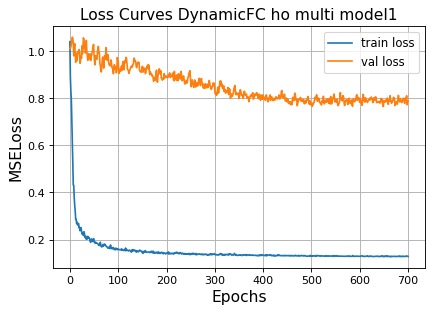

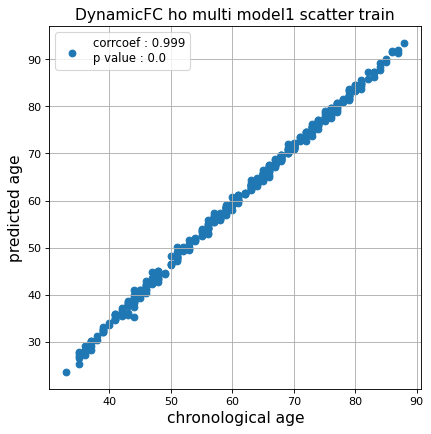

r^2 train data:  0.9332202727748412


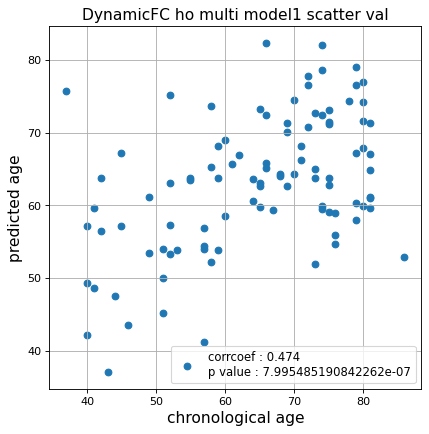

r^2 val data:  0.14398044866511006


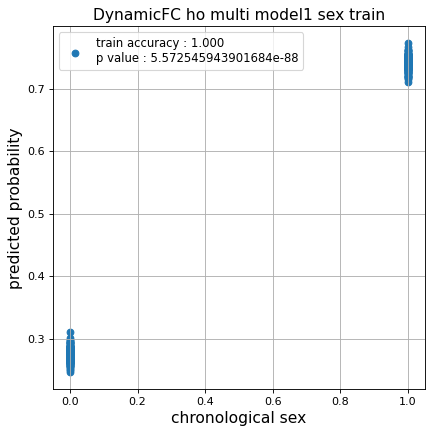

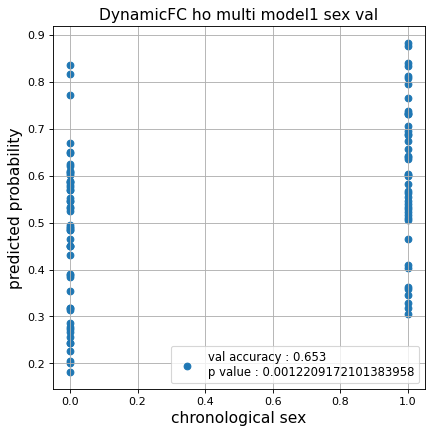

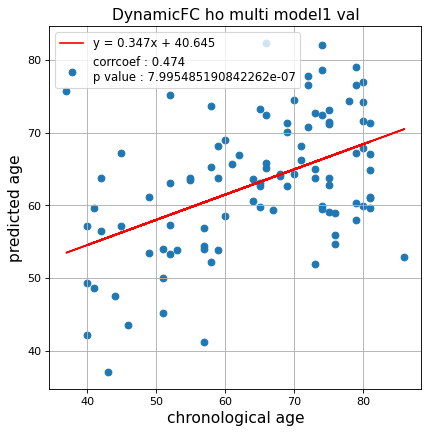

切片: 40.64543724804838
傾き: 0.34710939561005083
Nested Kfold ::: 2
Kfold: 1 ::: epoch: 100, loss: 0.17971408252532667, val loss: 0.5796151012182236
Kfold: 1 ::: epoch: 200, loss: 0.14432138548447535, val loss: 0.5156875178217888
Kfold: 1 ::: epoch: 300, loss: 0.1344326608456098, val loss: 0.5222172886133194
Kfold: 1 ::: epoch: 400, loss: 0.13174210488796234, val loss: 0.4954691082239151
Kfold: 1 ::: epoch: 500, loss: 0.129801071034028, val loss: 0.49000462889671326
Kfold: 1 ::: epoch: 600, loss: 0.12982419706307924, val loss: 0.47376734763383865
Kfold: 1 ::: epoch: 700, loss: 0.12830439095313734, val loss: 0.47313104569911957
save_epochs:636
best val loss:0.4611395001411438


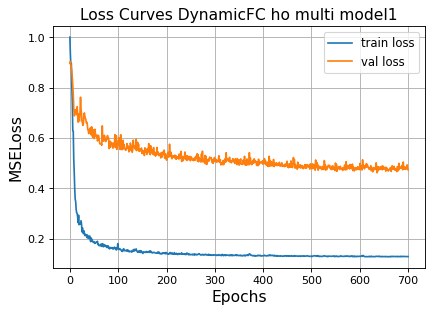

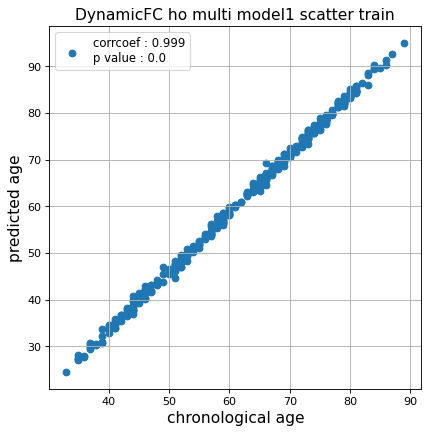

r^2 train data:  0.9279462704498964


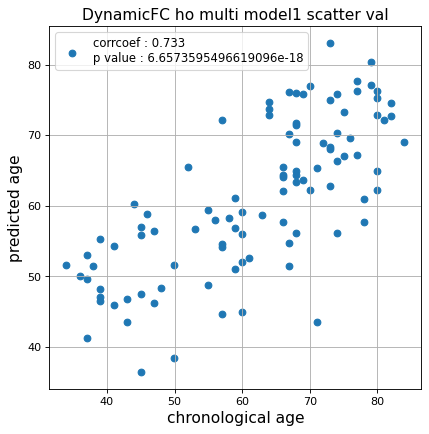

r^2 val data:  0.5304648710731961


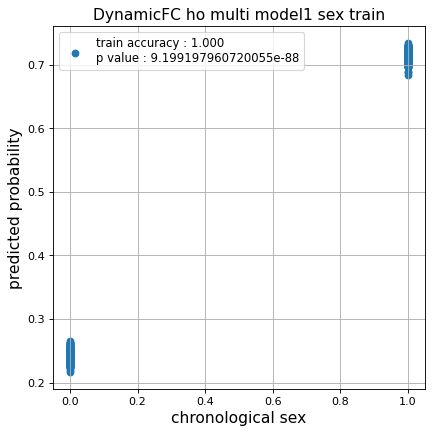

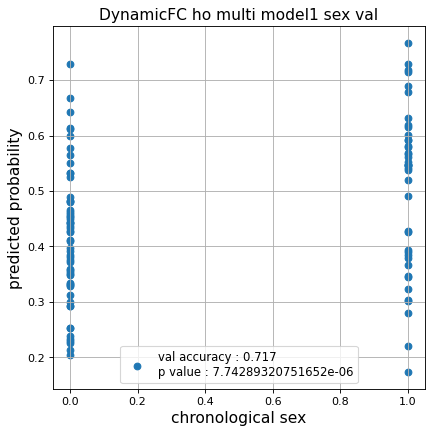

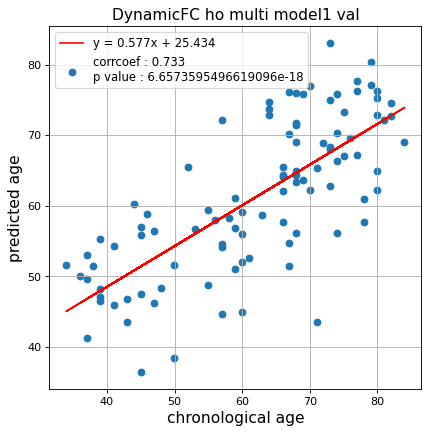

切片: 25.433784873055046
傾き: 0.5769181668558233
Kfold: 2 ::: epoch: 100, loss: 0.17108832185085004, val loss: 0.8780618607997894
Kfold: 2 ::: epoch: 200, loss: 0.1457806137891916, val loss: 0.8425282984972
Kfold: 2 ::: epoch: 300, loss: 0.14078049590954414, val loss: 0.8190752267837524
Kfold: 2 ::: epoch: 400, loss: 0.13567628883398497, val loss: 0.7768537700176239
Kfold: 2 ::: epoch: 500, loss: 0.1331639587879181, val loss: 0.783338338136673
Kfold: 2 ::: epoch: 600, loss: 0.13078745511861947, val loss: 0.7573835998773575
Kfold: 2 ::: epoch: 700, loss: 0.12914310510341936, val loss: 0.7587292641401291
save_epochs:638
best val loss:0.730621337890625


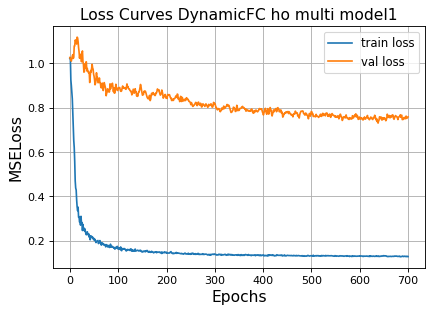

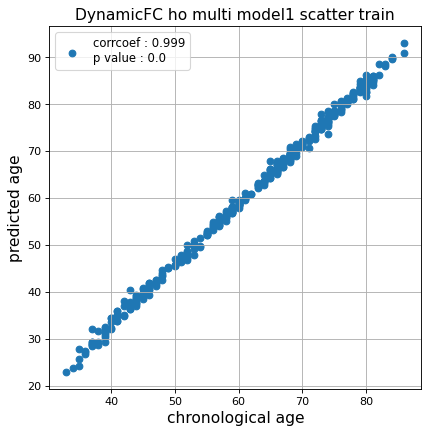

r^2 train data:  0.9144484983882235


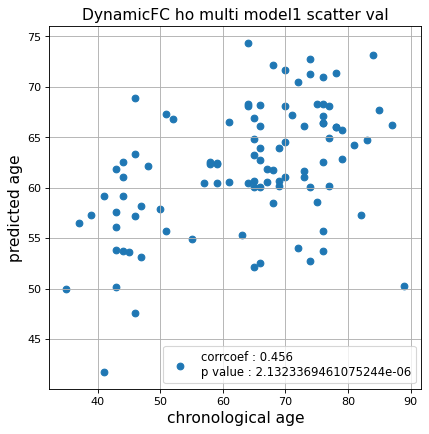

r^2 val data:  0.18571590696679208


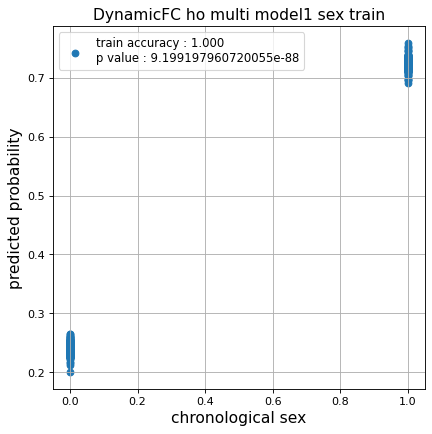

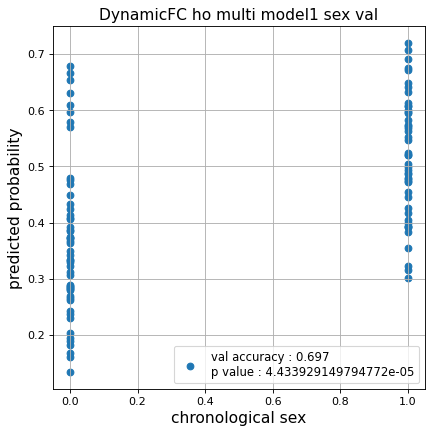

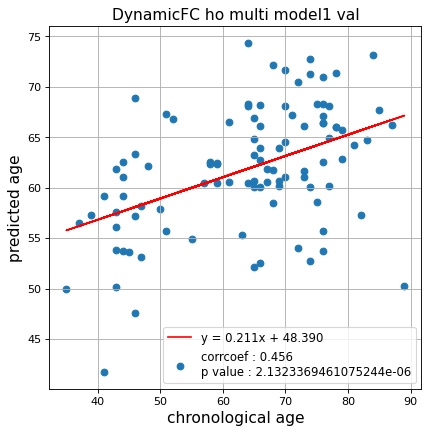

切片: 48.38953459444194
傾き: 0.21082046416913583
Kfold: 3 ::: epoch: 100, loss: 0.15887365891383246, val loss: 0.549089964479208
Kfold: 3 ::: epoch: 200, loss: 0.14027930337649125, val loss: 0.506442230194807
Kfold: 3 ::: epoch: 300, loss: 0.1359983510695971, val loss: 0.48294857516884804
Kfold: 3 ::: epoch: 400, loss: 0.13089058376275575, val loss: 0.492263525724411
Kfold: 3 ::: epoch: 500, loss: 0.1291020134320626, val loss: 0.4860069826245308
Kfold: 3 ::: epoch: 600, loss: 0.12995619040269119, val loss: 0.4815961569547653
Kfold: 3 ::: epoch: 700, loss: 0.12877366978388566, val loss: 0.47929729893803596
save_epochs:655
best val loss:0.4705660752952099


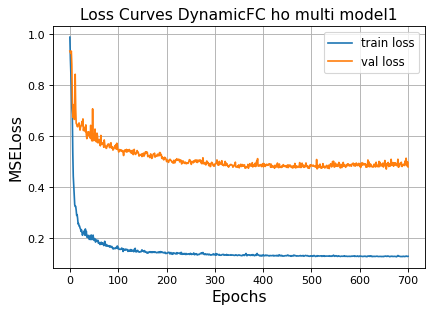

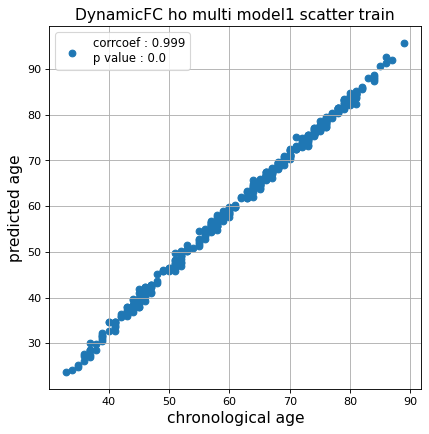

r^2 train data:  0.9248152831736595


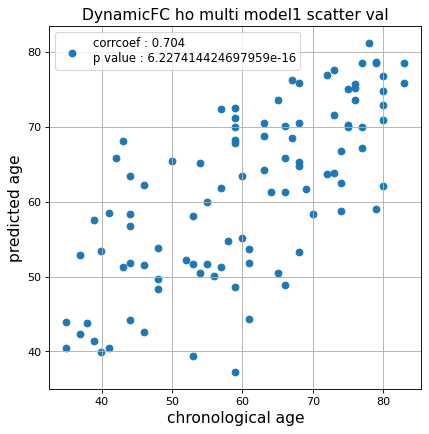

r^2 val data:  0.4742282265323968


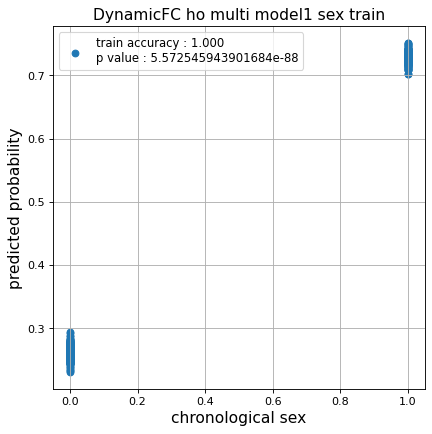

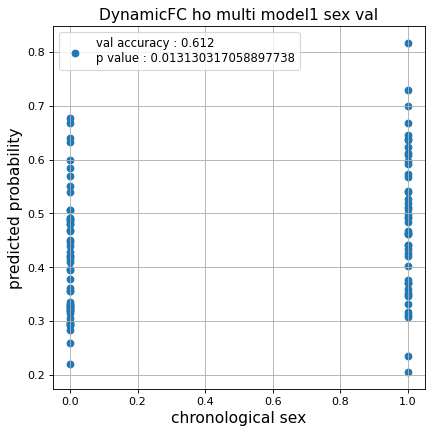

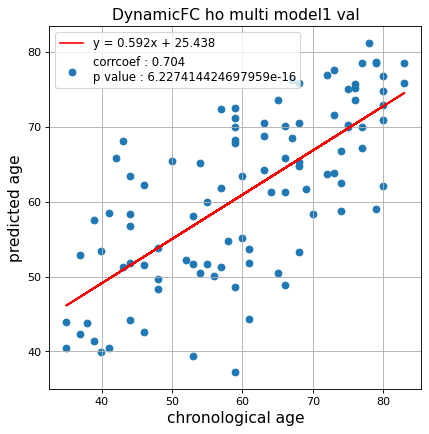

切片: 25.437824336200954
傾き: 0.5917831052971606
Kfold: 4 ::: epoch: 100, loss: 0.16191541231595552, val loss: 1.1462410986423492
Kfold: 4 ::: epoch: 200, loss: 0.1407896761710827, val loss: 1.1920208930969238
Kfold: 4 ::: epoch: 300, loss: 0.134777409526018, val loss: 1.165938138961792
Kfold: 4 ::: epoch: 400, loss: 0.13200034774266756, val loss: 1.1730965822935104
Kfold: 4 ::: epoch: 500, loss: 0.13054707875618568, val loss: 1.1184454411268234
Kfold: 4 ::: epoch: 600, loss: 0.12899536696764138, val loss: 1.0402145683765411
Kfold: 4 ::: epoch: 700, loss: 0.12796005262778357, val loss: 1.042339339852333
save_epochs:553
best val loss:1.0194694250822067


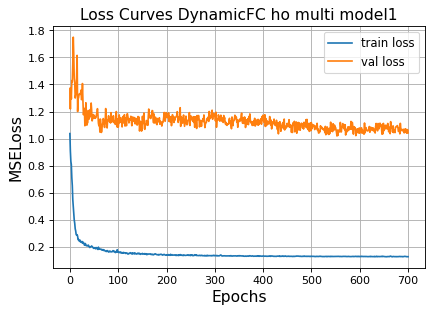

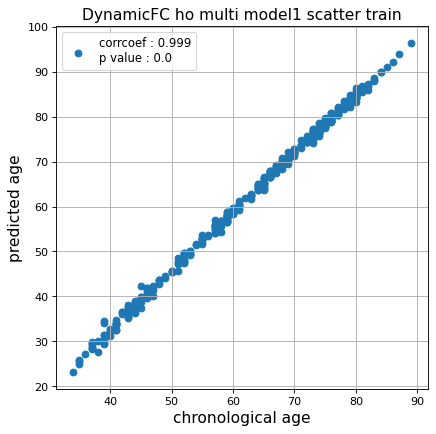

r^2 train data:  0.9033095982317321


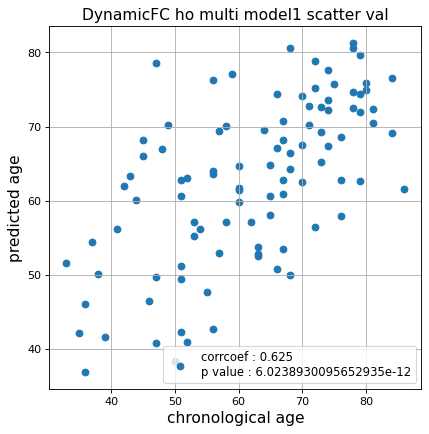

r^2 val data:  0.34778256687581954


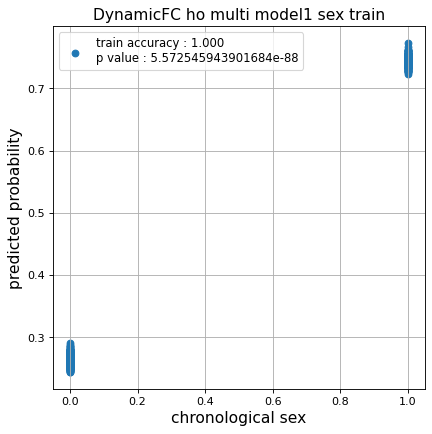

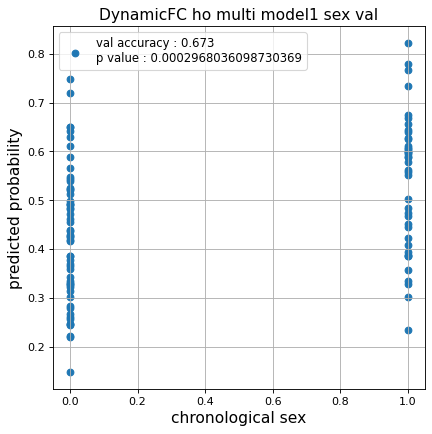

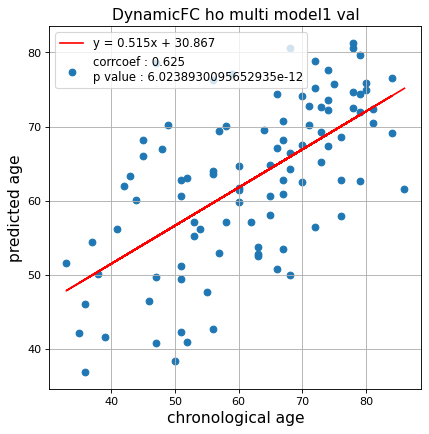

切片: 30.867357778901862
傾き: 0.5149245467037251
Kfold: 5 ::: epoch: 100, loss: 0.1645513234230188, val loss: 0.9166854619979858
Kfold: 5 ::: epoch: 200, loss: 0.1448143067268225, val loss: 0.9019377529621124
Kfold: 5 ::: epoch: 300, loss: 0.13951858763511366, val loss: 0.8630624711513519
Kfold: 5 ::: epoch: 400, loss: 0.1362303770505465, val loss: 0.8316343724727631
Kfold: 5 ::: epoch: 500, loss: 0.13178369861382705, val loss: 0.7814496979117393
Kfold: 5 ::: epoch: 600, loss: 0.13155428148232973, val loss: 0.7451496124267578
Kfold: 5 ::: epoch: 700, loss: 0.1304440567126641, val loss: 0.7179193273186684
save_epochs:694
best val loss:0.6988175213336945


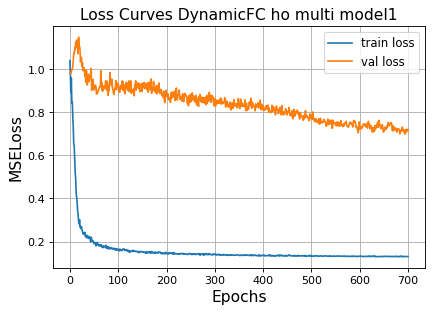

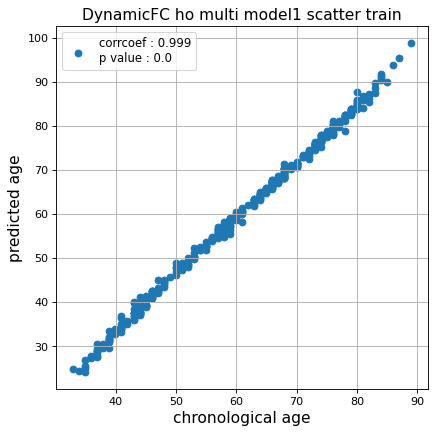

r^2 train data:  0.916147619769659


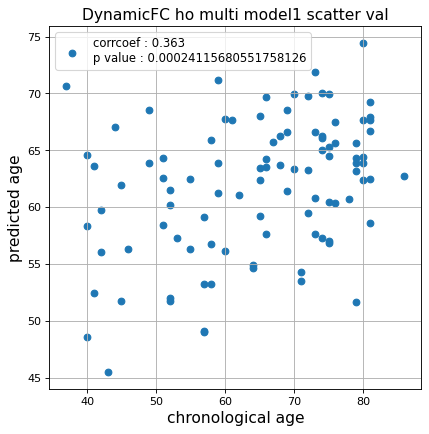

r^2 val data:  0.07339007496918248


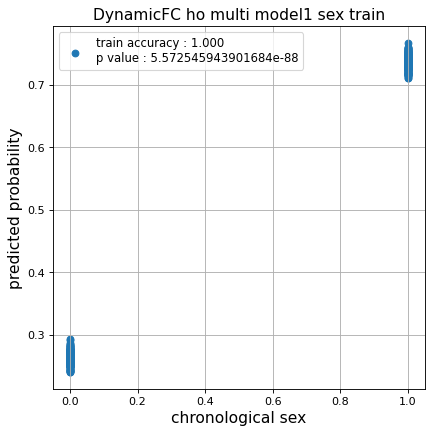

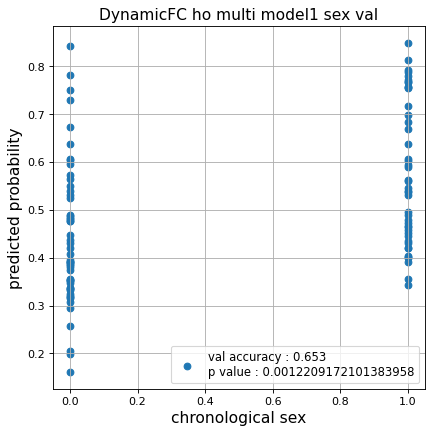

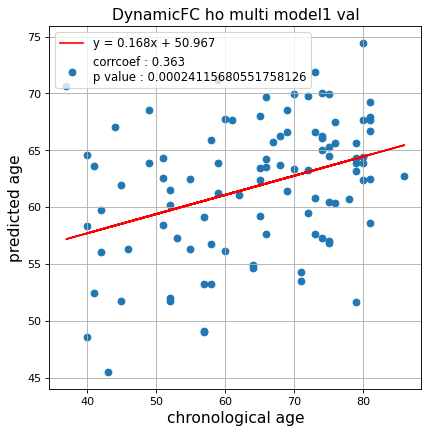

切片: 50.96665668660584
傾き: 0.16845353448668124
Nested Kfold ::: 3
Kfold: 1 ::: epoch: 100, loss: 0.17337316503891578, val loss: 0.686801515519619
Kfold: 1 ::: epoch: 200, loss: 0.1443204925610469, val loss: 0.6117069721221924
Kfold: 1 ::: epoch: 300, loss: 0.13370744654765496, val loss: 0.5965104103088379
Kfold: 1 ::: epoch: 400, loss: 0.13315147505356714, val loss: 0.5870890319347382
Kfold: 1 ::: epoch: 500, loss: 0.12942094413133767, val loss: 0.5770055800676346
Kfold: 1 ::: epoch: 600, loss: 0.12946017659627473, val loss: 0.5585885420441628
Kfold: 1 ::: epoch: 700, loss: 0.1284413979603694, val loss: 0.5729783102869987
save_epochs:665
best val loss:0.5463042259216309


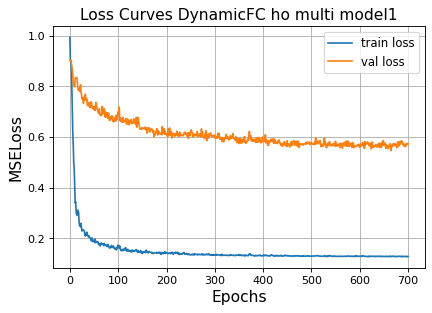

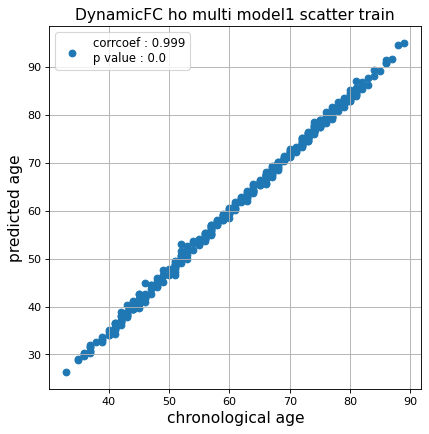

r^2 train data:  0.9467976912442876


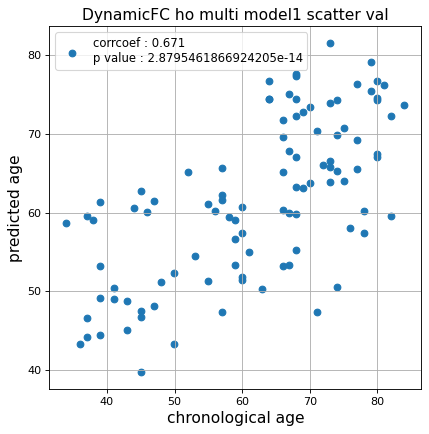

r^2 val data:  0.4452497322065808


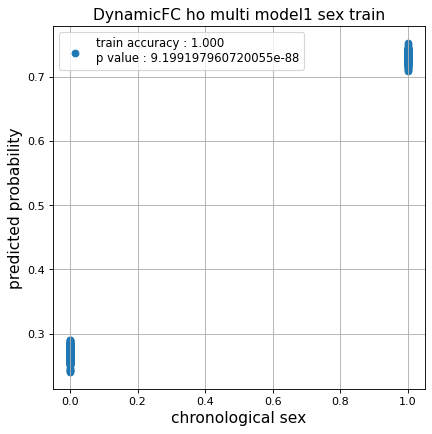

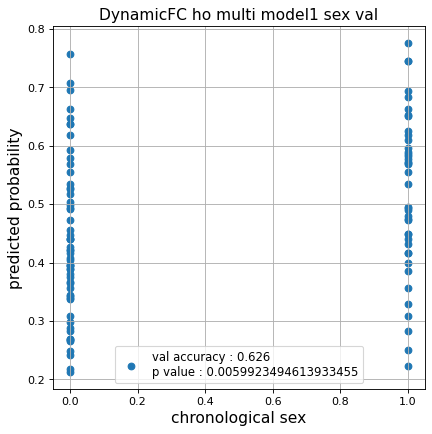

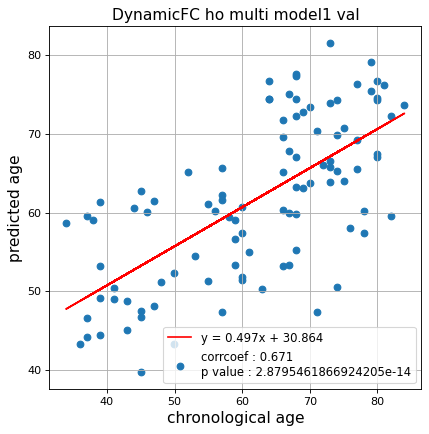

切片: 30.86414956126947
傾き: 0.49683477935037756
Kfold: 2 ::: epoch: 100, loss: 0.16957444640306327, val loss: 0.8104104623198509
Kfold: 2 ::: epoch: 200, loss: 0.14283744646952704, val loss: 0.7613094113767147
Kfold: 2 ::: epoch: 300, loss: 0.13981512074287122, val loss: 0.7248428240418434
Kfold: 2 ::: epoch: 400, loss: 0.13423371429626757, val loss: 0.6999953165650368
Kfold: 2 ::: epoch: 500, loss: 0.1315167500422551, val loss: 0.6564953550696373
Kfold: 2 ::: epoch: 600, loss: 0.12993260874198034, val loss: 0.6361448504030704
Kfold: 2 ::: epoch: 700, loss: 0.12887120132262891, val loss: 0.6134214177727699
save_epochs:688
best val loss:0.6027030721306801


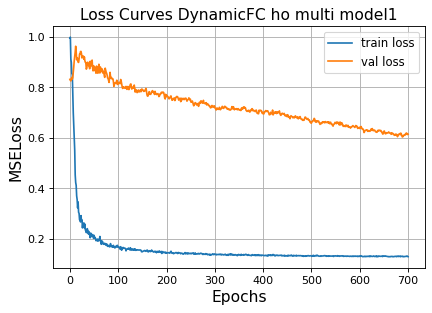

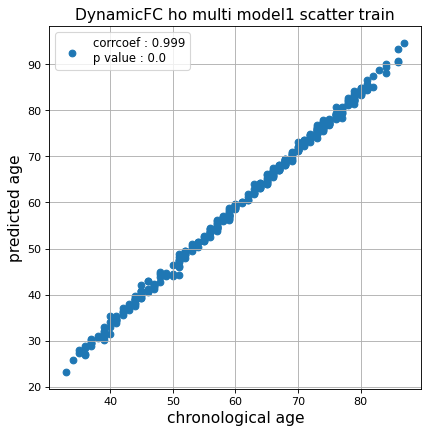

r^2 train data:  0.9235656516347187


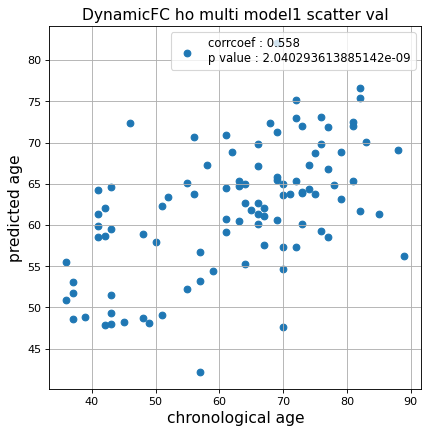

r^2 val data:  0.30829339816601575


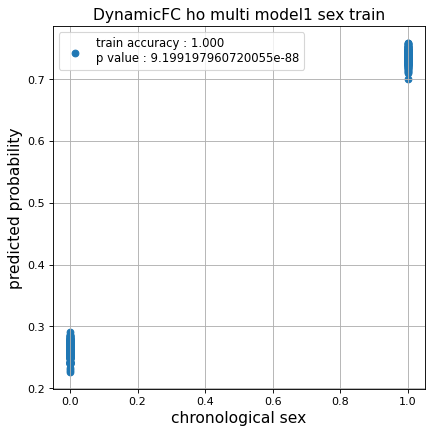

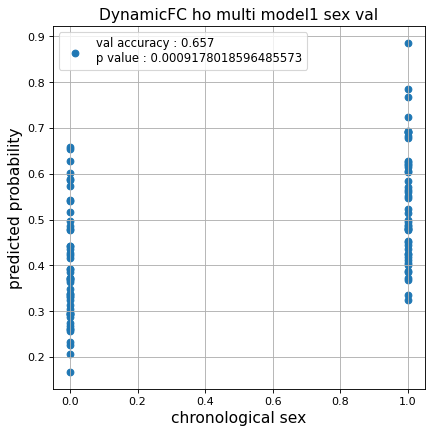

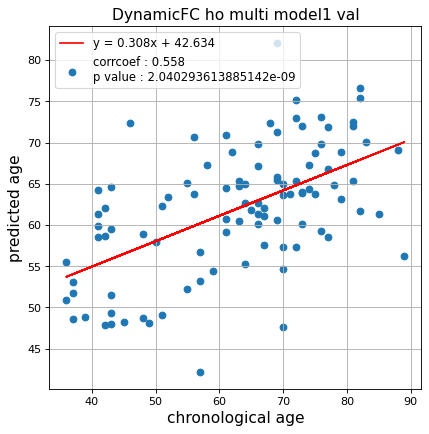

切片: 42.63407864089315
傾き: 0.3080358862305913
Kfold: 3 ::: epoch: 100, loss: 0.15706850015200102, val loss: 0.5620993226766586
Kfold: 3 ::: epoch: 200, loss: 0.1416181451999224, val loss: 0.5334031246602535
Kfold: 3 ::: epoch: 300, loss: 0.13542822117988879, val loss: 0.5069280713796616
Kfold: 3 ::: epoch: 400, loss: 0.1307088193985132, val loss: 0.5198181718587875
Kfold: 3 ::: epoch: 500, loss: 0.12972655090001914, val loss: 0.5118719153106213
Kfold: 3 ::: epoch: 600, loss: 0.1305846250974215, val loss: 0.5046911351382732
early stopping
save_epochs:496
best val loss:0.491402268409729


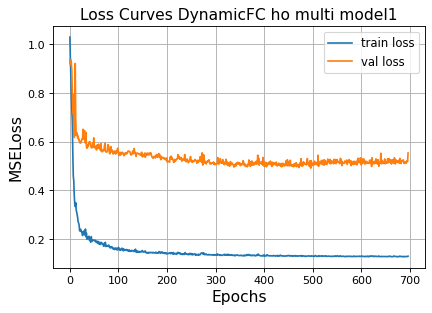

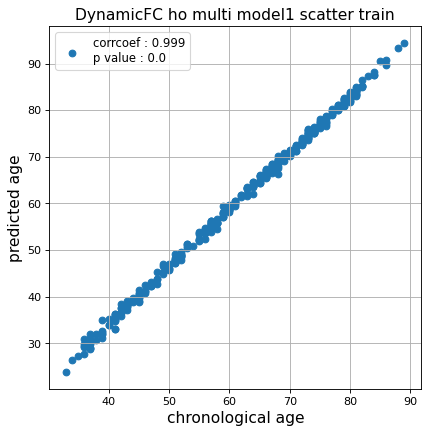

r^2 train data:  0.9455898448252014


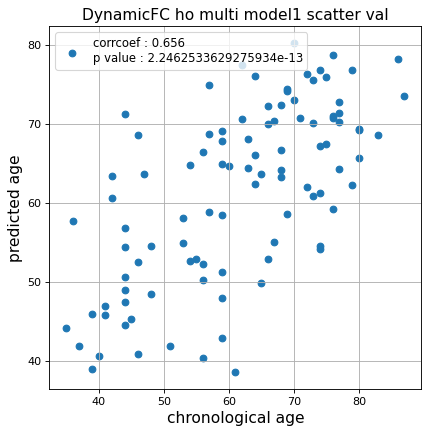

r^2 val data:  0.3960826898108393


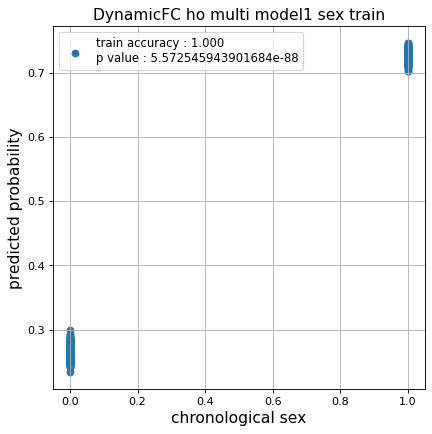

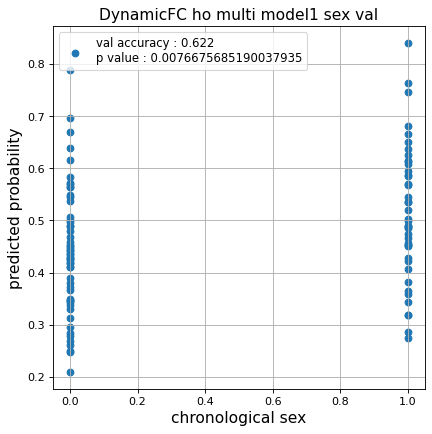

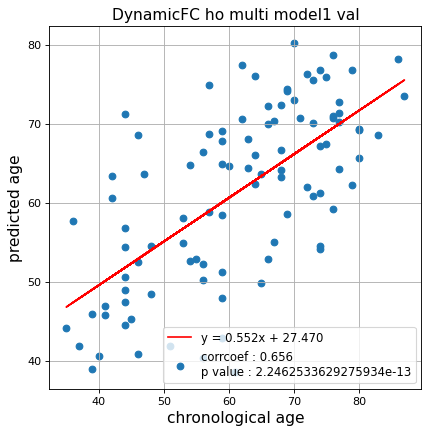

切片: 27.469823668346912
傾き: 0.5521546479782015
Kfold: 4 ::: epoch: 100, loss: 0.16240494984846848, val loss: 1.088491827249527
Kfold: 4 ::: epoch: 200, loss: 0.14166733622550964, val loss: 1.0825087279081345
Kfold: 4 ::: epoch: 300, loss: 0.13512267286960894, val loss: 1.1031832098960876
Kfold: 4 ::: epoch: 400, loss: 0.13267609018545884, val loss: 1.0869331061840057
Kfold: 4 ::: epoch: 500, loss: 0.1309568308866941, val loss: 1.0780271142721176
early stopping
save_epochs:310
best val loss:1.0166164189577103


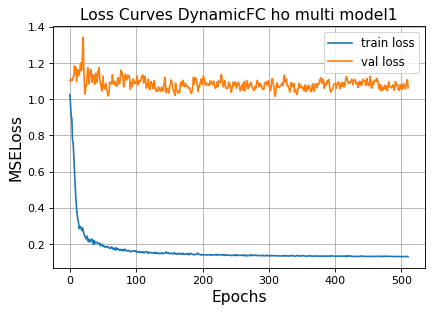

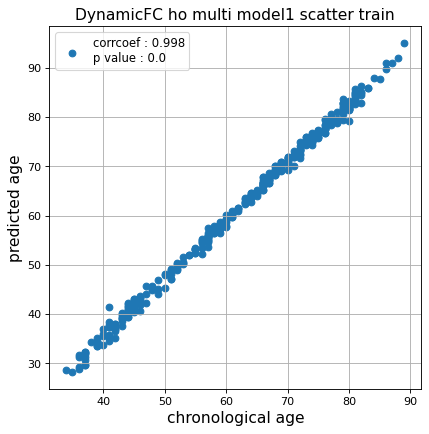

r^2 train data:  0.9617276415714494


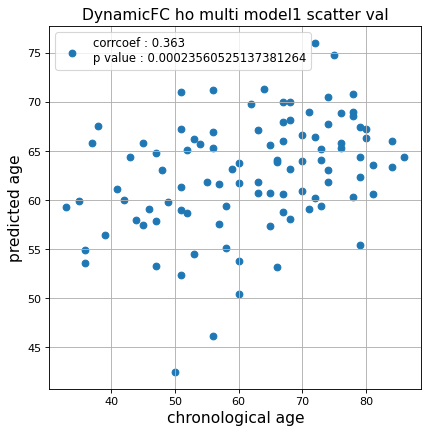

r^2 val data:  0.12499975473037295


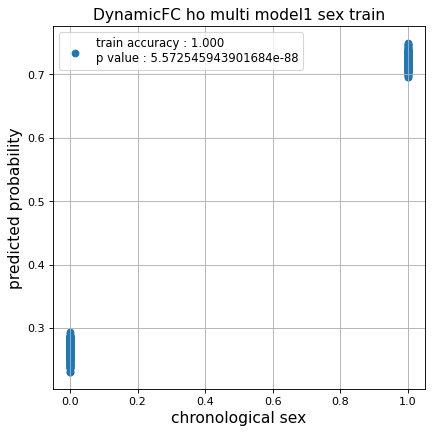

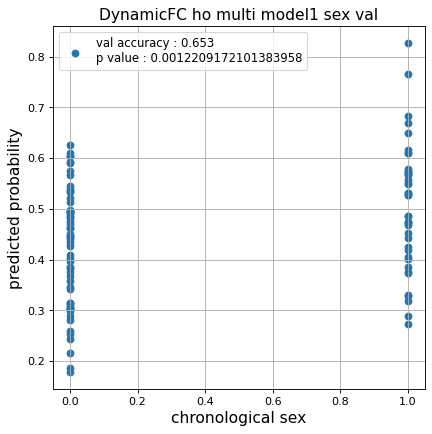

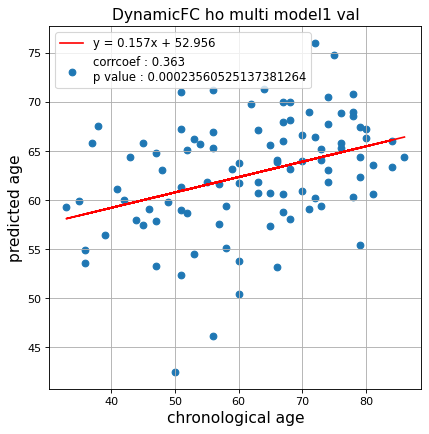

切片: 52.95626462752617
傾き: 0.156848236801915
Kfold: 5 ::: epoch: 100, loss: 0.16153073425476366, val loss: 1.0327310860157013
Kfold: 5 ::: epoch: 200, loss: 0.1394067807839467, val loss: 1.0645638555288315
Kfold: 5 ::: epoch: 300, loss: 0.13752147555351257, val loss: 1.0599536746740341
Kfold: 5 ::: epoch: 400, loss: 0.1312915304532418, val loss: 1.0142784863710403
Kfold: 5 ::: epoch: 500, loss: 0.13101953038802513, val loss: 0.9898455291986465
Kfold: 5 ::: epoch: 600, loss: 0.13119357021955344, val loss: 0.9842941015958786
Kfold: 5 ::: epoch: 700, loss: 0.13017476522005522, val loss: 0.9178703278303146
save_epochs:658
best val loss:0.9095425456762314


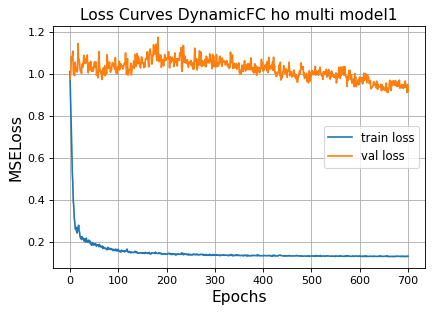

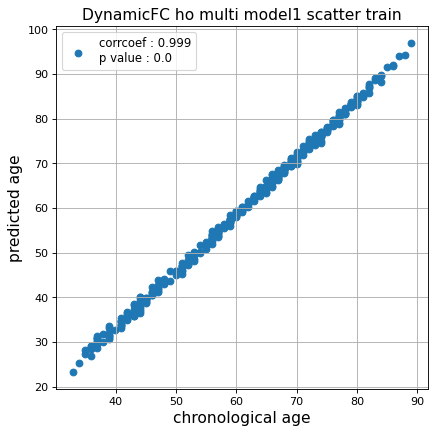

r^2 train data:  0.9184705283466497


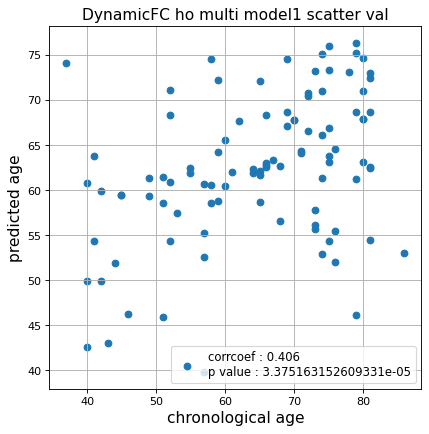

r^2 val data:  0.08451277860542827


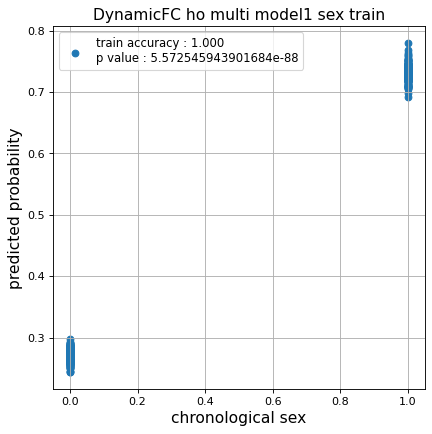

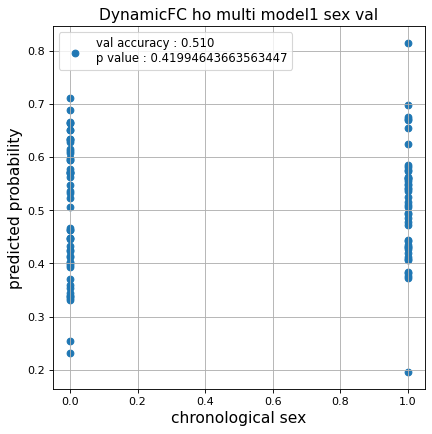

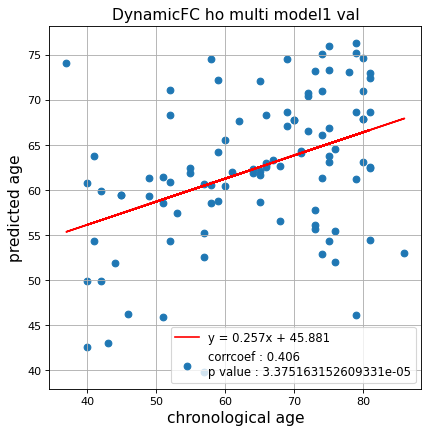

切片: 45.881362851774725
傾き: 0.2568468590921198
Nested Kfold ::: 4
Kfold: 1 ::: epoch: 100, loss: 0.16035604247680077, val loss: 0.6004236936569214
Kfold: 1 ::: epoch: 200, loss: 0.14330581862192887, val loss: 0.5602292865514755
Kfold: 1 ::: epoch: 300, loss: 0.13458030613569114, val loss: 0.5239212587475777
Kfold: 1 ::: epoch: 400, loss: 0.13344945242771736, val loss: 0.509756475687027
Kfold: 1 ::: epoch: 500, loss: 0.12915737583087042, val loss: 0.5041776075959206
Kfold: 1 ::: epoch: 600, loss: 0.12944406729478103, val loss: 0.48722148686647415
Kfold: 1 ::: epoch: 700, loss: 0.12875930964946747, val loss: 0.5009515061974525
save_epochs:634
best val loss:0.4787757769227028


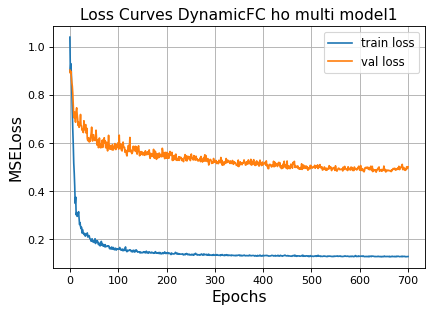

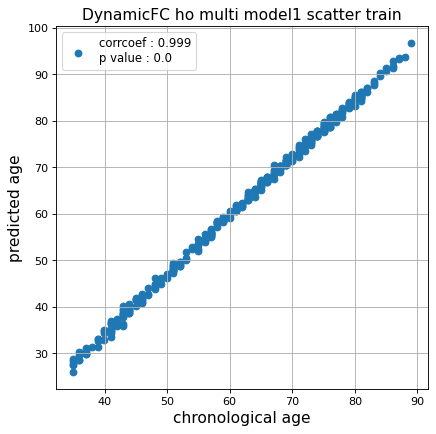

r^2 train data:  0.9304131857075526


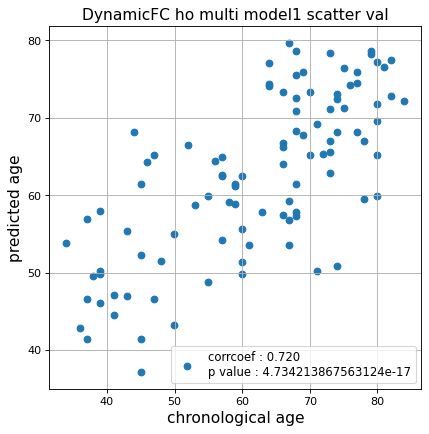

r^2 val data:  0.5148270033744353


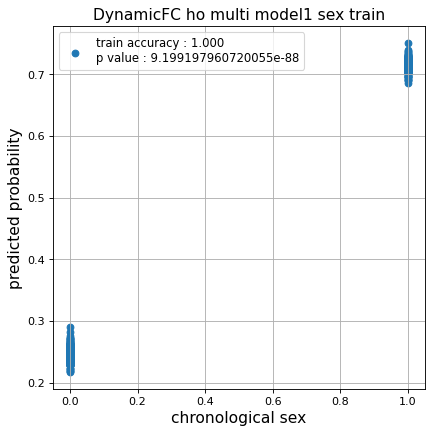

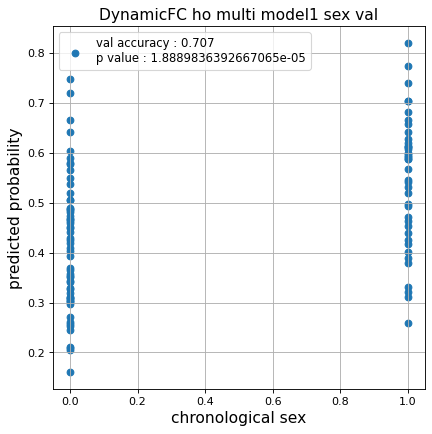

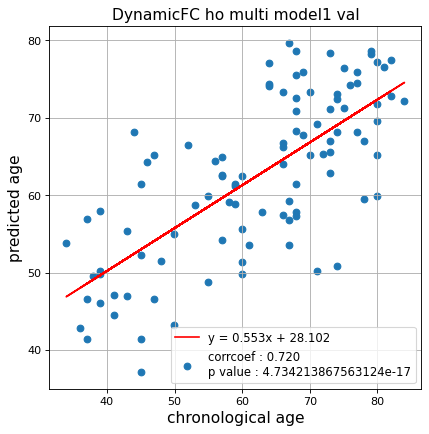

切片: 28.101801217174675
傾き: 0.5530256960098228
Kfold: 2 ::: epoch: 100, loss: 0.17214108659670904, val loss: 0.8830219432711601
Kfold: 2 ::: epoch: 200, loss: 0.1457620492348304, val loss: 0.7922526113688946
Kfold: 2 ::: epoch: 300, loss: 0.13983925374654624, val loss: 0.7483294047415257
Kfold: 2 ::: epoch: 400, loss: 0.13517429049198443, val loss: 0.7149384059011936
Kfold: 2 ::: epoch: 500, loss: 0.13205596575370201, val loss: 0.6757942475378513
Kfold: 2 ::: epoch: 600, loss: 0.12960254229032075, val loss: 0.6356811411678791
Kfold: 2 ::: epoch: 700, loss: 0.12979231201685393, val loss: 0.6020065099000931
save_epochs:700
best val loss:0.6020065099000931


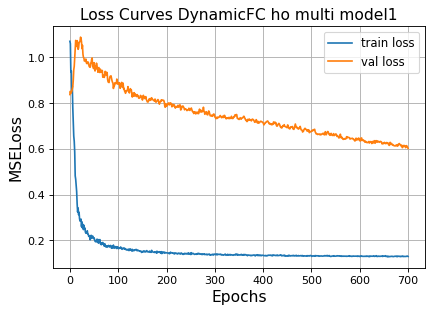

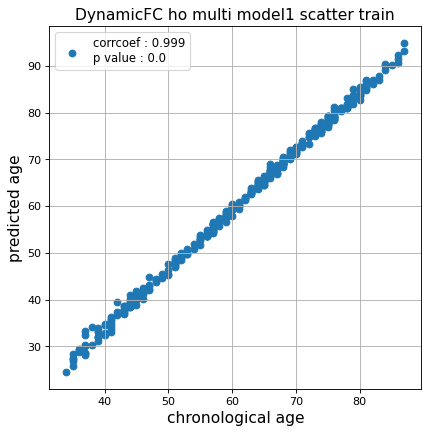

r^2 train data:  0.927220730429963


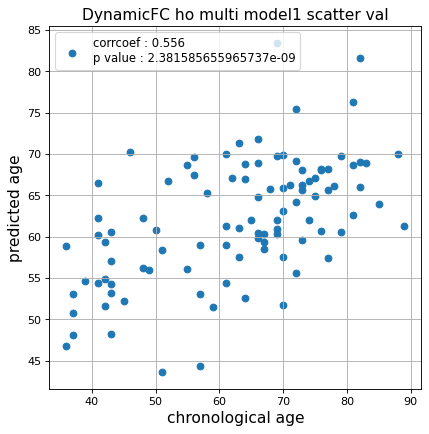

r^2 val data:  0.3063277521201927


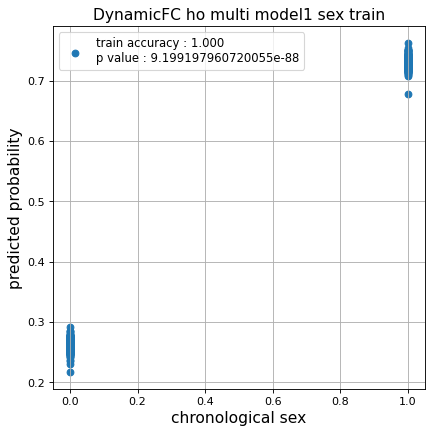

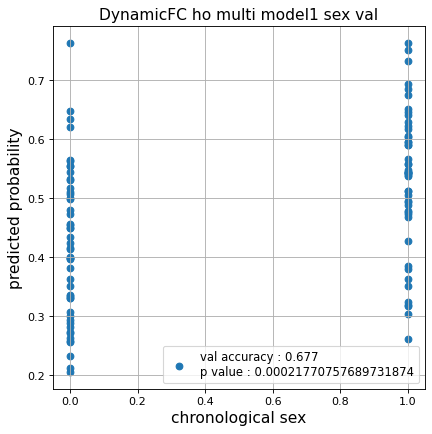

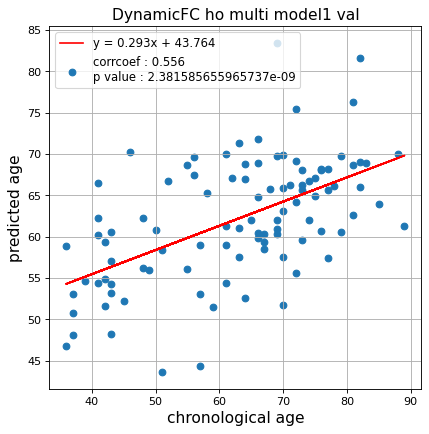

切片: 43.76412548655401
傾き: 0.2925250060782896
Kfold: 3 ::: epoch: 100, loss: 0.15866166926347292, val loss: 0.5623595342040062
Kfold: 3 ::: epoch: 200, loss: 0.142294976573724, val loss: 0.5621751695871353
Kfold: 3 ::: epoch: 300, loss: 0.13479012480148903, val loss: 0.5880884453654289
Kfold: 3 ::: epoch: 400, loss: 0.12969438617046064, val loss: 0.6222755610942841
early stopping
save_epochs:203
best val loss:0.5537845194339752


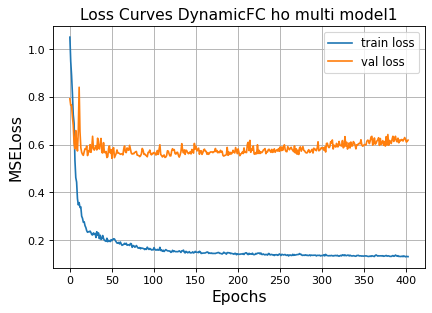

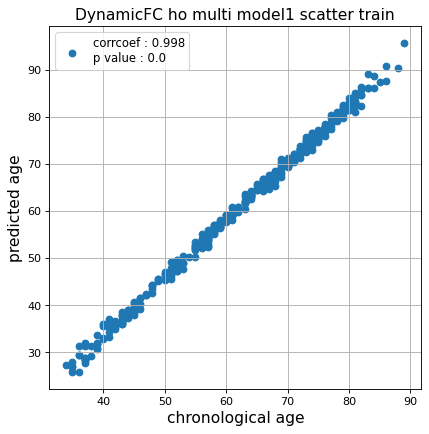

r^2 train data:  0.9363184610031238


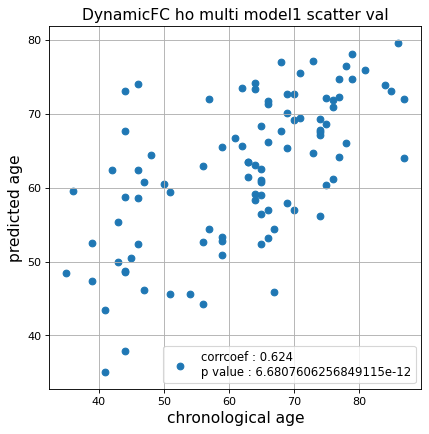

r^2 val data:  0.37244735231330683


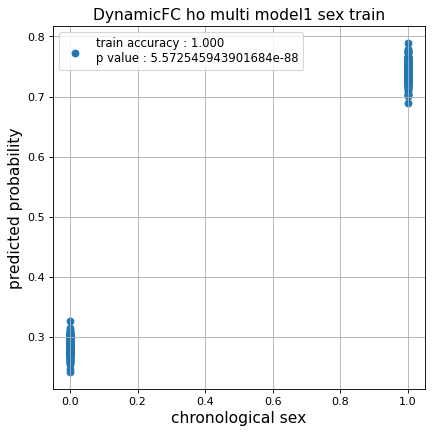

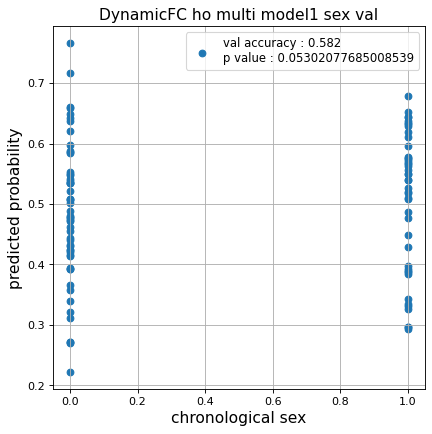

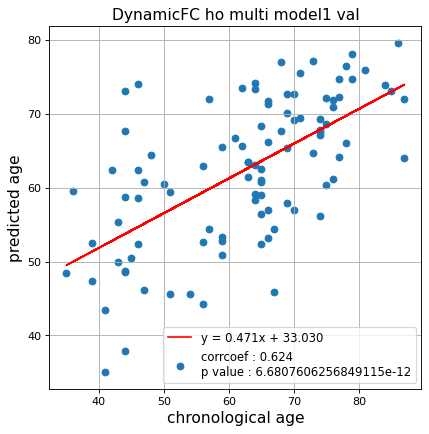

切片: 33.02973557916707
傾き: 0.4705654798707627
Kfold: 4 ::: epoch: 100, loss: 0.15710217792254227, val loss: 0.9260024353861809
Kfold: 4 ::: epoch: 200, loss: 0.14142556259265313, val loss: 0.8694710582494736
Kfold: 4 ::: epoch: 300, loss: 0.13318672203100645, val loss: 0.9305597543716431
Kfold: 4 ::: epoch: 400, loss: 0.13085250556468964, val loss: 0.8927828669548035
early stopping
save_epochs:213
best val loss:0.8635690733790398


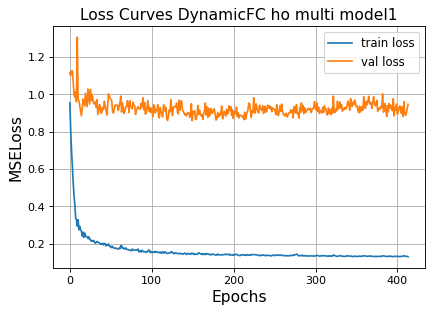

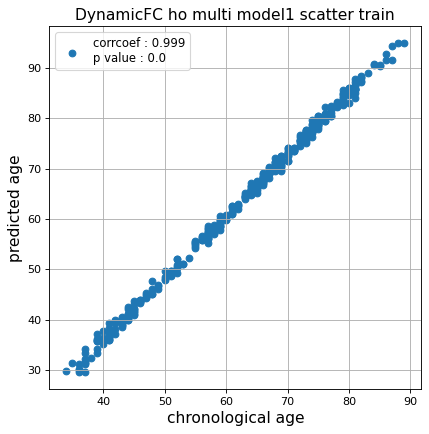

r^2 train data:  0.9361591328932226


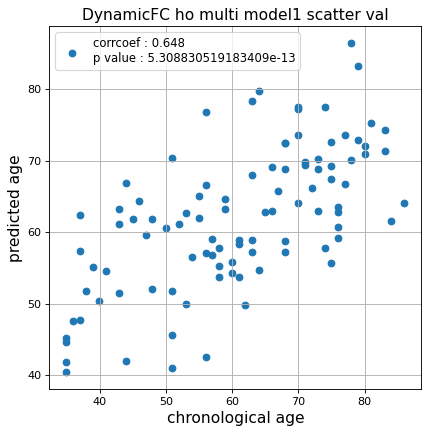

r^2 val data:  0.4102788747787256


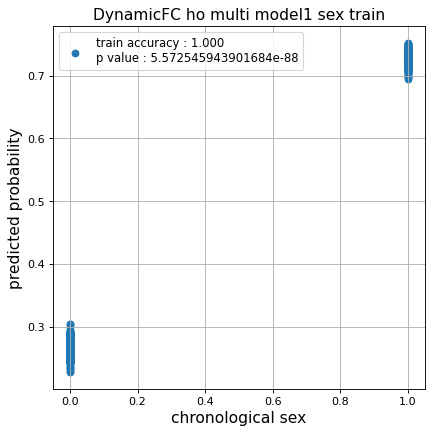

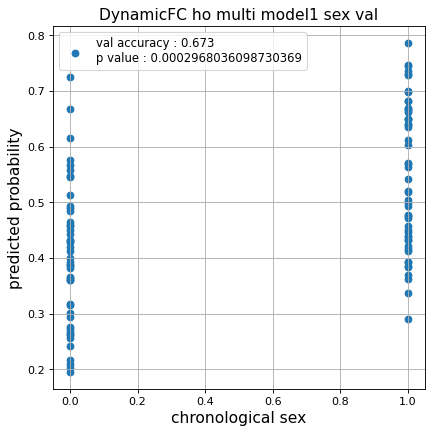

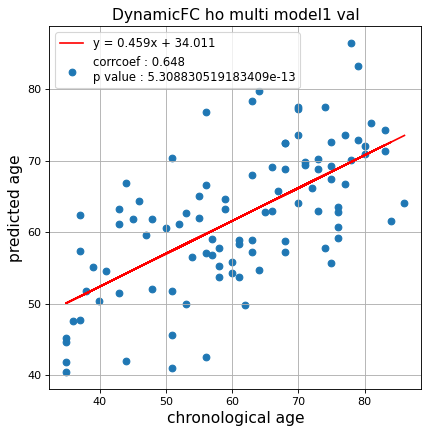

切片: 34.01084435013251
傾き: 0.45921165715632634
Kfold: 5 ::: epoch: 100, loss: 0.157411040021823, val loss: 0.9661190807819366
Kfold: 5 ::: epoch: 200, loss: 0.14194554892870095, val loss: 0.8006327003240585
Kfold: 5 ::: epoch: 300, loss: 0.1400107042147563, val loss: 0.8037367016077042
Kfold: 5 ::: epoch: 400, loss: 0.13675056168666253, val loss: 0.7251144796609879
Kfold: 5 ::: epoch: 500, loss: 0.1310494587971614, val loss: 0.7355279475450516
Kfold: 5 ::: epoch: 600, loss: 0.12875326149738753, val loss: 0.7028175443410873
Kfold: 5 ::: epoch: 700, loss: 0.12825296016839835, val loss: 0.685874879360199
save_epochs:576
best val loss:0.6747635826468468


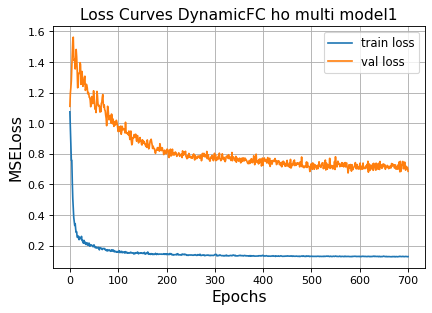

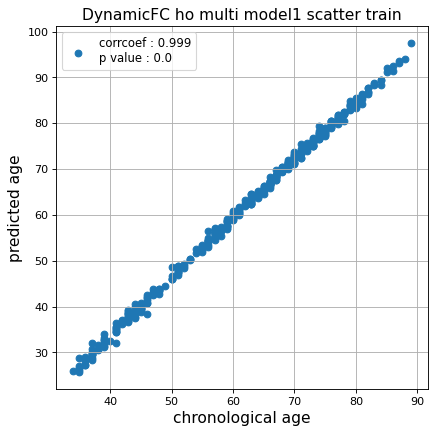

r^2 train data:  0.9201130124645461


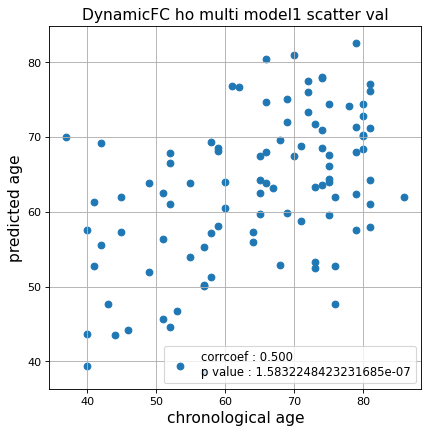

r^2 val data:  0.15615344458566216


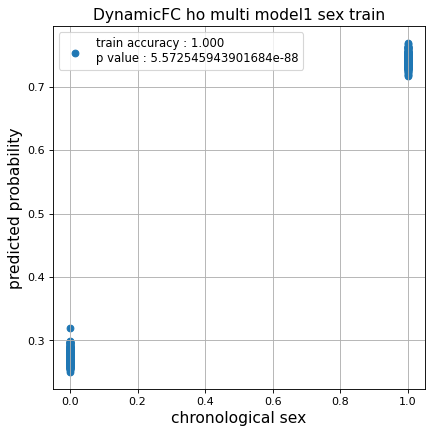

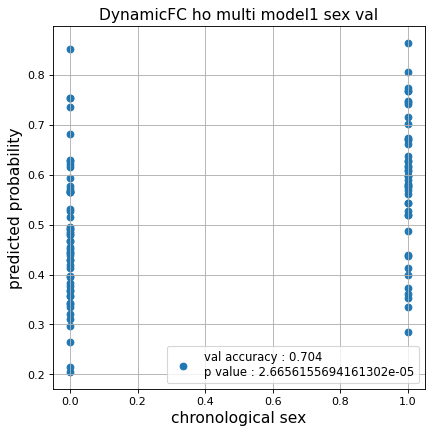

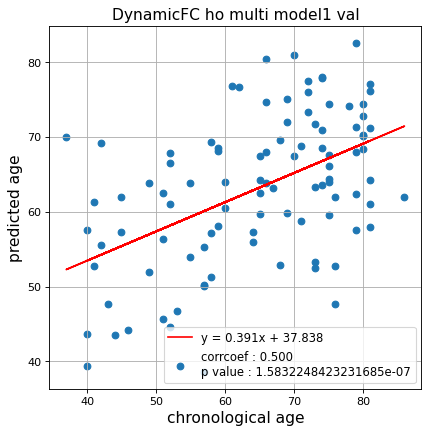

切片: 37.83751076013605
傾き: 0.3908758230651023
Nested Kfold ::: 5
Kfold: 1 ::: epoch: 100, loss: 0.15873897992647612, val loss: 0.5502794831991196
Kfold: 1 ::: epoch: 200, loss: 0.14339511440350458, val loss: 0.5232076644897461
Kfold: 1 ::: epoch: 300, loss: 0.13432986117326295, val loss: 0.512680172920227
Kfold: 1 ::: epoch: 400, loss: 0.1346219927072525, val loss: 0.5171591266989708
Kfold: 1 ::: epoch: 500, loss: 0.13008881302980277, val loss: 0.5172321200370789
Kfold: 1 ::: epoch: 600, loss: 0.12912714710602394, val loss: 0.5248413756489754
early stopping
save_epochs:493
best val loss:0.49999141693115234


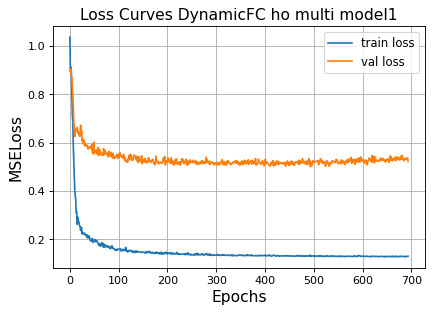

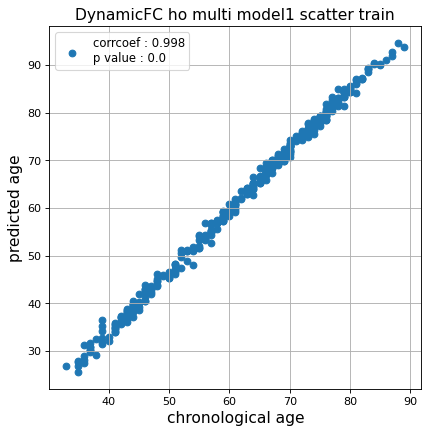

r^2 train data:  0.9190570640174175


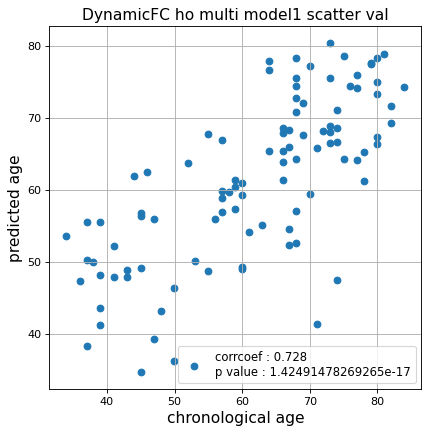

r^2 val data:  0.5190283628838003


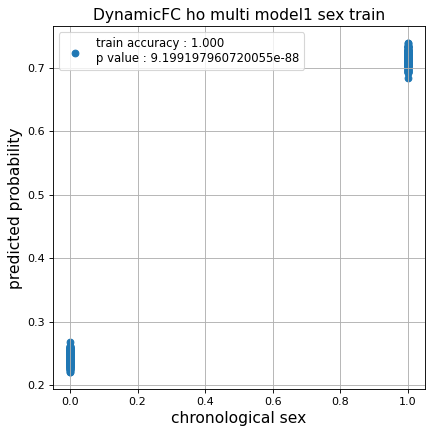

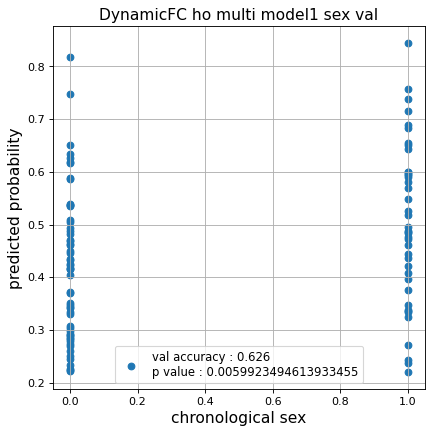

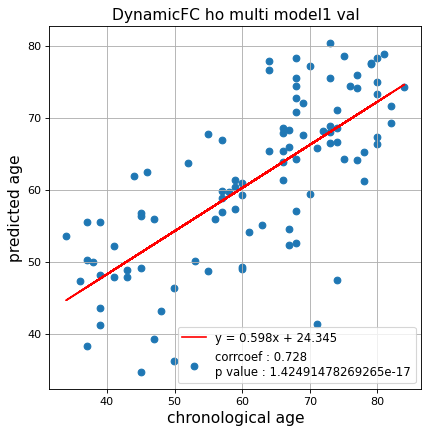

切片: 24.34507840027586
傾き: 0.5982614463111291
Kfold: 2 ::: epoch: 100, loss: 0.16818792315629813, val loss: 0.705551266670227
Kfold: 2 ::: epoch: 200, loss: 0.14311063862763918, val loss: 0.6364823281764984
Kfold: 2 ::: epoch: 300, loss: 0.1373036836202328, val loss: 0.6106683015823364
Kfold: 2 ::: epoch: 400, loss: 0.13111378596379206, val loss: 0.5876589380204678
Kfold: 2 ::: epoch: 500, loss: 0.13158007195362678, val loss: 0.5710787400603294
Kfold: 2 ::: epoch: 600, loss: 0.12851579143450811, val loss: 0.5514199584722519
Kfold: 2 ::: epoch: 700, loss: 0.12840213340062362, val loss: 0.5479465052485466
save_epochs:674
best val loss:0.5378958582878113


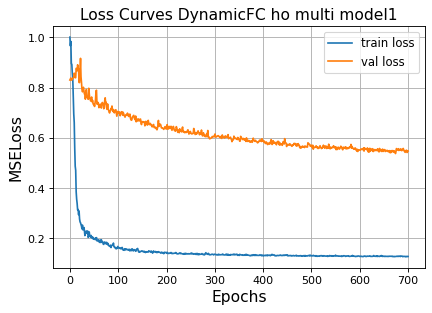

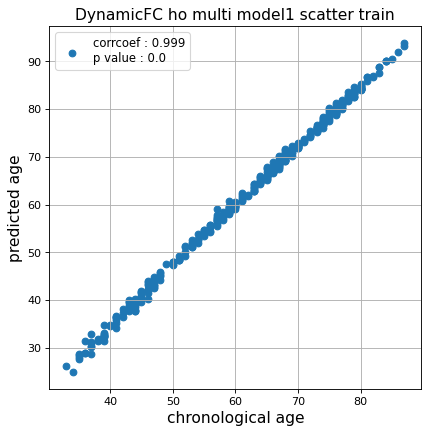

r^2 train data:  0.9320471024846321


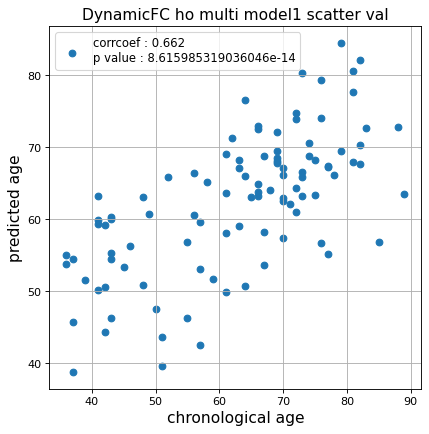

r^2 val data:  0.43735295081644354


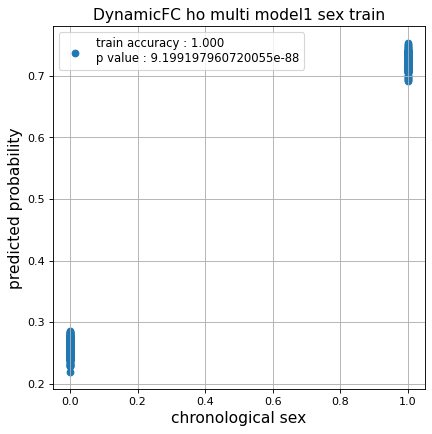

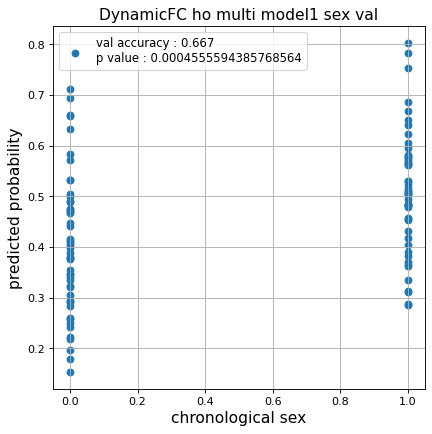

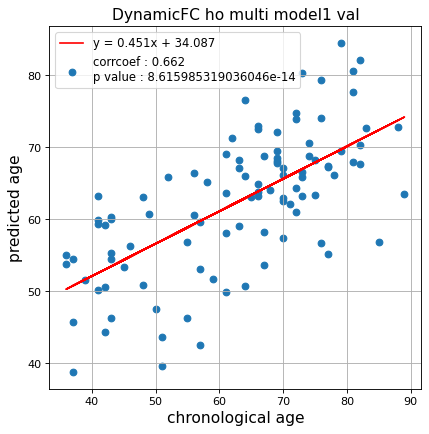

切片: 34.087004068279924
傾き: 0.45077904846695777
Kfold: 3 ::: epoch: 100, loss: 0.165124950500635, val loss: 0.7178188413381577
Kfold: 3 ::: epoch: 200, loss: 0.14422409236431122, val loss: 0.7357217371463776
Kfold: 3 ::: epoch: 300, loss: 0.13562094936004052, val loss: 0.8023758977651596
Kfold: 3 ::: epoch: 400, loss: 0.13175609478583702, val loss: 0.8326529413461685
early stopping
save_epochs:210
best val loss:0.7366796582937241


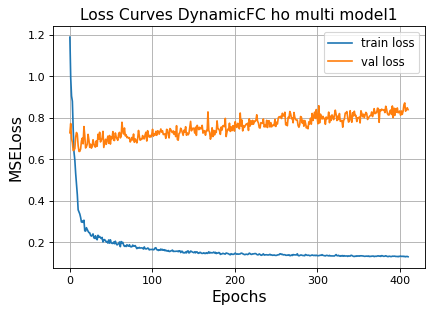

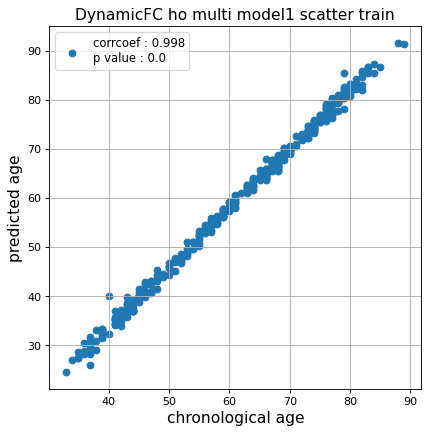

r^2 train data:  0.9361351443190771


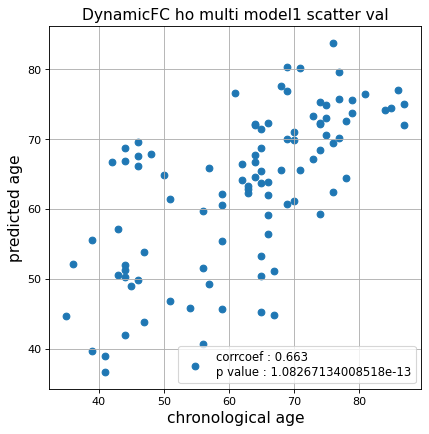

r^2 val data:  0.40391618881154046


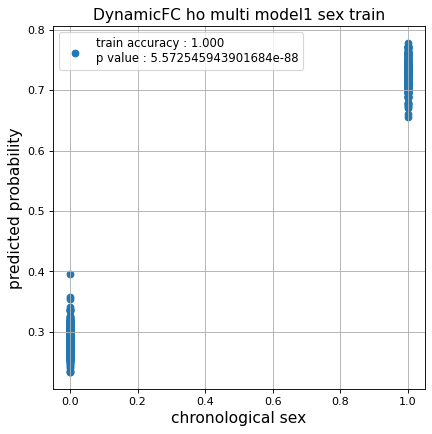

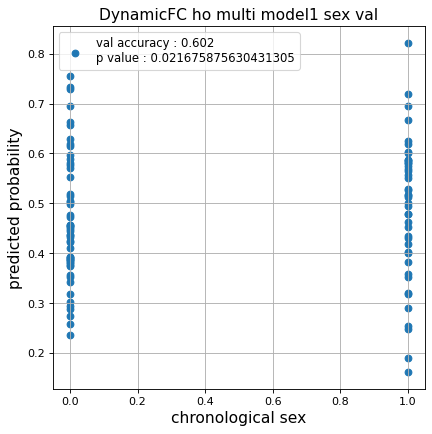

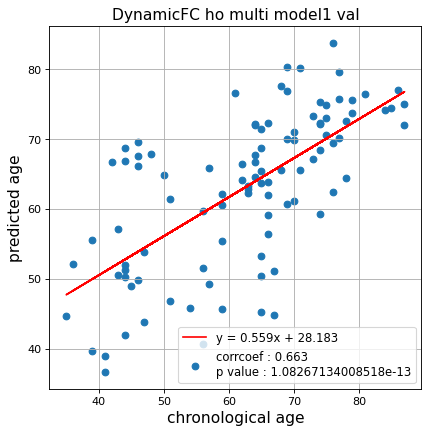

切片: 28.183200489804612
傾き: 0.5587919981717031
Kfold: 4 ::: epoch: 100, loss: 0.15478512300894812, val loss: 0.4702042043209076
Kfold: 4 ::: epoch: 200, loss: 0.14064553036139563, val loss: 0.49375615268945694
Kfold: 4 ::: epoch: 300, loss: 0.13344054038708025, val loss: 0.49685637652873993
Kfold: 4 ::: epoch: 400, loss: 0.13177872277223146, val loss: 0.5236366465687752
early stopping
save_epochs:215
best val loss:0.46383947134017944


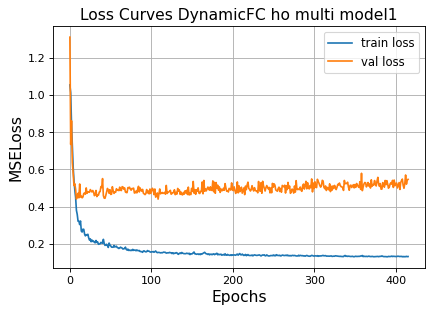

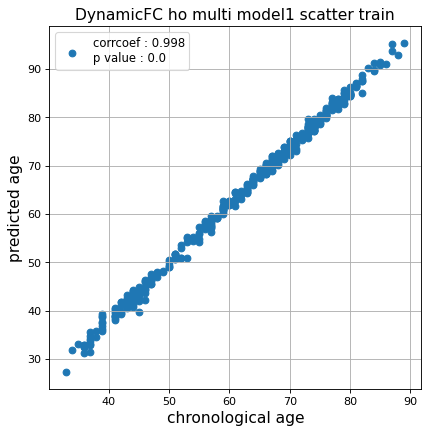

r^2 train data:  0.9317641902993966


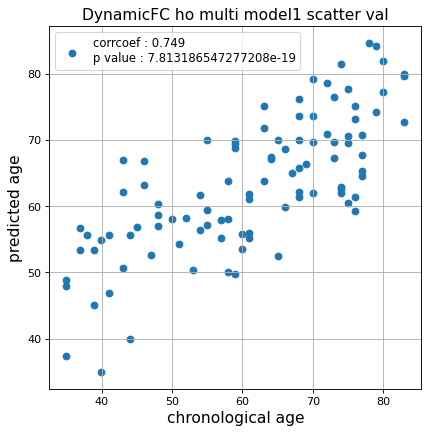

r^2 val data:  0.5353817116985319


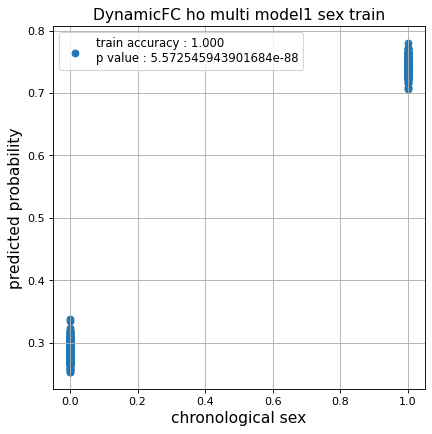

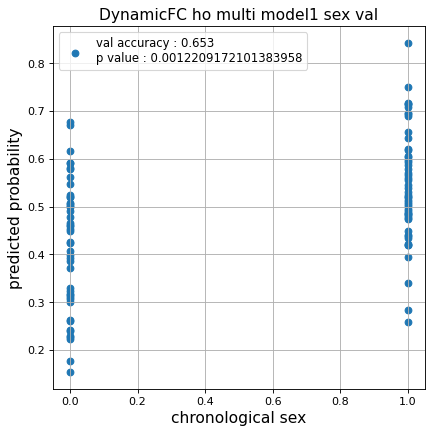

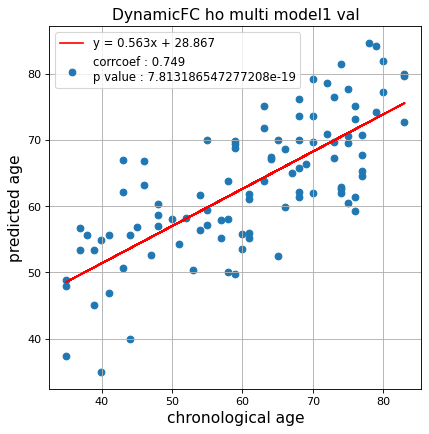

切片: 28.867195390590282
傾き: 0.5627086661159817
Kfold: 5 ::: epoch: 100, loss: 0.15807664279754347, val loss: 0.9586840271949768
Kfold: 5 ::: epoch: 200, loss: 0.13734798935743478, val loss: 0.8993914425373077
Kfold: 5 ::: epoch: 300, loss: 0.1347024956574807, val loss: 0.8947209641337395
Kfold: 5 ::: epoch: 400, loss: 0.1315853607196074, val loss: 0.8696888610720634
early stopping
save_epochs:227
best val loss:0.820252075791359


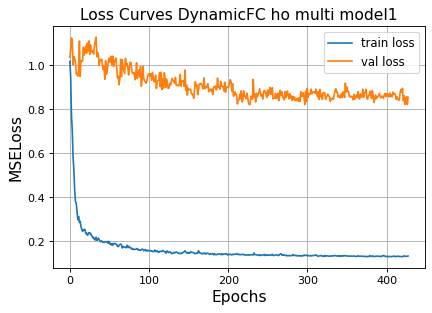

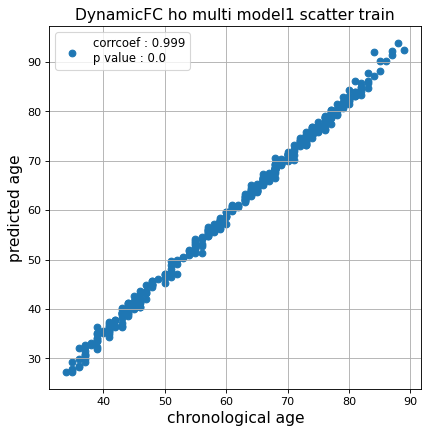

r^2 train data:  0.9535829478555911


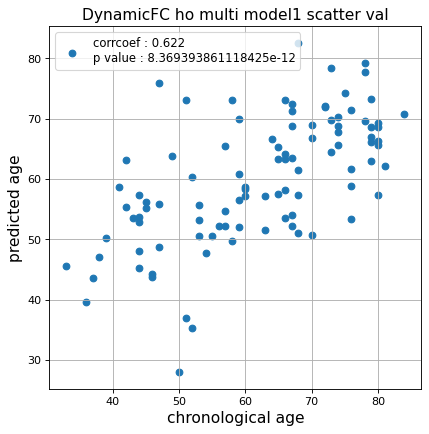

r^2 val data:  0.33817703276562294


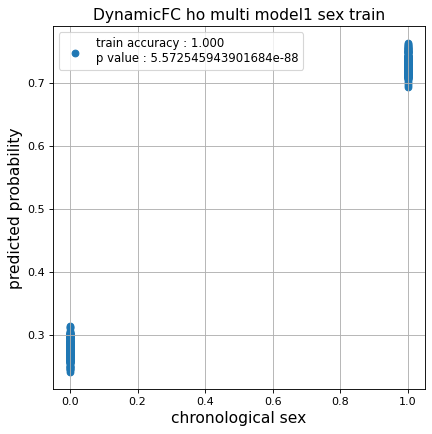

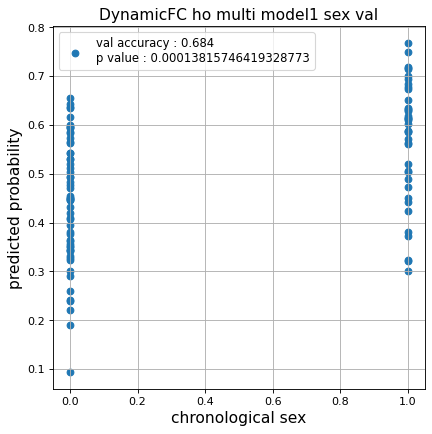

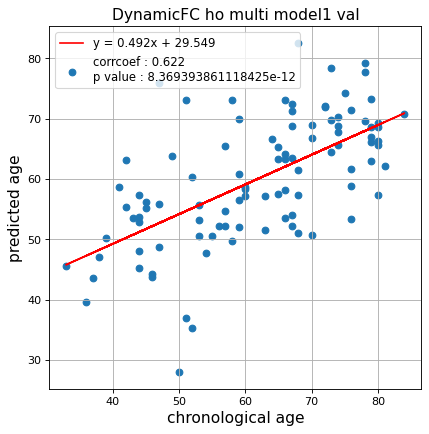

切片: 29.549093002493727
傾き: 0.492216432017029
CPU times: user 21h 54min 20s, sys: 1min 45s, total: 21h 56min 6s
Wall time: 3h 15min 47s


In [30]:
%%time
fold = KFold(n_splits=n_splits,shuffle=False)

test_pred_ho_dynamic_1  = []
test_pred_ho_dynamic_corrected_1  = []
test_label_ho_dynamic_1 = []
test_idx_ho_dynamic_1   = []

for fold_idx, (train_idx, test_idx) in enumerate(fold.split(data_ho)):
    print(f'Nested Kfold ::: {fold_idx+1}')
    test_pred,test_pred_corrected,test_label = train_model(data_dynamic_ho,
                                                           data_label,
                                                           train_idx  = train_idx,
                                                           test_idx   = test_idx,
                                                           epochs     = 700,
                                                           d_model    = 64,
                                                           n_splits   = n_splits,
                                                           hidden_dim = 256,
                                                           nhead      = 2,#4
                                                           hidden_dim_transformer = 1,#2
                                                           pos_drop   = 0.3,
                                                           trans_drop = 0.5,
                                                           fc_drop = 0.3,
                                                           title = 'DynamicFC ho multi model1'
                                                          )
    
    test_pred_ho_dynamic_1.append(test_pred)
    test_pred_ho_dynamic_corrected_1.append(test_pred_corrected)
    test_label_ho_dynamic_1.append(test_label)
    test_idx_ho_dynamic_1.append(test_idx)

### Dynamic FC 2

Nested Kfold ::: 1
Kfold: 1 ::: epoch: 100, loss: 0.17526874977808732, val loss: 0.5422233268618584
Kfold: 1 ::: epoch: 200, loss: 0.14635232320198646, val loss: 0.5071185082197189
Kfold: 1 ::: epoch: 300, loss: 0.13586697899378264, val loss: 0.5145118907094002
Kfold: 1 ::: epoch: 400, loss: 0.13218447795281044, val loss: 0.5048172399401665
early stopping
save_epochs:246
best val loss:0.4895881824195385


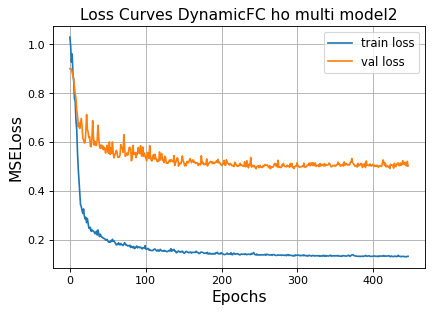

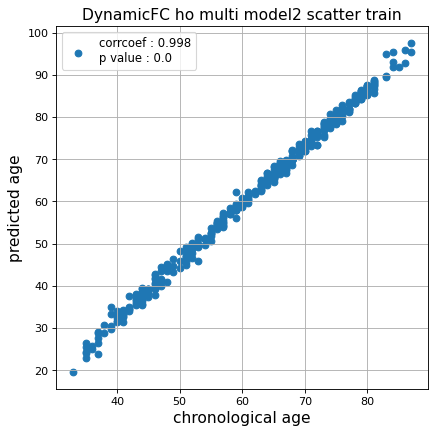

r^2 train data:  0.8608139103010776


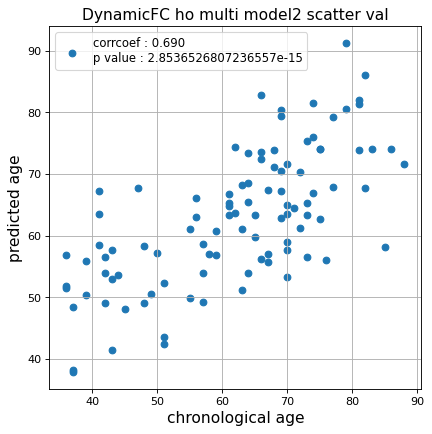

r^2 val data:  0.46033314807533043


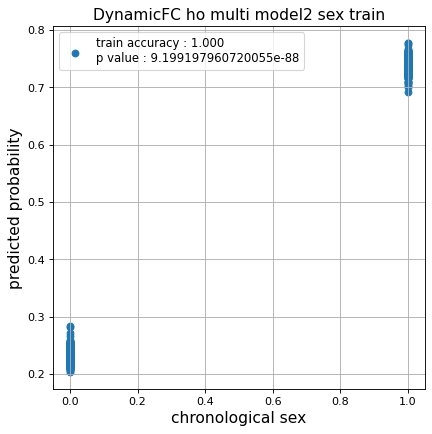

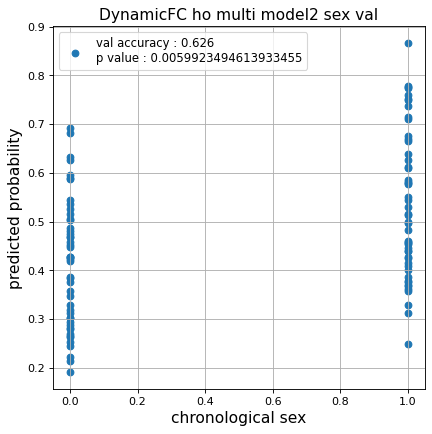

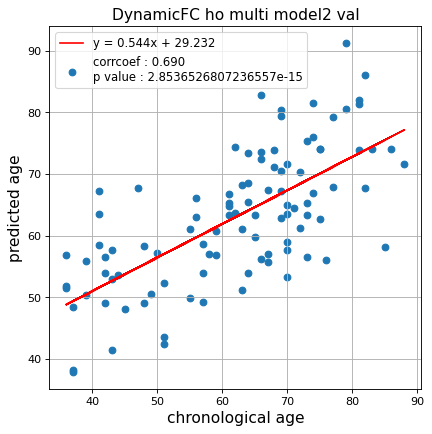

切片: 29.231830966056982
傾き: 0.5444881472345996
Kfold: 2 ::: epoch: 100, loss: 0.1619001283095433, val loss: 0.8631436228752136
Kfold: 2 ::: epoch: 200, loss: 0.1395440766444573, val loss: 0.8407260924577713
Kfold: 2 ::: epoch: 300, loss: 0.13405253680852744, val loss: 0.7863208800554276
Kfold: 2 ::: epoch: 400, loss: 0.13539508558236635, val loss: 0.801074668765068
Kfold: 2 ::: epoch: 500, loss: 0.130044345672314, val loss: 0.7447158396244049
Kfold: 2 ::: epoch: 600, loss: 0.1279557335835237, val loss: 0.7411055639386177
Kfold: 2 ::: epoch: 700, loss: 0.12738499962366545, val loss: 0.7310311868786812
save_epochs:689
best val loss:0.6949953734874725


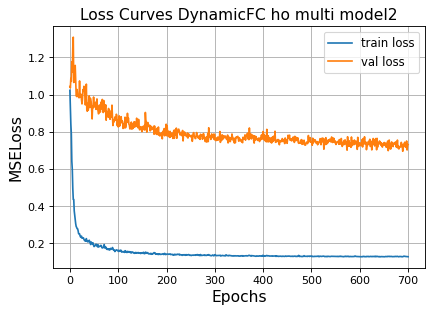

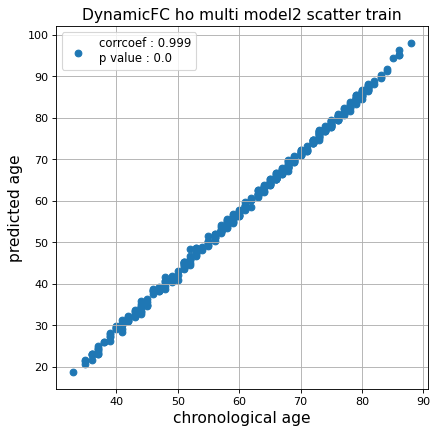

r^2 train data:  0.7972551862221952


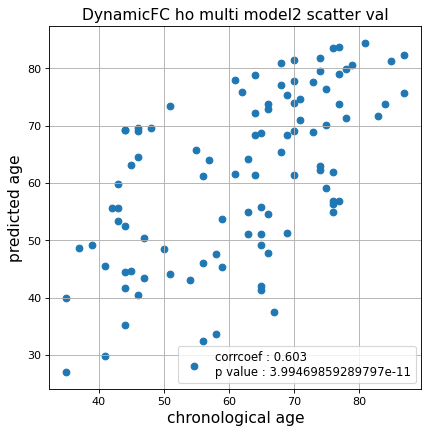

r^2 val data:  0.13978996909104557


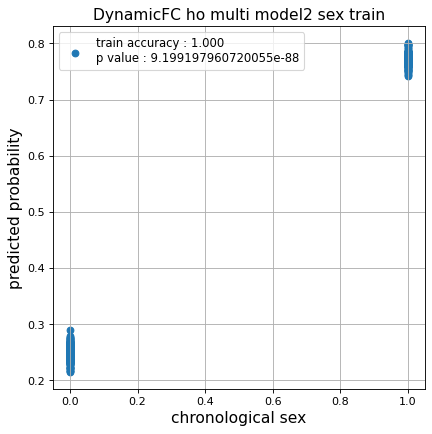

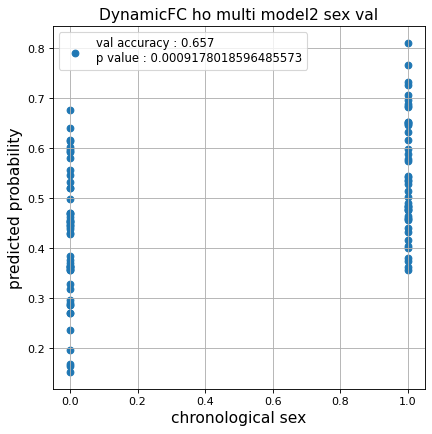

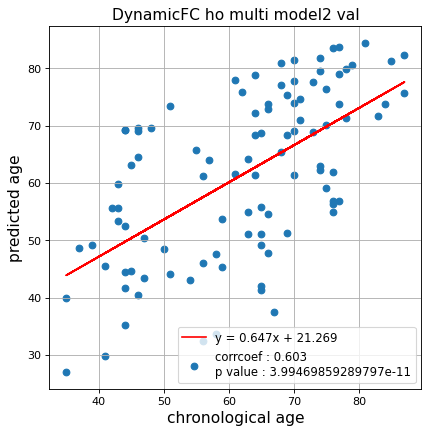

切片: 21.26889262702334
傾き: 0.6474070630602161
Kfold: 3 ::: epoch: 100, loss: 0.15414789204414076, val loss: 0.5304918140172958
Kfold: 3 ::: epoch: 200, loss: 0.1380414469883992, val loss: 0.47984158992767334
Kfold: 3 ::: epoch: 300, loss: 0.13292940534078157, val loss: 0.45630626380443573
Kfold: 3 ::: epoch: 400, loss: 0.13210208370135382, val loss: 0.4557995982468128
Kfold: 3 ::: epoch: 500, loss: 0.13051397525347197, val loss: 0.44561418518424034
Kfold: 3 ::: epoch: 600, loss: 0.1289852410554886, val loss: 0.4544064924120903
early stopping
save_epochs:459
best val loss:0.43790677189826965


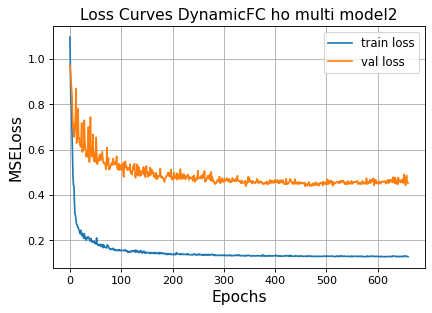

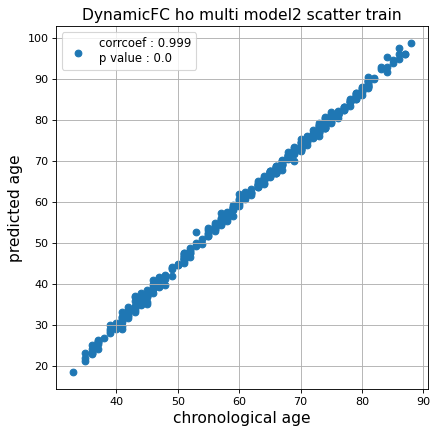

r^2 train data:  0.8052744032536955


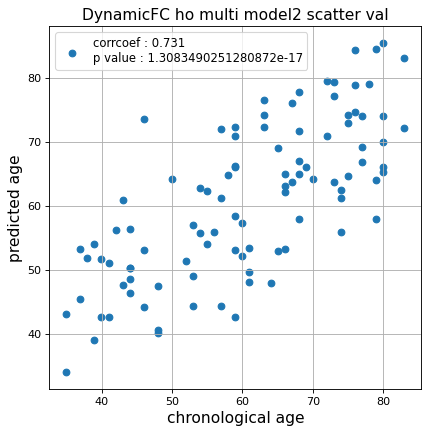

r^2 val data:  0.5082397626264479


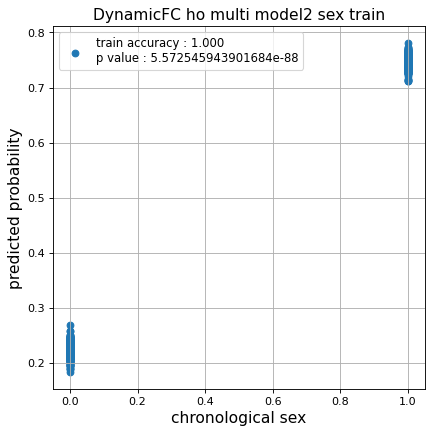

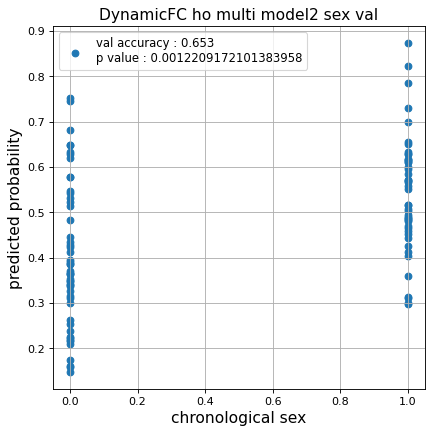

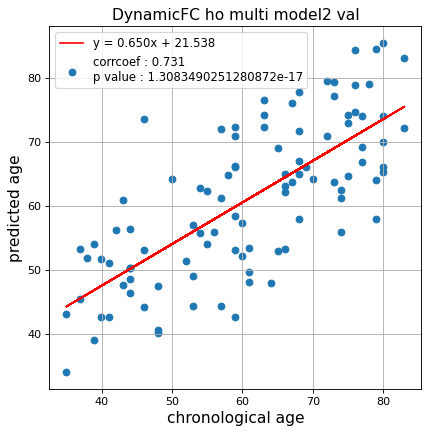

切片: 21.537632319194927
傾き: 0.6504155407243075
Kfold: 4 ::: epoch: 100, loss: 0.16204329752005064, val loss: 1.2506185173988342
Kfold: 4 ::: epoch: 200, loss: 0.13894281020531288, val loss: 1.2737583369016647
Kfold: 4 ::: epoch: 300, loss: 0.13420007549799406, val loss: 1.31516732275486
Kfold: 4 ::: epoch: 400, loss: 0.13052091690210196, val loss: 1.2085859179496765
Kfold: 4 ::: epoch: 500, loss: 0.129770061144462, val loss: 1.274338349699974
early stopping
save_epochs:394
best val loss:1.1485546231269836


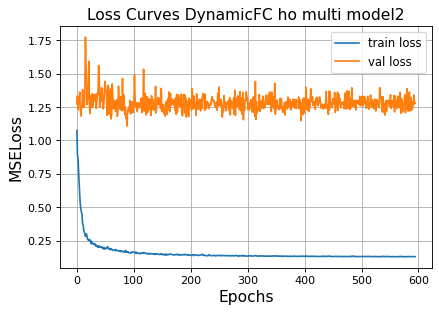

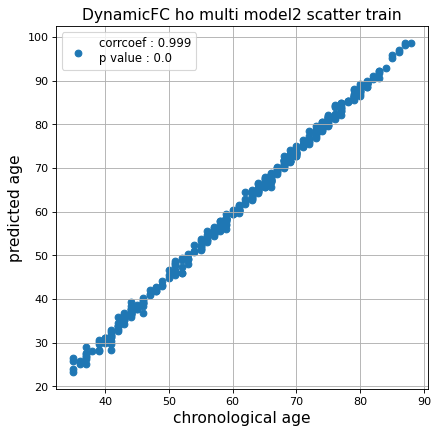

r^2 train data:  0.814128939446844


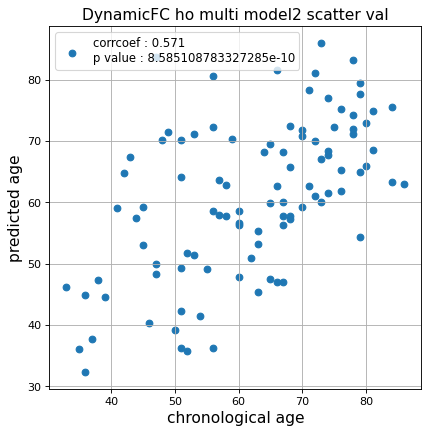

r^2 val data:  0.17728778981863402


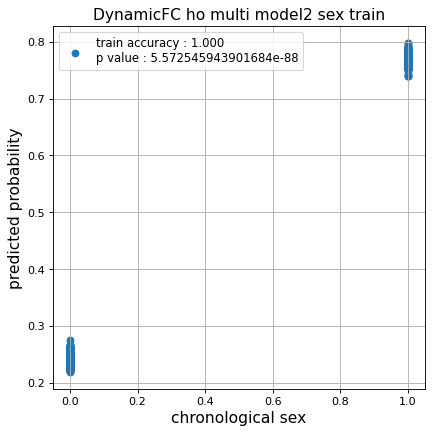

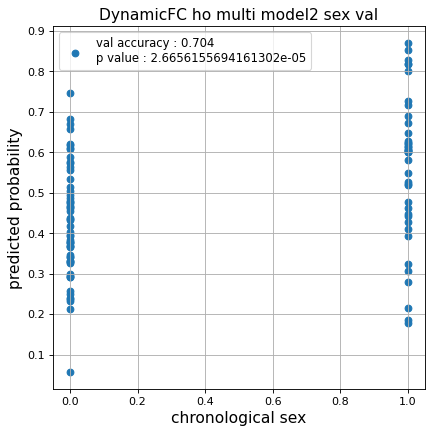

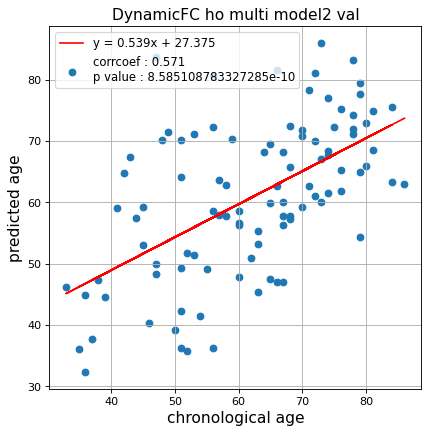

切片: 27.375270602328484
傾き: 0.5387070341656903
Kfold: 5 ::: epoch: 100, loss: 0.16747143750007337, val loss: 1.1729674935340881
Kfold: 5 ::: epoch: 200, loss: 0.14368707973223466, val loss: 1.0473710596561432
Kfold: 5 ::: epoch: 300, loss: 0.1360304825581037, val loss: 0.9670841097831726
Kfold: 5 ::: epoch: 400, loss: 0.13400225341320038, val loss: 1.0058136582374573
Kfold: 5 ::: epoch: 500, loss: 0.1305740888302143, val loss: 0.9629715234041214
Kfold: 5 ::: epoch: 600, loss: 0.13028675432388598, val loss: 0.9693096578121185
Kfold: 5 ::: epoch: 700, loss: 0.12758045013134295, val loss: 0.9041851758956909
save_epochs:667
best val loss:0.9032043516635895


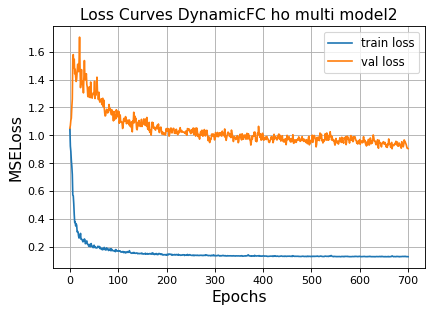

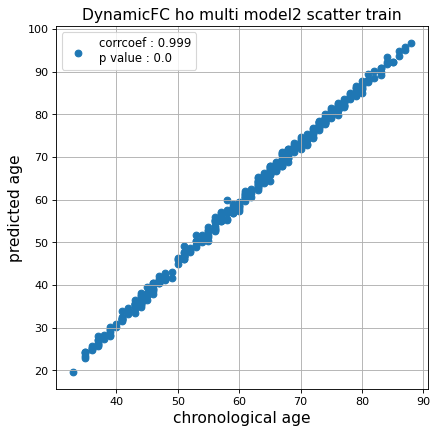

r^2 train data:  0.8368694085561038


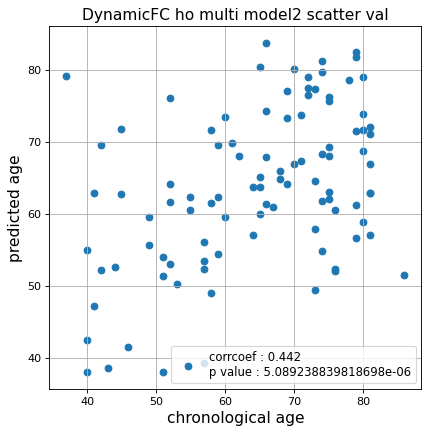

r^2 val data:  0.016664709296917546


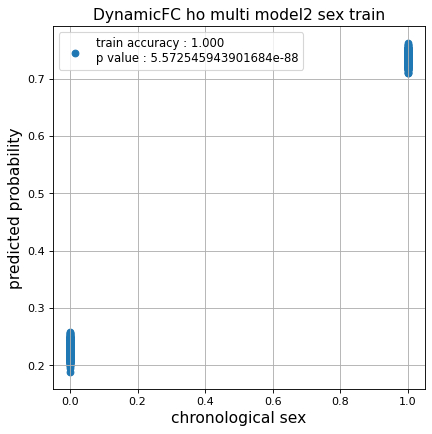

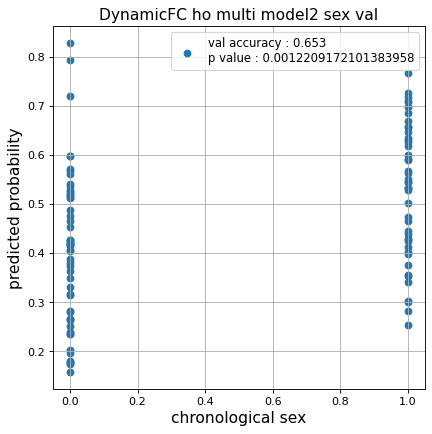

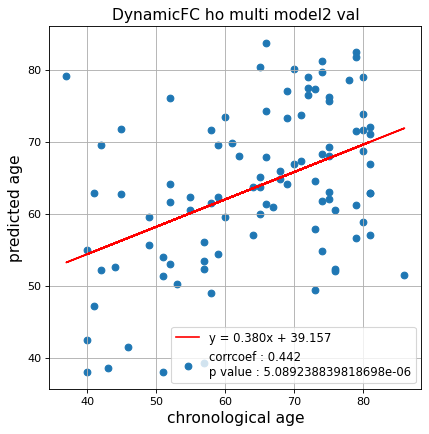

切片: 39.15731726865445
傾き: 0.380273864700507
Nested Kfold ::: 2
Kfold: 1 ::: epoch: 100, loss: 0.17691708986575788, val loss: 0.5581120550632477
Kfold: 1 ::: epoch: 200, loss: 0.14609746864208809, val loss: 0.49570491909980774
Kfold: 1 ::: epoch: 300, loss: 0.13563086207096392, val loss: 0.5562190338969231
Kfold: 1 ::: epoch: 400, loss: 0.13165437831328466, val loss: 0.4920727014541626
Kfold: 1 ::: epoch: 500, loss: 0.12931006115216476, val loss: 0.5129029676318169
Kfold: 1 ::: epoch: 600, loss: 0.12909285724163055, val loss: 0.48638108372688293
Kfold: 1 ::: epoch: 700, loss: 0.12838051754694718, val loss: 0.5104198083281517
save_epochs:514
best val loss:0.47533421218395233


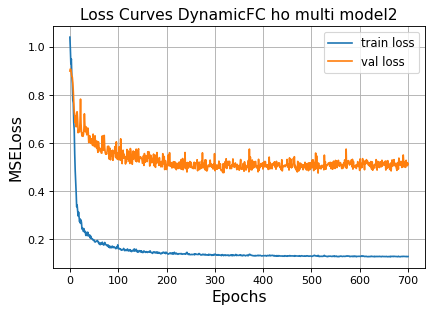

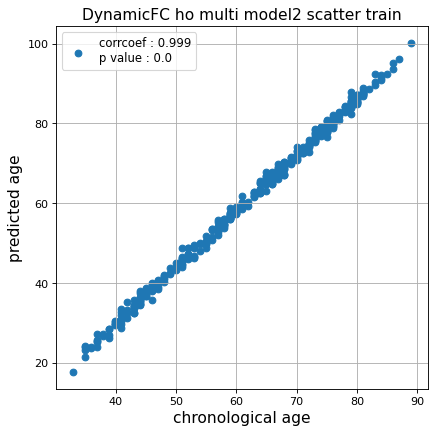

r^2 train data:  0.826291362093276


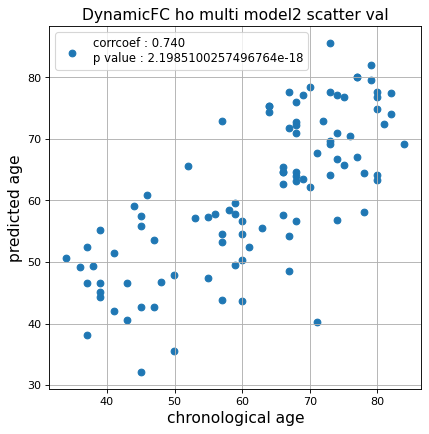

r^2 val data:  0.5171359612495918


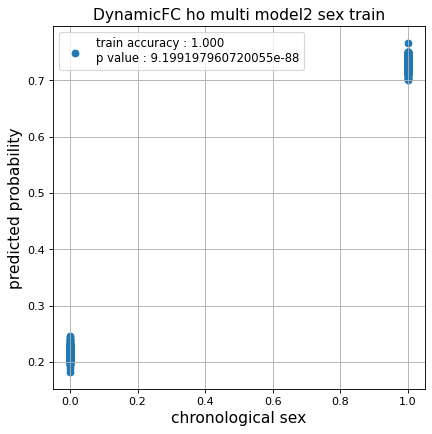

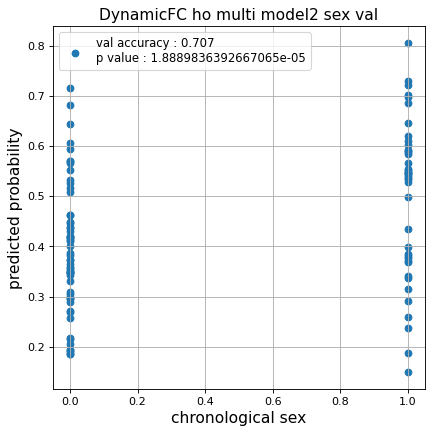

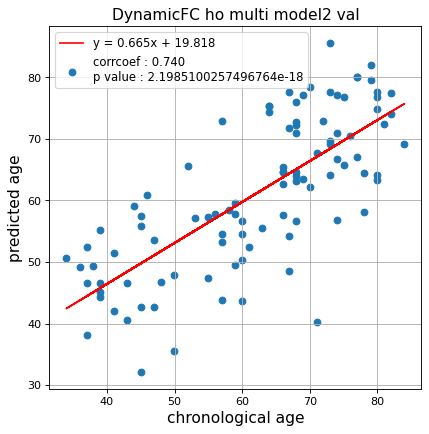

切片: 19.818235898991333
傾き: 0.6653855474670988
Kfold: 2 ::: epoch: 100, loss: 0.1725493692434751, val loss: 0.7401669770479202
Kfold: 2 ::: epoch: 200, loss: 0.14799496187613562, val loss: 0.7069969177246094
Kfold: 2 ::: epoch: 300, loss: 0.13854318513320044, val loss: 0.6913243383169174
Kfold: 2 ::: epoch: 400, loss: 0.13243646575854376, val loss: 0.6844049990177155
Kfold: 2 ::: epoch: 500, loss: 0.13224100493467772, val loss: 0.6837370842695236
early stopping
save_epochs:348
best val loss:0.6567684561014175


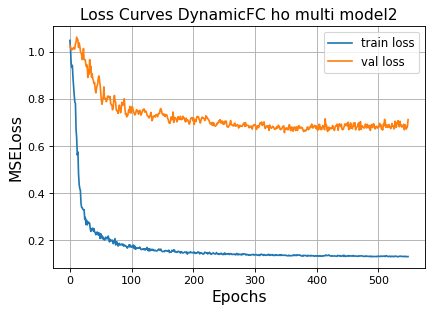

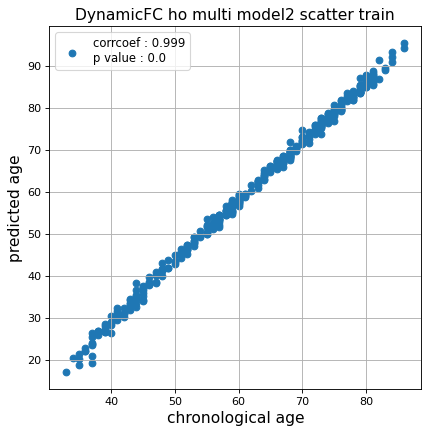

r^2 train data:  0.8056475438323911


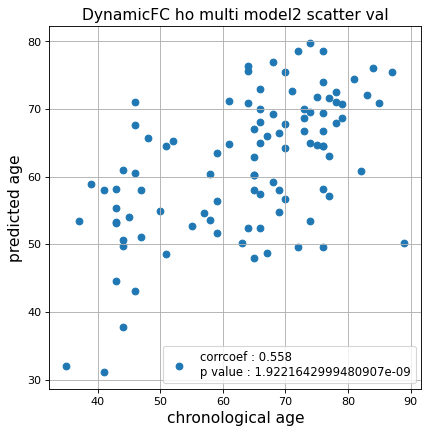

r^2 val data:  0.2499825661583055


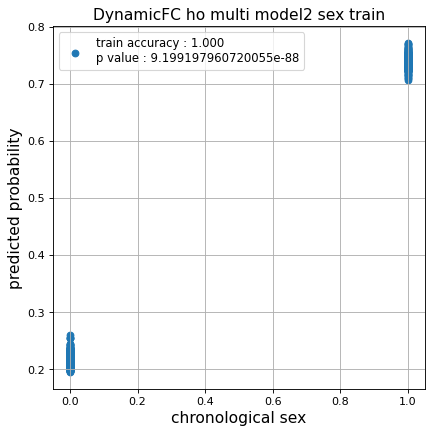

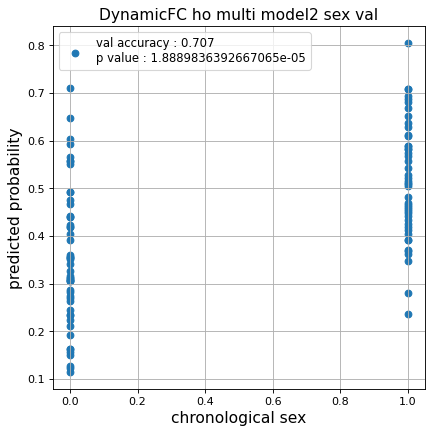

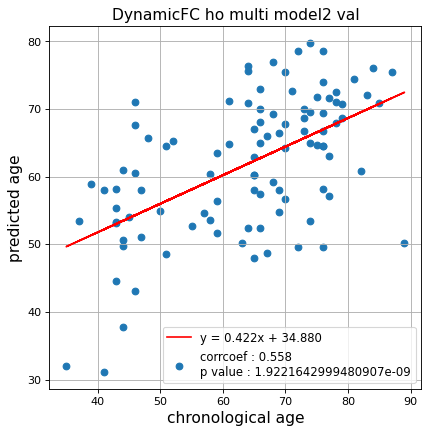

切片: 34.88042951487444
傾き: 0.4219981538511944
Kfold: 3 ::: epoch: 100, loss: 0.16201479274492997, val loss: 0.5559754967689514
Kfold: 3 ::: epoch: 200, loss: 0.14154906570911407, val loss: 0.5630124434828758
Kfold: 3 ::: epoch: 300, loss: 0.1334847498398561, val loss: 0.5210578069090843
Kfold: 3 ::: epoch: 400, loss: 0.13270703531228578, val loss: 0.5088250264525414
Kfold: 3 ::: epoch: 500, loss: 0.1286419887955372, val loss: 0.5231752023100853
Kfold: 3 ::: epoch: 600, loss: 0.1276047585102228, val loss: 0.5070618167519569
early stopping
save_epochs:412
best val loss:0.4876775033771992


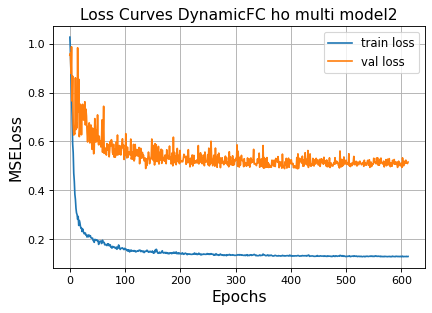

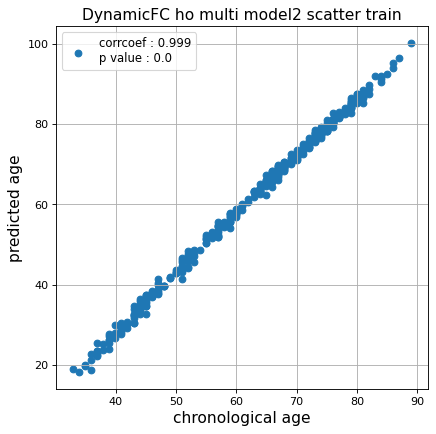

r^2 train data:  0.7798003230852322


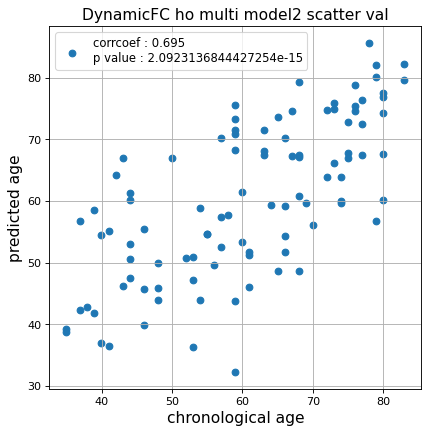

r^2 val data:  0.4233369469733589


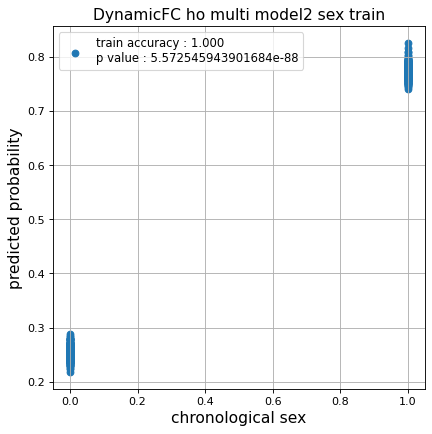

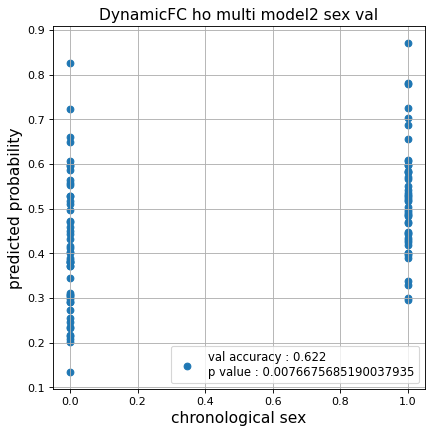

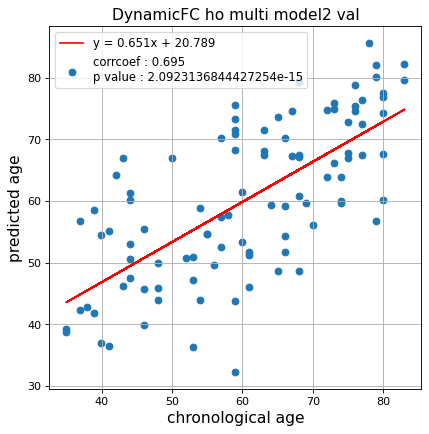

切片: 20.78906424311146
傾き: 0.6510582564548872
Kfold: 4 ::: epoch: 100, loss: 0.1677084737099134, val loss: 1.0494361370801926
Kfold: 4 ::: epoch: 200, loss: 0.1394179772872191, val loss: 1.0975060313940048
Kfold: 4 ::: epoch: 300, loss: 0.13462009452856505, val loss: 1.0965250432491302
Kfold: 4 ::: epoch: 400, loss: 0.13099035964562342, val loss: 1.034044772386551
early stopping
save_epochs:210
best val loss:0.9796565920114517


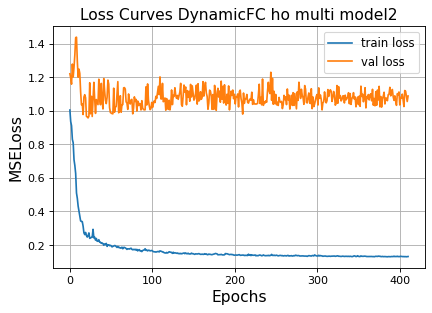

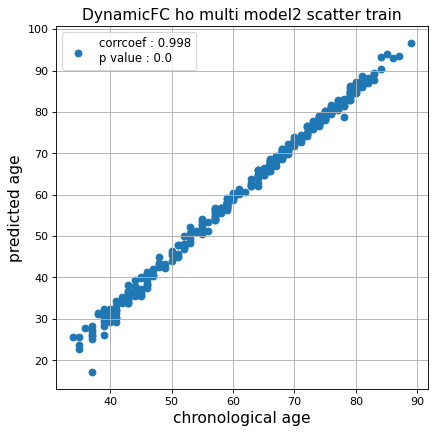

r^2 train data:  0.8603568364547062


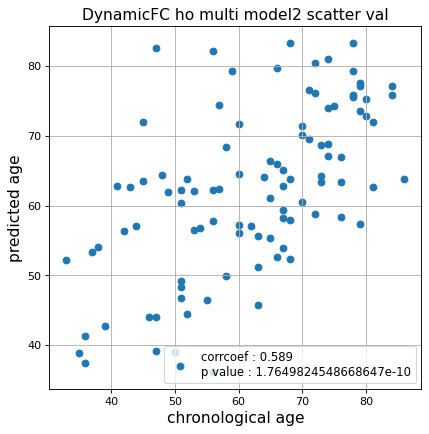

r^2 val data:  0.26004645292947515


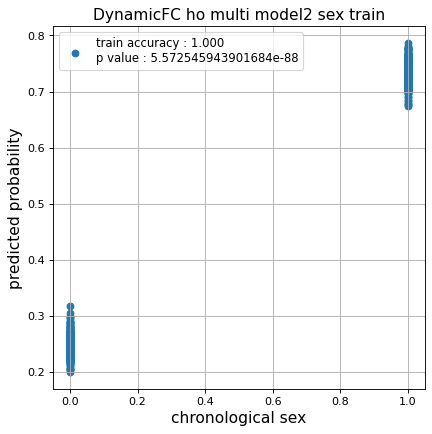

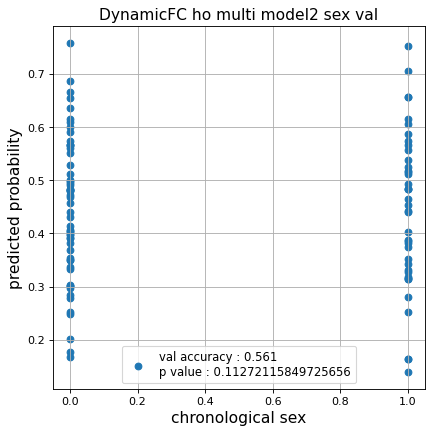

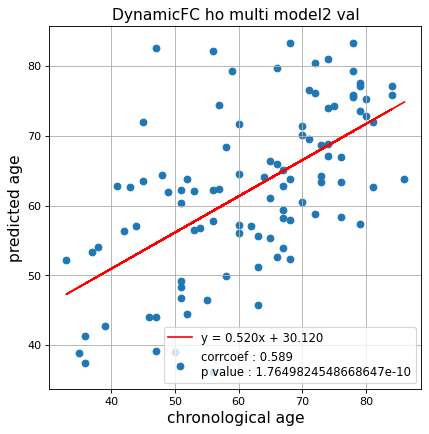

切片: 30.119721344303123
傾き: 0.5200741173092996
Kfold: 5 ::: epoch: 100, loss: 0.16906035978060502, val loss: 0.740140289068222
Kfold: 5 ::: epoch: 200, loss: 0.1406590984417842, val loss: 0.7418725341558456
Kfold: 5 ::: epoch: 300, loss: 0.13447558306730711, val loss: 0.7591920495033264
Kfold: 5 ::: epoch: 400, loss: 0.13155335531784937, val loss: 0.781020924448967
early stopping
save_epochs:244
best val loss:0.7201202660799026


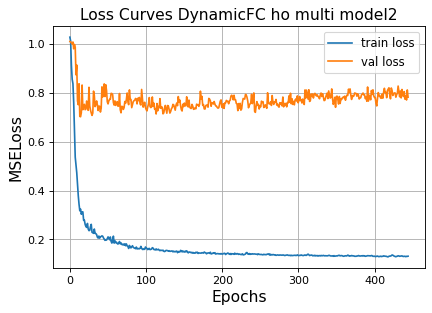

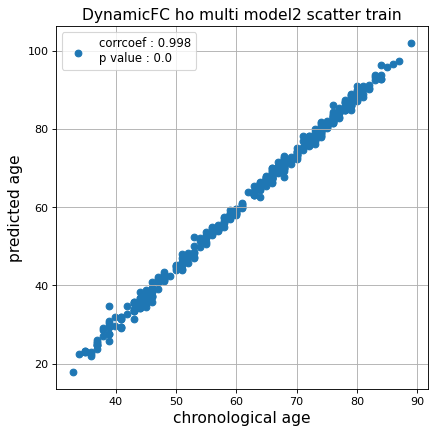

r^2 train data:  0.776965881902676


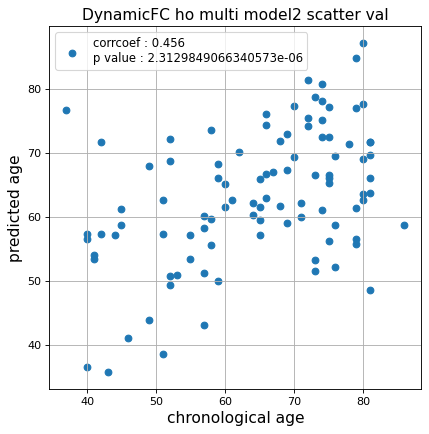

r^2 val data:  0.066878717733444


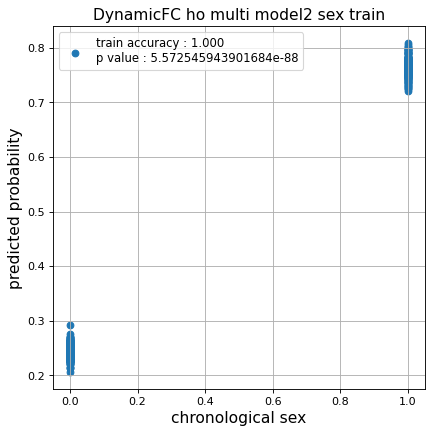

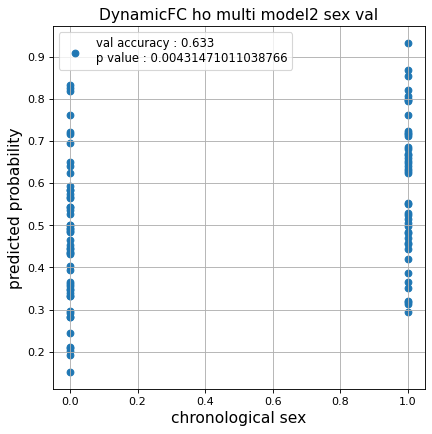

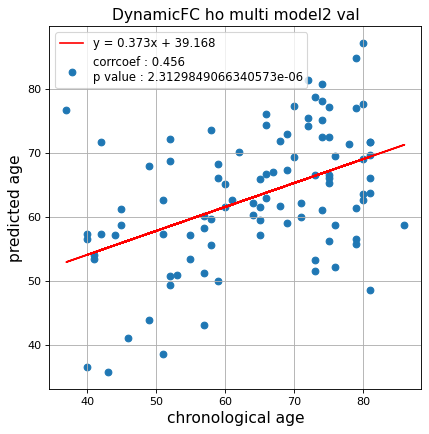

切片: 39.16811616285179
傾き: 0.372811623436493
Nested Kfold ::: 3
Kfold: 1 ::: epoch: 100, loss: 0.17470615414472726, val loss: 0.6728166341781616
Kfold: 1 ::: epoch: 200, loss: 0.1495227412535594, val loss: 0.6178592815995216
Kfold: 1 ::: epoch: 300, loss: 0.13459501472803262, val loss: 0.6271416023373604
Kfold: 1 ::: epoch: 400, loss: 0.13261530032524696, val loss: 0.6103135719895363
Kfold: 1 ::: epoch: 500, loss: 0.1299621474284392, val loss: 0.6342850998044014
early stopping
save_epochs:350
best val loss:0.581945613026619


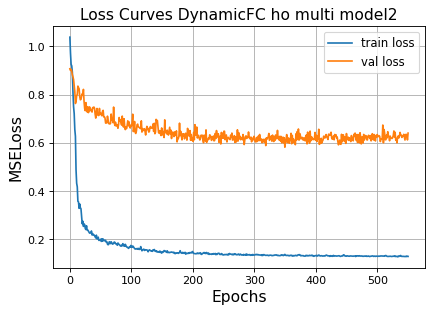

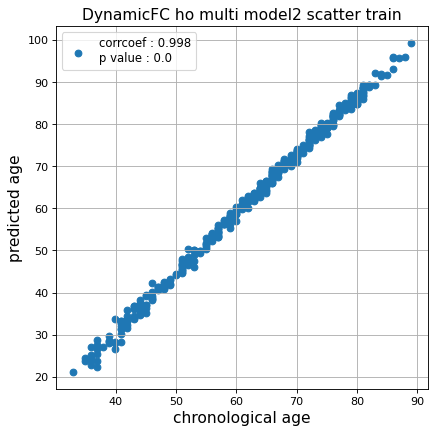

r^2 train data:  0.8283857755678572


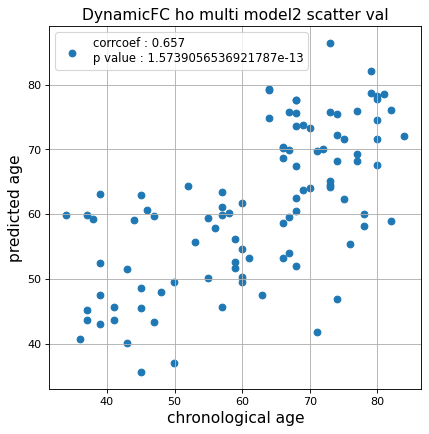

r^2 val data:  0.38769986624698405


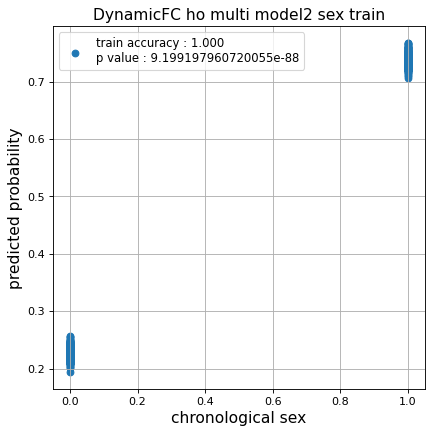

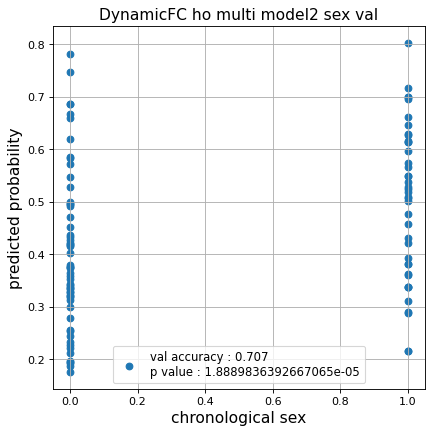

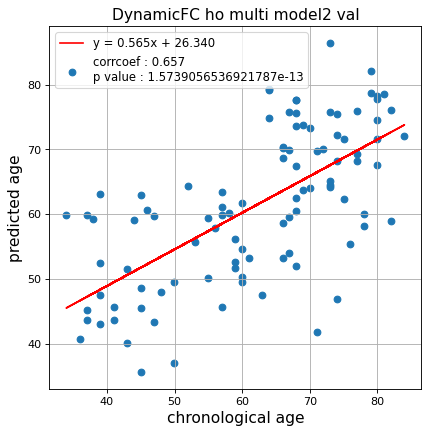

切片: 26.33960353565695
傾き: 0.5646761497745283
Kfold: 2 ::: epoch: 100, loss: 0.18026968836784363, val loss: 0.6608737111091614
Kfold: 2 ::: epoch: 200, loss: 0.1399452628997656, val loss: 0.6227768063545227
Kfold: 2 ::: epoch: 300, loss: 0.13553284681760347, val loss: 0.6243013441562653
Kfold: 2 ::: epoch: 400, loss: 0.13094987433690292, val loss: 0.6228266879916191
early stopping
save_epochs:286
best val loss:0.6023757085204124


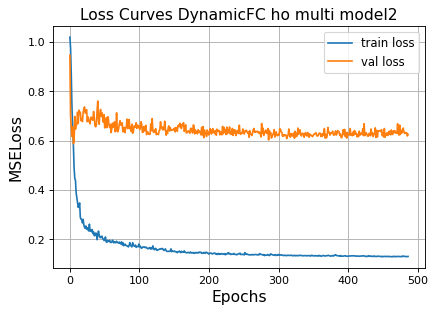

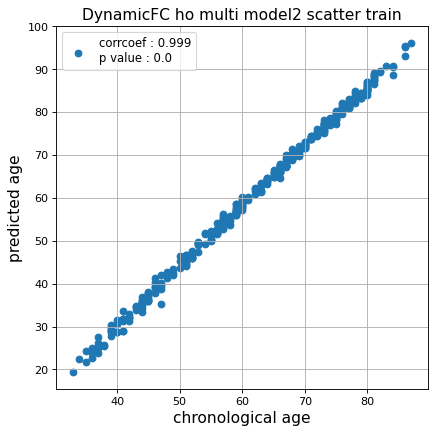

r^2 train data:  0.8298730414328631


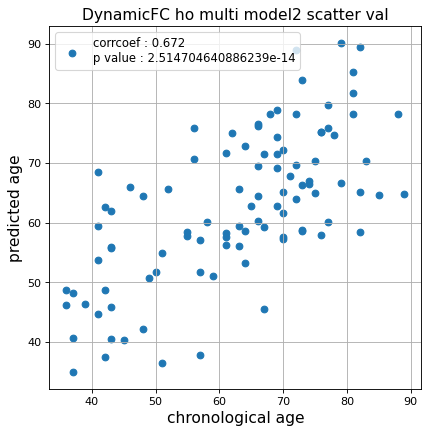

r^2 val data:  0.4068392983208763


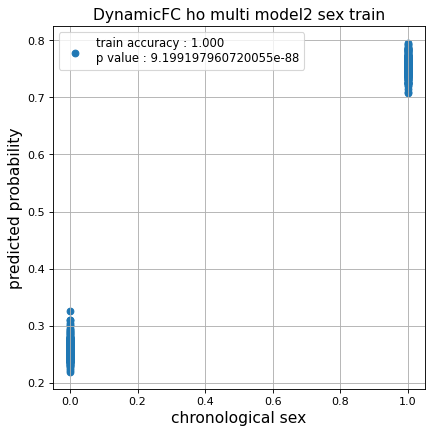

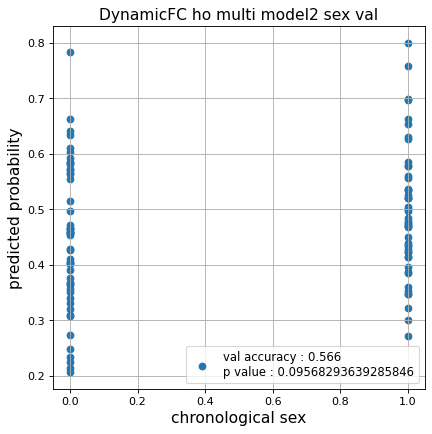

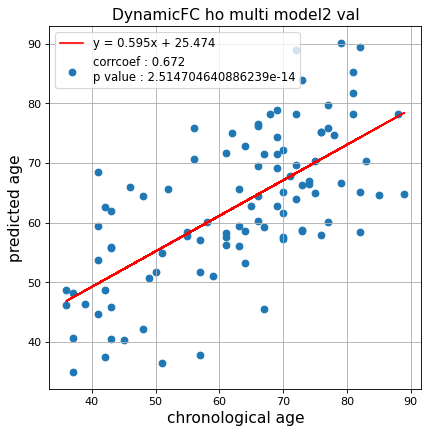

切片: 25.474093527226167
傾き: 0.5951251123078849
Kfold: 3 ::: epoch: 100, loss: 0.15762372429554278, val loss: 0.6608838737010956
Kfold: 3 ::: epoch: 200, loss: 0.14340043526429397, val loss: 0.6544295102357864
Kfold: 3 ::: epoch: 300, loss: 0.13283477952847114, val loss: 0.6744231581687927
Kfold: 3 ::: epoch: 400, loss: 0.13069955087625063, val loss: 0.6815326660871506
early stopping
save_epochs:281
best val loss:0.6210628226399422


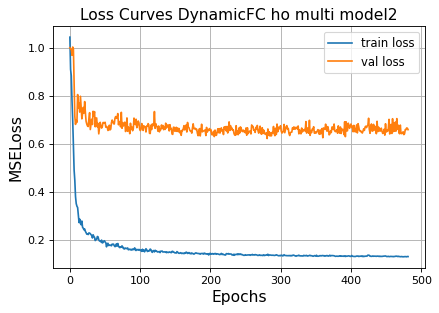

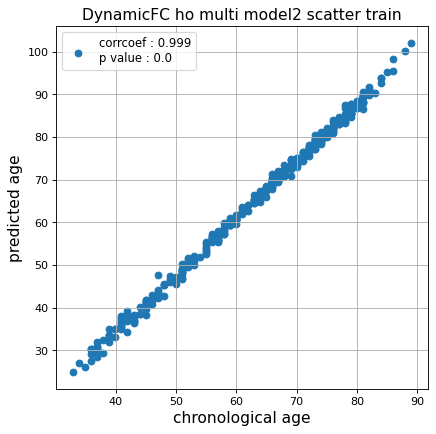

r^2 train data:  0.8580856039443698


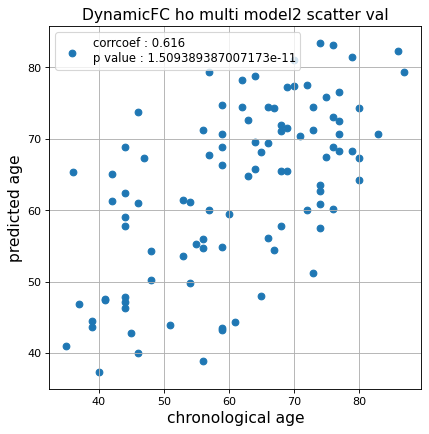

r^2 val data:  0.2829872629820023


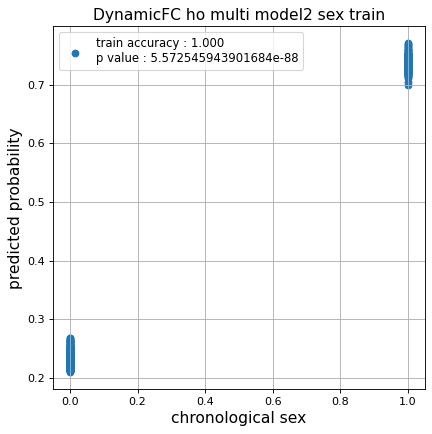

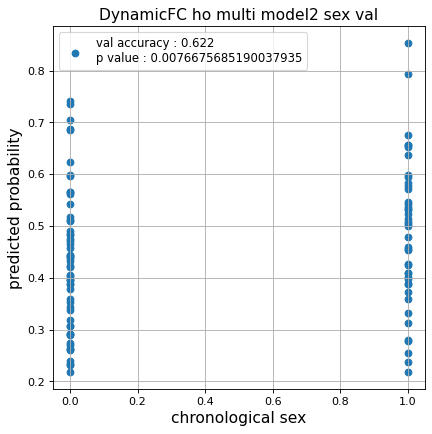

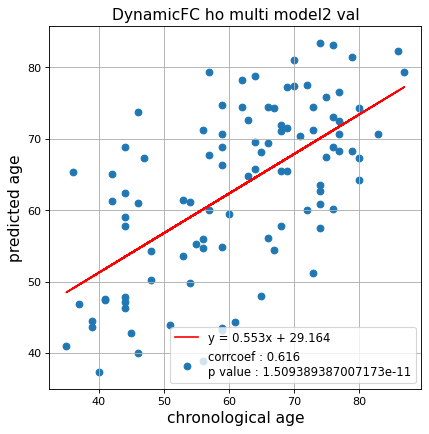

切片: 29.16414633669804
傾き: 0.5527266342924884
Kfold: 4 ::: epoch: 100, loss: 0.15789602926144233, val loss: 0.9937883168458939
Kfold: 4 ::: epoch: 200, loss: 0.1409765470486421, val loss: 1.0464360266923904
Kfold: 4 ::: epoch: 300, loss: 0.13566604485878578, val loss: 1.048124335706234
Kfold: 4 ::: epoch: 400, loss: 0.13410601249107948, val loss: 1.0194938108325005
early stopping
save_epochs:288
best val loss:0.9751058965921402


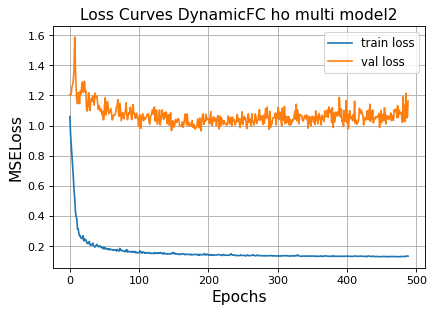

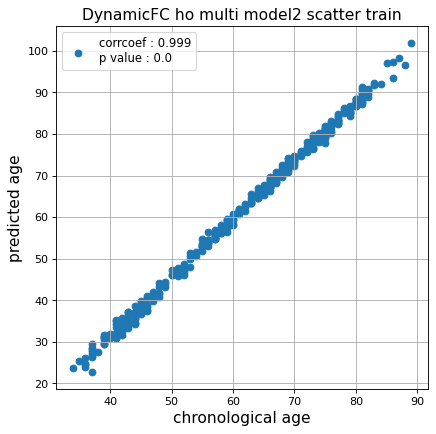

r^2 train data:  0.8252464975913043


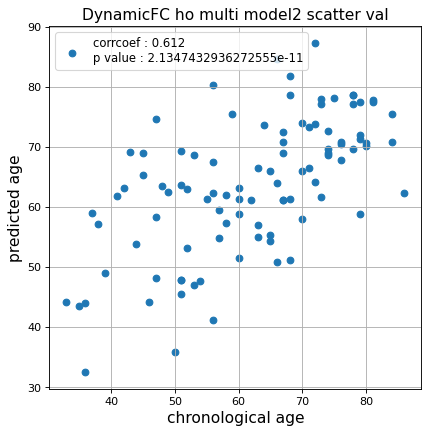

r^2 val data:  0.3065110121068163


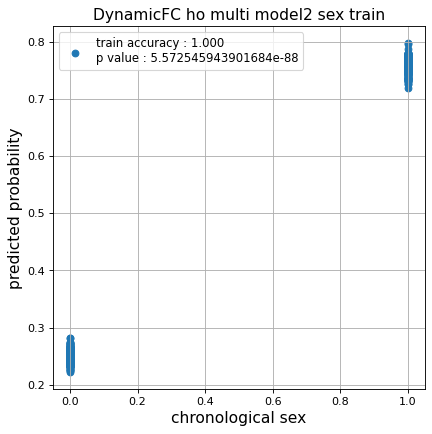

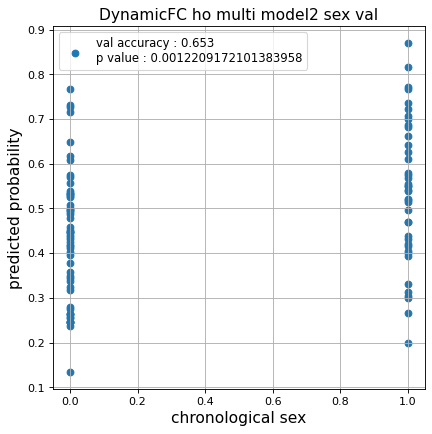

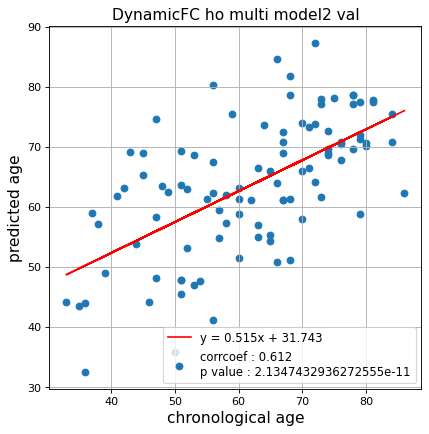

切片: 31.74251659079834
傾き: 0.5150774961294086
Kfold: 5 ::: epoch: 100, loss: 0.17675013267076933, val loss: 0.8231415003538132
Kfold: 5 ::: epoch: 200, loss: 0.14580117051418012, val loss: 0.8161743879318237
Kfold: 5 ::: epoch: 300, loss: 0.13750798312517312, val loss: 0.8044605553150177
Kfold: 5 ::: epoch: 400, loss: 0.1334588722540782, val loss: 0.8280078023672104
early stopping
save_epochs:261
best val loss:0.78835828602314


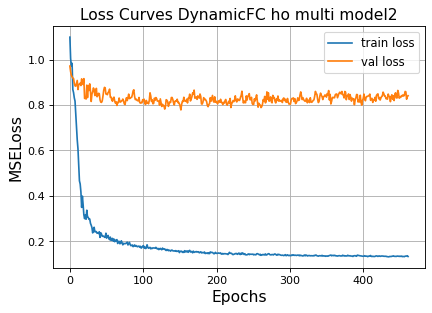

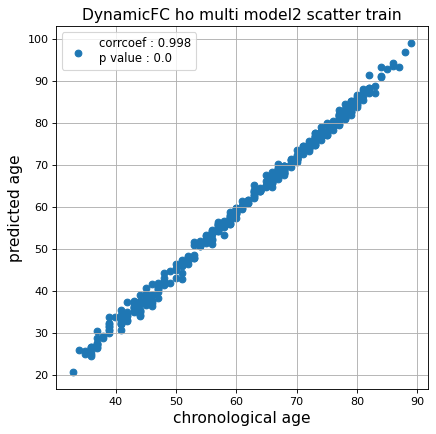

r^2 train data:  0.8739705948503355


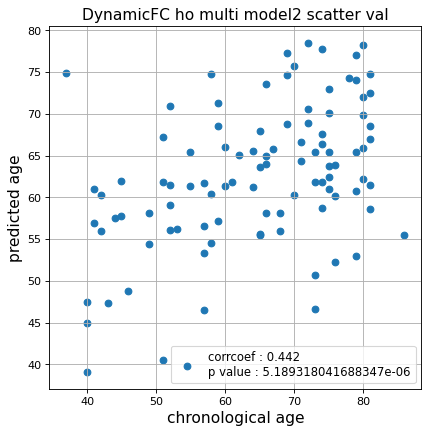

r^2 val data:  0.12272634915618508


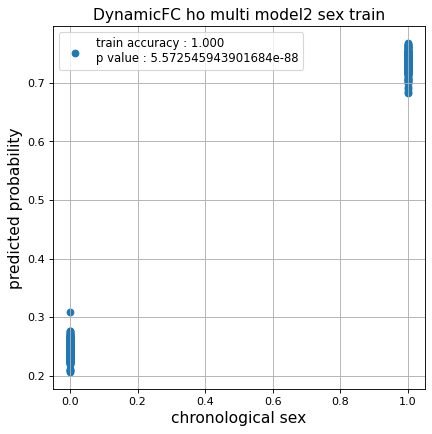

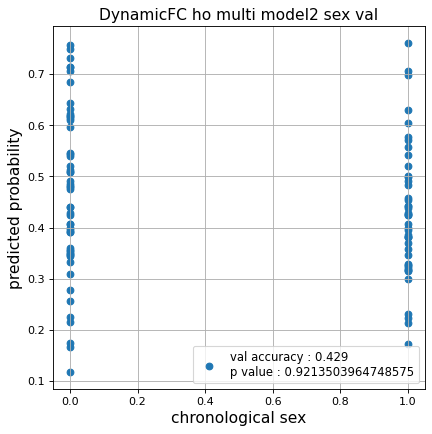

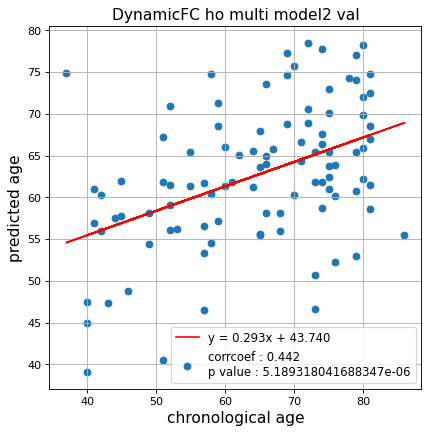

切片: 43.740010207950235
傾き: 0.292707154816425
Nested Kfold ::: 4
Kfold: 1 ::: epoch: 100, loss: 0.1665454231775724, val loss: 0.5974327623844147
Kfold: 1 ::: epoch: 200, loss: 0.1442701552922909, val loss: 0.5675087869167328
Kfold: 1 ::: epoch: 300, loss: 0.13575124167479002, val loss: 0.5604369342327118
Kfold: 1 ::: epoch: 400, loss: 0.13265769183635712, val loss: 0.5363288968801498
Kfold: 1 ::: epoch: 500, loss: 0.12896504998207092, val loss: 0.5475246831774712
Kfold: 1 ::: epoch: 600, loss: 0.12864189881544846, val loss: 0.5252747982740402
Kfold: 1 ::: epoch: 700, loss: 0.129395448244535, val loss: 0.5642929971218109
save_epochs:654
best val loss:0.51030682772398


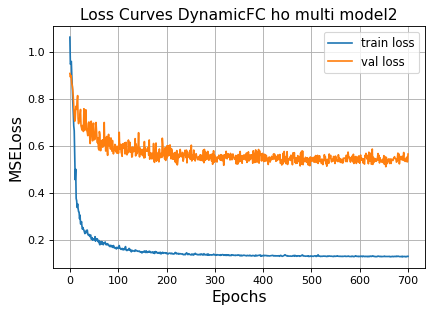

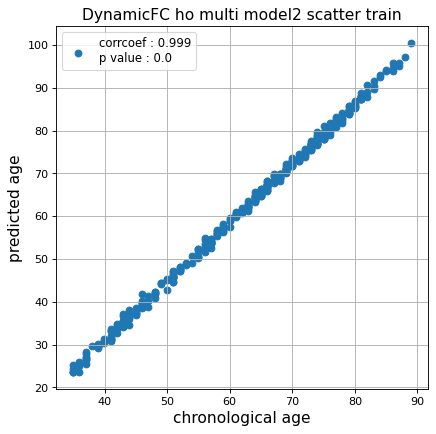

r^2 train data:  0.85173847597553


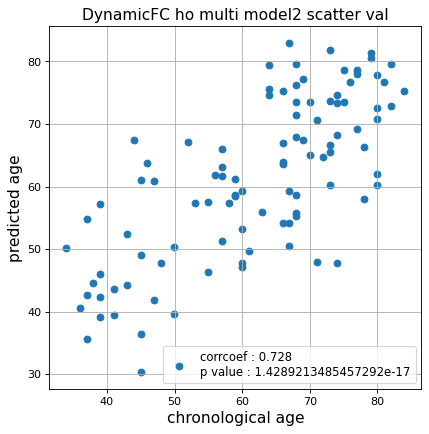

r^2 val data:  0.48438103698088786


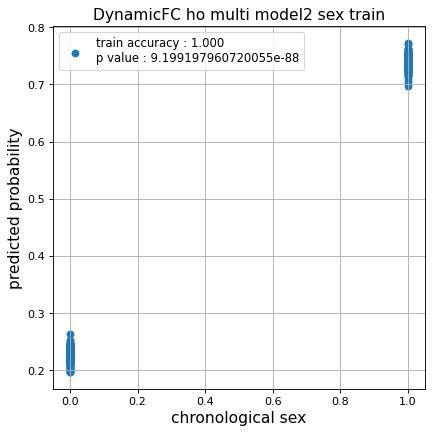

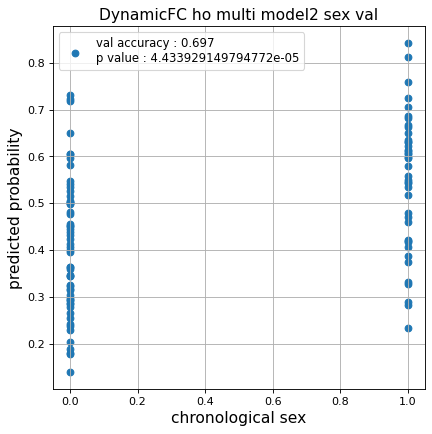

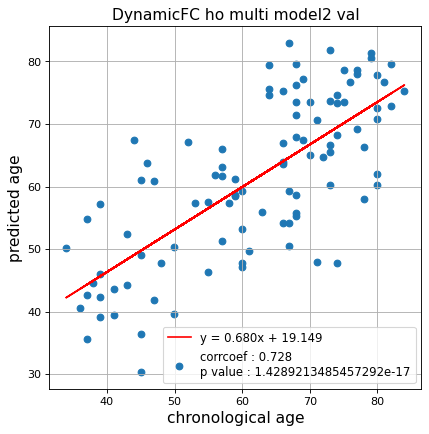

切片: 19.148824470832785
傾き: 0.6795096086344316
Kfold: 2 ::: epoch: 100, loss: 0.17150685878900382, val loss: 0.8443907797336578
Kfold: 2 ::: epoch: 200, loss: 0.14823051943228796, val loss: 0.7066803723573685
Kfold: 2 ::: epoch: 300, loss: 0.1400411186309961, val loss: 0.6761825382709503
Kfold: 2 ::: epoch: 400, loss: 0.13324130097260842, val loss: 0.6584608107805252
Kfold: 2 ::: epoch: 500, loss: 0.1334890092794712, val loss: 0.6095022857189178
Kfold: 2 ::: epoch: 600, loss: 0.12983688024374154, val loss: 0.6102039143443108
Kfold: 2 ::: epoch: 700, loss: 0.12930009686029875, val loss: 0.6089638471603394
save_epochs:682
best val loss:0.5798105672001839


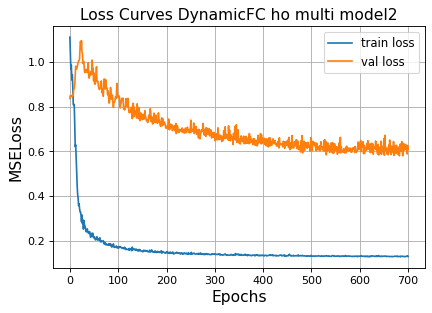

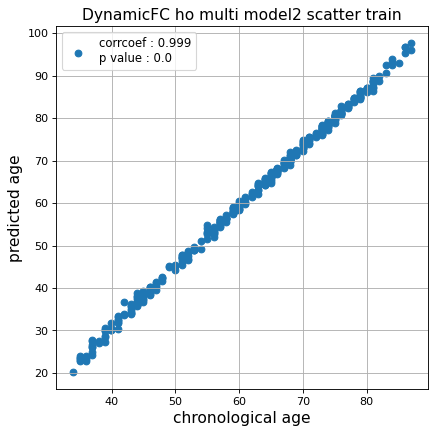

r^2 train data:  0.8307318870600131


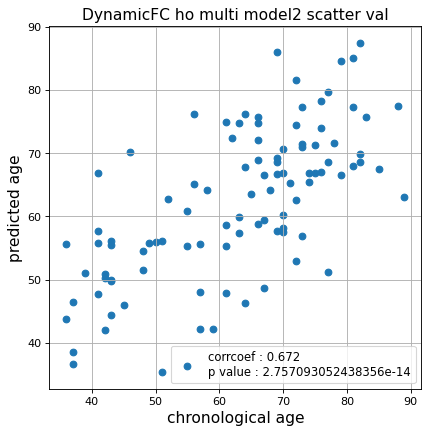

r^2 val data:  0.4232628912710138


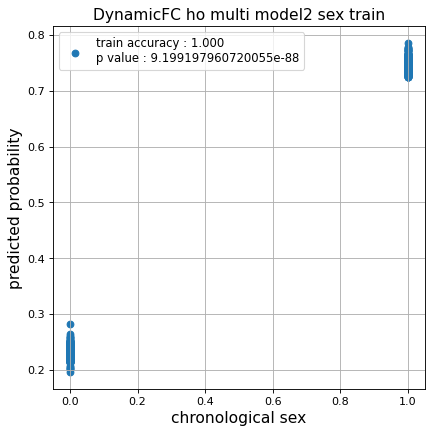

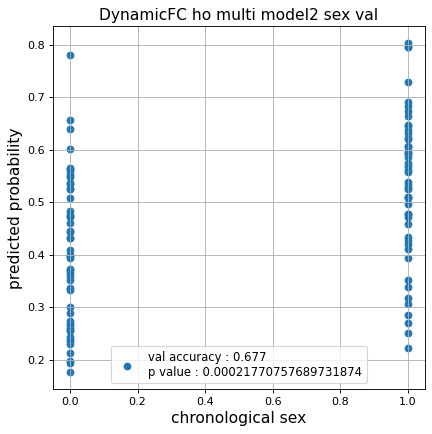

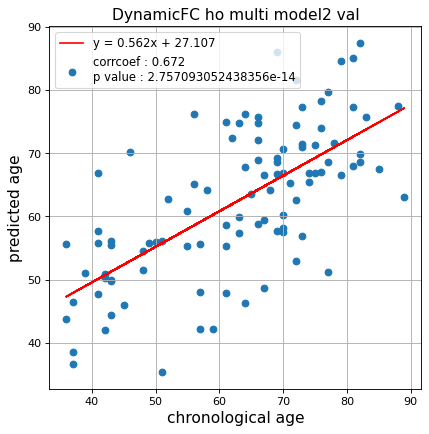

切片: 27.106545997364307
傾き: 0.5621034300479175
Kfold: 3 ::: epoch: 100, loss: 0.16190171700257522, val loss: 0.6238294020295143
Kfold: 3 ::: epoch: 200, loss: 0.14249550723112547, val loss: 0.6323558390140533
Kfold: 3 ::: epoch: 300, loss: 0.13439192107090583, val loss: 0.6733851432800293
Kfold: 3 ::: epoch: 400, loss: 0.1304046374100905, val loss: 0.739560455083847
early stopping
save_epochs:210
best val loss:0.6128197088837624


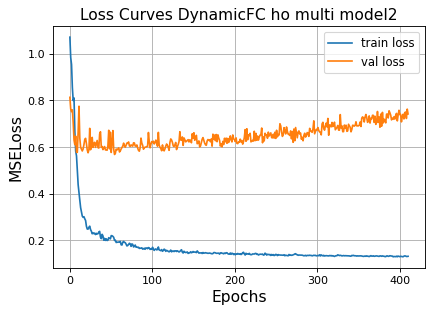

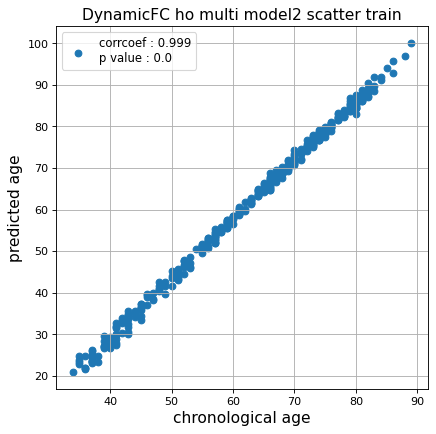

r^2 train data:  0.8069731425021809


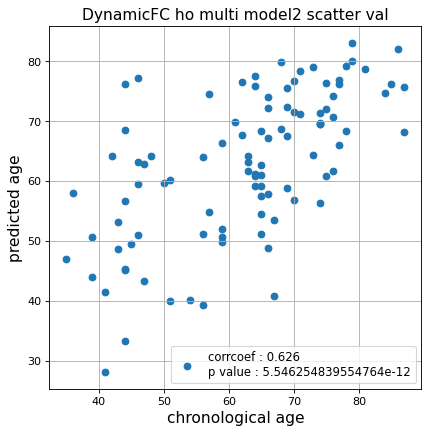

r^2 val data:  0.3004635856802633


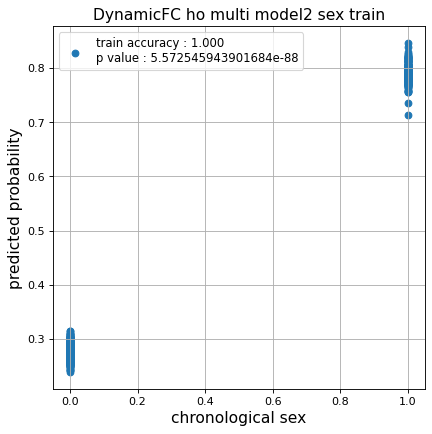

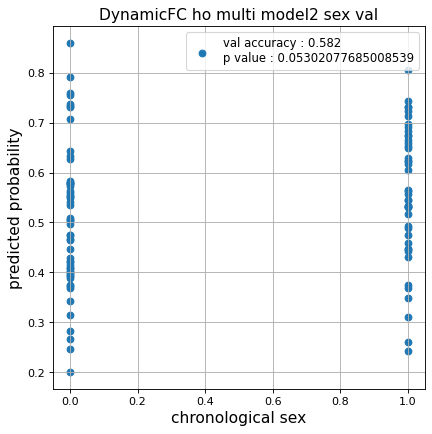

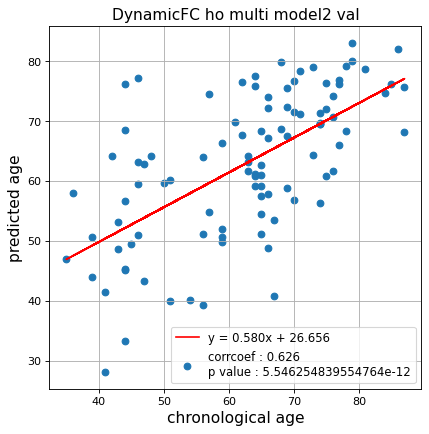

切片: 26.656205116138388
傾き: 0.5797213485244089
Kfold: 4 ::: epoch: 100, loss: 0.15038521473224348, val loss: 1.17242731153965
Kfold: 4 ::: epoch: 200, loss: 0.1399287489744333, val loss: 1.109193131327629
Kfold: 4 ::: epoch: 300, loss: 0.13382188975811005, val loss: 1.2552545219659805
Kfold: 4 ::: epoch: 400, loss: 0.12964740968667543, val loss: 1.179211065173149
early stopping
save_epochs:203
best val loss:1.0478722900152206


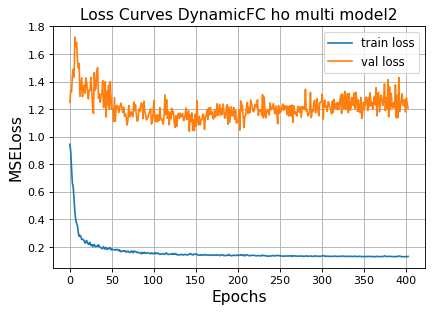

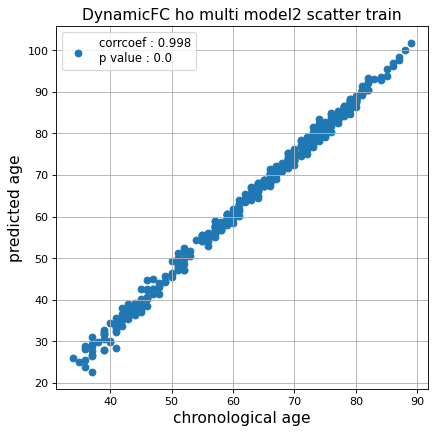

r^2 train data:  0.8107951689011925


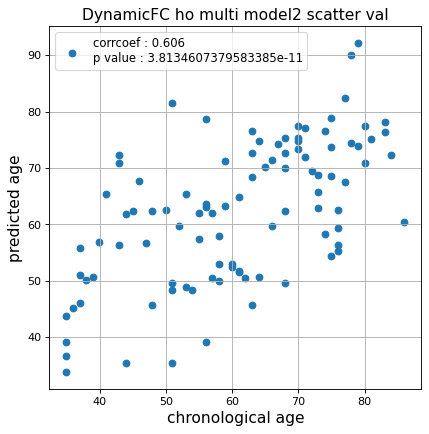

r^2 val data:  0.2691869306202561


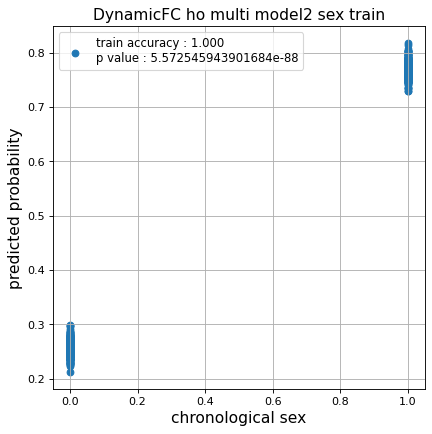

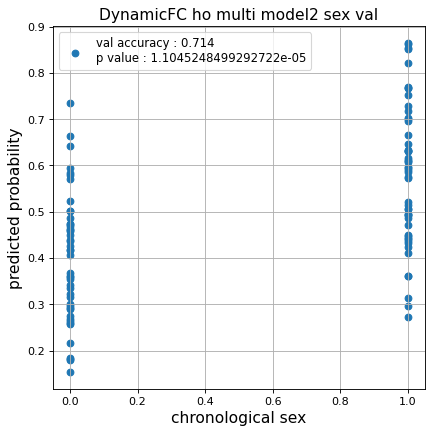

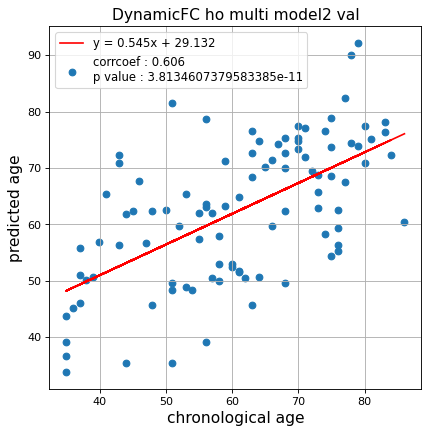

切片: 29.13227847668106
傾き: 0.5454886996950824
Kfold: 5 ::: epoch: 100, loss: 0.1656061284817182, val loss: 1.7085424214601517
Kfold: 5 ::: epoch: 200, loss: 0.14112564462881821, val loss: 1.4732032716274261
Kfold: 5 ::: epoch: 300, loss: 0.1361269114109186, val loss: 1.3287075608968735
Kfold: 5 ::: epoch: 400, loss: 0.1336592172200863, val loss: 1.2533014565706253
Kfold: 5 ::: epoch: 500, loss: 0.1329021121446903, val loss: 1.1654238849878311
Kfold: 5 ::: epoch: 600, loss: 0.13227135172257057, val loss: 1.0358695834875107
Kfold: 5 ::: epoch: 700, loss: 0.1324944828565304, val loss: 0.949180006980896
save_epochs:694
best val loss:0.9184621572494507


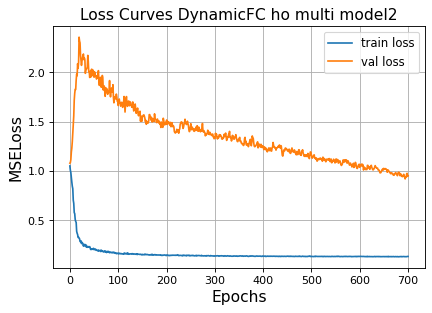

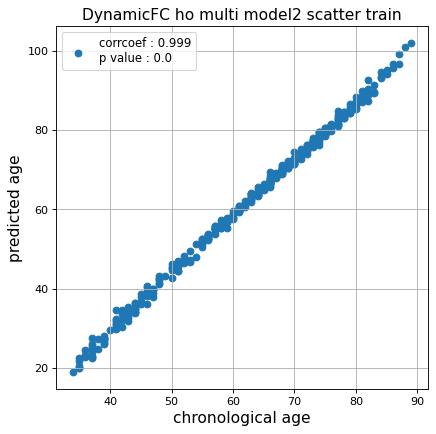

r^2 train data:  0.80227144856579


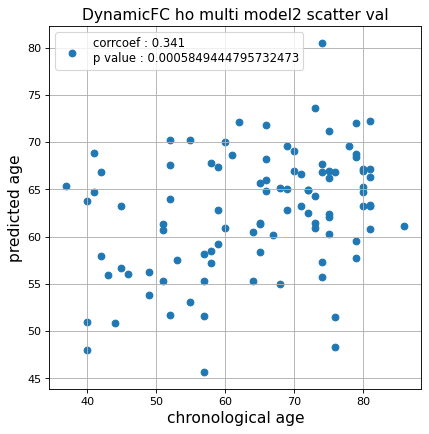

r^2 val data:  0.06720593360852667


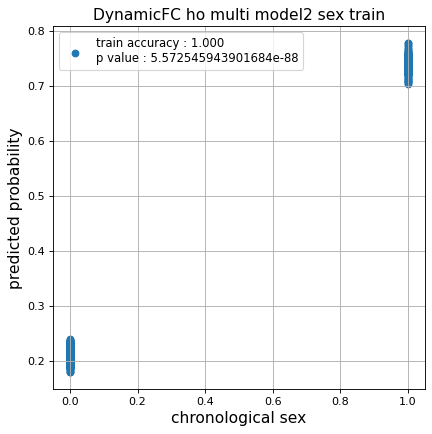

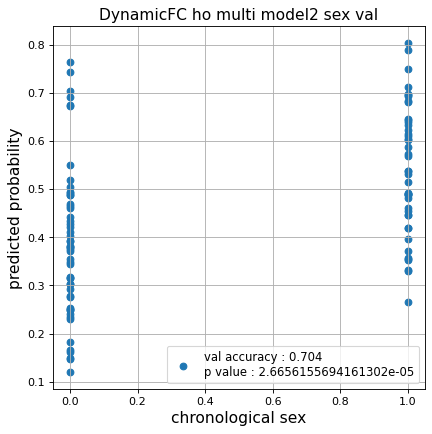

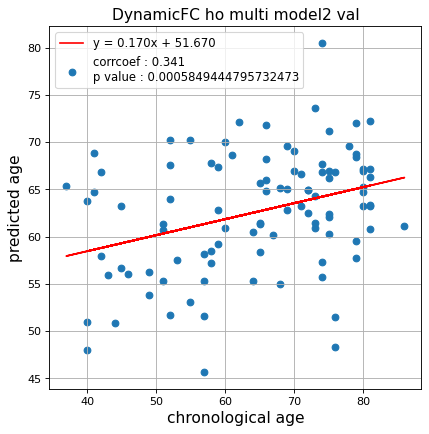

切片: 51.67015000598589
傾き: 0.16955148152750601
Nested Kfold ::: 5
Kfold: 1 ::: epoch: 100, loss: 0.16266835996737847, val loss: 0.5372205004096031
Kfold: 1 ::: epoch: 200, loss: 0.14335376826616433, val loss: 0.5329421758651733
Kfold: 1 ::: epoch: 300, loss: 0.13515148483789885, val loss: 0.5414780378341675
Kfold: 1 ::: epoch: 400, loss: 0.13326509984639975, val loss: 0.5601164400577545
early stopping
save_epochs:223
best val loss:0.5129726380109787


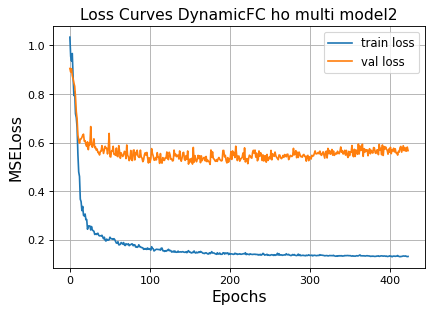

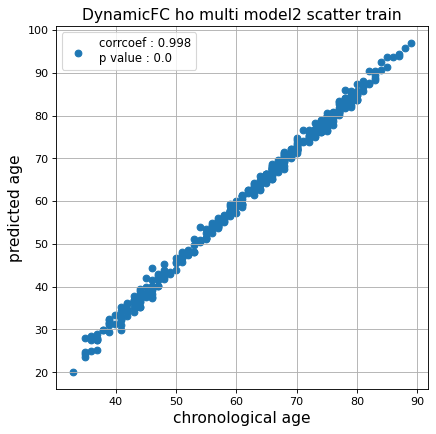

r^2 train data:  0.878379614122296


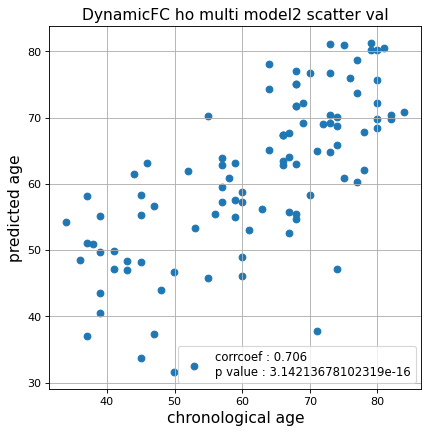

r^2 val data:  0.47236394128815506


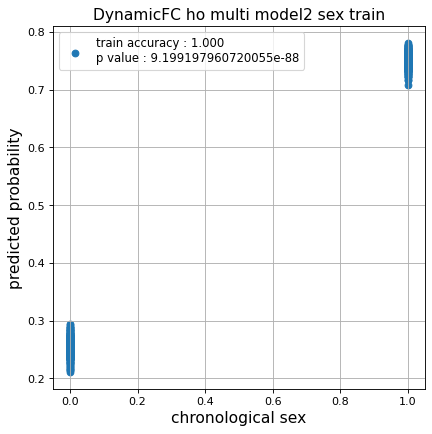

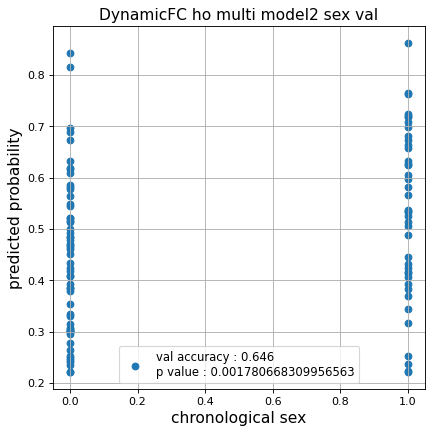

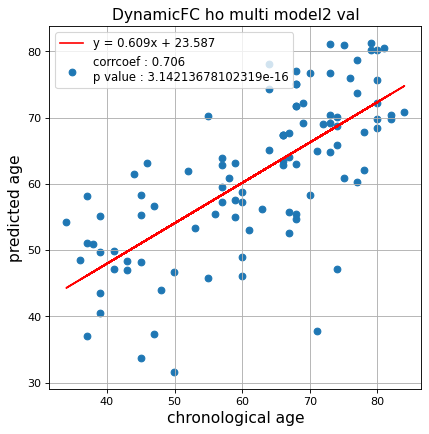

切片: 23.586520401090972
傾き: 0.6091256532940277
Kfold: 2 ::: epoch: 100, loss: 0.15470529404970315, val loss: 0.5553498156368732
Kfold: 2 ::: epoch: 200, loss: 0.14169067373642555, val loss: 0.5721638724207878
Kfold: 2 ::: epoch: 300, loss: 0.1343521922826767, val loss: 0.6251844391226768
Kfold: 2 ::: epoch: 400, loss: 0.13048264842766982, val loss: 0.6322174668312073
early stopping
save_epochs:215
best val loss:0.563769556581974


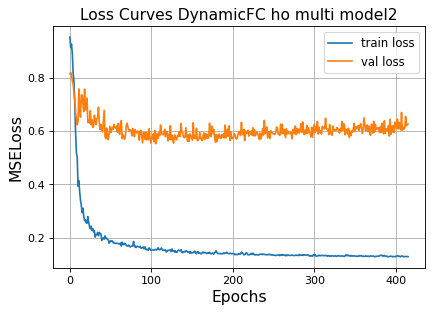

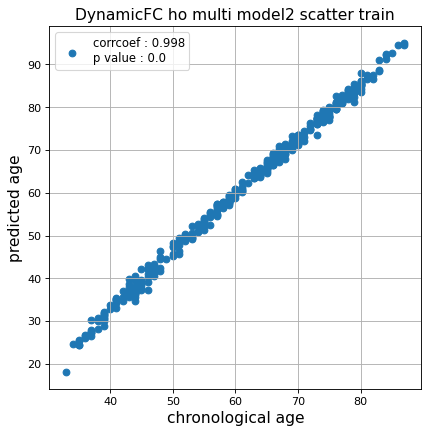

r^2 train data:  0.8857285900021469


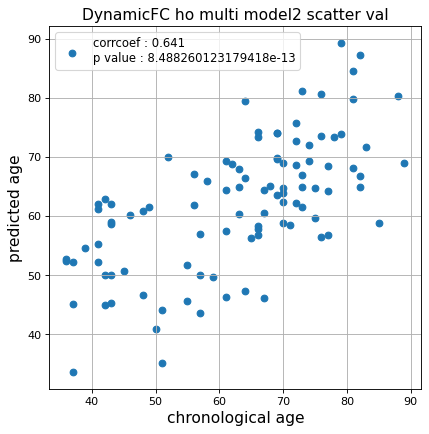

r^2 val data:  0.3886388663932637


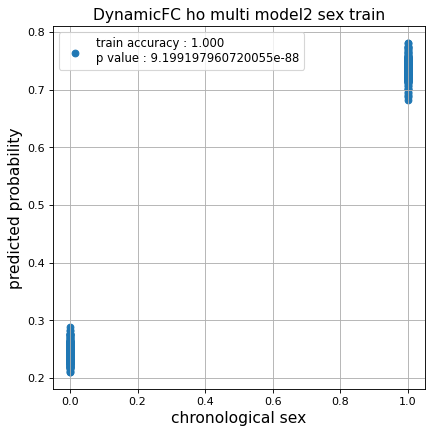

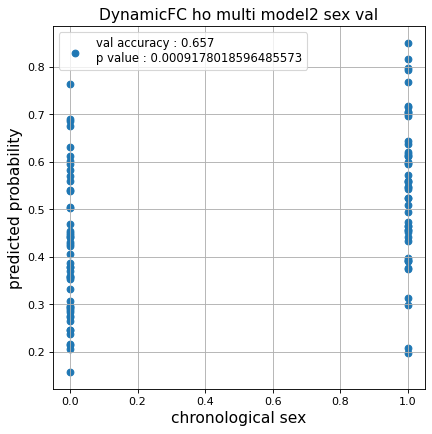

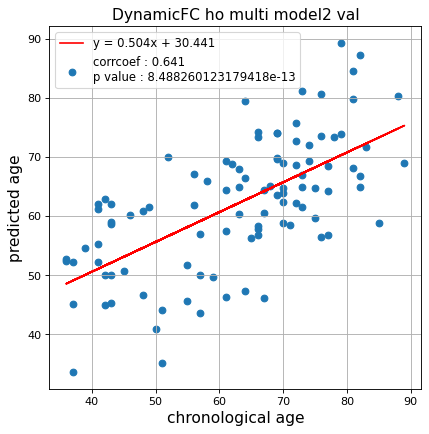

切片: 30.44075979753776
傾き: 0.5038681211359227
Kfold: 3 ::: epoch: 100, loss: 0.16253057924600747, val loss: 0.7766056954860687
Kfold: 3 ::: epoch: 200, loss: 0.13911419992263502, val loss: 0.8521308153867722
Kfold: 3 ::: epoch: 300, loss: 0.13761857266609484, val loss: 0.9160361289978027
Kfold: 3 ::: epoch: 400, loss: 0.13214039687926954, val loss: 0.929872676730156
early stopping
save_epochs:232
best val loss:0.8138191998004913


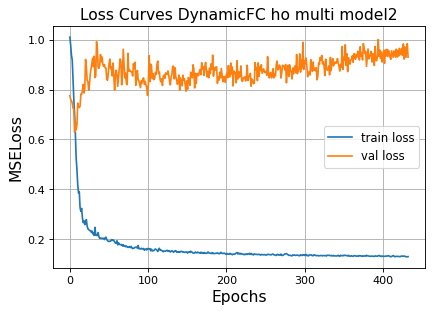

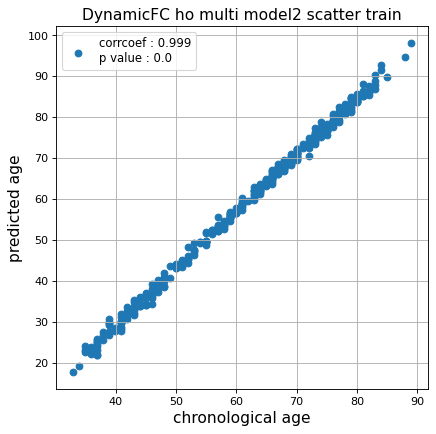

r^2 train data:  0.8137391382444343


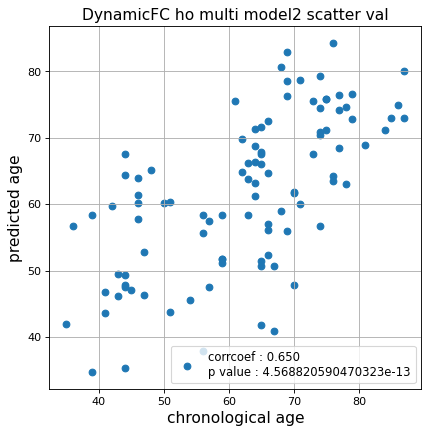

r^2 val data:  0.3616993534310283


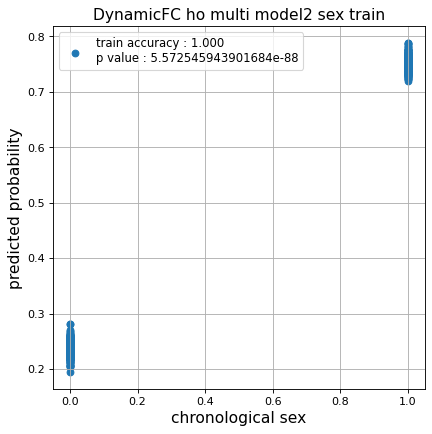

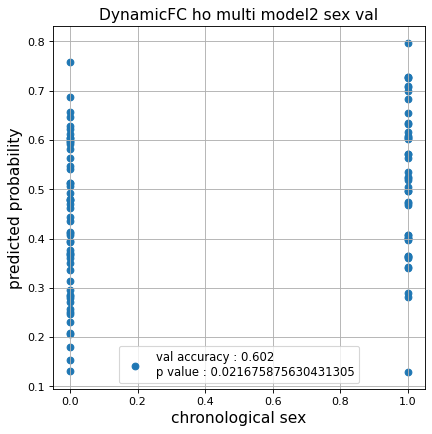

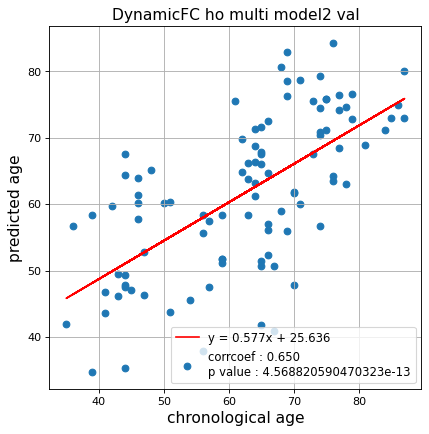

切片: 25.635925442600296
傾き: 0.5774116140721297
Kfold: 4 ::: epoch: 100, loss: 0.15271031856536865, val loss: 0.47870199382305145
Kfold: 4 ::: epoch: 200, loss: 0.13829274017077225, val loss: 0.5044600665569305
Kfold: 4 ::: epoch: 300, loss: 0.13643451837392953, val loss: 0.5283477231860161
Kfold: 4 ::: epoch: 400, loss: 0.1302974820137024, val loss: 0.5569202899932861
early stopping
save_epochs:202
best val loss:0.47959575057029724


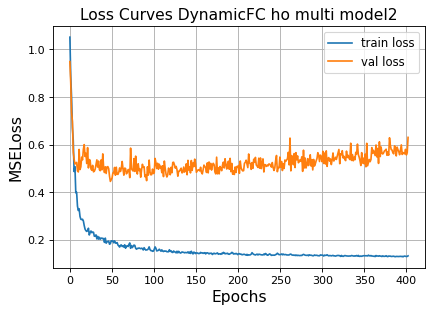

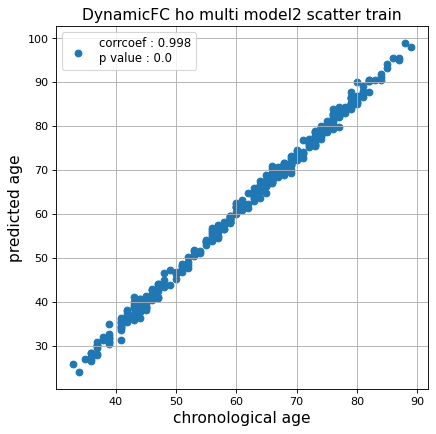

r^2 train data:  0.8827767270595943


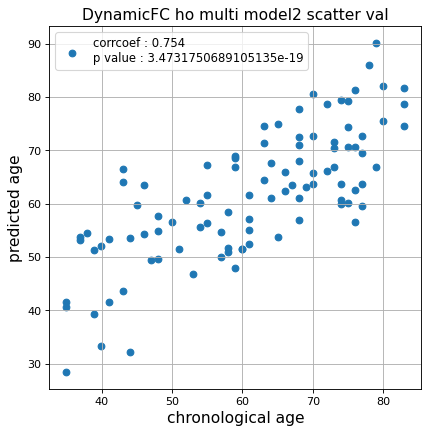

r^2 val data:  0.5502666865361888


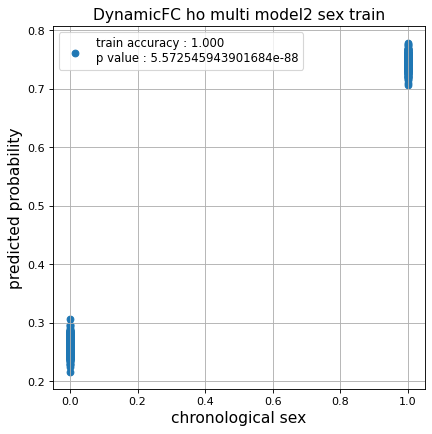

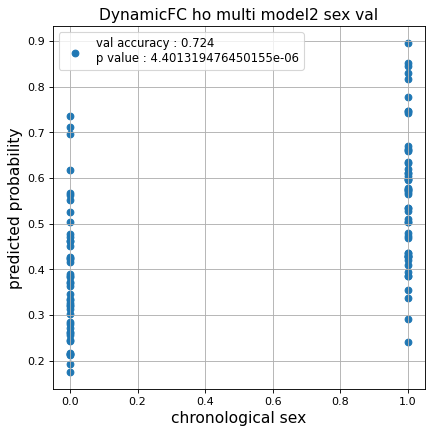

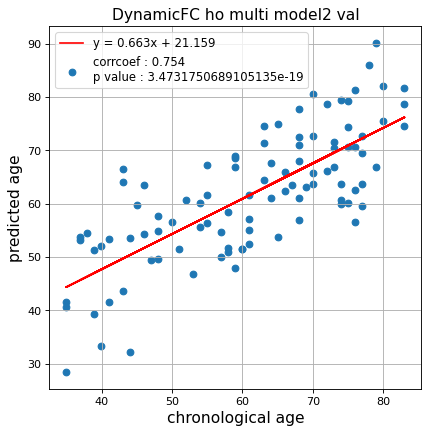

切片: 21.159063836613385
傾き: 0.6627937114966377
Kfold: 5 ::: epoch: 100, loss: 0.17486862379771012, val loss: 0.8983763754367828
Kfold: 5 ::: epoch: 200, loss: 0.14022022027235764, val loss: 0.8972266167402267
Kfold: 5 ::: epoch: 300, loss: 0.13396287996035355, val loss: 0.9142978340387344
Kfold: 5 ::: epoch: 400, loss: 0.1314272295970183, val loss: 0.9100531190633774
Kfold: 5 ::: epoch: 500, loss: 0.12914281625014085, val loss: 0.8873395323753357
Kfold: 5 ::: epoch: 600, loss: 0.12882921672784364, val loss: 0.8736112713813782
Kfold: 5 ::: epoch: 700, loss: 0.12770513731699723, val loss: 0.8462355136871338
save_epochs:678
best val loss:0.7994863092899323


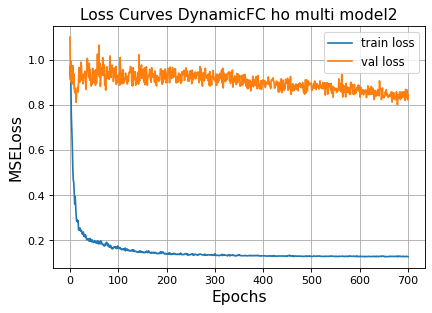

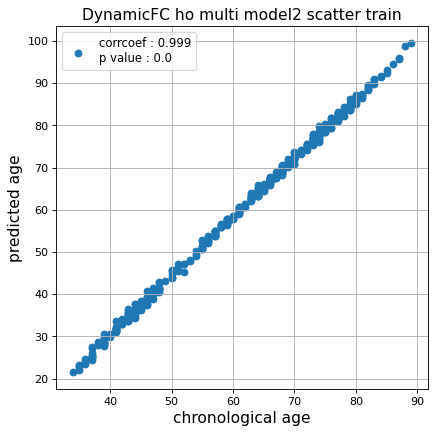

r^2 train data:  0.8366773060089874


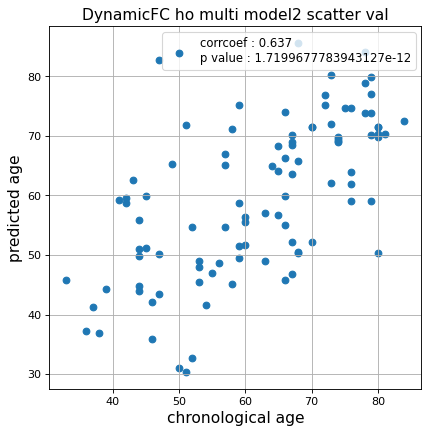

r^2 val data:  0.2613336809783364


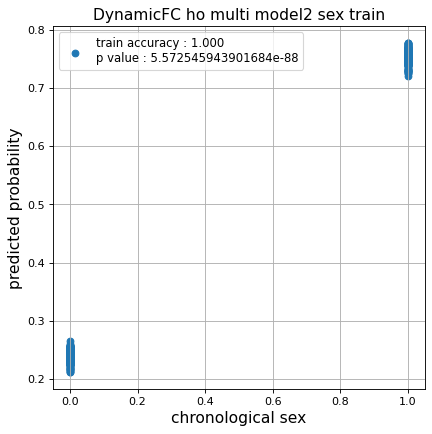

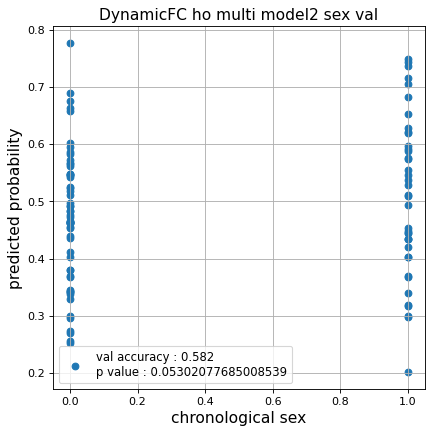

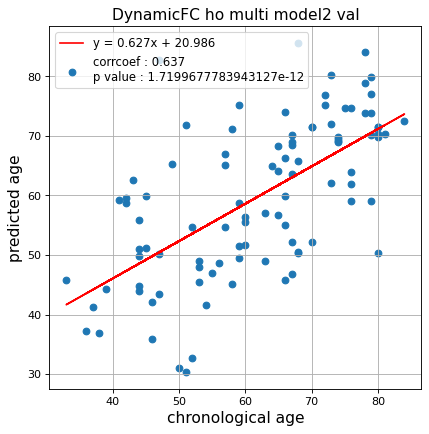

切片: 20.98642152337616
傾き: 0.6270176318875594
CPU times: user 19h 30min 5s, sys: 1min 34s, total: 19h 31min 40s
Wall time: 2h 54min 27s


In [31]:
%%time
fold = KFold(n_splits=n_splits,shuffle=False)

test_pred_ho_dynamic_2  = []
test_pred_ho_dynamic_corrected_2  = []
test_label_ho_dynamic_2 = []
test_idx_ho_dynamic_2   = []

for fold_idx, (train_idx, test_idx) in enumerate(fold.split(data_ho)):
    print(f'Nested Kfold ::: {fold_idx+1}')
    test_pred,test_pred_corrected,test_label = train_model(data_dynamic_ho,
                                                           data_label,
                                                           train_idx  = train_idx,
                                                           test_idx   = test_idx,
                                                           epochs     = 700,
                                                           d_model    = 64,
                                                           n_splits   = n_splits,
                                                           hidden_dim = 256,
                                                           nhead      = 2,#4
                                                           hidden_dim_transformer = 1,#2
                                                           pos_drop    = 0.5,
                                                           trans_drop = 0.5,
                                                           fc_drop = 0.3,
                                                           title = 'DynamicFC ho multi model2'
                                                          )
    
    test_pred_ho_dynamic_2.append(test_pred)
    test_pred_ho_dynamic_corrected_2.append(test_pred_corrected)
    test_label_ho_dynamic_2.append(test_label)
    test_idx_ho_dynamic_2.append(test_idx)

### データ保存

In [32]:
test_pred_ho_dynamic_1 = np.array(test_pred_ho_dynamic_1, dtype=object)
test_pred_ho_dynamic_corrected_1 = np.array(test_pred_ho_dynamic_corrected_1, dtype=object)

test_pred_ho_dynamic_2 = np.array(test_pred_ho_dynamic_2, dtype=object)
test_pred_ho_dynamic_corrected_2 = np.array(test_pred_ho_dynamic_corrected_2, dtype=object)

In [33]:
np.savez('../02_data_analysis/temp/multi_smooth_dynamic_ho_1',
         test_pred_ho_dynamic_1,
         test_pred_ho_dynamic_corrected_1,
         test_label_ho_dynamic_1,
         test_idx_ho_dynamic_1)
np.savez('../02_data_analysis/temp/multi_smooth_dynamic_ho_2',
         test_pred_ho_dynamic_2,
         test_pred_ho_dynamic_corrected_2,
         test_label_ho_dynamic_2,
         test_idx_ho_dynamic_2)